# Projet 6 : Classifiez automatiquement des biens de consommation

## Context : 
Au sein de l’entreprise <strong>"Place de marché”</strong>, qui souhaite lancer une marketplace e-commerce.


Sur la place de marché, des vendeurs proposent des articles à des acheteurs en postant une photo et une description.

Pour l'instant, l'attribution de la catégorie d'un article est effectuée manuellement par les vendeurs, et est donc peu fiable. De plus, le volume des articles est pour l’instant très petit.

Pour rendre l’expérience utilisateur des vendeurs (faciliter la mise en ligne de nouveaux articles) et des acheteurs (faciliter la recherche de produits) la plus fluide possible, et dans l'optique d'un passage à l'échelle, il devient nécessaire d'automatiser cette tâche.

On nous demande donc d'étudier la faisabilité d'un moteur de classification des articles en différentes catégories, avec un niveau de précision suffisant.

Contraint : 
- Voici les contraintes : 

   <strong> Afin d’extraire les features texte, il sera nécessaire de mettre en œuvre : 
    - deux approches de type “bag-of-words”, comptage simple de mots et Tf-idf ;
    - une approche de type word/sentence embedding classique avec Word2Vec (ou Glove ou FastText) ;
    - une approche de type word/sentence embedding avec BERT ;
    - une approche de type word/sentence embedding avec USE (Universal Sentence Encoder). </strong>

Sommaire : En 3 étapes -->

- 1) Analyse exploratoire : <strong> Exploratory Data Analysis | Natural Language Preprocessing  </strong>
- 2) Modélisation: <strong>approche Kmean,KmeansGaussian |BoW//Tf_idf |Word2Vec | Bert & USE</strong>
- 3) Analyse des images:<strong> SIFT / ORB / CNN - Transfert Learning</strong>

## Sommaire:
- <strong>Phrase-Précossing:</strong>
- Introduction:
    - Analyse Exploratoire
    - First analysis - load(data)
        * 1-Structure
        * 2-Valeur "Nan" and "Duplicated"
        * 3-Data inspection 
    - Tokenization
    - StopWords
    - FirstCleaningFunction(1er -> Final function cleaning)
    - Working on the entiere corpus
        * 3-1) Build Raw Corpus
        * 3-2) List Rare tokens
        * 3-3) Cleaning function
        * 3-4) WordCloud
    - Tokenization:
        * Stemming
        * SnowballStemmer
        * LancasterStemmer
        * Post Tagging
        * Lemmatization without POS Tagging
        * Lemmatization with Pos Tagging
    - Text Features Extraction:
        * Bag of Words (n-gram)
        * Term Frequency-Inverser Document Frequency (TFI-DF)
- <strong>Phase 2: Modélisation:</strong>
    - Mise en place des KMeans modèle(ACP+ Viz/Tsne)
        * KMeans
        * KMeans Gaussian
        * KMeans 2
    - Les différentes approches en plus + Viz and Score (ARI) :
        * Bag of Words - tf_Idf
        * Word2Vec
        * Bert
        * Universal Sentence Encoder
- <strong>Phase 3 : Analyse des images: Computer Vizion</strong>
    * Pré-traitement des images
    * SIFT
    * ORB 
    * Transfert Learning (CNN)
        * VGG16
        * VGG19
- <strong>Conclusion</strong>

---------------------
## Librairy & Version 

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib as mpl
import seaborn as sns
from textwrap import wrap
import scipy as sp
import matplotlib

In [2]:
#data : 1
import pandas as pd
import numpy as np

#NLP : 
import nltk
from nltk.stem import WordNetLemmatizer , PorterStemmer
from nltk.tokenize import word_tokenize, wordpunct_tokenize
from nltk.corpus import words
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer

#import spacy 

#Viz : 

import seaborn as sns 
import matplotlib as plt 
#from wordcloud import wordcloud
from PIL import Image

In [3]:
nltk.download('omw-1.4')
nltk.download('words')
nltk.download('wordnet')
nltk.download('stopwords')

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [8]:
#pip install wordcloud


  Using cached wordcloud-1.8.2.2-cp39-cp39-win_amd64.whl (153 kB)


In [5]:
from wordcloud import wordcloud

In [3]:
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
import gensim

In [4]:
import pickle
import time
from sklearn import cluster, metrics
from sklearn import manifold, decomposition
import logging
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [5]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [6]:
#001
# Classic lib.
import pandas as pd
import numpy as np
import sklearn
import timeit

# Viz lib.
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import matplotlib.cm as cm

# Natural Language lib.
import nltk
from nltk.stem.snowball import SnowballStemmer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# Standardization.
from sklearn.preprocessing import StandardScaler

# ML/Clustering/PCA.
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

# Error & Quality of prediction.
from sklearn.metrics import accuracy_score, precision_score
from sklearn.metrics import silhouette_score, adjusted_rand_score, silhouette_samples 

In [7]:
# Standardization.
from sklearn.preprocessing import StandardScaler

# ML/Clustering/PCA.
from sklearn.model_selection import train_test_split, GridSearchCV
#from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

# Error & Quality of prediction.
from sklearn.metrics import accuracy_score, precision_score
from sklearn.metrics import silhouette_score, adjusted_rand_score, silhouette_samples  

In [8]:
#Constante
PATH002 = 'Images'

In [ ]:
# pip install opencv-python

In [17]:
#pip install yellowbrick

  Using cached yellowbrick-1.5-py3-none-any.whl (282 kB)
Note: you may need to restart the kernel to use updated packages.


In [9]:
from matplotlib import rcParams
from matplotlib.ticker import FixedLocator, FixedFormatter
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.image import imread
from sklearn import cluster, manifold, decomposition, preprocessing
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.metrics import silhouette_score, silhouette_samples, adjusted_rand_score, rand_score
#from mesfonctions import display_scree_plot, display_factorial_planes, draw_tsne, draw_umap, accuracy_svm
import pickle
from termcolor import colored, cprint
import cv2
from yellowbrick.cluster import KElbowVisualizer
from collections import Counter
from cycler import cycler

In [10]:
# Chargement des librairies
import datetime
import sys
import time
from datetime import datetime
#import jyquickhelper
import numpy as np
import pandas as pd
import os
#import pickle
from IPython.core.display import display, HTML
import matplotlib.pyplot as plt
import seaborn as sns
# Réduction dimension
from sklearn.manifold import TSNE
# Clustering
from sklearn.cluster import KMeans
# CNN Applications Keras
import keras
from keras.preprocessing import image
import tensorflow as tf
# LDA, NMF
from sklearn.decomposition import NMF, LatentDirichletAllocation

# Warnings
#import warnings
#warnings.filterwarnings('ignore')

%matplotlib inline


# Versions
print('Version des librairies utilisées :')
#print('jyquickhelper         : ' + jyquickhelper.__version__)
print('Python                : ' + sys.version)
print('NumPy                 : ' + np.version.full_version)
print('Pandas                : ' + pd.__version__)
print('Keras                 : ' + keras.__version__)
print('matplotlib            : ' + matplotlib.__version__)
print('Sklearn               : ' + sklearn.__version__)
print('Seaborn               : ' + sns.__version__)
print('Tensorflow            : ' + tf.__version__)
print('OpenCV                : ' + cv2.__version__)
print('Nltk                  : ' + nltk.__version__)
print('Pillow                : ' + Image.__version__)



now = datetime.now().isoformat()
print('Lancé le           : ' + now)

Version des librairies utilisées :
Python                : 3.9.15 (main, Nov 24 2022, 14:39:17) [MSC v.1916 64 bit (AMD64)]
NumPy                 : 1.23.5
Pandas                : 1.5.2
Keras                 : 2.10.0
matplotlib            : 3.6.2
Sklearn               : 1.1.3
Seaborn               : 0.12.1
Tensorflow            : 2.10.0
OpenCV                : 4.6.0
Nltk                  : 3.7
Pillow                : 9.3.0
Lancé le           : 2023-01-07T11:56:59.890657


C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\800084451.py:11: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


---------
### Analyse exploratoire :

In [ ]:
%matplotlib inline

In [ ]:
#pip install pyqt5

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib as mpl
import seaborn as sns
from textwrap import wrap
import scipy as sp
import matplotlib

In [ ]:
df = pd.read_csv("flipkart_com-ecommerce_sample_1050.csv")
df.head()


,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [ ]:
df.shape

(1050, 15)

In [ ]:

df.describe()

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [ ]:
df.dtypes

uniq_id                     object
crawl_timestamp             object
product_url                 object
product_name                object
product_category_tree       object
pid                         object
retail_price               float64
discounted_price           float64
image                       object
is_FK_Advantage_product       bool
description                 object
product_rating              object
overall_rating              object
brand                       object
product_specifications      object
dtype: object

In [ ]:
df.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [ ]:
# Collections for each dataset
dfEcommerce = df
datasets = [dfEcommerce]
names = ['Ecommerce']

# Creating a DataFrame with useful information about all datasets
data_info = pd.DataFrame({})
data_info['dataset'] = names
data_info['n_rows'] = [df.shape[0] for df in datasets]
data_info['n_cols'] = [df.shape[1] for df in datasets]
data_info['null_amount'] = [df.isnull().sum().sum() for df in datasets]
data_info['qty_null_columns'] = [len([col for col, null in df.isnull().sum().items() if null > 0]) for df in datasets]
data_info['null_columns'] = [', '.join([col for col, null in df.isnull().sum().items() if null > 0]) for df in datasets]

data_info.style.background_gradient()

,dataset,n_rows,n_cols,null_amount,qty_null_columns,null_columns
0,Ecommerce,1050,15,341,4,"retail_price, discounted_price, brand, product_specifications"


In [ ]:
dfEcommerce.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

## 1 First Analysis - load data

Resumer : 

- 15 Colonnes | 1050 lignes | Valeur manquantes - présents  // Valeurs abérrantes :

    Colonnes :
     - uniq_id: ID |
     - crawl_timestamp: Date | Convertion ou transformation du format ? 
     - product_name: Nom_Produit | = > V
     - product_catergory_tree: Produit_catégorie_arbre | V / sep les premiers mots du reste 
     - pid: ??
     - retail_price: Prix de détails | Voir les outliers 
     - discounted_price: Prix Discount |
     - image: "ANALYSE DES IMAGES " = > V
     - is_FK_Advantage_product: Avantage produit | convert 0 and 1 ?
     - description: = -> <strong>Corpus </strong>  "ANALYSE TEXTE" => V
     - product_rating: évaluation_du_produit |
     - overall_ratin: Note global | => +90 % : "No rating available"
     - brand : marque | Beaucoup de valeur manquante ici - env 35% du tout 
     - product_specification: Spécifiation du produit |



In [ ]:
dfEcommerce.head(3)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."


In [ ]:
dfEcommerce.isna().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [ ]:
dfEcommerce.shape

(1050, 15)

In [ ]:
#Librairy
#import  os,sys ,time 

import numpy as np 
import pandas as pd 

import matplotlib.pyplot as plt 
import seaborn as sns 

In [ ]:
#Graphic and options 

sns.set()

In [ ]:
dfEcommerce.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [ ]:
dfEcommerce.sample(5)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
965,9c8fdf6c9c631d0892e9a6f55a4a2fd2,2016-06-15 19:32:11 +0000,http://www.flipkart.com/nyx-set-2-soft-matte-l...,"NYX Set Of 2 Soft Matte Lip Cream 06,22","[""Beauty and Personal Care >> Body and Skin Ca...",LCMEJMZ6XWZVKX3D,3000.0,1440.0,9c8fdf6c9c631d0892e9a6f55a4a2fd2.jpg,False,"NYX Set Of 2 Soft Matte Lip Cream 06,22 (Multi...",No rating available,No rating available,NYX,"{""product_specification""=>[{""key""=>""Organic Ty..."
1013,b48218a94e220c20373ed50dc4254093,2016-03-02 19:09:22 +0000,http://www.flipkart.com/lawman-pg3-striker-win...,"LAWMAN PG3 Striker,, Winger , Contender Deodor...","[""Beauty and Personal Care >> Fragrances >> De...",DEOEG9GYD746P2DH,597.0,447.0,b48218a94e220c20373ed50dc4254093.jpg,False,"Key Features of LAWMAN PG3 Striker,, Winger , ...",No rating available,No rating available,LAWMAN PG3,"{""product_specification""=>[{""key""=>""Fragrance ..."
401,50be4cd92fda2755e1e884421a52e345,2015-12-01 06:13:00 +0000,http://www.flipkart.com/denim-deo-combo-set/p/...,Denim Deo Combo Set,"[""Beauty and Personal Care >> Fragrances >> De...",CAGDTFSHTF6TRBFZ,250.0,250.0,50be4cd92fda2755e1e884421a52e345.jpg,True,Flipkart.com: Buy Denim Deo Combo Set online o...,3.3,3.3,NaN,"{""product_specification""=>[{""key""=>""Number of ..."
609,08bdf59c9dcb241e3a57eb4f3729ec70,2016-03-07 19:42:22 +0000,http://www.flipkart.com/rrsskids-swing-king-co...,Rrsskids Swing King Cotton Hammock,"[""Home Decor & Festive Needs >> Garden & Leisu...",HKSEFHYXHEBSYZR6,5000.0,4200.0,08bdf59c9dcb241e3a57eb4f3729ec70.jpg,False,Key Features of Rrsskids Swing King Cotton Ham...,No rating available,No rating available,Rrsskids,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
950,cd71b07a1d37a5e2cc04240e8498cc76,2016-01-01 13:15:34 +0000,http://www.flipkart.com/ecraftindia-floral-sin...,eCraftIndia Floral Single Quilts & Comforters ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",BLAEDZTE88SQUWWH,1599.0,1099.0,cd71b07a1d37a5e2cc04240e8498cc76.jpg,False,Buy eCraftIndia Floral Single Quilts & Comfort...,No rating available,No rating available,eCraftIndia,"{""product_specification""=>[{""key""=>""Brand"", ""v..."


### 2. Structure :

In [ ]:
dfEcommerce.shape

(1050, 15)

In [ ]:
df.dtypes

uniq_id                     object
crawl_timestamp             object
product_url                 object
product_name                object
product_category_tree       object
pid                         object
retail_price               float64
discounted_price           float64
image                       object
is_FK_Advantage_product       bool
description                 object
product_rating              object
overall_rating              object
brand                       object
product_specifications      object
dtype: object

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [ ]:
# Nombre de colonnes dans chaque dtypes :
dfEcommerce.dtypes.value_counts()

object     12
float64     2
bool        1
dtype: int64

In [ ]:
#Nombre de valeurs unique par colonne : 
df.nunique()

uniq_id                    1050
crawl_timestamp             149
product_url                1050
product_name               1050
product_category_tree       642
pid                        1050
retail_price                354
discounted_price            424
image                      1050
is_FK_Advantage_product       2
description                1050
product_rating               27
overall_rating               27
brand                       490
product_specifications      984
dtype: int64

In [ ]:
tmp = df.nunique()
tmp

uniq_id                    1050
crawl_timestamp             149
product_url                1050
product_name               1050
product_category_tree       642
pid                        1050
retail_price                354
discounted_price            424
image                      1050
is_FK_Advantage_product       2
description                1050
product_rating               27
overall_rating               27
brand                       490
product_specifications      984
dtype: int64

In [ ]:
tmp[tmp <500]

crawl_timestamp            149
retail_price               354
discounted_price           424
is_FK_Advantage_product      2
product_rating              27
overall_rating              27
brand                      490
dtype: int64

In [ ]:
tmp[tmp >500]

uniq_id                   1050
product_url               1050
product_name              1050
product_category_tree      642
pid                       1050
image                     1050
description               1050
product_specifications     984
dtype: int64

### 2.1 Valeur "Nan" and duplicated : 


In [ ]:
dfEcommerce.isna().sum()

uniq_id                      0
crawl_timestamp              0
product_url                  0
product_name                 0
product_category_tree        0
pid                          0
retail_price                 1
discounted_price             1
image                        0
is_FK_Advantage_product      0
description                  0
product_rating               0
overall_rating               0
brand                      338
product_specifications       1
dtype: int64

In [ ]:
df.isna().mean().sort_values()

uniq_id                    0.000000
crawl_timestamp            0.000000
product_url                0.000000
product_name               0.000000
product_category_tree      0.000000
pid                        0.000000
image                      0.000000
is_FK_Advantage_product    0.000000
description                0.000000
product_rating             0.000000
overall_rating             0.000000
retail_price               0.000952
discounted_price           0.000952
product_specifications     0.000952
brand                      0.321905
dtype: float64

Remarque : 
- retail_price : - 1% de valeur manquante
- discounted_price : - 1% de valeur manquante
- product_specification : - 1 % de valeur manquante

- brand : 30% de valeurs manquantes !

<AxesSubplot: >

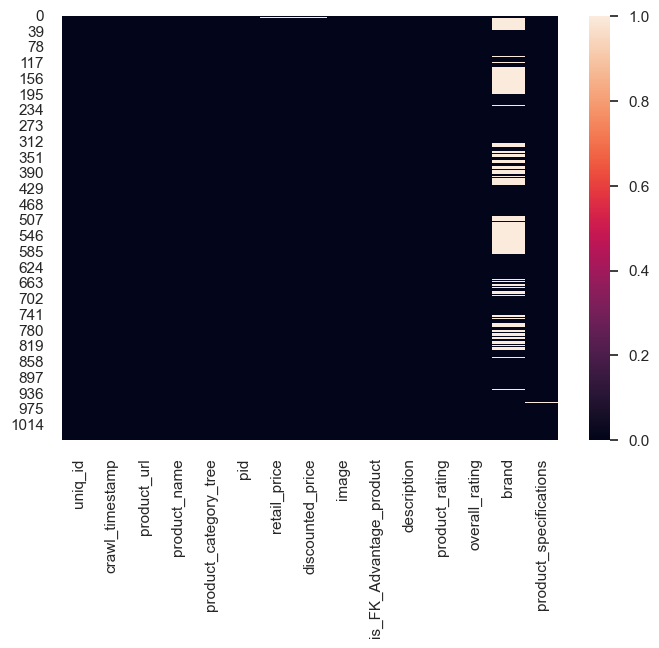

In [ ]:
sns.heatmap(dfEcommerce.isna())

<AxesSubplot: >

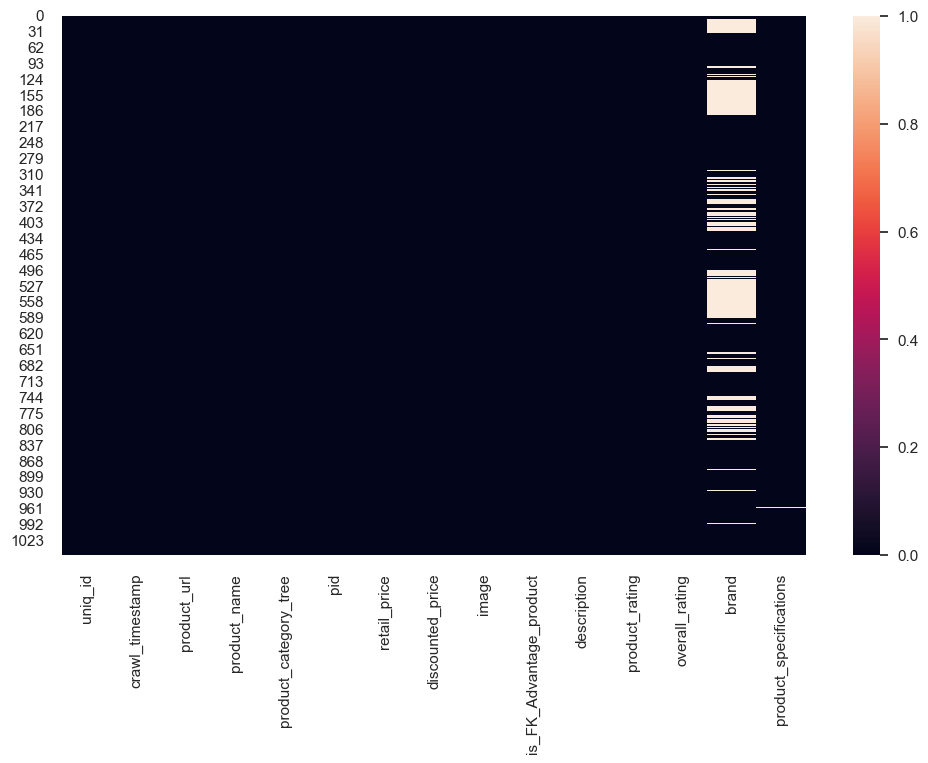

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(12,7))
sns.heatmap(dfEcommerce.isna())

In [ ]:
dfEcommerce.duplicated().sum()

0

Remarque: 
- Pas de valeur dupliqué 

In [ ]:
for col in dfEcommerce.columns : 
    n = dfEcommerce.duplicated(subset=col).sum()
    print(f"col:{col} -> duplicated :{n}")

col:uniq_id -> duplicated :0
col:crawl_timestamp -> duplicated :901
col:product_url -> duplicated :0
col:product_name -> duplicated :0
col:product_category_tree -> duplicated :408
col:pid -> duplicated :0
col:retail_price -> duplicated :695
col:discounted_price -> duplicated :625
col:image -> duplicated :0
col:is_FK_Advantage_product -> duplicated :1048
col:description -> duplicated :0
col:product_rating -> duplicated :1023
col:overall_rating -> duplicated :1023
col:brand -> duplicated :559
col:product_specifications -> duplicated :65


In [ ]:
df.head(3)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."


In [ ]:
#Voir si chaque ligne est dupliqué ou non (<=> vecteur)
dfEcommerce.duplicated(subset="product_specifications",keep="first")

0       False
1       False
2       False
3       False
4       False
        ...  
1045    False
1046    False
1047    False
1048    False
1049    False
Length: 1050, dtype: bool

In [ ]:
#Utiliser le vecteur précédent comme index
idx = dfEcommerce.duplicated(subset="product_specifications",keep="first")
#Selectionnner seulement les valeurs dupliqué
df.loc[idx,:].sort_values('product_specifications')

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
765,3d8222014ec36292c1c143c5f5e12c29,2015-12-12 11:46:53 +0000,http://www.flipkart.com/nutcase-sticker-wrap-d...,Nutcase Sticker Wrap Design - Teal & Pink Wate...,"[""Kitchen & Dining >> Containers & Bottles >> ...",BOTEANCHSXYX32RJ,799.0,399.0,3d8222014ec36292c1c143c5f5e12c29.jpg,False,Nutcase Sticker Wrap Design - Teal & Pink Wate...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Body Mater..."
745,daf06eb2b9613900299539558e287701,2015-12-12 11:46:53 +0000,http://www.flipkart.com/nutcase-sticker-wrap-d...,Nutcase Sticker Wrap Design - Mint & Grey Chev...,"[""Kitchen & Dining >> Containers & Bottles >> ...",BOTEANCHRVE7K3CS,799.0,399.0,daf06eb2b9613900299539558e287701.jpg,False,Nutcase Sticker Wrap Design - Mint & Grey Chev...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Body Mater..."
744,73523a8cc9a5c04a010d0307f2f2827a,2015-12-12 11:46:53 +0000,http://www.flipkart.com/nutcase-sticker-wrap-d...,Nutcase Sticker Wrap Design - Gummy Bears 800 ...,"[""Kitchen & Dining >> Containers & Bottles >> ...",BOTEANCHFY7TGFKX,799.0,399.0,73523a8cc9a5c04a010d0307f2f2827a.jpg,False,Nutcase Sticker Wrap Design - Gummy Bears 800 ...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Body Mater..."
766,503bb08f7bdf6a395ec564dd1dc83619,2015-12-12 11:46:53 +0000,http://www.flipkart.com/nutcase-sticker-wrap-d...,Nutcase Sticker Wrap Design - Lucky Elements 8...,"[""Kitchen & Dining >> Containers & Bottles >> ...",BOTEANCHDNKDTKGH,799.0,399.0,503bb08f7bdf6a395ec564dd1dc83619.jpg,False,Nutcase Sticker Wrap Design - Lucky Elements 8...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Body Mater..."
743,d47f1cb78db4a23e2516e2d34da34c8a,2015-12-12 11:46:53 +0000,http://www.flipkart.com/nutcase-sticker-wrap-d...,Nutcase Sticker Wrap Design - Pineapple 800 ml...,"[""Kitchen & Dining >> Containers & Bottles >> ...",BOTEANCH6ZZZHJVD,799.0,399.0,d47f1cb78db4a23e2516e2d34da34c8a.jpg,False,Nutcase Sticker Wrap Design - Pineapple 800 ml...,No rating available,No rating available,NaN,"{""product_specification""=>[{""key""=>""Body Mater..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
736,e33795f66b2a42ac56095ae704ab25b6,2016-04-13 02:13:26 +0000,http://www.flipkart.com/antiqueshop-abkl-pl-pn...,AntiqueShop ABKL_PL_PNK_PNK,"[""Beauty and Personal Care >> Bath and Spa >> ...",LFHEGUEKPTJY6HBW,599.0,349.0,e33795f66b2a42ac56095ae704ab25b6.jpg,False,Key Features of AntiqueShop ABKL_PL_PNK_PNK So...,No rating available,No rating available,AntiqueShop,"{""product_specification""=>[{""value""=>""3 Back L..."
737,1dbe1f3ba28460dffef4a1d664549621,2016-04-13 02:13:26 +0000,http://www.flipkart.com/antiqueshop-abkl-pl-pl...,AntiqueShop ABKL_PL_PL_PNK,"[""Beauty and Personal Care >> Bath and Spa >> ...",LFHEGUEKWWSATDYZ,599.0,349.0,1dbe1f3ba28460dffef4a1d664549621.jpg,False,Key Features of AntiqueShop ABKL_PL_PL_PNK Sof...,No rating available,No rating available,AntiqueShop,"{""product_specification""=>[{""value""=>""3 Back L..."
55,e2ae2af58ac50adf4881751ae84a9d8a,2016-06-17 11:45:06 +0000,http://www.flipkart.com/jrb-1042-smallest-mobi...,JRB 1042 Smallest Mobile Powered By OTG Enable...,"[""Computers >> Laptop Accessories >> USB Gadge...",USGEJPQHT8YPZ7D8,499.0,249.0,e2ae2af58ac50adf4881751ae84a9d8a.jpg,False,Key Features of JRB 1042 Smallest Mobile Power...,No rating available,No rating available,JRB,"{""product_specification""=>nil}"
54,7e6ae1b372e8e0b509b83ba3658b8107,2016-06-17 11:45:06 +0000,http://www.flipkart.com/jrb-1033-smallest-mobi...,JRB 1033 Smallest Mobile Powered By OTG Enable...,"[""Computers >> Laptop Accessories >> USB Gadge...",USGEJPQHFM7CVCYH,499.0,249.0,7e6ae1b372e8e0b509b83ba36

### 2.2 Data inspection : 

In [ ]:
#Uniquement sur les colonnes numérique
dfEcommerce.describe(include=np.number)

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


Remarque : 
- A verifier les valeurs aberrantes :
    * min: 35.00 
    * max: 201000 

In [ ]:
#Uniquement sur les colonnes object 

df.describe(include = object)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,image,description,product_rating,overall_rating,brand,product_specifications
count,1050,1050,1050,1050,1050,1050,1050,1050,1050,1050,712,1049
unique,1050,149,1050,1050,642,1050,1050,1050,27,27,490,984
top,55b85ea15a1536d46b7190ad6fff8ce7,2015-12-01 12:40:44 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",CRNEG7BKMFFYHQ8Z,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""va..."
freq,1,150,1,1,56,1,1,1,889,889,11,22


In [ ]:
dfEcommerce.head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [ ]:
df.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [ ]:
cols = ['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'brand', 'product_specifications']

df2 = dfEcommerce[cols]

In [ ]:
df2.head(3)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."


In [ ]:
df2.shape

(1050, 13)

In [ ]:
df3 = df2.copy()                                       # Créer une copie de DataFrame 
df3[ 'is_FK_Advantage_product' ]  = df2[ 'is_FK_Advantage_product' ].astype( int )                 # Transformer booléen en entier 
print (df3)   

                               uniq_id            crawl_timestamp  \
0     55b85ea15a1536d46b7190ad6fff8ce7  2016-04-30 03:22:56 +0000   
1     7b72c92c2f6c40268628ec5f14c6d590  2016-04-30 03:22:56 +0000   
2     64d5d4a258243731dc7bbb1eef49ad74  2016-04-30 03:22:56 +0000   
3     d4684dcdc759dd9cdf41504698d737d8  2016-06-20 08:49:52 +0000   
4     6325b6870c54cd47be6ebfbffa620ec7  2016-06-20 08:49:52 +0000   
...                                ...                        ...   
1045  958f54f4c46b53c8a0a9b8167d9140bc  2015-12-01 10:15:43 +0000   
1046  fd6cbcc22efb6b761bd564c28928483c  2015-12-01 10:15:43 +0000   
1047  5912e037d12774bb73a2048f35a00009  2015-12-01 10:15:43 +0000   
1048  c3edc504d1b4f0ba6224fa53a43a7ad6  2015-12-01 10:15:43 +0000   
1049  f2f027ad6a6df617c9f125173da71e44  2015-12-01 10:15:43 +0000   

                                            product_url  \
0     http://www.flipkart.com/elegance-polyester-mul...   
1     http://www.flipkart.com/sathiyas-cotton-bath-t.

In [ ]:
df3.is_FK_Advantage_product.value_counts()

0    993
1     57
Name: is_FK_Advantage_product, dtype: int64

In [ ]:
df3.is_FK_Advantage_product.value_counts(normalize=True) #Pourcentage 

0    0.945714
1    0.054286
Name: is_FK_Advantage_product, dtype: float64

<AxesSubplot: ylabel='is_FK_Advantage_product'>

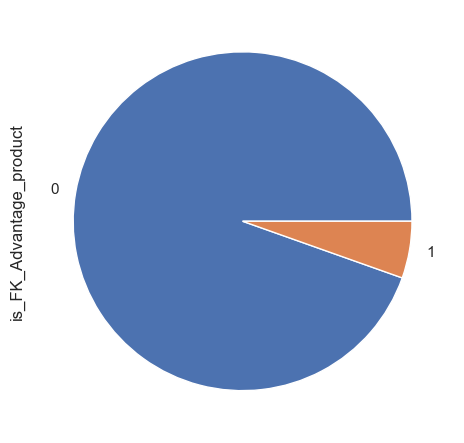

In [ ]:
df3.is_FK_Advantage_product.value_counts().plot(kind="pie")

In [ ]:
df3.describe(include = "object")

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,image,description,brand,product_specifications
count,1050,1050,1050,1050,1050,1050,1050,1050,712,1049
unique,1050,149,1050,1050,642,1050,1050,1050,490,984
top,55b85ea15a1536d46b7190ad6fff8ce7,2015-12-01 12:40:44 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",CRNEG7BKMFFYHQ8Z,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""va..."
freq,1,150,1,1,56,1,1,1,11,22


In [ ]:
#Longueur de nos documents (corpus :description)
df3.description.apply(lambda i : len(i))

0       1420
1        444
2       1258
3        858
4       1197
        ... 
1045    2432
1046    1660
1047     262
1048     210
1049     187
Name: description, Length: 1050, dtype: int64

In [ ]:
df3.product_name.apply(lambda i : len(i))

0       58
1       26
2       35
3       63
4       53
        ..
1045    46
1046    38
1047    65
1048    39
1049    28
Name: product_name, Length: 1050, dtype: int64

<AxesSubplot: >

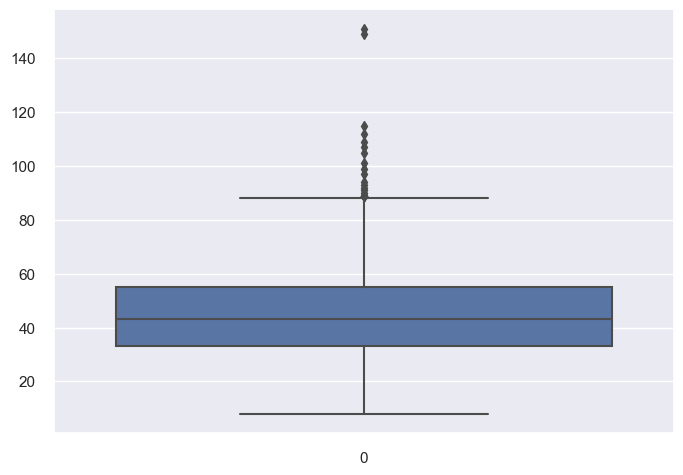

In [ ]:
tmp2 = df3.product_name.str.len()
sns.boxplot(tmp2)

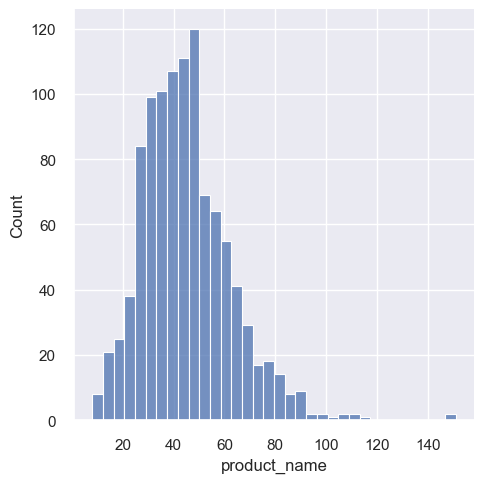

In [ ]:
sns.displot(tmp2)

<AxesSubplot: >

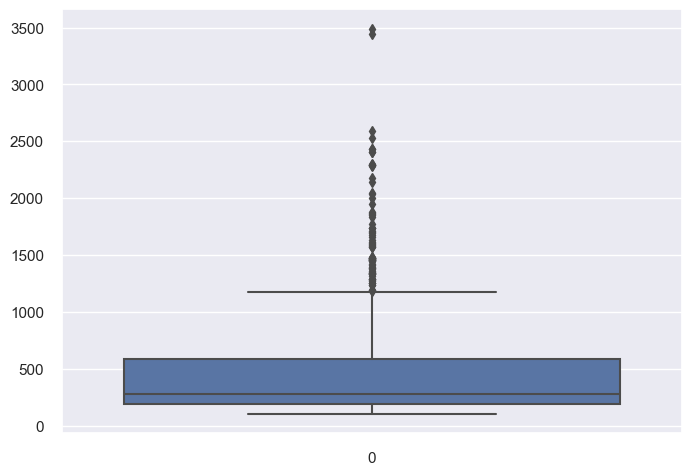

In [ ]:
tmp1 = df3.description.str.len()
sns.boxplot(tmp1)

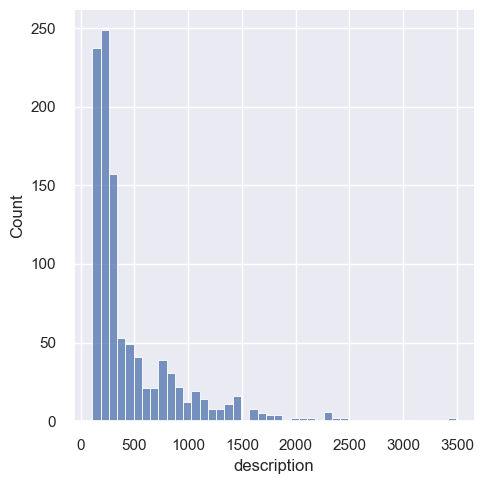

In [ ]:
sns.displot(tmp1)

In [ ]:
df3.sample(5)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,brand,product_specifications
541,54749618b728306f9b3dc518dec315ee,2016-01-07 05:50:25 +0000,http://www.flipkart.com/petrol-pcwbl68-analog-...,Petrol PCWBL68 Analog Watch - For Men,"[""Watches >> Wrist Watches >> Petrol Wrist Wat...",WATDPV5TUCGZ8JCN,999.0,999.0,54749618b728306f9b3dc518dec315ee.jpg,1,Petrol PCWBL68 Analog Watch - For Men - Buy P...,NaN,"{""product_specification""=>[{""key""=>""Type"", ""va..."
1034,7815fb39feb773db944c9f03bbdcbf64,2016-03-03 06:06:42 +0000,http://www.flipkart.com/print-shapes-peacock-f...,PRINT SHAPES Peacock Feather Laptop Skin with ...,"[""Computers >> Laptop Accessories >> Computer ...",LACEGF4N8UFADEGZ,999.0,329.0,7815fb39feb773db944c9f03bbdcbf64.jpg,0,Key Features of PRINT SHAPES Peacock Feather L...,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
706,8a306758531cffad41e7a28e41576c49,2016-01-01 19:37:22 +0000,http://www.flipkart.com/golmaalshop-showpiece-...,Golmaalshop Showpiece - 27.9 cm,"[""Home Decor & Festive Needs >> Table Decor & ...",SHIECK9BFNDBMZCA,1399.0,799.0,8a306758531cffad41e7a28e41576c49.jpg,0,Buy Golmaalshop Showpiece - 27.9 cm for Rs.7...,Golmaalshop,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
393,ab3f4b2d2ec007b7e0eaec213bfdbffc,2015-12-01 06:13:00 +0000,http://www.flipkart.com/engage-tease-combo-set...,Engage Tease and Tease Combo Set,"[""Beauty and Personal Care >> Fragrances >> De...",CAGE68FFFPTGVEQQ,360.0,350.0,ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg,0,Flipkart.com: Buy Engage Tease and Tease Combo...,NaN,"{""product_specification""=>[{""key""=>""Gift Set C..."
589,621a88993a7033df3440ec816c2e386f,2016-05-10 11:57:25 +0000,http://www.flipkart.com/shopfloor-xyz-vacuum-c...,"Shopfloor.XYZ Vacuum Cleaner for Computers, La...","[""Computers >> Laptop Accessories >> Cleaning ...",CLKEGH4ADYDTQFHE,399.0,269.0,621a88993a7033df3440ec816c2e386f.jpg,0,"Shopfloor.XYZ Vacuum Cleaner for Computers, La...",Shopfloor.XYZ,"{""product_specification""=>[{""key""=>""Brand"", ""v..."


In [ ]:
df3.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'brand',
       'product_specifications'],
      dtype='object')

In [ ]:
cols =[ 'product_name',
       'product_category_tree', 
       'image', 'description']

df4 = df3[cols]
df4.head()

,product_name,product_category_tree,image,description
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...
3,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...
4,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...


-------------------------------------
Product_category_tree : à séparer le premier niv ,du deuxieme...

Catégories d'images : 
- Chaque image est catégorisé par un système d'arbes avec plusieur profondeurs.Le nom de la colonne renseignant les différentes catégories : " product_category_tree" .

In [ ]:
print(df4["product_category_tree"][0])

["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]


In [ ]:
# On récupère la colomne "product_category_tree"
list_categories_1, list_categories_2 = [], []
for txt in df["product_category_tree"] :
    
    list_categories_1.append(txt.split(">>")[0].split("\"")[1].strip()) # split du nom par >> et on récupère la première partie
    list_categories_2.append(txt.split(">>")[1].strip()) # split du nom par >> et on récupère la première partie

# Création d'une nouvelle série catégorie    
df4["categories_1"] = pd.Series(list_categories_1)
df4["categories_2"] = pd.Series(list_categories_2)

print("Il y a {} catégories dans la pronfondeur 1 et {} categories pour la profondeur 2".format(df4["categories_1"].nunique(), df4["categories_2"].nunique()))


Il y a 7 catégories dans la pronfondeur 1 et 63 categories pour la profondeur 2


C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\106847599.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4["categories_1"] = pd.Series(list_categories_1)
C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\106847599.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4["categories_2"] = pd.Series(list_categories_2)


In [ ]:
df4.head(2)

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin


In [ ]:
df4.head(2)

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin


C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\2225461961.py:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)


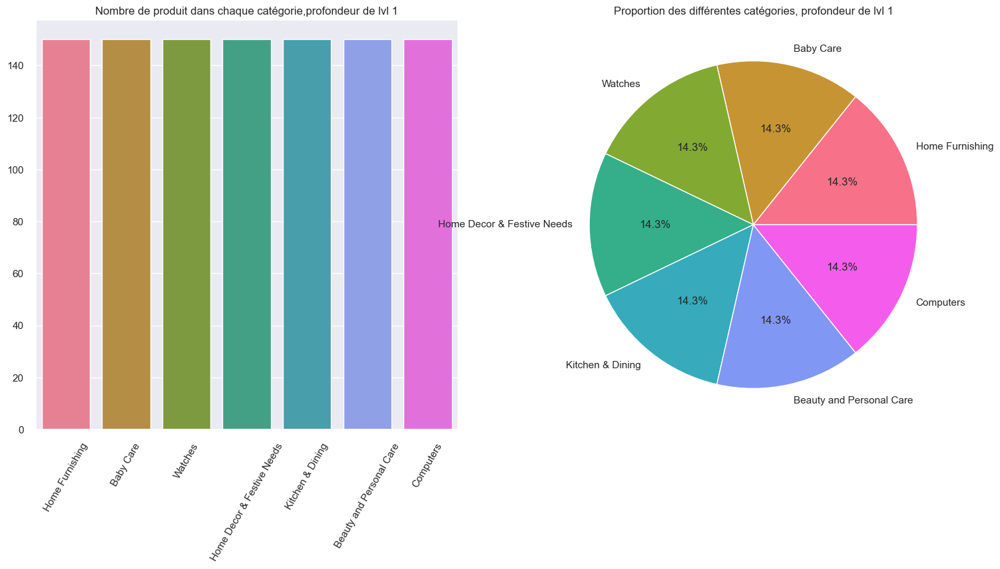

In [ ]:
#Affichage des catégories de premier niveau (1ère Niv):

#Histogramme et Pieplot de la répartition des catégories dans la profondeur 1:
fig = plt.figure(1,figsize = (18,8))
categ_1 = df4["categories_1"].value_counts()
plt.title("Proportion des différentes catégories")

sns.set_palette(sns.color_palette("husl",len(categ_1)))

#Barplot
plt.subplot(1,2,1)
plt.title("Nombre de produit dans chaque catégorie,profondeur de lvl 1")

sns.barplot(x = categ_1.index,y = categ_1.values,orient="v")
plt.xticks(rotation=60)

#Pieplot
plt.subplot(1,2,2)
plt.title("Proportion des différentes catégories, profondeur de lvl 1")

plt.pie(categ_1,labels=list(categ_1.index),autopct="%1.1f%%")
plt.show()

Remarque: 
- Il y a environ 150 images par catégories de profondeur "1". 

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\1246181789.py:10: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)


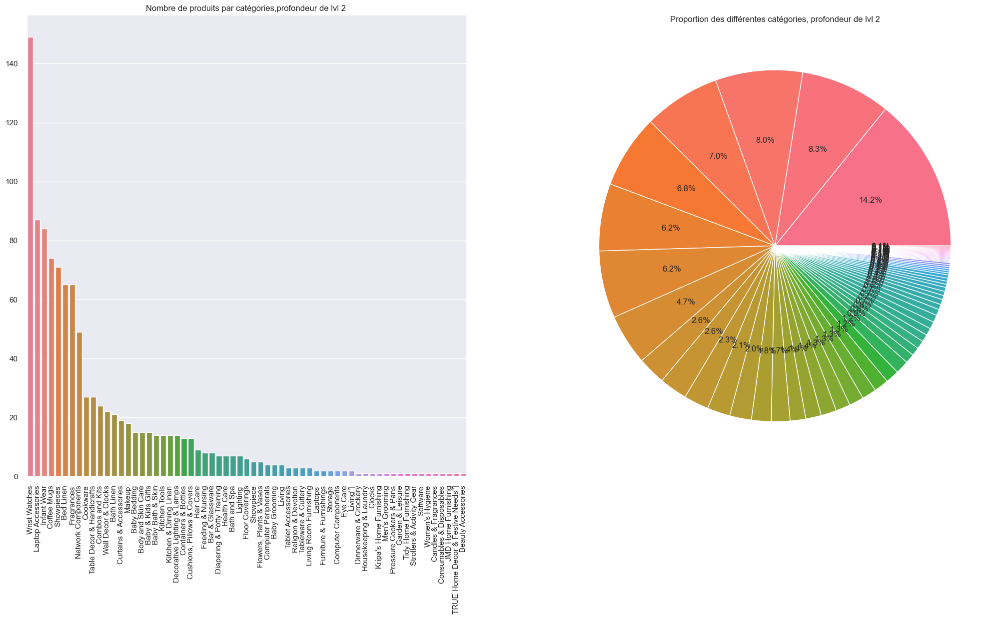

In [ ]:
#Histogramme et Pieplot de la répartiion des catégories dans la profondeur 2:
fig = plt.figure(figsize=(25,12))
categ_2 = df4["categories_2"].value_counts()

plt.title("Proportion des différentes catégories")

sns.set_palette(sns.color_palette("husl",len(categ_2)))

#Barplot
plt.subplot(1,2,1)
plt.title("Nombre de produits par catégories,profondeur de lvl 2 ")

sns.barplot(x = categ_2.index,y=categ_2.values,orient="v")
plt.xticks(rotation=90)

#Pieplot
plt.subplot(1,2,2)
plt.title("Proportion des différentes catégories, profondeur de lvl 2")
plt.pie(categ_2,autopct="%1.1f%%")

plt.show()



Remarque : 

- Il  y a 63 catégories différentes pour le profondeur de lvl 2 et les répartition es très inégale entre les catégories. 

- => Par conséquent , les catégories de profondeur de première niv sera utilisé pour la suite des projets . 

In [ ]:
df4.head(3)

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin


In [ ]:
cols =[ 'product_name', 'description',"categories_1"]

df5 = df4[cols]
df5.head()

,product_name,description,categories_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing


In [ ]:
#Longueur des docs de la colonne product_name

df5['_len_product_name'] = tmp2
df5.head(2)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3399951669.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df5['_len_product_name'] = tmp2


,product_name,description,categories_1,_len_product_name
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,58
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,26


In [ ]:
# Longueur des docs de la colonne description
df5['_len_description'] = tmp1
df5.head(2)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\1339152324.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df5['_len_description'] = tmp1


,product_name,description,categories_1,_len_product_name,_len_description
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,58,1420
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,26,444


In [ ]:
df5.head()

,product_name,description,categories_1,_len_product_name,_len_description
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,58,1420
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,26,444
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,35,1258
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,63,858
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,53,1197


In [ ]:
df5.head()

,product_name,description,categories_1,_len_product_name,_len_description
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,58,1420
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,26,444
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,35,1258
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,63,858
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,53,1197


In [ ]:
#Mettre de côté les longueur des textes :

df6 = df5.drop(columns=(["_len_description","_len_product_name"]),axis=1)
df6.head()

,product_name,description,categories_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing


In [ ]:
#Selection de 20 produit name| description au hasard
df_sample = df6.sample(10)
df_sample

,product_name,description,categories_1
1013,"LAWMAN PG3 Striker,, Winger , Contender Deodor...","Key Features of LAWMAN PG3 Striker,, Winger , ...",Beauty and Personal Care
429,"Smartpro 19.5v,3.9a Replacement Charger for Va...","Key Features of Smartpro 19.5v,3.9a Replacemen...",Computers
563,Fluid FS201-BL01 Analog-Digital Watch - For W...,Fluid FS201-BL01 Analog-Digital Watch - For W...,Watches
833,Tapawire Portable USB Flexible Stick Dimmable ...,Buy Tapawire Portable USB Flexible Stick Dimma...,Computers
609,Rrsskids Swing King Cotton Hammock,Key Features of Rrsskids Swing King Cotton Ham...,Home Decor & Festive Needs
241,Recon SuperChef Kadhai,Buy Recon SuperChef Kadhai for Rs.715 online. ...,Kitchen & Dining
974,Jaycoknit Mediterranean Sea's Lucky Wooden Han...,Key Features of Jaycoknit Mediterranean Sea's ...,Home Decor & Festive Needs
565,Sonata 8097YM03 Analog Watch - For Women,Sonata 8097YM03 Analog Watch - For Women - Bu...,Watches
787,Perucci PC-218 Decker Analog Watch - For Men,Perucci PC-218 Decker Analog Watch - For Men ...,Watches
918,The Intellect Bazaar Abstract Double Dohar Blu...,Buy The Intellect Bazaar Abstract Double Dohar...,Home Furnishing


In [ ]:
# Selection de nom de produits de façon aléatoires :
for idx,ser in df_sample.iterrows():
    print(ser['product_name'])

LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men
Smartpro 19.5v,3.9a Replacement Charger for Vaio Series VGN-CR309E 75 Adapter
Fluid FS201-BL01 Analog-Digital Watch  - For Women
Tapawire Portable USB Flexible Stick Dimmable Touch Switch 10 Super Bright LED Reading Lamp B00 USB Led Light
Rrsskids Swing King Cotton Hammock
Recon SuperChef Kadhai
Jaycoknit Mediterranean Sea's Lucky Wooden Handcrafted Ship Part II Showpiece  -  17 cm
Sonata 8097YM03 Analog Watch  - For Women
Perucci PC-218 Decker Analog Watch  - For Men
The Intellect Bazaar Abstract Double Dohar Blue, Brown


In [ ]:
# Selection des descriptions de produit de façon aléatoires :
for idx,ser in df_sample.iterrows():
    print(ser['description'])

Key Features of LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men Fragrance Classification: Deodorant Spray,LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men (210 ml) Price: Rs. 447 Lawman Deodorant Combo For Men,Specifications of LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men (210 ml) Fragrance Traits Fragrance Classification Deodorant Spray Quantity 210 ml Ideal For Men In the Box 3 Deodorant
Key Features of Smartpro 19.5v,3.9a Replacement Charger for Vaio Series VGN-CR309E 75 Adapter Designed  for Sony   Vaio VGN-CR309E,Smartpro 19.5v,3.9a Replacement Charger for Vaio Series VGN-CR309E 75 Adapter (Power Cord Included) Price: Rs. 599 This is a SmartPro Brand Product. Smartpro Laptop Adapter For 75W Charger for Sony Vaio VGN-CR309E 19.5V 3.9A 19.5V 3.95A Connector Pin Size 6.5 x 4.4. This Smartpro replacement adapter is designed to provide reliable power and charge to your laptop. Made from highest quality parts each replacement

In [ ]:
#Formater - pour meilleur une lecture : 
for idx,ser in df_sample.iterrows():
    txt_1 = f"product_name : {ser['product_name']}\n"
    print(txt_1 +"||" + "-- " + ser['description']+"..."+"\n\n")

product_name : LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men
||-- Key Features of LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men Fragrance Classification: Deodorant Spray,LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men (210 ml) Price: Rs. 447 Lawman Deodorant Combo For Men,Specifications of LAWMAN PG3 Striker,, Winger , Contender Deodorant Spray  -  For Men (210 ml) Fragrance Traits Fragrance Classification Deodorant Spray Quantity 210 ml Ideal For Men In the Box 3 Deodorant...


product_name : Smartpro 19.5v,3.9a Replacement Charger for Vaio Series VGN-CR309E 75 Adapter
||-- Key Features of Smartpro 19.5v,3.9a Replacement Charger for Vaio Series VGN-CR309E 75 Adapter Designed  for Sony   Vaio VGN-CR309E,Smartpro 19.5v,3.9a Replacement Charger for Vaio Series VGN-CR309E 75 Adapter (Power Cord Included) Price: Rs. 599 This is a SmartPro Brand Product. Smartpro Laptop Adapter For 75W Charger for Sony Vaio VGN-CR309E 19.5V 3.9

--------
#### Tokenization :

- Réduire un doc à un ensebmle de brique élementaire qu'on peu traiter

In [ ]:
#init sns 
sns.set()

In [ ]:
df6.head()

,product_name,description,categories_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing


In [ ]:
df6.shape

(1050, 3)

In [ ]:
#Select a random document - "description"
doc = df6.description.sample(1)
doc = doc.values[0]
doc

'Buy 999store Medium Paper Sticker for Rs.599 online. 999store Medium Paper Sticker at best prices with FREE shipping & cash on delivery. Only Genuine Products. 30 Day Replacement Guarantee.'

In [ ]:
# Select a random document - "product_name"
doc1 = df5.product_name.sample(1)
doc1 = doc1.values[0]
doc1

'Denver RO,Black Code Gift Set  Combo Set'

In [ ]:
#Lower 
doc = doc.lower()
doc1 = doc1.lower()

In [ ]:
doc

'buy 999store medium paper sticker for rs.599 online. 999store medium paper sticker at best prices with free shipping & cash on delivery. only genuine products. 30 day replacement guarantee.'

In [ ]:
doc1

'denver ro,black code gift set  combo set'

In [ ]:
import nltk
from nltk.stem import WordNetLemmatizer , PorterStemmer
from nltk.tokenize import word_tokenize, wordpunct_tokenize
from nltk.corpus import words
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer

In [ ]:
#nltk.download("puntk")

In [ ]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
#Tokenization 
tokens = nltk.word_tokenize(doc)
tokens1 = nltk.word_tokenize(doc1)

In [ ]:
tokens 

['buy',
 '999store',
 'medium',
 'paper',
 'sticker',
 'for',
 'rs.599',
 'online',
 '.',
 '999store',
 'medium',
 'paper',
 'sticker',
 'at',
 'best',
 'prices',
 'with',
 'free',
 'shipping',
 '&',
 'cash',
 'on',
 'delivery',
 '.',
 'only',
 'genuine',
 'products',
 '.',
 '30',
 'day',
 'replacement',
 'guarantee',
 '.']

In [ ]:
tokens1

['denver', 'ro', ',', 'black', 'code', 'gift', 'set', 'combo', 'set']

In [ ]:
# longueur - doc: "description"
len(tokens)

33

In [ ]:
#longueur - doc:"product_name"
len(tokens1)

9

In [ ]:
# longueur - doc: "description" -Token Unique
len(set(tokens))

26

In [ ]:
#longueur - doc:"product_name" -Token Unique
len(set(tokens1))

8

In [ ]:
#1) fonction nbre d'élements et token unique:
def display_token_info(tokens):
    """Display info about corpus"""
    print(f"nb tokens{len(tokens)},nb tokens uniques {len(set(tokens))}")
    print(tokens[:30])

In [ ]:
# an other tokenize 

tokens = wordpunct_tokenize(doc)
display_token_info(tokens)

nb tokens35,nb tokens uniques 27
['buy', '999store', 'medium', 'paper', 'sticker', 'for', 'rs', '.', '599', 'online', '.', '999store', 'medium', 'paper', 'sticker', 'at', 'best', 'prices', 'with', 'free', 'shipping', '&', 'cash', 'on', 'delivery', '.', 'only', 'genuine', 'products', '.']


In [ ]:
#2) fonction nbre d'élements et token unique:
def display_token_info_1(tokens1):
    """Display info about corpus"""
    print(f"nb tokens{len(tokens1)},nb tokens uniques {len(set(tokens1))}")
    print(tokens1[:30])

In [ ]:
#2) an other tokenize 

tokens1 = wordpunct_tokenize(doc1)
display_token_info(tokens1)

nb tokens9,nb tokens uniques 8
['denver', 'ro', ',', 'black', 'code', 'gift', 'set', 'combo', 'set']


#### Stopwords : 
- stopwords : liste de mots qui ne sont pas informative (exemple :les déterminants,etc... )

In [ ]:
#Strop_word:
stop_words = set(stopwords.words('english'))
print(stop_words)

{'wasn', "weren't", 'against', 'when', 'them', "you'd", 'so', 're', 'shan', 'him', 'out', "you'll", 'further', 'how', 'both', 'whom', "couldn't", 'weren', "you're", "shouldn't", 'over', 'needn', "that'll", 'having', 'each', 'are', 'been', 'their', 'were', 'doing', 'yourselves', 'during', 'do', 'to', 'it', 'after', 'under', 'until', 'same', 'themselves', 'you', 'again', 'only', 'if', 'below', 'being', 'once', 'shouldn', 'have', 'in', 'be', 'more', 'its', 'there', 'all', 'why', 'too', 'will', 'not', 've', 'doesn', 'but', "aren't", 'ma', 'while', 'between', "don't", 'that', 'any', 'does', 'hasn', 'mightn', 'where', 'who', 'd', "doesn't", 'very', 't', 'had', 'yours', 'won', 'hers', 'the', 'our', 'itself', 'did', 'by', "hadn't", 'into', 'because', 'should', 'isn', 'can', "didn't", 'my', 'nor', "isn't", "wouldn't", 'with', 'no', 'this', 'off', 'they', 'her', 'haven', 'we', 'm', 'or', 'from', 'hadn', 'herself', 'an', 'about', "hasn't", 'a', 'll', 'ain', 'most', 'now', 'i', "you've", 'few', 'o

In [ ]:
#1) Filtrer les éléments qui ne sont pas dans cette liste:
tokens = [w for w in tokens if w not in stop_words]
display_token_info(tokens)

nb tokens30,nb tokens uniques 22
['buy', '999store', 'medium', 'paper', 'sticker', 'rs', '.', '599', 'online', '.', '999store', 'medium', 'paper', 'sticker', 'best', 'prices', 'free', 'shipping', '&', 'cash', 'delivery', '.', 'genuine', 'products', '.', '30', 'day', 'replacement', 'guarantee', '.']


In [ ]:
#2 Filtrer les éléments qui ne sont pas dans cette liste:
tokens1 = [w for w in tokens1 if w not in stop_words]
display_token_info(tokens1)

nb tokens9,nb tokens uniques 8
['denver', 'ro', ',', 'black', 'code', 'gift', 'set', 'combo', 'set']


In [ ]:
# 1) An other tokensize

tokenizer = RegexpTokenizer(r"\w+")
tokens = tokenizer.tokenize(doc)
display_token_info(tokens)

nb tokens29,nb tokens uniques 25
['buy', '999store', 'medium', 'paper', 'sticker', 'for', 'rs', '599', 'online', '999store', 'medium', 'paper', 'sticker', 'at', 'best', 'prices', 'with', 'free', 'shipping', 'cash', 'on', 'delivery', 'only', 'genuine', 'products', '30', 'day', 'replacement', 'guarantee']


In [ ]:
# 2) An other tokensize

tokenizer = RegexpTokenizer(r"\w+")
tokens1 = tokenizer.tokenize(doc1)
display_token_info(tokens1)

nb tokens8,nb tokens uniques 7
['denver', 'ro', 'black', 'code', 'gift', 'set', 'combo', 'set']


In [ ]:
#1) Remove stopwords :
tokens = [ w for w in tokens if w not in stop_words]
display_token_info(tokens)

nb tokens24,nb tokens uniques 20
['buy', '999store', 'medium', 'paper', 'sticker', 'rs', '599', 'online', '999store', 'medium', 'paper', 'sticker', 'best', 'prices', 'free', 'shipping', 'cash', 'delivery', 'genuine', 'products', '30', 'day', 'replacement', 'guarantee']


In [ ]:
#2) Remove stopwords :
tokens1 = [ w for w in tokens1 if w not in stop_words]
display_token_info(tokens1)

nb tokens8,nb tokens uniques 7
['denver', 'ro', 'black', 'code', 'gift', 'set', 'combo', 'set']


#### First cleaning function:

- Fonction pour appliquer toutes les étapes précédentes :

In [ ]:
from IPython.core.displayhook import tokenize
def process_text_1(doc,rejoin = False):
    """Basic function of text processing"""
    
    #lower et suppression des espaces
    doc = doc.lower().strip()

    #tokenize
    tokenize = RegexpTokenizer(r"\w+")
    raw_tokens_list = tokenizer.tokenize(doc)

    #Stopwords
    cleaned_tokens_list = [w for w in raw_tokens_list if w not in stop_words]

    if rejoin:
        return " ".join(cleaned_tokens_list)

    return cleaned_tokens_list

In [ ]:
#Description
tokens = process_text_1(doc)
display_token_info(tokens)

nb tokens24,nb tokens uniques 20
['buy', '999store', 'medium', 'paper', 'sticker', 'rs', '599', 'online', '999store', 'medium', 'paper', 'sticker', 'best', 'prices', 'free', 'shipping', 'cash', 'delivery', 'genuine', 'products', '30', 'day', 'replacement', 'guarantee']


In [ ]:
#Product_name
tokens1 = process_text_1(doc1)
display_token_info(tokens1)

nb tokens8,nb tokens uniques 7
['denver', 'ro', 'black', 'code', 'gift', 'set', 'combo', 'set']


#### Working on the entire corpus
##### 3.1 Build raw corpus

In [ ]:
#1) join all corpus 

raw_corpus = "".join(df6.description.values)
raw_corpus[:1_000]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

In [ ]:
#2) join all corpus 

raw_corpus1 = "".join(df6.product_name.values)
raw_corpus1[:1_000]

'Elegance Polyester Multicolor Abstract Eyelet Door CurtainSathiyas Cotton Bath TowelEurospa Cotton Terry Face Towel SetSANTOSH ROYAL FASHION Cotton Printed King sized Double BedsheetJaipur Print Cotton Floral King sized Double BedsheetMaserati Time R8851116001 Analog Watch  - For BoysCamerii WM64 Elegance Analog Watch  - For Men, BoysT STAR UFT-TSW-005-BK-BR Analog Watch  - For BoysAlfajr WY16B Youth Digital Watch  - For Men, BoysTAG Heuer CAU1116.BA0858 Formula 1 Analog Watch  - For Boys, MenCalibro SW-125 Analog-Digital Watch  - For Men, BoysCartier W6701005 Analog Watch  - For Boys, MenLois Caron LCS-4032 Analog Watch  - For Boys, MenTitan 1639SL03 Analog Watch  - For Boys, MenSrushti Art Jewelry Megnet_Led_Sport_BlackRed1 Digital Watch  - For Men, Women, Boys, GirlsEscort E-1700-906_Blk Analog Watch  - For Men, BoysJack klein BlackLed Digital Watch  - For BoysNorth Moon IW-005-FK Silicone Ion Digital Watch  - For Boys, Girls, WomenFranck Bella FB74C Analog Watch  - For Boys, MenRi

In [ ]:
len(raw_corpus)

497512

In [ ]:
len(raw_corpus1)

47357

In [ ]:
#1) Process the corpus 

corpus = process_text_1(raw_corpus)
display_token_info(corpus)

nb tokens61452,nb tokens uniques 6165
['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', '213', 'cm', 'height', 'pack', '2', 'price', 'rs', '899', 'curtain', 'enhances', 'look', 'interiors']


In [ ]:
#2) Process the corpus 

corpus1 = process_text_1(raw_corpus1)
display_token_info(corpus1)

nb tokens6191,nb tokens uniques 2531
['elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtainsathiyas', 'cotton', 'bath', 'toweleurospa', 'cotton', 'terry', 'face', 'towel', 'setsantosh', 'royal', 'fashion', 'cotton', 'printed', 'king', 'sized', 'double', 'bedsheetjaipur', 'print', 'cotton', 'floral', 'king', 'sized', 'double', 'bedsheetmaserati']


In [ ]:
#1) Value counts 

tmp = pd.Series(corpus).value_counts()
tmp

rs           911
products     631
free         618
delivery     567
cash         564
            ... 
drawerkey      1
680            1
roundbuy       1
homeehub       1
dell           1
Length: 6165, dtype: int64

In [ ]:
#2) Value counts 

tmp1 = pd.Series(corpus1).value_counts()
tmp1

watch           144
analog          131
showpiece       105
baby             91
combo            91
               ... 
infused           1
setflorence9      1
colour            1
head              1
imported          1
Length: 2531, dtype: int64

In [ ]:
tmp.head(5)


rs          911
products    631
free        618
delivery    567
cash        564
dtype: int64

In [ ]:
tmp1.head(5)

watch        144
analog       131
showpiece    105
baby          91
combo         91
dtype: int64

In [ ]:
tmp.describe()

count    6165.000000
mean        9.967883
std        38.897271
min         1.000000
25%         1.000000
50%         2.000000
75%         5.000000
max       911.000000
dtype: float64

In [ ]:
tmp1.describe()

count    2531.000000
mean        2.446069
std         6.570367
min         1.000000
25%         1.000000
50%         1.000000
75%         2.000000
max       144.000000
dtype: float64

<AxesSubplot: >

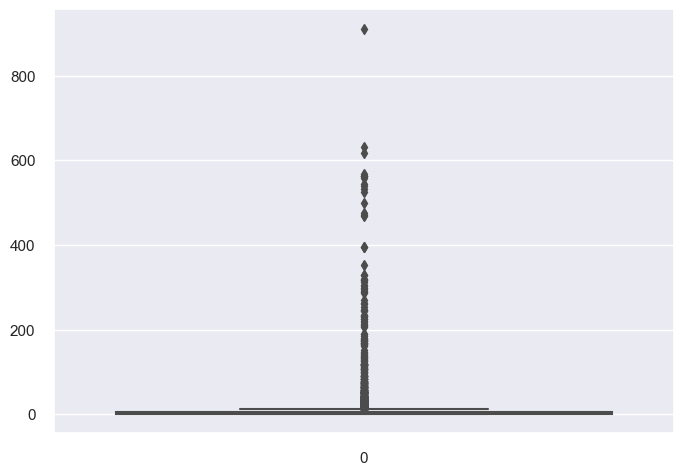

In [ ]:
sns.boxplot(tmp)

<AxesSubplot: >

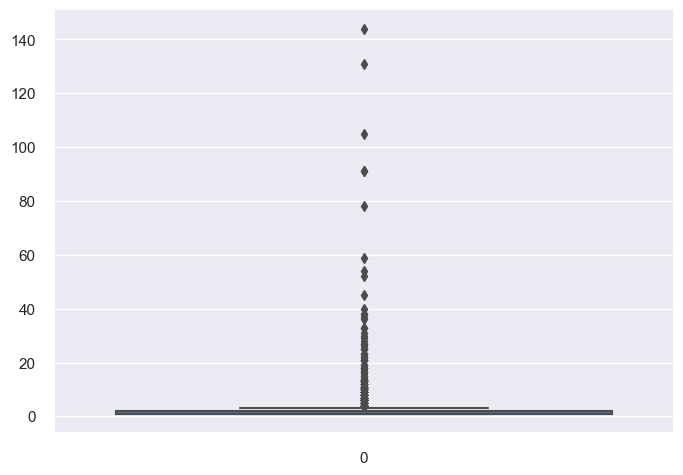

In [ ]:
sns.boxplot(tmp1)

Remarque:

- Très mauvaise distribution dans les corpus de documents : "Description"  & "Product_name"

#### List rare tokens

In [ ]:
# 1) Unique words --> not usefull

tmp = pd.Series(corpus).value_counts()
list_unique_words = tmp[tmp ==1]
list_unique_words[:10]

paraben        1
vinegar        1
glycol         1
oodles         1
ingredients    1
skip           1
bullshit       1
word           1
soapking       1
hop            1
dtype: int64

In [ ]:
# 2) Unique words --> not usefull

tmp1 = pd.Series(corpus1).value_counts()
list_unique_words1 = tmp1[tmp1 ==1]
list_unique_words1[:10]

carexemex           1
303                 1
38015pl01           1
prabhavali          1
menchappin          1
gtidy               1
multicolorireeya    1
wq18                1
careoxyglow         1
cmantiqueshop       1
dtype: int64

In [ ]:
#1) longueur des listes:
len(list_unique_words)


2114

In [ ]:
#2) longueur des listes:
len(list_unique_words1)

1851

In [ ]:
# #1) Save it for later
# 
# tmp = pd.DataFrame({"words": list_unique_words})
# tmp.to_csv("unique_words.csv",index=False)

In [ ]:
# #2) Save it for later
# 
# tmp1 = pd.DataFrame({"words": list_unique_words1})
# tmp1.to_csv("unique_words1.csv",index=False)

In [ ]:
# 1) Idem for min 5 times

tmp = pd.Series(corpus).value_counts()
list_min_5_words = tmp[tmp <= 5]
list_min_5_words[:10]

opener       5
dummy        5
marvel       5
ordinary     5
following    5
watche       5
belt         5
layers       5
trendnet     5
burner       5
dtype: int64

In [ ]:
# 2) Idem for min 5 times

tmp1 = pd.Series(corpus1).value_counts()
list_min_5_words_1 = tmp1[tmp1 <= 5]
list_min_5_words_1[:10]

water        5
33           5
statue       5
28           5
polo         5
photo        5
rose         5
deodorant    5
rajasthan    5
girls        5
dtype: int64

In [ ]:
len(list_min_5_words)

4677

In [ ]:
len(list_min_5_words_1)

2338

In [ ]:
#  #1) Save it for later
# 
# list_min_5_words = list(list_min_5_words)
# tpm = pd.DataFrame({"words": list_min_5_words})
# tmp.to_csv("min_5_words.csv",index=False)

In [ ]:
#  #2) Save it for later
# 
# list_min_5_words_1 = list(list_min_5_words_1)
# tpm1 = pd.DataFrame({"words": list_min_5_words_1})
# tmp1.to_csv("min_5_words_1.csv",index=False)

In [ ]:
#1) idem for min 10 times

tmp = pd.Series(corpus).value_counts()
list_min_10_words = tmp[tmp <= 10]
list_min_10_words[:10]

gum          10
modern       10
lid          10
residue      10
reusable     10
bluetooth    10
213          10
luxury       10
trimning     10
plug         10
dtype: int64

In [ ]:
#2) idem for min 10 times

tmp1 = pd.Series(corpus1).value_counts()
list_min_10_words_1 = tmp1[tmp1 <= 10]
list_min_10_words_1[:10]

jewellery    10
pink         10
green        10
haveli       10
flexible     10
rice         10
paris        10
geometric    10
pizza        10
vitamin      10
dtype: int64

In [ ]:
len(list_min_10_words)

5302

In [ ]:
len(list_min_10_words_1)

2451

In [ ]:
# #1) Save it :
#  
# list_min_10_words = list(list_min_10_words)
# tpm = pd.DataFrame({"words": list_min_10_words})
# tmp.to_csv("min_10_words.csv",index=False)

In [ ]:
# #2) Save it :
#  
# list_min_10_words = list(list_min_10_words_1)
# tpm1 = pd.DataFrame({"words": list_min_10_words_1})
# tmp1.to_csv("min_10_words_1.csv",index=False)

#### Cleaning Function n°2 :

In [ ]:
def process_text_2(doc,
                   rejoin=False,
                   list_rare_word=None, #liste des mots rare
                   min_len_word=3, #taille min pour un token qu'on le garde
                   force_is_alpha=True): # garder que des tokens alphabétique
  """
cf process_text_1 mais avec list_unique_words,min_len_words et force_is_alpha
  
  arguments positionnels :
  ---------------------
  doc : str : le document (c'est-à-dire un texte au format str) à traiter
  
  arguments opt :
  ---------------------
  rejoin : bool : si True renvoie une chaîne, sinon renvoie la liste des jetons
  list_rare_words : list : une liste de mots rares à exclure
  min_le_word: int : la longueur minimale des mots à ne pas exclure
  force_is_alpha : int : si 1, exclut tous les jetons avec un caractère numérique
  
  revenir :
  ---------------------
  une chaîne (si rejoin est True) ou une liste de jetons
  
   """

   #list_unique_words 
  if not list_rare_word:
       list_rare_word = []

   #lower
  doc = doc.lower().strip()

   #tokenize
  tokenizer =RegexpTokenizer(r"\w+")
  raw_tokens_list = tokenizer.tokenize(doc)

   #classic stopwords
  cleaned_tokens_list = [w for w in raw_tokens_list if w not in stop_words]

   #######################################################
   #######################################################

   #no rare tokens
  non_rare_tokens = [w for w in cleaned_tokens_list if w not in list_rare_word]

   #no more len words
  more_than_N = [w for w in non_rare_tokens if len(w) >= min_len_word ] #selectionner uniquement les mots qui + N_lettre

   #only alpha chars 
  if force_is_alpha:
     alpha_tokens = [w for w in more_than_N if w.isalpha()] 
  else:
     alpha_tokens = more_than_N

  #########################################################
  #########################################################

   #manage return type
  if rejoin : 
     return "".join(alpha_tokens)
  return alpha_tokens

In [ ]:
# Avant traitement de text - doc 1
display_token_info(corpus)

nb tokens61452,nb tokens uniques 6165
['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', '213', 'cm', 'height', 'pack', '2', 'price', 'rs', '899', 'curtain', 'enhances', 'look', 'interiors']


In [ ]:
# Avant traitement de text - doc 1
display_token_info(corpus1)

nb tokens6191,nb tokens uniques 2531
['elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtainsathiyas', 'cotton', 'bath', 'toweleurospa', 'cotton', 'terry', 'face', 'towel', 'setsantosh', 'royal', 'fashion', 'cotton', 'printed', 'king', 'sized', 'double', 'bedsheetjaipur', 'print', 'cotton', 'floral', 'king', 'sized', 'double', 'bedsheetmaserati']


In [ ]:
len(set(corpus))

6165

In [ ]:
len(set(corpus1))

2531

In [ ]:
list_unique_words = list(list_unique_words.index)

In [ ]:
list_unique_words1[:10]

carexemex           1
303                 1
38015pl01           1
prabhavali          1
menchappin          1
gtidy               1
multicolorireeya    1
wq18                1
careoxyglow         1
cmantiqueshop       1
dtype: int64

In [ ]:
list_unique_words1 = list(list_unique_words1.index)

In [ ]:
list_unique_words1[:10]

['carexemex',
 '303',
 '38015pl01',
 'prabhavali',
 'menchappin',
 'gtidy',
 'multicolorireeya',
 'wq18',
 'careoxyglow',
 'cmantiqueshop']

In [ ]:
corpus = process_text_2(raw_corpus,
                        list_rare_word = list_unique_words,
                        rejoin= False)
display_token_info(corpus) # Après le traitement -> Réduction de dimension

nb tokens51097,nb tokens uniques 3396
['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'pack', 'price', 'curtain', 'enhances', 'look', 'interiors', 'curtain', 'made', 'high', 'quality', 'polyester']


In [ ]:
corpus1 = process_text_2(raw_corpus1,
                        list_rare_word = list_unique_words,
                        rejoin= False)
display_token_info(corpus1)

nb tokens4983,nb tokens uniques 1820
['elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtainsathiyas', 'cotton', 'bath', 'toweleurospa', 'cotton', 'terry', 'face', 'towel', 'setsantosh', 'royal', 'fashion', 'cotton', 'printed', 'king', 'sized', 'double', 'bedsheetjaipur', 'print', 'cotton', 'floral', 'king', 'sized', 'double', 'bedsheetmaserati']


#### 3rd Cleaning function

In [ ]:
def process_text_3(doc,
                   rejoin=False,
                   lemm_or_stemm = "stem",
                   list_rare_word=None, #liste des mots rare
                   min_len_word=3, #taille min pour un token qu'on le garde
                   force_is_alpha=True): # garder que des tokens alphabétique
  """
  cf process_text_2 mais avec stem ou lem
  
  arguments positionnels :
  ---------------------
  doc : str : le document (c'est-à-dire un texte au format str) à traiter
  
  arguments opt :
  ---------------------
  rejoin : bool : si True renvoie une chaîne, sinon renvoie la liste des jetons
  lemm_or_stem : str : if lem do lemmentize else stermmtize
  list_rare_words : list : une liste de mots rares à exclure
  min_le_word: int : la longueur minimale des mots à ne pas exclure
  force_is_alpha : int : si 1, exclut tous les jetons avec un caractère numérique
  
  revenir :
  ---------------------
  une chaîne (si rejoin est True) ou une liste de jetons
  
   """

   #list_unique_words 
  if not list_rare_word:
       list_rare_word = []

   #lower
  doc = doc.lower().strip()

   #tokenize
  tokenizer =RegexpTokenizer(r"\w+")
  raw_tokens_list = tokenizer.tokenize(doc)

   #classic stopwords
  cleaned_tokens_list = [w for w in raw_tokens_list if w not in stop_words]

   #######################################################
   #######################################################

   #no rare tokens
  non_rare_tokens = [w for w in cleaned_tokens_list if w not in list_rare_word]

   #no more len words
  more_than_N = [w for w in non_rare_tokens if len(w) >= min_len_word ] #selectionner uniquement les mots qui + N_lettre

   #only alpha chars 
  if force_is_alpha:
     alpha_tokens = [w for w in more_than_N if w.isalpha()] 
  else:
     alpha_tokens = more_than_N

  #########################################################
  #########################################################
  
  # Stem or lem 
  if lemm_or_stemm == "lem":
    trans = WordNetLemmatizer()
    trans_text = [trans.lemmatize(i) for i in alpha_tokens]
  else : 
    trans = PorterStemmer()
    trans_text = [trans.stem(i) for i in alpha_tokens]

  #########################################################
  #########################################################

   #manage return type
  if rejoin : 
     return "".join(alpha_tokens)
  return alpha_tokens

In [ ]:
corpus = process_text_3(raw_corpus,rejoin=False,list_rare_word=list_unique_words)
pd.Series(corpus).sample(10) # Exemple des 10 première tokens affiché au hasard

33897       genuine
19585    durability
44604         style
6485           klub
27614       cleaner
25875         times
15240      junction
50582      shipping
13848        online
790         quality
dtype: object

In [ ]:
len(set(corpus))

3396

In [ ]:
#2) -Product_name
corpus1 = process_text_3(raw_corpus1,rejoin=False,list_rare_word=list_unique_words)
pd.Series(corpus1).sample(10) # Exemple des 10 première tokens affiché au hasard

1258      anodised
4904      setprint
1211        natura
4921           pad
3551        decker
2556      mentimes
398       setprime
2405        analog
2171    batteryarb
531       handloom
dtype: object

In [ ]:
len(set(corpus1))

1820

In [ ]:
display_token_info(corpus)

nb tokens51097,nb tokens uniques 3396
['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'pack', 'price', 'curtain', 'enhances', 'look', 'interiors', 'curtain', 'made', 'high', 'quality', 'polyester']


In [ ]:
display_token_info(corpus1)

nb tokens4983,nb tokens uniques 1820
['elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtainsathiyas', 'cotton', 'bath', 'toweleurospa', 'cotton', 'terry', 'face', 'towel', 'setsantosh', 'royal', 'fashion', 'cotton', 'printed', 'king', 'sized', 'double', 'bedsheetjaipur', 'print', 'cotton', 'floral', 'king', 'sized', 'double', 'bedsheetmaserati']


#### 3.5 Only english words

- Conserver seulement les mots en anglais :

In [ ]:
#30 mots au hasard dans la liste 
pd.Series(words.words()).sample(30) 

154070         preinvite
110812          mammogen
99852         jentacular
16503        auxographic
155274      preternative
30730          Carlylian
135079    overhysterical
97765             inweed
166756       removedness
204238            toluyl
146434      picturecraft
205656      traitorously
52824       diamagnetism
129619         octennial
217607            unhigh
55772        disseminate
134352     overbrutality
108162     longiloquence
103159          kyphosis
101007      kaleidophone
26854           browsing
52055            destour
7692             analyse
84329        hemoproctia
161901            Quiina
221255         unqueened
59423        ecstaticize
193467          suitably
5682        allosyndetic
917        accidentalist
dtype: object

In [ ]:
#Dictionnaire fourni par nltk: + 230k WORDS
len(set(words.words()))

235892

In [ ]:
#Uniformiser seulement les mots 
eng_words = [i.lower() for i in words.words()]
eng_words[:30]

['a',
 'a',
 'aa',
 'aal',
 'aalii',
 'aam',
 'aani',
 'aardvark',
 'aardwolf',
 'aaron',
 'aaronic',
 'aaronical',
 'aaronite',
 'aaronitic',
 'aaru',
 'ab',
 'aba',
 'ababdeh',
 'ababua',
 'abac',
 'abaca',
 'abacate',
 'abacay',
 'abacinate',
 'abacination',
 'abaciscus',
 'abacist',
 'aback',
 'abactinal',
 'abactinally']

In [ ]:
len(set(eng_words))

234377

In [ ]:
ps = PorterStemmer()
eng_words_stem = [ps.stem(i) for i in eng_words]
display_token_info(eng_words_stem)

nb tokens236736,nb tokens uniques 178311
['a', 'a', 'aa', 'aal', 'aalii', 'aam', 'aani', 'aardvark', 'aardwolf', 'aaron', 'aaron', 'aaron', 'aaronit', 'aaronit', 'aaru', 'ab', 'aba', 'ababdeh', 'ababua', 'abac', 'abaca', 'abac', 'abacay', 'abacin', 'abacin', 'abaciscu', 'abacist', 'aback', 'abactin', 'abactin']


In [ ]:
len(set(eng_words_stem))

178311

In [ ]:
lm = WordNetLemmatizer()
eng_words_lem = [lm.lemmatize(i) for i in eng_words]
display_token_info(eng_words_lem)

nb tokens236736,nb tokens uniques 233450
['a', 'a', 'aa', 'aal', 'aalii', 'aam', 'aani', 'aardvark', 'aardwolf', 'aaron', 'aaronic', 'aaronical', 'aaronite', 'aaronitic', 'aaru', 'ab', 'aba', 'ababdeh', 'ababua', 'abac', 'abaca', 'abacate', 'abacay', 'abacinate', 'abacination', 'abaciscus', 'abacist', 'aback', 'abactinal', 'abactinally']


In [ ]:
len(set(eng_words_lem))

233450

#### 4th.Cleaning Function

In [ ]:
def process_text_4(doc,
                   rejoin=False,
                   lemm_or_stemm = "stem",
                   list_rare_word=None, #liste des mots rare
                   min_len_word=3, #taille min pour un token qu'on le garde
                   force_is_alpha=True,# garder que des tokens alphabétique
                   eng_words=None): # garder les mots en anglais
  """
  cf process_text_3 mais avec sélection de mots anglais uniquement
  
  arguments positionnels :
  ---------------------
  doc : str : le document (c'est-à-dire un texte au format str) à traiter
  
  arguments opt :
  ---------------------
  rejoin : bool : si True renvoie une chaîne, sinon renvoie la liste des jetons
  eng_words: list : liste de mots anglais
  lemm_or_stem : str : if lem do lemmentize else stermmtize
  list_rare_words : list : une liste de mots rares à exclure
  min_le_word: int : la longueur minimale des mots à ne pas exclure
  force_is_alpha : int : si 1, exclut tous les jetons avec un caractère numérique
  
  revenir :
  ---------------------
  une chaîne (si rejoin est True) ou une liste de jetons
  
   """

   #list_unique_words 
  if not list_rare_word:
       list_rare_word = []

   #lower
  doc = doc.lower().strip()

   #tokenize
  tokenizer =RegexpTokenizer(r"\w+")
  raw_tokens_list = tokenizer.tokenize(doc)

   #classic stopwords
  cleaned_tokens_list = [w for w in raw_tokens_list if w not in stop_words]

   #######################################################
   #######################################################

   #no rare tokens
  non_rare_tokens = [w for w in cleaned_tokens_list if w not in list_rare_word]

   #no more len words
  more_than_N = [w for w in non_rare_tokens if len(w) >= min_len_word ] #selectionner uniquement les mots qui + N_lettre

   #only alpha chars 
  if force_is_alpha:
     alpha_tokens = [w for w in more_than_N if w.isalpha()] 
  else:
     alpha_tokens = more_than_N

  #########################################################
  #########################################################
  
  # Stem or lem 
  if lemm_or_stemm == "lem":
    trans = WordNetLemmatizer()
    trans_text = [trans.lemmatize(i) for i in alpha_tokens]
  else : 
    trans = PorterStemmer()
    trans_text = [trans.stem(i) for i in alpha_tokens]

  #########################################################
  #########################################################

  # In English 
  if eng_words:
    engl_text = [i for i in trans_text if i in eng_words]
  else :
    engl_text = trans_text


  #########################################################
  #########################################################

   #manage return type
  if rejoin : 
     return "".join(engl_text)
  return alpha_tokens

In [ ]:
# Doc - "Description":

corpus = process_text_4(raw_corpus,
                        rejoin=False,
                        list_rare_word = list_unique_words,
                        eng_words=eng_words_stem)
display_token_info(corpus)

nb tokens51097,nb tokens uniques 3396
['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'pack', 'price', 'curtain', 'enhances', 'look', 'interiors', 'curtain', 'made', 'high', 'quality', 'polyester']


In [ ]:
len(set(corpus))

3396

In [ ]:
# Doc - "Product_name":
corpus1 = process_text_4(raw_corpus1,
                        rejoin=False,
                        list_rare_word = list_unique_words,
                        eng_words=eng_words_stem)
display_token_info(corpus1)

nb tokens4983,nb tokens uniques 1820
['elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtainsathiyas', 'cotton', 'bath', 'toweleurospa', 'cotton', 'terry', 'face', 'towel', 'setsantosh', 'royal', 'fashion', 'cotton', 'printed', 'king', 'sized', 'double', 'bedsheetjaipur', 'print', 'cotton', 'floral', 'king', 'sized', 'double', 'bedsheetmaserati']


In [ ]:
len(set(corpus1))

1820

In [ ]:
# Unique_words = 1
len(list_unique_words)

2114

In [ ]:
# Unique_words < 5 :
len(list_min_5_words)

4677

In [ ]:
# Unique_words <5:
len(list_min_5_words_1)

2338

In [ ]:
list_min_5_words = list(list_min_5_words.index)

In [ ]:
list_min_5_words_1 = list(list_min_5_words_1.index)

In [ ]:
corpus = process_text_4(raw_corpus,
                        rejoin=False,
                        list_rare_word = list_min_5_words,
                        eng_words = eng_words_stem)
display_token_info(corpus)

nb tokens45225,nb tokens uniques 1307
['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'height', 'pack', 'price', 'curtain', 'enhances', 'look', 'interiors', 'curtain', 'made', 'high', 'quality', 'polyester']


In [ ]:
len(set(corpus))

1307

In [ ]:
corpus1 = process_text_4(raw_corpus,
                        rejoin=False,
                        list_rare_word = list_min_5_words_1,
                        eng_words = eng_words_stem)
display_token_info(corpus1)

nb tokens38716,nb tokens uniques 3855
['features', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'floral', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'height', 'pack', 'price', 'enhances', 'interiors', 'made', 'polyester', 'fabric', 'features', 'eyelet', 'stitch', 'makes', 'room', 'environment', 'romantic', 'loving', 'ant', 'wrinkle']


In [ ]:
len(set(corpus1))

3855

In [ ]:
tmp = pd.Series(corpus).value_counts()
tmp

products    631
free        618
delivery    567
shipping    564
genuine     564
           ... 
blush         6
nights        6
glasses       6
trends        6
maker         6
Length: 1307, dtype: int64

In [ ]:
tmp1 = pd.Series(corpus1).value_counts()
tmp1

delivery       567
genuine        564
cash           564
shipping       564
replacement    559
              ... 
holders          1
helped           1
leg              1
canopy           1
ayurveda         1
Length: 3855, dtype: int64

#### 3.7 Worldcloud

In [ ]:
from wordcloud import WordCloud

In [ ]:
# import matplotlib.pyplot as plt

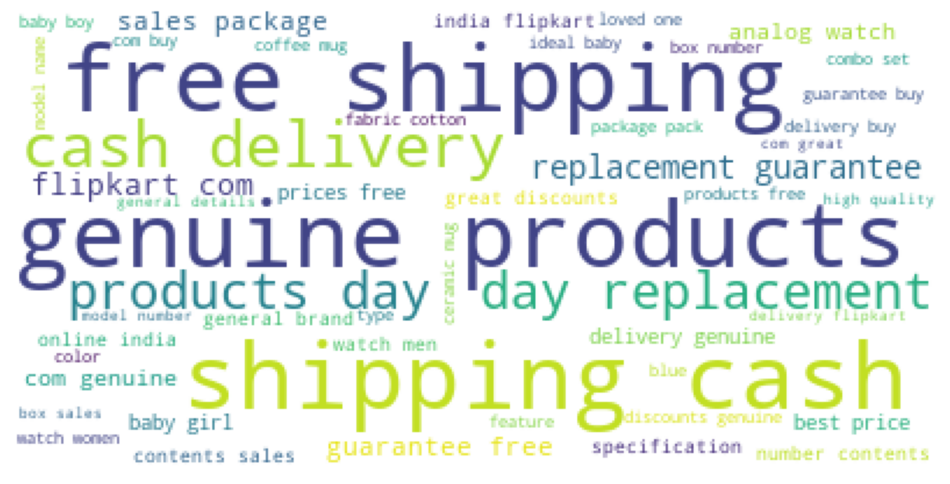

In [ ]:
figure = plt.figure(figsize=(12,8))
wordcloud = WordCloud(background_color='white',
                      stopwords=[],
                      max_words=50).generate(" ".join(corpus))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

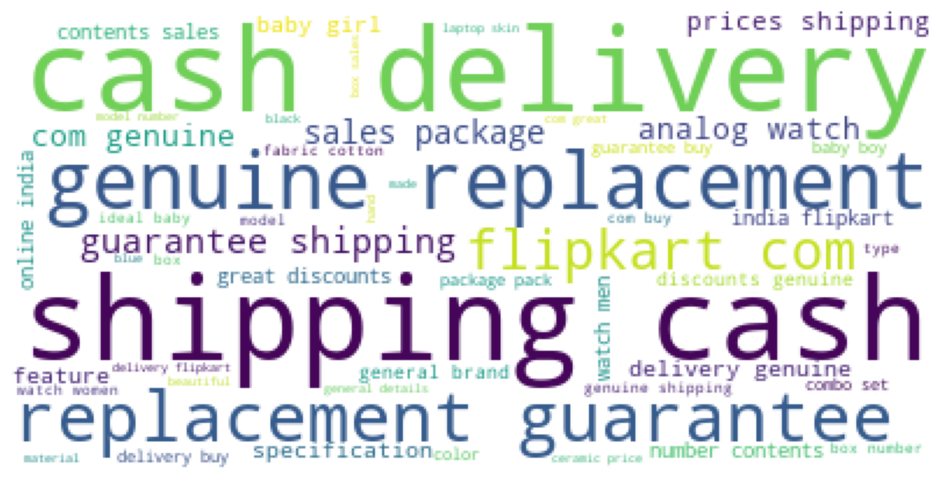

In [ ]:
figure = plt.figure(figsize=(12,8))
wordcloud1 = WordCloud(background_color='white',
                      stopwords=[],
                      max_words=50).generate(" ".join(corpus1))
plt.imshow(wordcloud1)
plt.axis('off')
plt.show()

#### Divide the corpus
 
 - Separate for différents catégory

In [ ]:
#Catégories 

df_THome = df6[df6.categories_1 == "Home Furnishing"]
df_TBaby = df6[df6.categories_1 == "BabyCare"]
df_TWatches = df6[df6.categories_1 == "Watches"]
df_THomeDeco = df6[df6.categories_1 == "Home Decor & Festive Needs"]
df_TKitchen = df6[df6.categories_1 == "Kitchen & Dining"]
df_TBeauty = df6[df6.categories_1 == "Beauty and Personal Care"]
df_TComputer = df6[df6.categories_1 == "Computers"]

In [ ]:
df6.categories_1.unique()

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [ ]:
df_THomeDeco.head()

,product_name,description,categories_1
36,Myesquire Ceramic Burner Pot Lemongrass Liquid...,Myesquire Ceramic Burner Pot Lemongrass Liquid...,Home Decor & Festive Needs
80,VarEesha Wooden Key Holder,Key Features of VarEesha Wooden Key Holder Han...,Home Decor & Festive Needs
81,Treasure Showpiece - 23 cm,Key Features of Treasure Showpiece - 23 cm P...,Home Decor & Festive Needs
84,@home Glass Vase,"Specifications of @home Glass Vase (18 inch, G...",Home Decor & Festive Needs
85,Smart Wall Guru Medium Adhesive Sticker,Key Features of Smart Wall Guru Medium Adhesiv...,Home Decor & Festive Needs


In [ ]:
corpus_a = " ".join(df_THome.description)
corpus_b = " ".join(df_TBaby.description)
corpus_c = " ".join(df_TWatches.description)
corpus_d = " ".join(df_THomeDeco.description)
corpus_e = " ".join(df_TKitchen.description)
corpus_f = " ".join(df_TBeauty.description)
corpus_g = " ".join(df_TComputer.description)

In [ ]:
corpus_a1 = " ".join(df_THome.product_name)
corpus_b1 = " ".join(df_TBaby.product_name)
corpus_c1 = " ".join(df_TWatches.product_name)
corpus_d1 = " ".join(df_THomeDeco.product_name)
corpus_e1 = " ".join(df_TKitchen.product_name)
corpus_f1 = " ".join(df_TBeauty.product_name)
corpus_g1 = " ".join(df_TComputer.product_name)

In [ ]:
corpus_a1[:1000]

"Elegance Polyester Multicolor Abstract Eyelet Door Curtain SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet Jaipur Print Cotton Floral King sized Double Bedsheet SANTOSH ROYAL FASHION Cotton Embroidered Diwan Set House This Queen Cotton Duvet Cover Riva Carpets Cotton Free Bath Mat Classic Loop Shag Bathmat_RI-527 JMD Printed Cushions Cover Kripa's Printed Cushions Cover Prime Printed 4 Seater Table Cover Prime Printed 8 Seater Table Cover Jaipur Print Cotton Floral Diwan Set Craft Trade Oval Wood Coaster Set Rama Floral Single Quilts & Comforters Pink-Red Rama Floral Single Quilts & Comforters Yellow Shop Rajasthan Abstract Single Dohar Multicolor Artisan Creation Checkered Single Quilts & Comforters Brown Rama Floral Single Quilts & Comforters Blue-Beige Remtex Export Cartoon Single Dohar Multicolor Quilt India Floral Cushions Cover Bhavya Velvet Sofa Cover Dreamshomes Velvet Sofa Cover JewelKraft Designs Brown, Pink Table Linen Set Tidy Printed Cushions Cover JBC Col

In [ ]:
corpus_a[:1000]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

#### Process both of them

In [ ]:
# Doc - "Description"

corpus_a = process_text_4(corpus_a,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_b = process_text_4(corpus_b,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_c = process_text_4(corpus_c,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_d = process_text_4(corpus_d,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)
                          
corpus_e = process_text_4(corpus_e,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_f = process_text_4(corpus_f,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)


corpus_g = process_text_4(corpus_g,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)



In [ ]:
# Doc - "Product_name"

corpus_a1 = process_text_4(corpus_a1,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_b1 = process_text_4(corpus_b1,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_c1 = process_text_4(corpus_c1,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_d1 = process_text_4(corpus_d1,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)
                          
corpus_e1 = process_text_4(corpus_e1,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

corpus_f1 = process_text_4(corpus_f1,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)


corpus_g1 = process_text_4(corpus_g1,
                          rejoin=False,
                          list_rare_word = list_min_5_words,
                          eng_words = eng_words_stem)

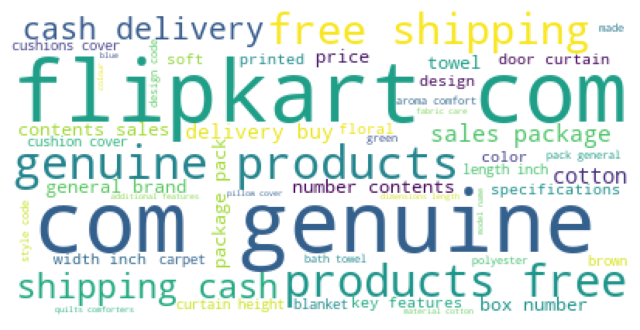

In [ ]:
wordcloud = WordCloud(background_color='white',
                      stopwords=[],
                      max_words = 50).generate(" ".join(corpus_a))

plt.imshow(wordcloud)
plt.axis("off")
plt.show()

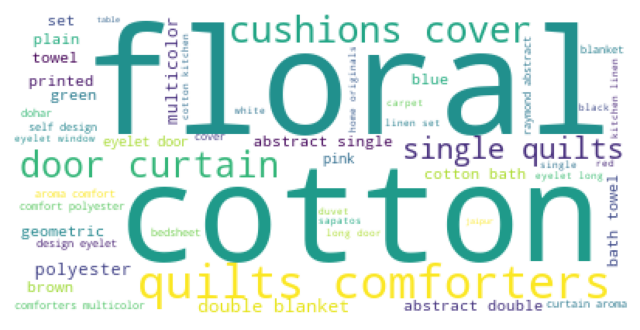

In [ ]:
wordcloud = WordCloud(background_color='white',
                      stopwords=[],
                      max_words = 50).generate(" ".join(corpus_a1))

plt.imshow(wordcloud)
plt.axis("off")
plt.show()

In [ ]:
pd.Series(corpus_a).value_counts().head(5)

cotton      103
pack         88
cover        84
products     77
buy          77
dtype: int64

In [ ]:
pd.Series(corpus_a1).value_counts().head(5)

cotton      35
single      34
abstract    32
double      28
floral      25
dtype: int64

In [ ]:
n = 10 # 10mots
doublons = [i for i in pd.Series(corpus_a).value_counts().head(n).index
            if i in pd.Series(corpus_b).value_counts().head(n).index]
doublons

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\276064418.py:3: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if i in pd.Series(corpus_b).value_counts().head(n).index]
C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\276064418.py:3: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if i in pd.Series(corpus_b).value_counts().head(n).index]
C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\276064418.py:3: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  if i in pd.Series(corpus_b).value_counts().head(n).index]
C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\276064418.py:3: FutureWarning: The default dtype for empty Series will be 'object' instea

[]

#### 5th Cleaning function

In [ ]:
def process_text_5(doc,
                   rejoin=False,
                   lemm_or_stemm = "stem",
                   list_rare_word=None, #liste des mots rare
                   min_len_word=3, #taille min pour un token qu'on le garde
                   force_is_alpha=True,# garder que des tokens alphabétique
                   eng_words=None, # garder les mots en anglais
                   extra_words=None): # exclure les listes de mots extra | ajouter arbitrairement
  """
  df v4 process_text_4 mais exclure une liste supplémentaire
  
  arguments positionnels :
  ---------------------
  doc : str : le document (c'est-à-dire un texte au format str) à traiter
  
  arguments opt :
  ---------------------
  rejoin : bool : si True renvoie une chaîne, sinon renvoie la liste des jetons
  eng_words: list : liste de mots anglais
  lemm_or_stem : str : if lem do lemmentize else stermmtize
  list_rare_words : list : une liste de mots rares à exclure
  min_le_word: int : la longueur minimale des mots à ne pas exclure
  force_is_alpha : int : si 1, exclut tous les jetons avec un caractère numérique
  
  revenir :
  ---------------------
  une chaîne (si rejoin est True) ou une liste de jetons
  
   """

   #list_unique_words 
  if not list_rare_word:
       list_rare_word = []

   #Extra_words
  if not list_rare_word:
    list_rare_word =[]

   #lower
  doc = doc.lower().strip()

   #tokenize
  tokenizer =RegexpTokenizer(r"\w+")
  raw_tokens_list = tokenizer.tokenize(doc)

   #remove stop words
  cleaned_tokens_list = [w for w in raw_tokens_list if w not in stop_words]

   #######################################################
   #######################################################

   #drop rare tokens
  non_rare_tokens = [w for w in cleaned_tokens_list if w not in list_rare_word]

   #keep only len word > N
  more_than_N = [w for w in non_rare_tokens if len(w) >= 3 ] #selectionner uniquement les mots qui + N_lettre

   #keep only alpha not num
  
  alpha_num = [w for w in more_than_N if w.isalpha()] 
  
  #########################################################
  #########################################################
  
  # Stem or lem 
  if lemm_or_stemm == "lem":
    trans = WordNetLemmatizer()
    trans_text = [trans.lemmatize(i) for i in alpha_num]
  else : 
    trans = PorterStemmer()
    trans_text = [trans.stem(i) for i in alpha_num]

  #########################################################
  #########################################################

  # In English 
  if eng_words:
    engl_text = [i for i in trans_text if i in eng_words]
  else :
    engl_text = trans_text
  
  #########################################################
  #########################################################

  #drop extra_words tokens

  final = [w for w in engl_text if w not in extra_words]


  #########################################################
  #########################################################

   #manage return type
  if rejoin : 
     return " ".join(final)
  return engl_text


#### Last.Clean

In [ ]:
def final_clean(doc) :
  """ perform our final cleaning """

  new_doc = process_text_5(doc, #sur notre corpus
                           rejoin=True, #renvoyer une chaine caratere
                           lemm_or_stemm="stem",
                           list_rare_word=list_min_5_words, #supprimer les mots présente 5 fois ou moins
                           eng_words=eng_words_stem, # supprimer certaine mots non  anglais 
                           extra_words=doublons) #Eliminer les doublons
  return new_doc

In [ ]:
df6['clean_description'] = df6.description.apply(final_clean)

In [ ]:
df6.sample(10)

,product_name,description,categories_1,clean_description
835,Amaze Fashion Universal Portable Lamp PL014AMA...,Buy Amaze Fashion Universal Portable Lamp PL01...,Computers,buy fashion univers portabl lamp led light fas...
490,HP Compaq Presario CQ43 6 Cell Laptop Battery,Buy HP Compaq Presario CQ43 6 Cell Laptop Batt...,Computers,buy cell batteri genuin product day replac gua...
619,FS Mini Klub Baby Boy's Bodysuit,Key Features of FS Mini Klub Baby Boy's Bodysu...,Baby Care,key featur mini babi boy fabric cotton brand c...
820,Mxofere Combo Rose Soap And Aloevera Lemon Fac...,Buy Mxofere Combo Rose Soap And Aloevera Lemon...,Beauty and Personal Care,buy rose soap lemon kit rose soap lemon kit be...
330,Asus RT-N12 LX 300Mbps Wireless Router,Buy Asus RT-N12 LX 300Mbps Wireless Router onl...,Computers,buy wireless router genuin product day replac ...
39,JMD Printed Cushions Cover,Key Features of JMD Printed Cushions Cover Pri...,Home Furnishing,key featur print cushion cover print size made...
31,"Lenco Bdblue Tango Analog Watch - For Men, Boys","Lenco Bdblue Tango Analog Watch - For Men, Bo...",Watches,analog watch men boy buy analog watch men boy ...
494,Sonata Gold Plated GOLDP Analog Watch - For Men,Sonata Gold Plated GOLDP Analog Watch - For M...,Watches,sonata gold plate analog watch men buy sonata ...
992,Pedrini Steel Waiters Corkscrew,Pedrini Steel Waiters Corkscrew\r\n ...,Kitchen & Dining,steel price
1031,Kerastase Nutritive Bain Satin 1 Complete Nutr...,Specifications of Kerastase Nutritive Bain Sat...,Beauty and Personal Care,specif satin complet shampoo shampoo trait hai...


In [ ]:
df6['clean_product_name'] = df6.product_name.apply(final_clean)
df6.sample(10)

,product_name,description,categories_1,clean_description,clean_product_name
111,Eternity Handcrafted unique Mosaic Glass Table...,Specifications of Eternity Handcrafted unique ...,Home Decor & Festive Needs,specif handcraft uniqu glass tabl lamp blue bo...,handcraft uniqu glass tabl lamp
551,Timewel 1100-N2017 Analog Watch - For Women,Timewel 1100-N2017 Analog Watch - For Women -...,Watches,analog watch buy analog watch india great disc...,analog watch
670,MH MDF Photo Frame,Buy MH MDF Photo Frame for Rs.899 online. MH M...,Baby Care,buy photo frame photo frame best price free sh...,photo frame
490,HP Compaq Presario CQ43 6 Cell Laptop Battery,Buy HP Compaq Presario CQ43 6 Cell Laptop Batt...,Computers,buy cell batteri genuin product day replac gua...,cell batteri
608,MohanJodero Jewellery Box Jewellery Vanity Jew...,Specifications of MohanJodero Jewellery Box Je...,Beauty and Personal Care,specif box vaniti multicolor case dimens weigh...,box vaniti
723,House This Yellow 150 cm Table Runner,Buy House This Yellow 150 cm Table Runner at R...,Home Furnishing,buy hous yellow tabl runner genuin product fre...,hous yellow tabl runner
803,Rega IT Hp Pavilion G6-1240SG G6-1241EA (65) 6...,Buy Rega IT Hp Pavilion G6-1240SG G6-1241EA (6...,Computers,buy pavilion adapt genuin product day replac g...,pavilion adapt
793,Ollington St. Collection Baby Reusable Diaper ...,Ollington St. Collection Baby Reusable Diaper ...,Baby Care,collect babi diaper one insert price form fit ...,collect babi diaper one insert
970,Bela Home Cotton Cartoon Single Bedsheet,Key Features of Bela Home Cotton Cartoon Singl...,Baby Care,key featur home cotton cartoon singl made pure...,home cotton cartoon singl
692,La Roche-Posay Anthelios XL Fluid Dry Touch Ge...,Flipkart.com: Buy La Roche-Posay Anthelios XL ...,Beauty and Personal Care,buy fluid dri touch cream price genuin product...,fluid dri touch cream


In [ ]:
df6.head()

,product_name,description,categories_1,clean_description,clean_product_name
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,key featur royal fashion cotton print king siz...,royal fashion cotton print king size doubl
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,key featur print cotton floral king size doubl...,print cotton floral king size doubl


---------------------
Suite :
- bag n words
- ti-idf
- vector embeding
- lda : ? Détection de topic dans un corpus
- nmf : ?  Autre méthode de détection de topic dans un corpus 

In [ ]:
df6.describe()

,product_name,description,categories_1,clean_description,clean_product_name
count,1050,1050,1050,1050,1050
unique,1050,1050,7,867,741
top,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,buy genuin product day replac guarante free sh...,
freq,1,1,150,21,51


In [ ]:
df6.shape

(1050, 5)

In [ ]:
#Vérifie s'il n'y pas de valeur manquante :
df6.isna().mean()

product_name          0.0
description           0.0
categories_1          0.0
clean_description     0.0
clean_product_name    0.0
dtype: float64

In [ ]:
# Check de la longueur des descriptions produits(avant traitement).
description_length = []

for i in df5['description']:
    description_length.append(len(i))
    

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\1602630907.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(description_length, color='green')


<AxesSubplot: title={'center': 'Boxplot (taille des descriptions produits// avant traitement)'}, xlabel='Longueur de la description'>

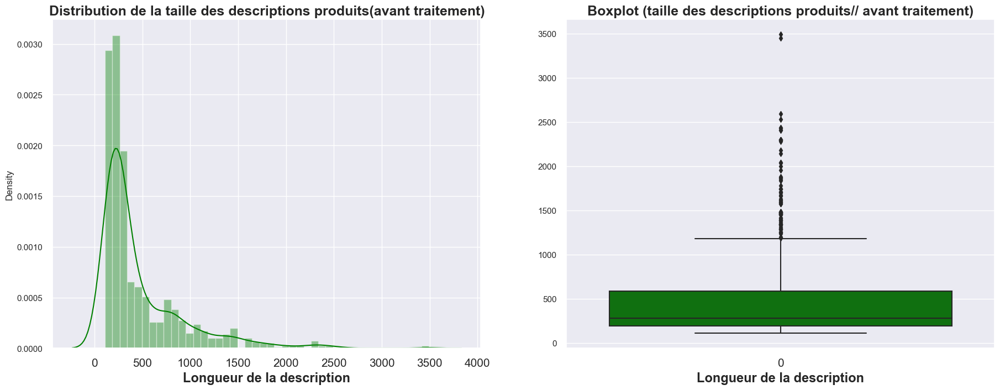

In [ ]:

plt.figure(figsize = (22, 17))

plt.subplot(2, 2, 1)
plt.xticks(size = 15)
plt.xlabel('Longueur de la description', weight='bold', size=17)
plt.title('Distribution de la taille des descriptions produits(avant traitement)',size = 18, weight = 'bold')
sns.distplot(description_length, color='green')

plt.subplot(2, 2, 2)
plt.xticks(size = 15)
plt.xlabel('Longueur de la description', weight='bold', size=17)
plt.title('Boxplot (taille des descriptions produits// avant traitement)',size = 18, weight = 'bold')
sns.boxplot(description_length, color='green')


In [ ]:
df6.head(2)

,product_name,description,categories_1,clean_description,clean_product_name
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel


Descriptif des articles :
- Vous trouverez un exemple de texte descriptif d'un produit :

In [ ]:
# Les catégories utilisés pour la résolution du problème de segmentation
categories = df6["categories_1"]

In [ ]:
print("La catégorie du produit est : {} \n".format(categories.iloc[0]))
print("La marque du produit est : {} \n".format(df["brand"].iloc[0]))
print("Le nom du produit est: {} \n".format(df6["product_name"].iloc[0]))
print("Le description du produit est : \n \n {}".format(df6["clean_description"].iloc[0]))


La catégorie du produit est : Home Furnishing 

La marque du produit est : Elegance 

Le nom du produit est: Elegance Polyester Multicolor Abstract Eyelet Door Curtain 

Le description du produit est : 
 
 key featur eleg polyest multicolor abstract eyelet door curtain floral curtain eleg polyest multicolor abstract eyelet door curtain height pack price curtain enhanc look interior curtain made high qualiti polyest fabric featur eyelet style metal ring make room curtain anti eleg give home bright appeal design sure contemporari eyelet curtain first morn bright want good morn whole world creat special beauti print bring home eleg curtain light room get right specif eleg polyest multicolor abstract eyelet door curtain height pack gener brand eleg design door type eyelet model name abstract polyest door curtain set model color multicolor dimens length box number content sale packag pack sale packag curtain bodi design materi polyest


In [ ]:
df6.head(3)

,product_name,description,categories_1,clean_description,clean_product_name
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set


--------------
### Tokenization :

La tokenisation est une technique courante qui divise une phrase en jetons, où un jeton peut être constitué de caractères, de mots, de phrases, de symboles ou d'autres éléments significatifs. En divisant les phrases en morceaux plus petits, cela aiderait à étudier les mots d'une phrase ainsi que les étapes suivantes du pipeline de la PNL, telles que la radicalisation.

Note : Les étapes de :

- Remove Stopwords (or/and Frequent words /Rare words) : ont été déjà réalisé grâce à la fonction "clean"- précédement;

In [ ]:
#Tokenizing the docs - "Description": 

df7 = df6
df7['Tokenized'] = df7['clean_description'].apply(word_tokenize)

df7.head(3)

,product_name,description,categories_1,clean_description,clean_product_name,Tokenized
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red..."
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,..."


### [Stemming](http://hunterheidenreich.com/blog/stemming-lemmatization-what/) :

Le stemming est un processus d'extraction d'un mot racine - identifiant une racine commune parmi diverses formes (par exemple, forme nominale singulière et plurielle) d'un mot, par exemple, les mots "jardinage", "jardinier" ou "jardins" partagent la même racine , jardin. La racine déracine les suffixes des mots pour fusionner des mots ayant des significations similaires sous leur racine standard.

Il existe trois principaux algorithmes de stemming utilisés de nos jours :

Porter - PorterStemmer()) : cet algorithme de radicalisation est plus ancien. Il date des années 1980 et sa principale préoccupation est de supprimer les terminaisons communes aux mots afin qu'ils puissent être résolus en une forme commune. Ce n'est pas trop complexe et le développement est gelé. En règle générale, c'est un joli stemmer de base de départ, mais il n'est pas vraiment conseillé de l'utiliser pour toute application de production/complexe. Au lieu de cela, il a sa place dans la recherche en tant que bel algorithme de base de base qui peut garantir la reproductibilité. C'est aussi un algorithme de stemming très doux par rapport aux autres.

Boule de neige - LancasterStemmer() : cet algorithme est également connu sous le nom d'algorithme de stemming Porter2. Il est presque universellement accepté comme meilleur que le stemmer Porter, étant même reconnu comme tel par l'individu qui a créé le stemmer Porter. Cela étant dit, il est également plus agressif que le stemmer Porter. Beaucoup de choses ajoutées au stemmer Snowball étaient dues à des problèmes constatés avec le stemmer Porter. Il y a une différence d'environ 5% dans la façon dont Snowball découle par rapport à Porter.

Lancaster - SnowballStemmer() : Juste pour le plaisir, l'algorithme de stemming de Lancaster est un autre algorithme que vous pouvez utiliser. Celui-ci est l'algorithme de stemming le plus agressif du groupe. Cependant, si vous utilisez le stemmer dans NLTK, vous pouvez très facilement ajouter vos propres règles personnalisées à cet algorithme. C'est un bon choix pour ça. Une plainte concernant cet algorithme de radical est qu'il est parfois trop agressif et peut vraiment transformer des mots en radicaux étranges. Assurez-vous simplement qu'il fait ce que vous voulez avant d'opter pour cette option !

##### PorterStemmer:

In [ ]:
from nltk.stem import PorterStemmer

def Function_Porter_Stemmer(description):
    """ Stem words in list of tokenized words with Porter Stemmer """

    stemmer = nltk.PorterStemmer()
    stems = [stemmer.stem(i) for i in description]
    return stems

In [ ]:
%time 

df7['Descrip_PS'] = df7['Tokenized'].apply(lambda x: Function_Porter_Stemmer(x))
df7.head(3)


CPU times: total: 0 ns
Wall time: 0 ns


,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red..."
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,..."


##### SnowballStemmer:

In [ ]:
from nltk.stem import SnowballStemmer

def Function_snowball_stemmer(description):
    """ Stem word in list of tokenized words with SnowballStemmer """

    stemmer = nltk.SnowballStemmer("english")
    stems = [stemmer.stem(i) for i in description]
    return stems

In [ ]:
%time 

df7["Descrip_SnowStem"] = df7['Tokenized'].apply(lambda x : Function_snowball_stemmer(x))
df7.head(3)

CPU times: total: 0 ns
Wall time: 0 ns


,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red..."
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,..."


##### LancasterStemmer :


In [ ]:
from nltk.stem import LancasterStemmer

def Function_lancaster_stemmer(description):
    """ Stem words in list of tokenized words with LancasterStemmer """

    stemmer = nltk.LancasterStemmer()
    stems = [stemmer.stem(i) for i in description]
    return stems

In [ ]:
%time 

df7['Descrip_Lancast'] = df7['Tokenized'].apply(lambda x :  Function_lancaster_stemmer(x))
df7.head(3)

CPU times: total: 0 ns
Wall time: 0 ns


,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ..."
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz..."


##### [Part of Speech Tagging (Pos Tagguing)](https://www.nltk.org/book/ch05.html):

Partie du balisage vocal (balisage POS) :
L'étiquetage de la partie du discours (étiquetage POS) distingue la partie du discours (nom, verbe, adjectif, etc.) de chaque mot dans le texte. C'est l'étape critique pour de nombreuses applications du NLP puisque, en identifiant le POS d'un mot, on peut en déduire sa signification contextuelle. Les packages NLTK offrent différents algorithmes de marquage POS, et dans ce cahier, nous utilisons une version combinée.

- pos_tag/ DefaultTagger
- UnigramTagger
- BigramTagger
- Peut également être une combinaison du tagueur bigramme, du tagueur unigramme et du tagueur par défaut

In [ ]:
import nltk.corpus
nltk.download('brown')

[nltk_data] Downloading package brown to
[nltk_data]     C:\Users\Shadow\AppData\Roaming\nltk_data...
[nltk_data]   Package brown is already up-to-date!


True

In [ ]:
from nltk.corpus import wordnet
from nltk.corpus import brown

wordnet_map = {"N":wordnet.NOUN,
               "V":wordnet.VERB,
               "J":wordnet.ADJ,
               "R":wordnet.ADV }
train_sents = brown.tagged_sents(categories='news')
t0 = nltk.DefaultTagger('NN')
t1 = nltk.UnigramTagger(train_sents,backoff = t0)
t2 = nltk.BigramTagger(train_sents,backoff = t1)

def pos_tag_wordnet(description,pos_tag_type="pos_tag"):

    """ Create pos_tag with wordnet format """    
    pos_tagged_description = t2.tag(description)

    # Map the pos tagging output with wordnet output
    pos_tagged_description = [(word,wordnet_map.get(pos_tag[0])) if pos_tag[0] in wordnet_map.keys() else (word,wordnet.NOUN) for (word,pos_tag) in pos_tagged_description]

    return pos_tagged_description


In [ ]:
pos_tag_wordnet(df7['Tokenized'][2])

[('key', 'n'),
 ('featur', 'n'),
 ('cotton', 'n'),
 ('terri', 'n'),
 ('face', 'v'),
 ('towel', 'n'),
 ('set', 'v'),
 ('size', 'n'),
 ('small', 'a'),
 ('height', 'n'),
 ('inch', 'n'),
 ('cotton', 'n'),
 ('terri', 'n'),
 ('face', 'v'),
 ('towel', 'n'),
 ('set', 'v'),
 ('piec', 'n'),
 ('face', 'v'),
 ('towel', 'n'),
 ('set', 'v'),
 ('assort', 'n'),
 ('price', 'n'),
 ('bring', 'v'),
 ('design', 'n'),
 ('soft', 'a'),
 ('cotton', 'n'),
 ('towel', 'n'),
 ('qualiti', 'n'),
 ('product', 'n'),
 ('soft', 'a'),
 ('care', 'n'),
 ('skin', 'n'),
 ('give', 'v'),
 ('bath', 'n'),
 ('towel', 'n'),
 ('brand', 'n'),
 ('year', 'n'),
 ('famou', 'n'),
 ('fine', 'a'),
 ('print', 'n'),
 ('durabl', 'n'),
 ('note', 'n'),
 ('product', 'n'),
 ('cotton', 'n'),
 ('product', 'n'),
 ('color', 'n'),
 ('may', 'n'),
 ('vari', 'n'),
 ('pictur', 'n'),
 ('size', 'n'),
 ('may', 'n'),
 ('vari', 'n'),
 ('wash', 'v'),
 ('care', 'n'),
 ('wash', 'v'),
 ('cold', 'a'),
 ('water', 'n'),
 ('iron', 'v'),
 ('bleach', 'n'),
 ('flat', 'n'

In [ ]:
%time 

df7['Descrip_Postag'] = df7["Tokenized"].apply(lambda x : pos_tag_wordnet(x))
df7.head(3)

CPU times: total: 0 ns
Wall time: 0 ns


,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ..."
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz...","[(key, n), (featur, n), (cotton, n), (terri, n..."


##### Lemmatization:
According to the [Speech and Language Processing](https://web.stanford.edu/~jurafsky/slp3/ed3book.pdf) book:

La lemmatisation consiste à déterminer que deux mots ont la même racine, malgré leurs différences de surface. Les mots am, are et is ont pour lemme partagé be ; les mots dîner et dîners ont tous deux le lemme dîner. Lemmatiser chacune de ces formes au même lemme nous permettra de trouver toutes les mentions de mots en russe comme Moscou. La forme lemmatisée d'une phrase comme: "Il lit des romans policiers serait donc Il est lu roman policier" ;

[Natural Language Processing](https://www.manning.com/books/natural-language-processing-in-action) in Action:

Certains lemmatiseurs utilisent la balise de la partie du discours (POS) du mot en plus de son orthographe pour aider à améliorer la précision. La balise POS d'un mot indique son rôle dans la grammaire d'une expression ou d'une phrase. Par exemple, le nom POS est pour les mots qui font référence à "des personnes, des lieux ou des choses" dans une phrase. Un adjectif POS désigne un mot qui modifie ou décrit un nom. Un verbe désigne une action. Le POS d'un mot pris isolément ne peut pas être déterminé. Le contexte d'un mot doit être connu pour que son POS soit identifié. Ainsi, certains lemmatiseurs avancés ne peuvent pas être exécutés sur des mots isolés.


Par exemple, le "bon", "mieux" ou "meilleur" est lemmatisé en bien et le verbe "jardiner" devrait être lemmatisé en "jardiner", tandis que "jardin" et "jardinier" sont tous deux des lemmes différents.

In [ ]:
from nltk.stem import WordNetLemmatizer 

def Function_lemmatiez_word(description):
    """ Lemmatizer = WordNetLemmatizer """

    lemmatizer = WordNetLemmatizer()
    lemma = [lemmatizer.lemmatize(word,tag) for word,tag in description]
    return lemma

##### Lemmatization without POS Tagging :


In [ ]:
%time 

#nltk.download("stopwords")
#from nltk.corpus import stopwords

#Lemm wihout POS Tagging 
lemmatizer = WordNetLemmatizer()


stop = set(stopwords.words('english'))

df7['Descrip_Lemm_WithO_Pos'] = df7['Tokenized'].apply(lambda x : [lemmatizer.lemmatize(word) for word in x])
df7['Descrip_Lemm_WithO_Pos'] = df7['Descrip_Lemm_WithO_Pos'].apply(lambda x : [word for word in x if word not in stop ])

df7.head(3)

CPU times: total: 0 ns
Wall time: 0 ns


,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red..."
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz...","[(key, n), (featur, n), (cotton, n), (terri, n...","[key, featur, cotton, terri, face, towel, set,..."


In [ ]:
print(df7['Descrip_Postag'][8])
print("-"*75)
print(df7["Descrip_Lemm_WithO_Pos"][8])

[('digit', 'n'), ('watch', 'v'), ('men', 'n'), ('boy', 'n'), ('buy', 'v'), ('digit', 'n'), ('watch', 'v'), ('men', 'n'), ('boy', 'n'), ('india', 'n'), ('time', 'n'), ('around', 'r'), ('world', 'n'), ('daili', 'n'), ('great', 'a'), ('discount', 'n'), ('genuin', 'n'), ('product', 'n'), ('day', 'n'), ('replac', 'n'), ('guarante', 'n'), ('free', 'a'), ('ship', 'n'), ('cash', 'n'), ('deliveri', 'n')]
---------------------------------------------------------------------------
['digit', 'watch', 'men', 'boy', 'buy', 'digit', 'watch', 'men', 'boy', 'india', 'time', 'around', 'world', 'daili', 'great', 'discount', 'genuin', 'product', 'day', 'replac', 'guarante', 'free', 'ship', 'cash', 'deliveri']


##### Lemmatization with POS Tagging : 

In [ ]:
%time 

#With POS Tagging
lemmatizer = WordNetLemmatizer()

df7["Descrip_Lemm_With_Pos"] = df7["Descrip_Postag"].apply(lambda x:Function_lemmatiez_word(x))
#Double check to remove stop words
df7["Descrip_Lemm_With_Pos"] = df7["Descrip_Lemm_With_Pos"].apply(lambda x:[word for word in x if word not in stop ]) 
#Join back to "description"
df7["Descrip_Lemmatize"] = [' '.join(map(str,l))for l in df7["Descrip_Lemm_With_Pos"]]

df7.head(3)


CPU times: total: 0 ns
Wall time: 0 ns


,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos,Descrip_Lemm_With_Pos,Descrip_Lemmatize
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...",key featur eleg polyest multicolor abstract ey...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...",specif cotton bath towel bath towel red yellow...
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz...","[(key, n), (featur, n), (cotton, n), (terri, n...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...",key featur cotton terri face towel set size sm...


In [ ]:
print(df7['description'][8])
print("  ")
print(df7['Descrip_Postag'][8])
print("-"*75)
print(df7['Descrip_Lemm_WithO_Pos'][8])
print(' ')
print(df7['Descrip_Lemm_With_Pos'][8])


Alfajr WY16B Youth Digital Watch  - For Men, Boys - Buy Alfajr WY16B Youth Digital Watch  - For Men, Boys  WY16B Online at Rs.4995 in India Only at Flipkart.com. Azan Times ( For All Cities Around The World ), Prayer Reminders, Qibla Direction, Hijri And Gregorian Calnedars, Qur'An Bookmark, Daily Alrams - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!
  
[('digit', 'n'), ('watch', 'v'), ('men', 'n'), ('boy', 'n'), ('buy', 'v'), ('digit', 'n'), ('watch', 'v'), ('men', 'n'), ('boy', 'n'), ('india', 'n'), ('time', 'n'), ('around', 'r'), ('world', 'n'), ('daili', 'n'), ('great', 'a'), ('discount', 'n'), ('genuin', 'n'), ('product', 'n'), ('day', 'n'), ('replac', 'n'), ('guarante', 'n'), ('free', 'a'), ('ship', 'n'), ('cash', 'n'), ('deliveri', 'n')]
---------------------------------------------------------------------------
['digit', 'watch', 'men', 'boy', 'buy', 'digit', 'watch', 'men', 'boy', 'india', 'time', 'around', 'world', 'da

Remarque : 

- Nous pouvons observer l'évolution du corpus  à travers les différens étapes de pré-processing 

- de plus l'étape de "lemmatization" avec ou non la précision du "Pos-Taggin" ne semble pas changer grand chose ici.

In [ ]:
display(df7["description"][0],"<""====="">",  df7["Descrip_Lemmatize"][0])
print('-'*75)
display(df7["description"][5],"<""====="">",  df7["Descrip_Lemmatize"][5])
print('-'*75)
display(df7["description"][10],"<""====="">", df7["Descrip_Lemmatize"][10])
print('-'*75)
display(df7["description"][15],"<""====="">", df7["Descrip_Lemmatize"][15])
print('-'*75)
display(df7["description"][20],"<""====="">", df7["Descrip_Lemmatize"][20])

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

'<=====>'

'key featur eleg polyest multicolor abstract eyelet door curtain floral curtain eleg polyest multicolor abstract eyelet door curtain height pack price curtain enhanc look interior curtain make high qualiti polyest fabric featur eyelet style metal ring make room curtain anti eleg give home bright appeal design sure contemporari eyelet curtain first morn bright want good morn whole world creat special beauti print bring home eleg curtain light room get right specif eleg polyest multicolor abstract eyelet door curtain height pack gener brand eleg design door type eyelet model name abstract polyest door curtain set model color multicolor dimens length box number content sale packag pack sale packag curtain bodi design materi polyest'

---------------------------------------------------------------------------


'Maserati Time R8851116001 Analog Watch  - For Boys - Buy Maserati Time R8851116001 Analog Watch  - For Boys  R8851116001 Online at Rs.24400 in India Only at Flipkart.com. - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!'

'<=====>'

'time analog watch boy buy time analog watch boy india great discount genuin product day replac guarante free ship cash deliveri'

---------------------------------------------------------------------------


'Calibro SW-125 Analog-Digital Watch  - For Men, Boys\r\n                         Price: Rs. 699\r\n\t\t\t\t\r\n\t\t\tCALIBRO presents MTG Black Dial Round Watch. This is a fashionable watch from MTG that adds to your style statement. This brand is known for its usage of quality material in making appealing watches. It understands the needs of youth so well that it is able to present wide range of watches to its customers. The variety in design, style and youthful approach is very well executed by this brand. Get one and see how brilliantly it leads other brands in style, finish and everything else that matters.\r\nCALIBRO presents MTG Black Dial Round Watch. This is a fashionable watch from MTG that adds to your style statement. This brand is known for its usage of quality material in making appealing watches. It understands the needs of youth so well that it is able to present wide range of watches to its customers. The variety in design, style and youthful approach is very well exec

'<=====>'

'analog digit watch men boy price black dial round watch watch add style brand know usag qualiti materi make watch need well abl wide rang watch varieti design style youth well brand get one see brand style finish everyth black dial round watch watch add style brand know usag qualiti materi make watch need well abl wide rang watch varieti design style youth well brand get one see brand style finish everyth'

---------------------------------------------------------------------------


'Escort E-1700-906_Blk Analog Watch  - For Men, Boys\r\n                         Price: Rs. 1,829\r\n\t\t\t\t\r\n\t\t\tIf you have it, flaunt it! If this is your mantra then hit the streets in style wearing this black coloured analog watch for men from the house of Escort. The casing adds more appeal to this timepiece that can be worn on a rainy day, all thanks to its water resistance upto 10 atm.\r\nIf you have it, flaunt it! If this is your mantra then hit the streets in style wearing this black coloured analog watch for men from the house of Escort. The casing adds more appeal to this timepiece that can be worn on a rainy day, all thanks to its water resistance upto 10 atm.'

'<=====>'

'analog watch men boy price style black colour analog watch men hous add appeal day water style black colour analog watch men hous add appeal day water'

---------------------------------------------------------------------------


'Skmei AD1057-Dark-Orange Sports Analog-Digital Watch  - For Men, Boys - Buy Skmei AD1057-Dark-Orange Sports Analog-Digital Watch  - For Men, Boys  AD1057-Dark-Orange Online at Rs.1199 in India Only at Flipkart.com. Digital Chronograph, Alarm Watch, Light Function, Date & Month Display - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!'

'<=====>'

'dark orang sport analog digit watch men boy buy dark orang sport analog digit watch men boy dark orang india digit chronograph alarm watch light date month display great discount genuin product day replac guarante free ship cash deliveri'

### Text Features Extraction:

##### [Weighted Words - Bag of Words (BoW) - Bag of n-grams](https://arxiv.org/abs/1904.08067):

N-gramme est une séquence qui contient n-éléments (caractères, mots, etc.). Un seul mot tel qu'une « pomme », « orange » est un Uni-gramme ; par conséquent, "pomme rouge" "grosse orange" est bi-gramme et "pomme rouge déchirée", "gros sac orange" est tri-gramme.
Sacs de mots : vecteurs de nombre de mots ou de fréquences
Sacs de n-grammes : nombre de paires de mots (bigrammes), triplets (trigrammes), etc.
Le modèle sac de mots/sac de n-grammes est une représentation réduite et simplifiée d'un document texte à partir de parties sélectionnées du texte, basée sur des critères spécifiques, tels que la fréquence des mots.

Dans un BoW, un corps de texte, tel qu'un document ou une phrase, est considéré comme un sac de mots. Des listes de mots sont créées dans le processus BoW. Ces mots dans une matrice ne sont pas des phrases qui structurent les phrases et la grammaire, et la relation sémantique entre ces mots est ignorée dans leur collecte et leur construction. Les mots sont souvent représentatifs du contenu d'une phrase. Alors que la grammaire et l'ordre d'apparition sont ignorés, la multiplicité est comptée et peut être utilisée plus tard pour déterminer les points focaux des documents.

Example: Document

“As the home to UVA’s recognized undergraduate and graduate degree programs in systems engineering. In the UVA Department of Systems and Information Engineering, our students are exposed to a wide range of range”

Bag-of-Words (BoW): {“As”, “the”, “home”, “to”, “UVA’s”, “recognized”, “undergraduate”, “and”, “graduate”, “degree”, “program”, “in”, “systems”, “engineering”, “in”, “Department”, “Information”,“students”, “ ”,“are”, “exposed”, “wide”, “range” }

Bag-of-Feature (BoF) Feature = {1,1,1,3,2,1,2,1,2,3,1,1,1,2,1,1,1,1,1,1}

##### Frequency Vectors - CountVectorizer:
We will implement the Bag of Words/ Bag of n-grams text representation via sklearn - CountVectorizer function. The code will test with a sample corpus of the first five sentence of the dataset, then print out the output of uni-gram, bi-gram and tri-gram. Finaly, we also run on the whole dataset.

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

def cv(data,ngram = 1, MAX_NB_WORDS =75000):
    count_vectorizer = CountVectorizer(ngram_range = (ngram,ngram),max_features = MAX_NB_WORDS)
    emb = count_vectorizer.fit_transform(data).toarray()
    print("count vectorize with",str(np.array(emb).shape[1]),"features")
    return emb,count_vectorizer

In [ ]:
def print_out(emb,feat,ngram,comparated_sentence=0):
    print(ngram,"bag-of-words: ")
    print(feat.get_feature_names(),"\n")
    print(ngram,"bag-of-feature: ")
    print(test_cv_1gram.vocabulary_, "\n")
    print("BoW matrix:")
    print(pd.DataFrame(emb.transpose(),index = feat.get_feature_names()).head(),"\n")
    print(ngram,"vecteur exemple:")
    print(df7['Descrip_Lemmatize'][comparated_sentence])
    print(emb[comparated_sentence], "\n")


In [ ]:
description_corpus = df7["Descrip_Lemmatize"][:5].tolist()
print("The test corpus:", description_corpus,"\n")

test_cv_em_1gram,test_cv_1gram = cv(description_corpus,ngram=1)
print_out(test_cv_em_1gram,test_cv_1gram,ngram="Uni-gram")

The test corpus: ['key featur eleg polyest multicolor abstract eyelet door curtain floral curtain eleg polyest multicolor abstract eyelet door curtain height pack price curtain enhanc look interior curtain make high qualiti polyest fabric featur eyelet style metal ring make room curtain anti eleg give home bright appeal design sure contemporari eyelet curtain first morn bright want good morn whole world creat special beauti print bring home eleg curtain light room get right specif eleg polyest multicolor abstract eyelet door curtain height pack gener brand eleg design door type eyelet model name abstract polyest door curtain set model color multicolor dimens length box number content sale packag pack sale packag curtain bodi design materi polyest', 'specif cotton bath towel bath towel red yellow blue bath towel featur machin washabl ye materi cotton design self design gener brand type bath towel model name cotton bath towel ideal men boy girl model color red yellow blue size dimens len

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
test_cv_em_2gram, test_cv_2gram = cv(description_corpus, ngram=2)
print_out(test_cv_em_2gram, test_cv_2gram, ngram="Bi-gram")

count vectorize with 312 features
Bi-gram bag-of-words: 
['abstract eyelet', 'abstract polyest', 'anti eleg', 'appeal design', 'assort bath', 'assort dimens', 'assort price', 'bath towel', 'beauti print', 'bed sheet', 'bleach dimens', 'bleach flat', 'bleach size', 'blue bath', 'blue size', 'bodi design', 'box number', 'boy girl', 'brand eleg', 'brand print', 'brand royal', 'brand type', 'brand year', 'bright appeal', 'bright want', 'bring design', 'bring home', 'care bleach', 'care machin', 'care skin', 'care wash', 'cold water', 'color assort', 'color may', 'color multicolor', 'color red', 'color white', 'colour good', 'comfort bed', 'contemporari eyelet', 'content sale', 'cotton bath', 'cotton design', 'cotton floral', 'cotton give', 'cotton model', 'cotton print', 'cotton product', 'cotton terri', 'cotton thread', 'cotton towel', 'count model', 'cover length', 'cover model', 'cover multicolor', 'cover white', 'cover width', 'creat special', 'curtain anti', 'curtain bodi', 'curtain e

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
test_cv_em_3gram, test_cv_3gram = cv(description_corpus, ngram=3)
print_out(test_cv_em_2gram, test_cv_2gram, ngram="Tri-gram")

count vectorize with 384 features
Tri-gram bag-of-words: 
['abstract eyelet', 'abstract polyest', 'anti eleg', 'appeal design', 'assort bath', 'assort dimens', 'assort price', 'bath towel', 'beauti print', 'bed sheet', 'bleach dimens', 'bleach flat', 'bleach size', 'blue bath', 'blue size', 'bodi design', 'box number', 'boy girl', 'brand eleg', 'brand print', 'brand royal', 'brand type', 'brand year', 'bright appeal', 'bright want', 'bring design', 'bring home', 'care bleach', 'care machin', 'care skin', 'care wash', 'cold water', 'color assort', 'color may', 'color multicolor', 'color red', 'color white', 'colour good', 'comfort bed', 'contemporari eyelet', 'content sale', 'cotton bath', 'cotton design', 'cotton floral', 'cotton give', 'cotton model', 'cotton print', 'cotton product', 'cotton terri', 'cotton thread', 'cotton towel', 'count model', 'cover length', 'cover model', 'cover multicolor', 'cover white', 'cover width', 'creat special', 'curtain anti', 'curtain bodi', 'curtain 

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
#Implement into the whole dataset :

train_dfCorpus = df7["Descrip_Lemmatize"].tolist()
train_df_em_1gram,vc_1gram = cv(train_dfCorpus,1)
train_df_em_2gram,vc_2gram = cv(train_dfCorpus,2)
train_df_em_3gram,vc_3gram = cv(train_dfCorpus,3)

print('-'*75)

print(len(train_dfCorpus))
print(train_df_em_1gram.shape)
print(train_df_em_2gram.shape)
print(train_df_em_3gram.shape)


count vectorize with 966 features
count vectorize with 11005 features
count vectorize with 15706 features
---------------------------------------------------------------------------
1050
(1050, 966)
(1050, 11005)
(1050, 15706)


##### [Term Frequency-Inverse Document Frequency (TF-IDF)](https://arxiv.org/abs/1904.08067):

La fréquence inverse du document (IDF) en tant que méthode à utiliser conjointement avec la fréquence des termes afin de réduire l'effet des mots implicitement communs dans le corpus. IDF attribue un poids plus élevé aux mots avec un terme à haute ou basse fréquence dans le document. Cette combinaison de TF et IDF est bien connue sous le nom de fréquence de document Term Frequency-Inverse (TF-IDF).

Bien que TF-IDF essaie de surmonter le problème des termes communs dans le document, il souffre encore d'autres limitations descriptives. A savoir, TF-IDF ne peut pas rendre compte de la similarité entre les mots dans le document puisque chaque mot est présenté indépendamment comme un index. Cependant, avec le développement de modèles plus complexes au cours des dernières années, de nouvelles méthodes, telles que l'incorporation de mots, ont été présentées qui peuvent incorporer des concepts tels que la similarité des mots et le marquage d'une partie du discours.

Nous implémentons également le TF-IDF via la fonction sklearn TfidfVectorizer, les expériences sont similaires aux précédentes[Frequency Vectors - CountVectorizer](https://www.kaggle.com/code/longtng/nlp-preprocessing-feature-extraction-methods-a-z#CountVectorizer) section

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

def TFIDF(data,ngram = 1 , MAX_NB_WORDS =75000 ):
    tfidf = TfidfVectorizer(ngram_range=(ngram,ngram),max_features= MAX_NB_WORDS)
    emb2 = tfidf.fit_transform(data).toarray()
    print('tf-idf with',str(np.array(emb2).shape[1]),"features")
    return emb2,tfidf

In [ ]:
description_corpus2 = df7['Descrip_Lemmatize'][:5].tolist()
print("The test corpus:",description_corpus2,"\n")

test_tfidf_em_1gram,test_tfidf_1gram =TFIDF(description_corpus2,ngram=1)
print_out(test_tfidf_em_1gram,test_tfidf_1gram,ngram="Uni-gram")

The test corpus: ['key featur eleg polyest multicolor abstract eyelet door curtain floral curtain eleg polyest multicolor abstract eyelet door curtain height pack price curtain enhanc look interior curtain make high qualiti polyest fabric featur eyelet style metal ring make room curtain anti eleg give home bright appeal design sure contemporari eyelet curtain first morn bright want good morn whole world creat special beauti print bring home eleg curtain light room get right specif eleg polyest multicolor abstract eyelet door curtain height pack gener brand eleg design door type eyelet model name abstract polyest door curtain set model color multicolor dimens length box number content sale packag pack sale packag curtain bodi design materi polyest', 'specif cotton bath towel bath towel red yellow blue bath towel featur machin washabl ye materi cotton design self design gener brand type bath towel model name cotton bath towel ideal men boy girl model color red yellow blue size dimens len

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
test_tfidf_em_2gram, test_tfidf_2gram = TFIDF(description_corpus2, ngram=2)
print_out(test_tfidf_em_2gram, test_tfidf_2gram, ngram="Bi-gram")

tf-idf with 312 features
Bi-gram bag-of-words: 
['abstract eyelet', 'abstract polyest', 'anti eleg', 'appeal design', 'assort bath', 'assort dimens', 'assort price', 'bath towel', 'beauti print', 'bed sheet', 'bleach dimens', 'bleach flat', 'bleach size', 'blue bath', 'blue size', 'bodi design', 'box number', 'boy girl', 'brand eleg', 'brand print', 'brand royal', 'brand type', 'brand year', 'bright appeal', 'bright want', 'bring design', 'bring home', 'care bleach', 'care machin', 'care skin', 'care wash', 'cold water', 'color assort', 'color may', 'color multicolor', 'color red', 'color white', 'colour good', 'comfort bed', 'contemporari eyelet', 'content sale', 'cotton bath', 'cotton design', 'cotton floral', 'cotton give', 'cotton model', 'cotton print', 'cotton product', 'cotton terri', 'cotton thread', 'cotton towel', 'count model', 'cover length', 'cover model', 'cover multicolor', 'cover white', 'cover width', 'creat special', 'curtain anti', 'curtain bodi', 'curtain eleg', 'cu

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
test_tfidf_em_3gram, test_tfidf_3gram = TFIDF(description_corpus2, ngram=3)
print_out(test_tfidf_em_3gram, test_tfidf_3gram, ngram="Tri-gram")

tf-idf with 384 features
Tri-gram bag-of-words: 
['abstract eyelet door', 'abstract polyest door', 'anti eleg give', 'appeal design sure', 'assort bath towel', 'assort dimens weight', 'assort price bring', 'bath towel bath', 'bath towel brand', 'bath towel featur', 'bath towel ideal', 'bath towel model', 'bath towel red', 'beauti print bring', 'bed sheet hand', 'bed sheet make', 'bed sheet pillow', 'bleach dimens flat', 'bleach flat dri', 'bleach size king', 'blue bath towel', 'blue size dimens', 'bodi design materi', 'box number content', 'boy girl men', 'boy girl model', 'brand eleg design', 'brand print type', 'brand royal fashion', 'brand type bath', 'brand type face', 'brand year famou', 'bright appeal design', 'bright want good', 'bring design soft', 'bring home eleg', 'care bleach size', 'care machin wash', 'care skin give', 'care wash cold', 'cold water iron', 'color assort dimens', 'color may vari', 'color multicolor dimens', 'color multicolor size', 'color red yellow', 'color

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
%time 

# implement into the whole dataset
train_dfCorpus2 = df7["Descrip_Lemmatize"].tolist()
train_df_tfidf_1gram, tfidf_1gram = TFIDF(train_dfCorpus2, 1)
train_df_tfidf_2gram, tfidf_2gram = TFIDF(train_dfCorpus2, 2)
train_df_tfidf_3gram, tfidf_3gram = TFIDF(train_dfCorpus2, 3)

print('-'*75)

print(len(train_dfCorpus2))
print(train_df_tfidf_1gram.shape)
print(train_df_tfidf_1gram.shape)
print(train_df_tfidf_1gram.shape)

CPU times: total: 0 ns
Wall time: 0 ns
tf-idf with 966 features
tf-idf with 11005 features
tf-idf with 15706 features
---------------------------------------------------------------------------
1050
(1050, 966)
(1050, 966)
(1050, 966)


---------------------------------------------

##### [Word Embedding:](https://www.manning.com/books/natural-language-processing-in-action)

Les vecteurs de mots sont des représentations vectorielles numériques de la sémantique ou du sens des mots, y compris le sens littéral et implicite. Ainsi, les vecteurs de mots peuvent capturer la connotation de mots, comme « peopleness », « animalness », « placeness », « thingness » et même « conceptness ». Et ils combinent tout cela dans un vecteur dense (pas de zéros) de valeurs à virgule flottante. Ce vecteur dense permet des requêtes et des raisonnements logiques.



Même si nous avons des représentations syntaxiques des mots, cela ne signifie pas que le modèle capture la signification sémantique des mots. D'autre part, les modèles de sac de mots ne respectent pas la sémantique du mot. Par exemple, les mots « avion », « avion », « avion » et « aéronef » sont souvent utilisés dans le même contexte. Cependant, les vecteurs correspondant à ces mots sont orthogonaux dans le modèle du sac de mots. Ce problème présente un sérieux problème pour comprendre les phrases dans le modèle. L'autre problème du bag-of-word est que l'ordre des mots dans la phrase n'est pas respecté. Le n-gramme ne résout pas ce problème, il faut donc trouver une similitude pour chaque mot de la phrase. De nombreux chercheurs ont travaillé sur l'incorporation de mots pour résoudre ce problème. Le Word2Vec propose une architecture monocouche simple basée sur le produit scalaire entre deux vecteurs de mots.

L'incorporation de mots est une technique d'apprentissage de caractéristiques dans laquelle chaque mot ou phrase du vocabulaire est mappé à un vecteur de dimension N de nombres réels. Diverses méthodes d'incorporation de mots ont été proposées pour traduire les unigrammes en entrées compréhensibles pour les algorithmes d'apprentissage automatique. Ce travail se concentre sur <strong> Word2Vec, GloVe et FastText,</strong> trois des méthodes les plus courantes qui ont été utilisées avec succès pour les techniques d'apprentissage en profondeur.

(source: [Text Classification Algorithms: A Survey)](https://arxiv.org/abs/1904.08067)

##### Basic Word Embedding Methods:


- [T. Mikolov et al.](https://papers.nips.cc/paper/5021-distributed-representations-of-words-and-phrases-and-their-compositionality.pdf) a présenté le Word2vec en 2013, qui apprend le sens de mots simplement en traitant un large corpus de texte non étiqueté. L'approche Word2Vec utilise des réseaux de neurones peu profonds avec deux couches cachées, un sac de mots continu (CBOW) et le modèle Skip-gram pour créer un vecteur de grande dimension pour chaque mot. Cette nature non supervisée de Word2vec est ce qui le rend si puissant. Le monde regorge de textes en langage naturel non étiquetés, non catégorisés et non structurés.

- Nous allons implémenter Word2vec via la bibliothèque gensim avec les vecteurs de mots pré-formés sur le corpus de données Google News (source : https://code.google.com/archive/p/word2vec/) et voir la sortie d'intégration sur l'échantillon phrase de notre ensemble de données.

---------------------------------
---------------------------------

##### Bert :

Méthodes avancées d'incorporation de mots - Représentations de mots contextualisées en profondeur :

- Représentations d'encodeurs bidirectionnels à partir de transformateurs (BERT) :
  BERT est un modèle d'apprentissage en profondeur qui a donné des résultats de pointe sur une grande variété de tâches de traitement du langage naturel. Il signifie représentations d'encodeur bidirectionnel pour transformateurs. Il a été pré-formé sur Wikipedia et BooksCorpus et nécessite un réglage fin spécifique à la tâche.

Permet de comprendre BERT en cassant l'abréviation BERT :

  - Bidirectionnel : BERT prend un passage de texte entier en entrée et lit le passage dans les deux sens pour comprendre le sens de chaque mot.
Transformateurs : BERT est basé sur un réseau Deep Transformer. Le réseau de transformateur est un type de réseau qui peut traiter efficacement des textes longs en utilisant l'attention. Une attention est un mécanisme d'apprentissage des relations contextuelles entre les mots (ou sous-mots) d'un texte.
Représentation de l'encodeur : à l'origine, le transformateur comprend deux mécanismes distincts
  - un encodeur qui lit l'entrée de texte et un décodeur qui produit une prédiction pour la tâche, puisque l'objectif de BERT est de générer un modèle de langage, seul le mécanisme de l'encodeur est nécessaire, d'où la "représentation de l'encodeur"
BERT est un encodeur de transformateur bidirectionnel multicouche. Deux modèles sont présentés dans le document.

- Base BERT - 12 couches (blocs de transformateurs), 12 têtes d'attention et 110 millions de paramètres.
BERT Large - 24 couches, 16 têtes d'attention et 340 millions de paramètres.
Comment BERT effectue une formation bidirectionnelle?

- BERT utilise simultanément les deux modèles de prédiction suivants dans le but de minimiser la fonction de perte combinée des deux stratégies :

Modèle de langage masqué : avant d'introduire des séquences de mots dans BERT, 15 % des mots de chaque séquence sont remplacés par un jeton [MASK]. Le modèle tente ensuite de prédire la valeur d'origine des mots masqués, en fonction du contexte fourni par les autres mots non masqués de la séquence.
Prédiction de la phrase suivante : le modèle reçoit des paires de phrases en entrée et apprend à prédire si la deuxième phrase de la paire est la phrase suivante dans le document d'origine. Pendant l'apprentissage, 50 % des entrées sont une paire dans laquelle la deuxième phrase est la phrase suivante dans le document d'origine, tandis que dans les 50 % restants, une phrase aléatoire du corpus est choisie comme deuxième phrase. L'hypothèse est que la phrase aléatoire sera déconnectée de la première phrase.

-------------------------------------------------------

In [ ]:
df6.head()

,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos,Descrip_Lemm_With_Pos,Descrip_Lemmatize
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...",key featur eleg polyest multicolor abstract ey...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...",specif cotton bath towel bath towel red yellow...
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz...","[(key, n), (featur, n), (cotton, n), (terri, n...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...",key featur cotton terri face towel set size sm...
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,key featur royal fashion cotton print king siz...,royal fashion cotton print king size doubl,"[key, featur, royal, fashion, cotton, print, k...","[key, featur, royal, fashion, cotton, print, k...","[key, featur, royal, fashion, cotton, print, k...","[key, feat, roy, fash, cotton, print, king, si...","[(key, n), (featur, n), (royal, a), (fashion, ...","[key, featur, royal, fashion, cotton, print, k...","[key, featur, royal, fashion, cotton, print, k...",key featur royal fashion cotton print king siz...
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,key featur print cotton floral king size doubl...,print cotton floral king size doubl,"[key, featur, print, cotton, floral, king, siz...","[key, featur, print, cotton, floral, king, siz...","[key, featur, print, cotton, floral, king, siz...","[key, feat, print, cotton, flor, king, siz, do...","[(key, n), (featur, n), (print, n), (cotton, n...","[key, featur, print, cotton, floral, king, siz...","[key, featur, print, cotton, floral, king, siz...",key featur print cotton floral king size doubl...


-------------------------------
-------------------------------


Bag of Words

Représentation des données textuelles sous forme de sacs de mots.

La représentation par sac de mots est placée dans une matrice creuse Scipy qui n'enregistre que les entrées non nulles. On utilise une matrice creuse, car la plupart des documents ne contiendront qu'un petit sous-ensemble des mots du vocabulaire, ce qui implique que l'essentiel des colonnes sera nul. Stocker tous ces zéros serait prohibitif et un immense gaspillage de mémoire. Pour observer le contenu réel de la matrice creuse, nous pouvons le convertir en tableau Numpy "dense" (qui va donc aussi contenir toutes les entrées nulles) à l'aide de la méthode toarray.

La fonction CountVectorizer de scikit learn permet d'extraire les mots d'un texte. Par défaut cette fonction supprime la ponctuation et passe le texte en minuscules:


A noter :

Nous pouvons retrouver les mots qui ont une faible fréquence inverse de document (idf):
  - c'est à dire ceux qui apparaissent fréquemment et sont donc considérés comme étant moins importants. Les valeurs de fréquence inverse de document trouvées 
  
  - sur le jeu d'apprentissage sont mémorisées dans l'attribut idf_.

N-gram : 
- La personnalisation du nombre de tokens qui sont considérés comme étant proches peut se faire en changeant le paramètre ngram_range de CountVectorizer ou de TfidfVectorizer.
- Le paramètre ngram_range est un tuple qui détermine la longueur minimale et la longueur maximale des séquances de tokens qui sont prises en compte.

Essayons TfidfVectorizer sur notre jeu de données, et trouvons la meilleur valeur possible pour la plage des n-grammes en utilisant une recherche sur grille.

--------------
--------------

Mise en place des modèles (avec projection TSNE et ACP // ARI_score) : 

<STRONG>  partie 1:

---


  - KMeans
  - KMeans Gaussian  


---


  partie 2:
  - KMeans 2 ("Description" + "Product_names") </strong>


Vectorization du corpus & Preprocessing

Dans cette partie, on cherche à vectorizer notre corpus de texte (ici les descriptions produits). Cette étape est essentielle pour ensuite utiliser des algos de machine learning sur nos données.

Cette partie de preprocessing s'articule comme suit :

    - Tokenization du texte.
    - Retrait des majuscules et de la ponctuation.
    - Retrait des stop_words.
    - Stemming (racinisation du mot).
    - Ignorer les termes trop présents (max_df) et peu présents (min_df).



In [ ]:
# Stemming in English.
stemmer = SnowballStemmer('english')
analyzer = CountVectorizer().build_analyzer()


In [ ]:
#1
def stemmed_words(doc):
    """
    Cette fonction permet d'ête utilisé dans le paramêtre analyse de CountVectorizer pour faire un stemming du corpus.
    """
    
    return (stemmer.stem(w) for w in analyzer(doc))

In [ ]:
df4.head()

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin
3,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,Bed Linen
4,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,Bed Linen


In [ ]:
# Liste stockant les accuracy_score.
A_score = []

# Liste stockant les precision_score.
P_score = []

# Dimension du BoW testé.
max_features_test = [100,150,200,250,400,500,600,700, 800, 900, 1050]

for i in max_features_test:
    
    # Tokenization & preprocessing.
    stem_vectorizer = CountVectorizer(max_df=0.9,
                                      min_df=0.05,
                                      max_features=i, 
                                      stop_words='english',
                                      lowercase=True,
                                      analyzer=stemmed_words)

    description_matrix = stem_vectorizer.fit_transform(df4['description'])
    
    # Standardisation.
    S = StandardScaler()
    description_matrix_standard = S.fit_transform(description_matrix.toarray())
    df_description_matrix_standard = pd.DataFrame(description_matrix_standard)
    
    df02 = pd.concat([df_description_matrix_standard, df4['categories_1']], axis=1)
    
    # Split en training/testing set.
    X_train, X_test, Y_train, Y_test = train_test_split(df02.iloc[:,:df02.shape[1] - 1], 
                                                    df4['categories_1'], 
                                                    test_size=0.3)
    # GridSearch sur la RF.
    RForestClassifier = RandomForestClassifier()
    gridSearch = GridSearchCV(RForestClassifier, {'max_depth': range(3,6),
                                                  'n_estimators': (200,300,500,950,1050)},
                                                  cv=5,
                                                  scoring='accuracy')
    # Fit sur le training set.
    gridSearch.fit(X_train, Y_train)
    prediction = gridSearch.best_estimator_.predict(X_test)
    
    # Ajout et calcul de l'accuracy_score.
    A_score.append(accuracy_score(Y_test, prediction))
    
    # Ajout et calcul du precision_score.
    P_score.append(precision_score(Y_test, prediction, average='weighted'))

In [ ]:
df4.head(2)

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin


In [ ]:
df4.head(2)

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin


<AxesSubplot: title={'center': "Evolution de l'accuracy le nombre de mot"}, xlabel='Nombre de mot pour le BoW', ylabel='Accuracy_score'>

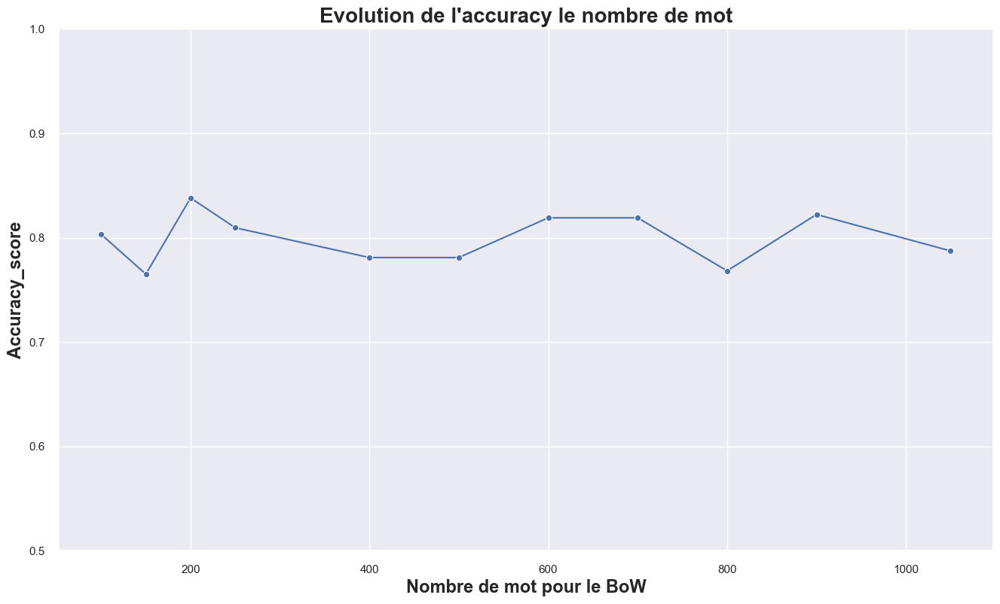

In [ ]:
#Evolution de l'accuracy selon le nombre de mot
plt.figure(figsize=(16,9))
axes = plt.gca()
plt.title("Evolution de l'accuracy le nombre de mot", weight='bold', size=20)
plt.xlabel('Nombre de mot pour le BoW', weight='bold', size=17)
plt.ylabel('Accuracy_score', weight='bold', size=17)
axes.set_ylim(0.5, 1)
sns.lineplot(x=max_features_test, y=A_score,  color='b', marker='o')
#sns.lineplot(x=max_features_test, y=P_score,  color='r', marker='o')

In [ ]:
df4.head()

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin
3,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,Bed Linen
4,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,Bed Linen


Matrice de confusion

- L'objectif de cette visualisation est de mesurer la qualité de notre système de classification et de pouvoir voir facilement quelle classe fuite vers une autre.

In [ ]:
# Catégorie de produit.
categ_unique = df4.categories_1.unique()

#liste
categ_unique_accuracy = list(categ_unique)
categ_unique_accuracy.append('Accuracy %')

In [ ]:
categ_unique

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [ ]:
stem_vectorizer = TfidfVectorizer(max_df=0.80,
                                  min_df=0.075,
                                  max_features=1050, 
                                  stop_words='english',
                                  lowercase=True,
                                  analyzer=stemmed_words)

description_matrix = stem_vectorizer.fit_transform(df4['description'])

# Standardisation.
S = StandardScaler()
description_matrix_standard = S.fit_transform(description_matrix.toarray())
df_description_matrix_standard = pd.DataFrame(description_matrix_standard)

df02 = pd.concat([df_description_matrix_standard, df4['categories_1']], axis=1)

# Split en training/testing set.
X_train, X_test, Y_train, Y_test = train_test_split(df02.iloc[:,:df02.shape[1] - 1], 
                                                df4['categories_1'], 
                                                test_size=0.3)


# GridSearch.
RForestClassifier = RandomForestClassifier()
gridSearch = GridSearchCV(RForestClassifier, {'max_depth': range(3,6),
                                              'n_estimators': (200,300,500,950,1050)},
                                               cv=5,
                                               scoring='accuracy')
# Fit sur le training set.
gridSearch.fit(X_train, Y_train)
df_prediction = pd.DataFrame(gridSearch.best_estimator_.predict(X_test))

In [ ]:
X_train

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
285,-0.849750,-0.287362,-0.26629,-0.265450,2.991655,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,2.056137,-0.284319,-0.245714,1.045470,-0.282309,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
88,-0.849750,1.611842,-0.26629,1.181436,-0.367974,0.479769,-0.263132,-0.240502,-0.708856,-0.302264,...,0.303174,-0.284319,-0.245714,-0.393753,-0.282309,1.422752,2.625137,0.765681,1.404136,0.739617
158,1.008727,-0.287362,-0.26629,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,0.429054,-0.302264,...,-0.405639,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,0.953076,-0.297136,-0.426444
384,1.032560,-0.287362,-0.26629,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,-0.405639,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
42,-0.849750,-0.287362,-0.26629,-0.265450,-0.367974,0.844751,-0.263132,-0.240502,-0.708856,2.804316,...,0.557640,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268,1.701517,-0.287362,-0.26629,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,0.853237,-0.302264,...,-0.405639,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,1.538143,-0.297136,-0.426444
281,-0.849750,-0.287362,-0.26629,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,1.378934,-0.284319,-0.245714,-0.393753,-0.282309,3.958911,3.376842,-0.616424,-0.297136,-0.426444
525,0.348996,-0.287362,-0.26629,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,0.759083,-0.302264,...,-0.405639,-0.284319,-0.245714,2.034485,2.774676,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
762,0.437609,-0.287362,-0.26629,-0.265450,2.675691,-0.536886,-0.263132,-0.240502,0.867595,-0.302264,...,-0.405639,-0.284319,-0.245714,2.213983,-0.282309,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444


In [ ]:
X_test

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
443,-0.849750,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,0.822169,-0.284319,2.063825,-0.393753,-0.282309,-0.248309,2.236288,-0.616424,-0.297136,-0.426444
543,0.834729,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,1.353893,-0.302264,...,-0.405639,-0.284319,-0.245714,3.018408,-0.282309,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
982,-0.849750,3.451920,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,1.948078,...,0.989919,1.983964,-0.245714,-0.393753,1.771971,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
323,1.697607,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,-0.405639,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
141,-0.849750,-0.287362,-0.266290,3.718024,-0.367974,2.262102,-0.263132,-0.240502,-0.708856,-0.302264,...,-0.405639,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,-0.616424,-0.297136,2.783881
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,-0.849750,-0.287362,4.015846,1.932844,-0.367974,0.492868,-0.263132,6.420853,-0.708856,-0.302264,...,4.978956,3.216441,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,0.433511,-0.297136,-0.426444
929,0.473961,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,0.101627,-0.302264,...,-0.405639,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,2.737234,-0.297136,-0.426444
547,0.560073,-0.287362,-0.266290,-0.265450,2.965229,-0.536886,-0.263132,-0.240502,1.017559,-0.302264,...,-0.405639,-0.284319,-0.245714,2.462051,3.312953,-0.248309,-0.278919,-0.616424,-0.297136,-0.426444
994,-0.849750,2.360394,-0.266290,1.751711,-0.367974,-0.064433,-0.263132,-0.240502,-0.708856,-0.302264,...,-0.405639,-0.284319,-0.245714,-0.393753,-0.282309,2.081383,1.745410,0.346999,2.074675,1.199208


In [ ]:
Y_test

443               Home Furnishing
543                       Watches
982                     Baby Care
323                     Computers
141              Kitchen & Dining
                  ...            
475      Beauty and Personal Care
929    Home Decor & Festive Needs
547                       Watches
994              Kitchen & Dining
801      Beauty and Personal Care
Name: categories_1, Length: 315, dtype: object

In [ ]:
df02.head()

,0,1,2,3,4,5,6,7,8,9,...,91,92,93,94,95,96,97,98,99,categories_1
0,-0.84975,-0.287362,-0.266290,1.020454,-0.367974,1.270194,-0.263132,-0.240502,-0.708856,-0.302264,...,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,-0.002259,3.482830,0.609880,Home Furnishing
1,0.06802,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,2.978186,-0.616424,-0.297136,-0.426444,Baby Care
2,-0.84975,-0.287362,1.128891,1.167022,-0.367974,0.469640,-0.263132,-0.240502,-0.708856,-0.302264,...,0.856278,3.714324,-0.393753,0.750678,1.406104,1.158643,-0.616424,2.229349,0.150778,Baby Care
3,-0.84975,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,-0.284319,1.373072,-0.393753,-0.282309,-0.248309,5.009907,-0.196912,-0.297136,-0.426444,Home Furnishing
4,-0.84975,-0.287362,-0.266290,-0.265450,-0.367974,0.778844,-0.263132,-0.240502,-0.708856,-0.302264,...,0.833922,-0.245714,-0.393753,-0.282309,1.373677,3.949236,-0.616424,0.528519,0.139464,Home Furnishing


In [ ]:
df_real_label_ytest = pd.DataFrame(Y_test)
df_real_label_ytest.reset_index(inplace = True, drop = True)
df_compare = pd.concat([df_real_label_ytest, df_prediction], axis=1)
df_compare.columns = ['product_category', 'prediction']

In [ ]:
df_compare.head()

,product_category,prediction
0,Home Furnishing,Home Furnishing
1,Watches,Watches
2,Baby Care,Baby Care
3,Computers,Computers
4,Kitchen & Dining,Kitchen & Dining


In [ ]:
def dico_to_list(dico):
    
    """
    Cette fonction retourne les valeurs d'un dictionnaire sous forme d'une liste.
    
    """  
    L=[]
    for key, value in dico.items():
        L.append(value)
    return L

In [ ]:
# Création de la matrice de confusion en utilisant les valeurs uniques de la colonne product_category comme colonnes et lignes.
df_matrice_confusion = pd.DataFrame(columns=categ_unique_accuracy, index=categ_unique)

# Pour chaque valeur unique de la colonne product_category
for i in categ_unique:
    
    # Création d'un dictionnaire qui contiendra les valeurs de la matrice de confusion pour la catégorie de produit en cours.
    # Les clés du dictionnaire sont les valeurs uniques de la colonne product_category.
    # Les valeurs sont initialisées à 0.
    dico ={j:0 for j in categ_unique}
    
    # Création d'un masque qui sélectionne les lignes du DataFrame où la colonne product_category a la valeur en cours.
    mask = (df_compare['product_category']==i)
    
    # Création d'un masque qui sélectionne les lignes du DataFrame où les valeurs de la colonne product_category et de la colonne prediction sont différentes.
    mask2 = (df_compare['product_category']!=df_compare['prediction'])
    
    # Mise à jour de la valeur de la cellule correspondant à la diagonale de la matrice de confusion.
    # La valeur de la cellule est le nombre de lignes sélectionnées par le masque mask qui ne sont pas sélectionnées par le masque mask2.
    dico[i] = df_compare[mask].shape[0] - df_compare[mask & mask2].shape[0]
    
    # Pour chaque valeur de la colonne prediction qui est différente de la valeur de la colonne product_category pour la ligne en cours,
    # incrémenter la valeur de la cellule correspondante de la matrice de confusion.
    for k in df_compare[mask & mask2].prediction:
        dico[k]+=1
    
    # Transformation en liste du dictionnaire.
    list_check_error = dico_to_list(dico)
    
    # Calcul de l'accuracy du modèle pour la catégorie de produit en cours en utilisant la fonction accuracy_score de scikit-learn.
    # Ajout de l'accuracy à la fin de la liste.
    list_check_error.append(accuracy_score(df_compare[mask].product_category,
                                           df_compare[mask].prediction)*100)
    
    # Assignation des valeurs de la liste à la ligne de la matrice de confusion correspondant à la valeur de la colonne product_category en cours.
    #Conversion de chaque colonne de la matrice de confusion en float.
    
    df_matrice_confusion.loc[i,:] = list_check_error

df_matrice_confusion = df_matrice_confusion[df_matrice_confusion.columns].astype(float)


Text(0.5, 94.38888888888886, 'Prediction')

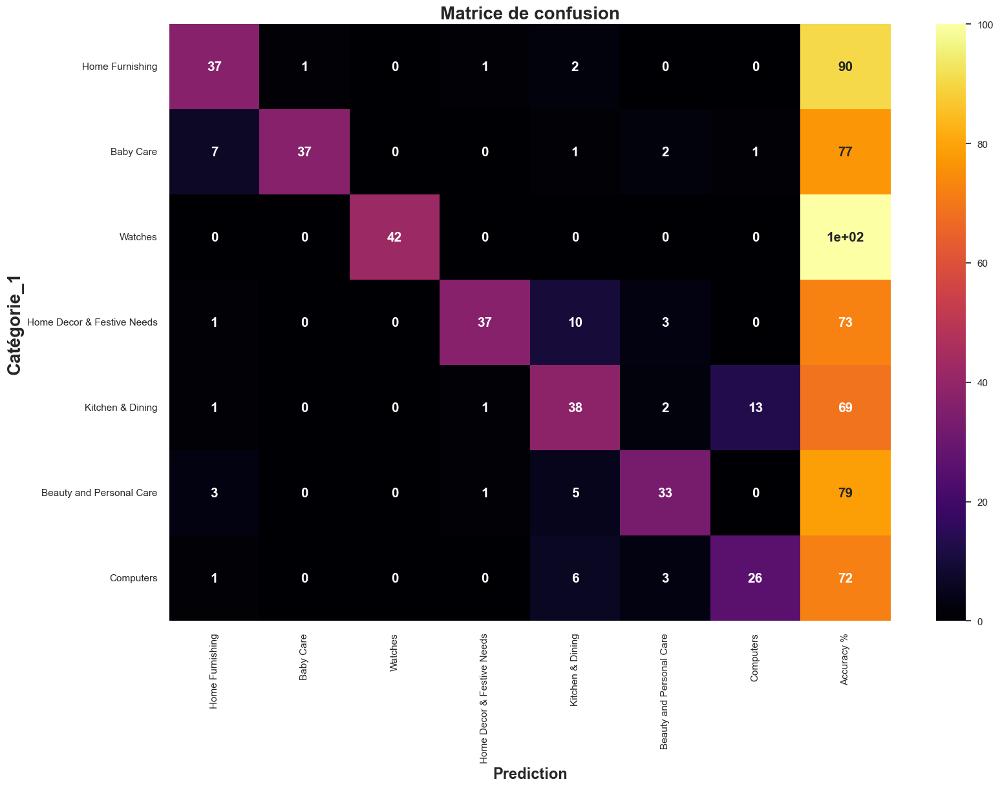

In [ ]:
plt.figure(figsize=(18,12))
plt.title('Matrice de confusion', size=20, weight='bold')
sns.heatmap(df_matrice_confusion,
            xticklabels=True, 
            yticklabels= True, 
            annot=True,
            cmap="inferno", cbar=True,
            annot_kws={"size": 15, 'weight' : 'bold'})
plt.ylabel("Catégorie_1", weight='bold', size=20)
plt.xlabel('Prediction', weight='bold', size=17)

Remarque: 
  
<strong>[Matrice de confusion](https://www.jedha.co/formation-ia/matrice-confusion#:~:text=La%20matrice%20de%20confusion%20%3A%20de,celles%20pr%C3%A9dites%20par%20un%20mod%C3%A8le.)</strong>
"La matrice de confusion de quoi s'agit-il ? La matrice de confusion est en quelque sorte un résumé des résultats de prédiction pour un problème particulier de classification. 
Elle compare les données réelles pour une variable cible à celles prédites par un modèle."

<strong>Calcul d'une matrice de confusion:</strong>

- Le calcul d'une matrice de confusion nécessite d'avoir à sa disposition un ensemble de données de test (test dataset) et un autre ensemble de données de validation (validation dataset) avec les valeurs attendues des résultats. Une prédiction est ensuite effectuée pour chacune des lignes du test dataset.

À partir des résultats attendus et des prédictions, il suffit de compter le nombre de prédictions correctes pour chaque classe ainsi que celui des prédictions incorrectes. Ces différentes valeurs sont ensuite organisées dans un tableau de contingence selon des règles bien définies.

- Dans la matrice de confusion, chaque ligne indique le nombre d'occurrences d'une classe de référence (ou réelle). Les colonnes quant à elles représentent le nombre d'occurrences d'une classe estimée. Chaque colonne contient donc une classe prédite par l'algorithme de Machine Learning ainsi que les lignes des classes réelles.

<strong>Les métriques:</strong>

Différentes métriques peuvent être calculées à partir du tableau de contingence afin d'en faciliter l'interprétation. C'est par exemple le cas du taux d'erreur, de la précision, du rappel et du F1 score. Ces indicateurs permettent de mieux apprécier la qualité de précision du modèle.

- Accuracy:
 Ce paramètre fait la somme de tous les vrais positifs et vrais négatifs qu'il divise par le nombre total d'instances. Il permet d'apporter une réponse à la question suivante : de toutes les classes positives et négatives, combien parmi elles ont été prédites correctement ? Des valeurs élevées de ce paramètre sont souvent souhaitables. Il peut également être calculé avec la formule suivante :

    Accuracy = 1 – ERR.

Dans l'exemple des mails, il indique la proportion de courriers pertinents et de spams effectivement reconnus comme tels sur le nombre total de cas. Cependant, cette métrique ne permet pas de déterminer le nombre de vrais positifs que le modèle peut identifier. Il cache donc certains détails nécessaires à l'appréciation de la performance du modèle. C'est là qu'entrent en jeu deux autres paramètres, à savoir la précision et le rappel.

- La précision:
 La précision indique le rapport entre les prévisions positives correctes et le nombre total de prévisions positives. Ce paramètre répond donc à la question suivante : sur tous les enregistrements positifs prédits, combien sont réellement positifs ? En reprenant l'exemple des courriers, cela désigne le rapport entre le nombre de courriers pertinents reconnus comme tels (TP) par le modèle sur la somme combinée de ce même paramètre avec le nombre de spams considérés comme des courriers pertinents (FP).

-------------------

Réduction dimensionnelle via Analyse en Composantes Principales. - PCA

In [ ]:
composantes = []
for i in range(df_description_matrix_standard.shape[1]):
    composantes.append('Principal component ' + str(i))

In [ ]:
pca = PCA(n_components=df_description_matrix_standard.shape[1])
df_pca = pd.DataFrame(pca.fit_transform(df_description_matrix_standard))
df_pca.columns = composantes

In [ ]:
pca

PCA(n_components=100)

In [ ]:
df_description_matrix_standard.head()

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
0,-0.84975,-0.287362,-0.266290,1.020454,-0.367974,1.270194,-0.263132,-0.240502,-0.708856,-0.302264,...,0.224310,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,-0.278919,-0.002259,3.482830,0.609880
1,0.06802,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,1.184329,-0.284319,-0.245714,-0.393753,-0.282309,-0.248309,2.978186,-0.616424,-0.297136,-0.426444
2,-0.84975,-0.287362,1.128891,1.167022,-0.367974,0.469640,-0.263132,-0.240502,-0.708856,-0.302264,...,0.296112,0.856278,3.714324,-0.393753,0.750678,1.406104,1.158643,-0.616424,2.229349,0.150778
3,-0.84975,-0.287362,-0.266290,-0.265450,-0.367974,-0.536886,-0.263132,-0.240502,-0.708856,-0.302264,...,0.454948,-0.284319,1.373072,-0.393753,-0.282309,-0.248309,5.009907,-0.196912,-0.297136,-0.426444
4,-0.84975,-0.287362,-0.266290,-0.265450,-0.367974,0.778844,-0.263132,-0.240502,-0.708856,-0.302264,...,0.282358,0.833922,-0.245714,-0.393753,-0.282309,1.373677,3.949236,-0.616424,0.528519,0.139464


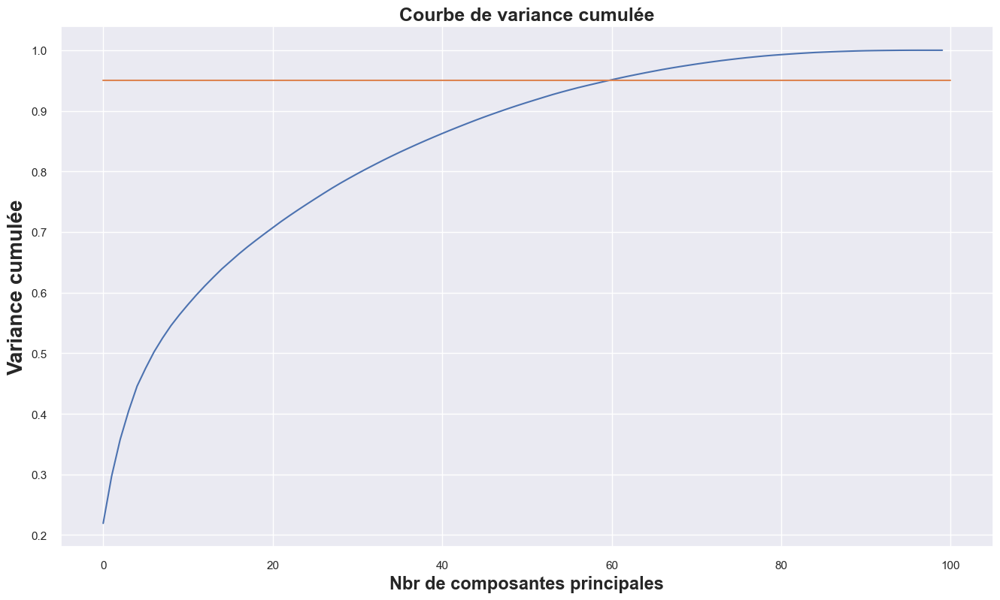

In [ ]:
plt.figure(figsize=(16,9))
plt.ylabel("Variance cumulée", weight='bold', size=20)
plt.xlabel('Nbr de composantes principales', weight='bold', size=17)
plt.plot(pca.explained_variance_ratio_.cumsum())
plt.title('Courbe de variance cumulée', size=18, weight='bold')
plt.plot([0,df_description_matrix_standard.shape[1]],[0.95,0.95])

In [ ]:
# Combien doit-on garder de composantes principales pour expliquer 95% de la variance du dataset ?
c=0
for i in pca.explained_variance_ratio_.cumsum():
    c+=1
    if(i>0.95):
        print('Il faut {} composantes pour expliquer 95% de la variance du dataset'.format(c))
        break


Il faut 61 composantes pour expliquer 95% de la variance du dataset


In [ ]:
df_pca.head()

,Principal component 0,Principal component 1,Principal component 2,Principal component 3,Principal component 4,Principal component 5,Principal component 6,Principal component 7,Principal component 8,Principal component 9,...,Principal component 90,Principal component 91,Principal component 92,Principal component 93,Principal component 94,Principal component 95,Principal component 96,Principal component 97,Principal component 98,Principal component 99
0,6.470334,2.017327,-0.680793,-1.761696,-1.049853,-0.320023,-0.741903,-1.120467,-0.507478,-0.129720,...,0.036253,0.098757,0.140254,0.028015,0.021658,-0.018767,-0.042930,-0.007632,-0.002130,-7.083506e-17
1,7.285176,-5.262553,-1.195485,-3.252283,-0.854844,-0.129885,0.883682,0.670580,-0.877518,2.474919,...,-0.512593,-0.088090,-0.168685,-0.098646,-0.127922,-0.010438,0.000035,0.000754,-0.003746,-1.418731e-16
2,6.559916,-0.027235,-0.713386,-0.111640,-1.268289,1.186251,-0.398655,-1.144896,-0.959911,2.776430,...,-0.103429,-0.148569,0.108407,0.181545,-0.156003,-0.093821,-0.021325,-0.019233,-0.005391,1.429144e-16
3,5.929449,-2.919794,-1.824783,-2.114412,-0.041327,-1.985859,-0.880914,-2.185154,0.548044,2.760863,...,0.041464,0.008599,0.004669,0.180860,-0.016034,-0.056152,-0.024248,0.001792,0.001544,-3.747645e-17
4,5.991252,-0.361395,-1.456385,-1.264066,-0.510377,-1.022476,-1.402213,-2.428191,-0.142512,2.049663,...,-0.185156,0.131204,-0.175681,0.087866,0.090007,-0.121348,0.001816,-0.019579,-0.001437,-4.406766e-16


In [ ]:
df_pca02 = df_pca.iloc[:,:61]

In [ ]:
df_pca02.head()

,Principal component 0,Principal component 1,Principal component 2,Principal component 3,Principal component 4,Principal component 5,Principal component 6,Principal component 7,Principal component 8,Principal component 9,...,Principal component 51,Principal component 52,Principal component 53,Principal component 54,Principal component 55,Principal component 56,Principal component 57,Principal component 58,Principal component 59,Principal component 60
0,6.470334,2.017327,-0.680793,-1.761696,-1.049853,-0.320023,-0.741903,-1.120467,-0.507478,-0.129720,...,-0.542600,-0.719918,-0.880120,-0.445578,0.264582,0.434453,0.236015,-0.881800,0.537950,0.677334
1,7.285176,-5.262553,-1.195485,-3.252283,-0.854844,-0.129885,0.883682,0.670580,-0.877518,2.474919,...,-0.563910,-1.034272,-0.240109,0.646522,-0.303849,0.608813,0.700234,0.268029,0.539799,-0.810448
2,6.559916,-0.027235,-0.713386,-0.111640,-1.268289,1.186251,-0.398655,-1.144896,-0.959911,2.776430,...,-0.474691,0.417460,-0.126409,-1.393019,-0.256608,-0.137512,-0.312098,0.409175,0.539369,0.370140
3,5.929449,-2.919794,-1.824783,-2.114412,-0.041327,-1.985859,-0.880914,-2.185154,0.548044,2.760863,...,1.077891,0.434180,0.657855,1.199082,-0.181216,-0.548532,-0.512040,-0.461522,0.017526,-0.007829
4,5.991252,-0.361395,-1.456385,-1.264066,-0.510377,-1.022476,-1.402213,-2.428191,-0.142512,2.049663,...,1.368627,0.669587,0.607510,1.542610,0.619771,-0.219184,-0.637764,-0.409644,-0.327199,0.195806


In [ ]:
df_pca02.shape

(1050, 61)

Clustering

On réalise dans cette partie un clusterig via 2 algorithmes:

    Kmeans
    Kmeans - Gaussian Mixture Model [algo non sphérique].

L'objectif est de comparé les clusters obtenus en terme de qualité du clustering (homogénéité, coefficent de silhouette...).
Mais aussi comparé le clustering obtenu par rapport aux réelles classes des objets,pour cela nous utiliserons l'indice de Rand ajusté (ARI).

On produira des visualisations dans les plans factorielles et aussi via T-Sne.


In [ ]:
#KMeans
km2 = KMeans(n_clusters=7, 
            init='k-means++',
            random_state=2)
km2.fit(df_pca02)

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


KMeans(n_clusters=7, random_state=2)

In [ ]:
df4.head()

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin
3,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,Bed Linen
4,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,Bed Linen


In [ ]:
df_pca02['Labels_KM'] = km2.labels_
df_pca02['Categ'] = df4.categories_1
df_pca02.groupby('Labels_KM').size()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\283239453.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pca02['Labels_KM'] = km2.labels_
C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\283239453.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pca02['Categ'] = df4.categories_1


Labels_KM
0    138
1     99
2    191
3     39
4    245
5    134
6    204
dtype: int64

In [ ]:
df_pca02.head()

,Principal component 0,Principal component 1,Principal component 2,Principal component 3,Principal component 4,Principal component 5,Principal component 6,Principal component 7,Principal component 8,Principal component 9,...,Principal component 53,Principal component 54,Principal component 55,Principal component 56,Principal component 57,Principal component 58,Principal component 59,Principal component 60,Labels_KM,Categ
0,6.470334,2.017327,-0.680793,-1.761696,-1.049853,-0.320023,-0.741903,-1.120467,-0.507478,-0.129720,...,-0.880120,-0.445578,0.264582,0.434453,0.236015,-0.881800,0.537950,0.677334,6,Home Furnishing
1,7.285176,-5.262553,-1.195485,-3.252283,-0.854844,-0.129885,0.883682,0.670580,-0.877518,2.474919,...,-0.240109,0.646522,-0.303849,0.608813,0.700234,0.268029,0.539799,-0.810448,5,Baby Care
2,6.559916,-0.027235,-0.713386,-0.111640,-1.268289,1.186251,-0.398655,-1.144896,-0.959911,2.776430,...,-0.126409,-1.393019,-0.256608,-0.137512,-0.312098,0.409175,0.539369,0.370140,5,Baby Care
3,5.929449,-2.919794,-1.824783,-2.114412,-0.041327,-1.985859,-0.880914,-2.185154,0.548044,2.760863,...,0.657855,1.199082,-0.181216,-0.548532,-0.512040,-0.461522,0.017526,-0.007829,5,Home Furnishing
4,5.991252,-0.361395,-1.456385,-1.264066,-0.510377,-1.022476,-1.402213,-2.428191,-0.142512,2.049663,...,0.607510,1.542610,0.619771,-0.219184,-0.637764,-0.409644,-0.327199,0.195806,5,Home Furnishing


c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\seaborn\regression.py:582: UserWarning: legend_out is deprecated from the `lmplot` function signature. Please update your code to pass it using `facet_kws`.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'Viz ACP with KMeans')

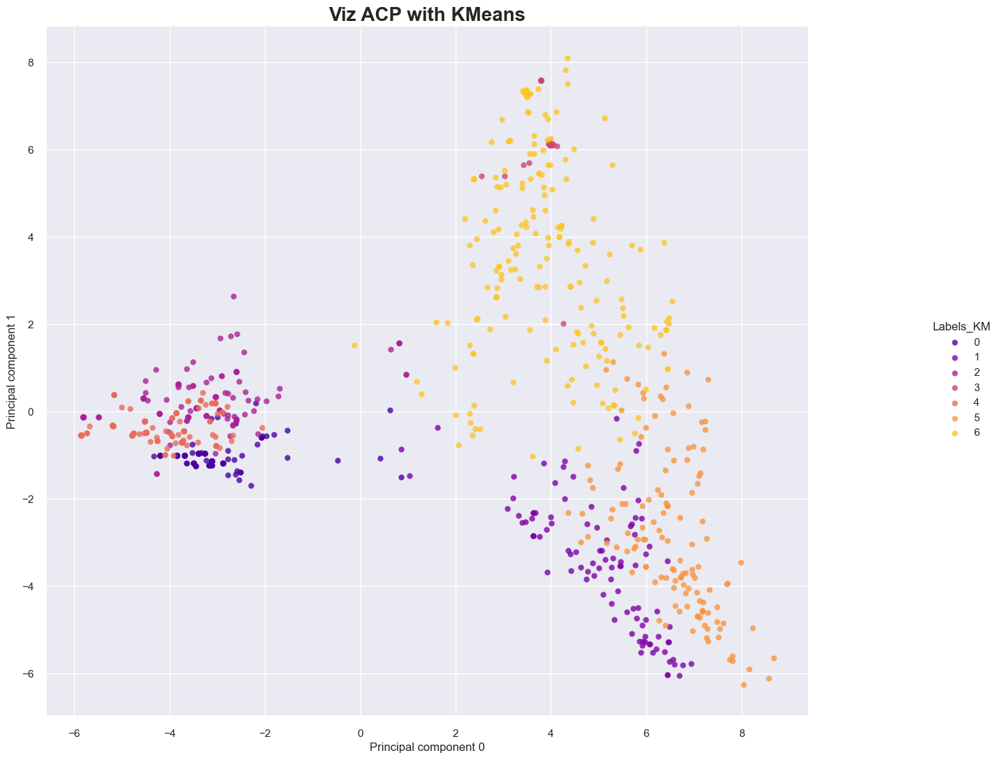

In [ ]:
#VIZ

sns.lmplot(x='Principal component 0', 
            y='Principal component 1', 
            hue='Labels_KM', 
            data=df_pca02,
            palette = 'plasma',
            fit_reg=False,
            legend=True, 
            legend_out=True)

plt.gcf().set_size_inches(16, 12)
plt.title('Viz ACP with KMeans',size=20, weight='bold')

In [ ]:
# Calcul des composantes TSNE.
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(df_pca02.iloc[:,:61])

df_pca02['TSNE_2D_one'] = tsne_results[:,0]
df_pca02['TSNE_2D_two'] = tsne_results[:,1]

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\1590845146.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pca02['TSNE_2D_one'] = tsne_results[:,0]
C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\1590845146.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = val

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\seaborn\regression.py:582: UserWarning: legend_out is deprecated from the `lmplot` function signature. Please update your code to pass it using `facet_kws`.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'Viz ACP/T-Sne with KMeans')

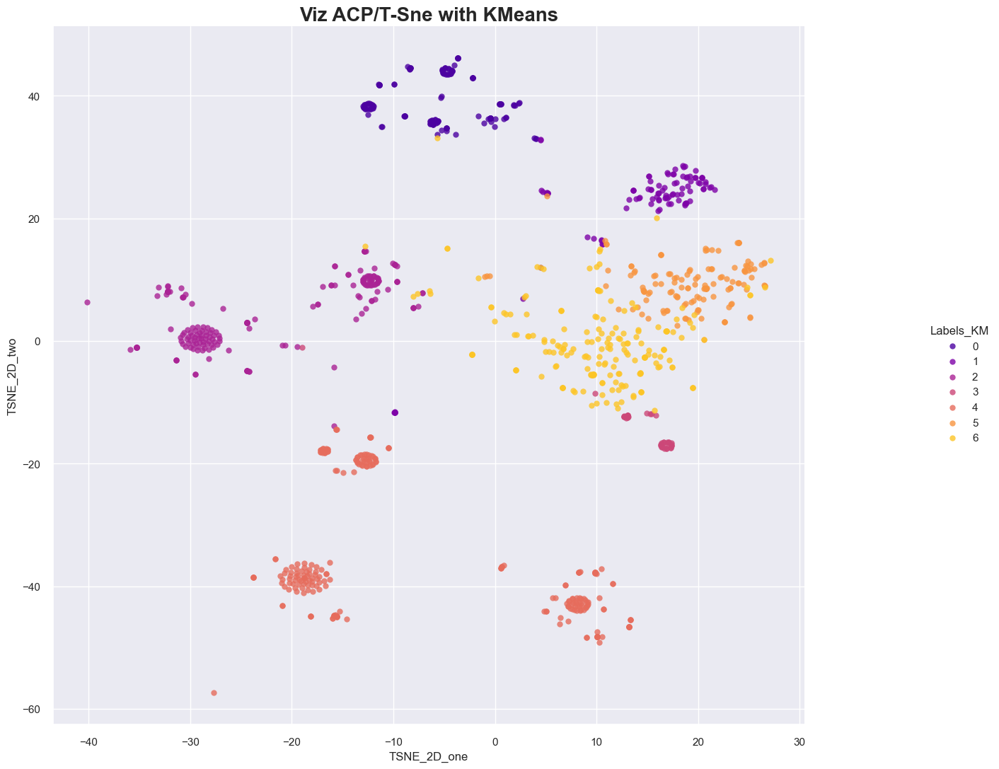

In [ ]:
sns.lmplot(x='TSNE_2D_one', 
           y='TSNE_2D_two', 
           hue='Labels_KM', 
           data=df_pca02,
           palette = 'plasma',
           fit_reg=False,
           legend=True, 
           legend_out=True)

plt.gcf().set_size_inches(16, 12)
plt.title('Viz ACP/T-Sne with KMeans',size=20, weight='bold')

In [ ]:
import matplotlib.cm as cm

Pour n_clusters = 7 The average silhouette_score is : 0.2415750276775384


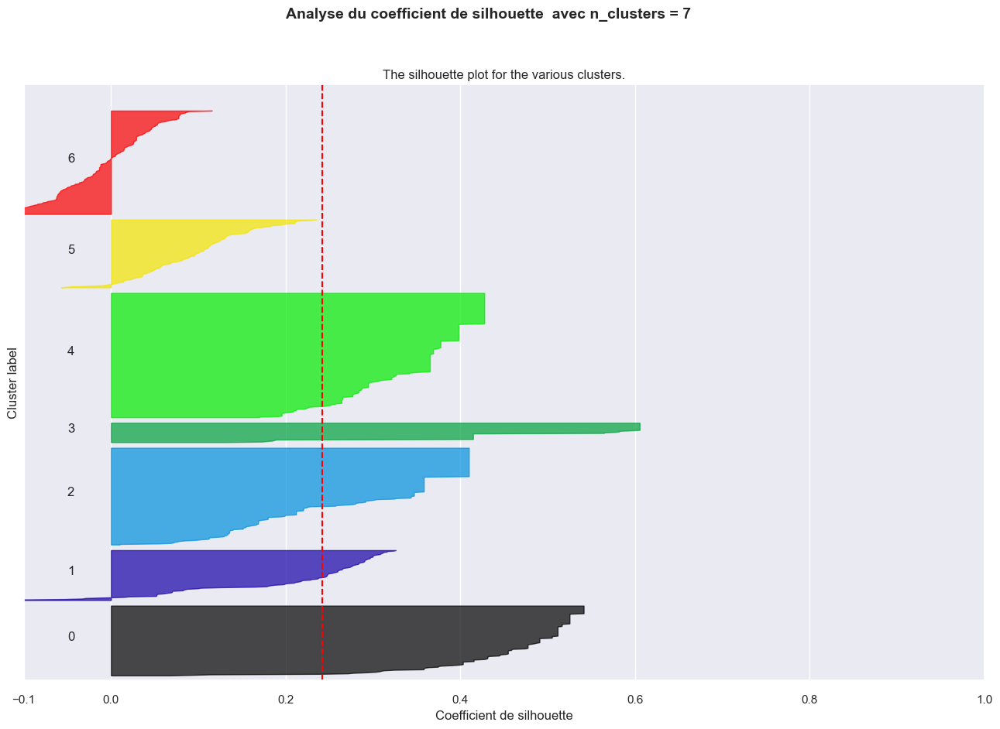

In [ ]:
# Création de plusieurs subplot.
fig, (ax1) = plt.subplots(1, 1)
fig.set_size_inches(16, 10)

ax1.set_xlim([-0.1, 1])

ax1.set_ylim([0, len(df_pca02.iloc[:,:61]) + 8 * 15])

# Nombre de cluster.
n_clusters = 7 

# Labels.
cluster_labels = df_pca02.Labels_KM

# Calcul du coefficient de silhouette pour le nomre de cluster testé.
silhouette_avg = silhouette_score(df_pca.iloc[:,:61], cluster_labels)
print("Pour n_clusters =", 7,
      "The average silhouette_score is :", silhouette_avg)

# Calcule du coefficient de silhouette pour les samples.
sample_silhouette_values = silhouette_samples(df_pca02.iloc[:,:61], cluster_labels)

y_lower = 10
    
for i in range(n_clusters):
    # Agréger les scores de silhouette pour les échantillons appartenant à
    # cluster i, et triez-les
    ith_cluster_silhouette_values = \
        sample_silhouette_values[cluster_labels == i]

    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

    # Étiquetez les parcelles de silhouette avec leurs numéros de cluster au milieu
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

     # Calculer le nouveau y_lower pour le tracé 
    y_lower = y_upper + 10  # 10 for the 0 samples

ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("Coefficient de silhouette")
ax1.set_ylabel("Cluster label")

# ligne verticale pour montrer le coefficient de silhouette moyen.
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

ax1.set_yticks([])  # Clear the yaxis labels / ticks
ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

plt.suptitle(("Analyse du coefficient de silhouette  "
              "avec n_clusters = %d" % n_clusters),
             fontsize=14, fontweight='bold')

plt.show()

In [ ]:
import plotly.express as px

In [ ]:
fig = px.scatter(df_pca02,
                 x='TSNE_2D_one',
                 y='TSNE_2D_two', 
                 color='Categ')

fig.update_layout(
    autosize=False,
    width=950,
    height=650)

fig.show()

In [ ]:
#Kmeans with GaussianMixture:

gmm = GaussianMixture(n_components=7)
gmm.fit(df_pca02.iloc[:,:61])

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



GaussianMixture(n_components=7)

In [ ]:
labels_gmm = gmm.predict(df_pca02.iloc[:,:61])

In [ ]:
df_pca02['Labels_GMM'] = labels_gmm
df_pca02.groupby('Labels_GMM').size()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\362503694.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Labels_GMM
0    193
1    335
2     77
3    138
4     95
5     22
6    190
dtype: int64

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\seaborn\regression.py:582: UserWarning:

legend_out is deprecated from the `lmplot` function signature. Please update your code to pass it using `facet_kws`.



Text(0.5, 1.0, 'Viz ACP with GMM')

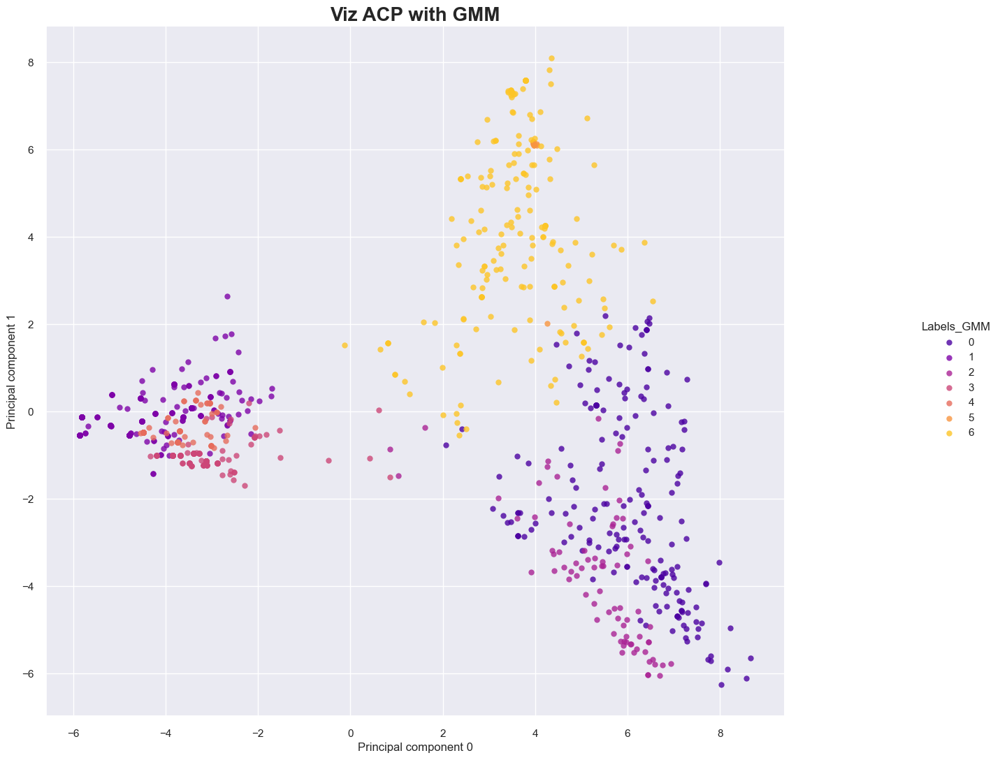

In [ ]:
#Viz
sns.lmplot(x='Principal component 0', 
            y='Principal component 1', 
            hue='Labels_GMM', 
            data=df_pca02,
            palette = 'plasma',
            fit_reg=False,
            legend=True, 
            legend_out=True)

plt.gcf().set_size_inches(16, 12)
plt.title('Viz ACP with GMM',size=20, weight='bold')
  

In [ ]:
# Calcul des composantes TSNE.
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(df_pca02.iloc[:,:61])

df_pca02['TSNE_2D_one_gmm'] = tsne_results[:,0]
df_pca02['TSNE_2D_two_gmm'] = tsne_results[:,1]

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3079978053.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3079978053.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.o

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\seaborn\regression.py:582: UserWarning:

legend_out is deprecated from the `lmplot` function signature. Please update your code to pass it using `facet_kws`.



Text(0.5, 1.0, 'ACP/T-Sne with GMM')

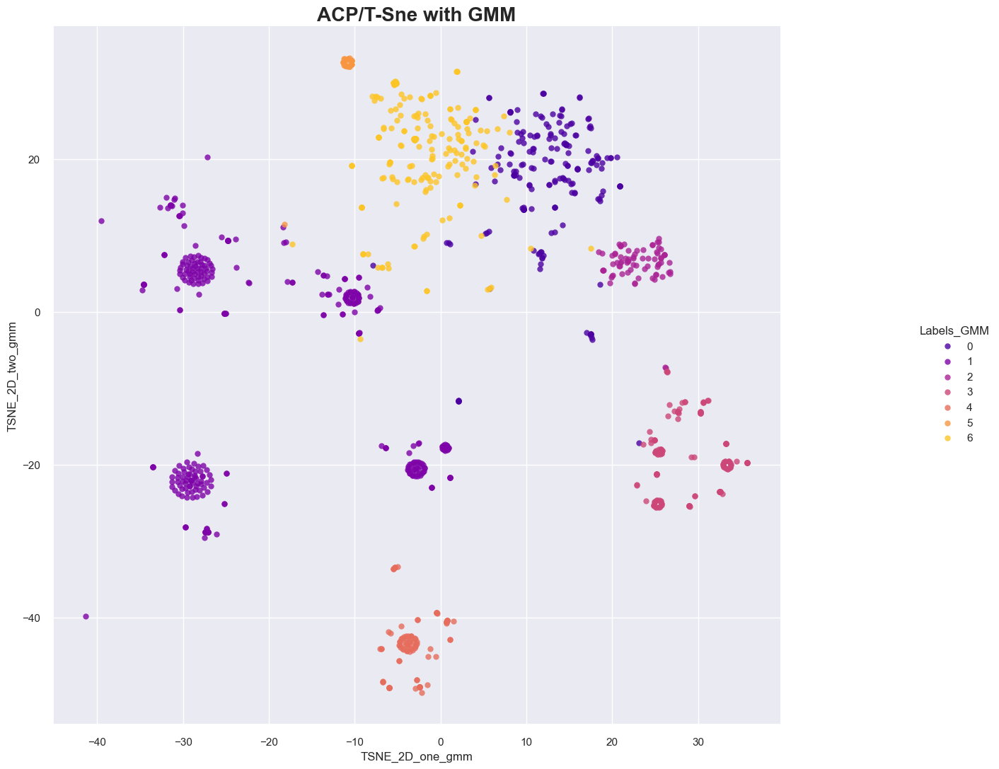

In [ ]:
sns.lmplot(x='TSNE_2D_one_gmm', 
           y='TSNE_2D_two_gmm', 
           hue='Labels_GMM', 
           data=df_pca02,
           palette = 'plasma',
           fit_reg=False,
           legend=True, 
           legend_out=True)

plt.gcf().set_size_inches(16, 12)
plt.title('ACP/T-Sne with GMM',size=20, weight='bold')

Pour n_clusters = 7 The average silhouette_score is : 0.22350089881517113


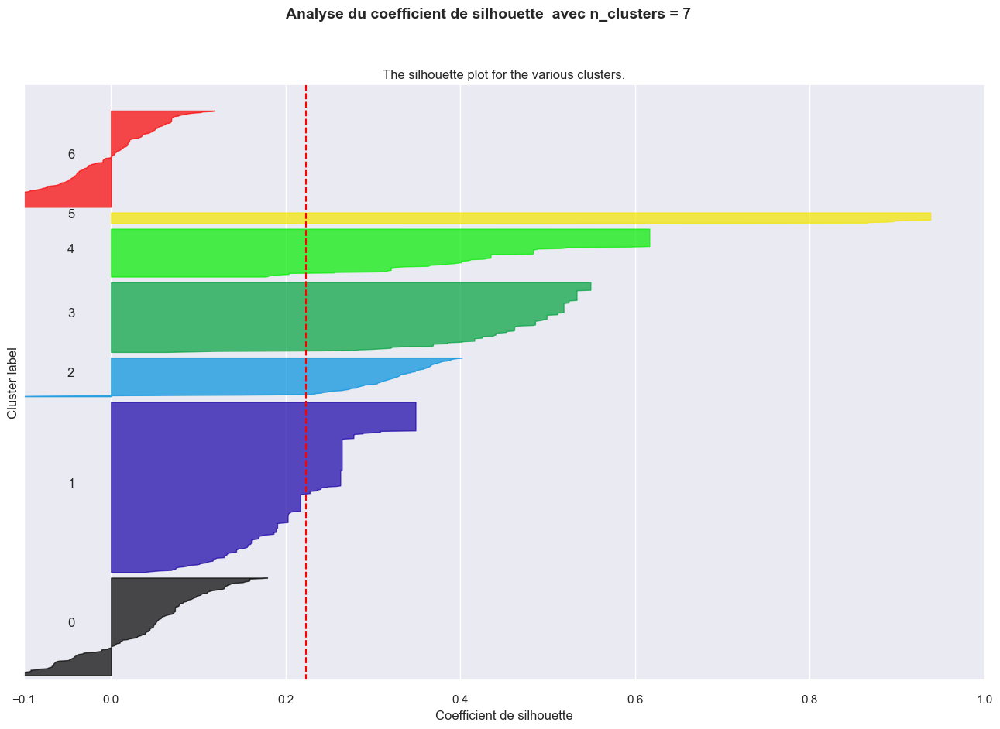

In [ ]:
# Création de plusieurs subplot.
fig, (ax1) = plt.subplots(1, 1)
fig.set_size_inches(16, 10)

ax1.set_xlim([-0.1, 1])

ax1.set_ylim([0, len(df_pca.iloc[:,:61]) + 8 * 15])

# Nombre de cluster.
n_clusters = 7 

# Labels.
cluster_labels = df_pca02.Labels_GMM

# Calcul du coefficient de silhouette pour le nomre de cluster testé.
silhouette_avg = silhouette_score(df_pca02.iloc[:,:61], cluster_labels)
print("Pour n_clusters =", 7,
      "The average silhouette_score is :", silhouette_avg)

# Calcule du coefficient de silhouette pour les samples.
sample_silhouette_values = silhouette_samples(df_pca02.iloc[:,:61], cluster_labels)

y_lower = 10
    
for i in range(n_clusters):
    # Aggregate the silhouette scores for samples belonging to
    # cluster i, and sort them
    ith_cluster_silhouette_values = \
        sample_silhouette_values[cluster_labels == i]

    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

    # Label the silhouette plots with their cluster numbers at the middle
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 samples

ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("Coefficient de silhouette")
ax1.set_ylabel("Cluster label")

# ligne verticale pour montrer le coefficient de silhouette moyen.
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

ax1.set_yticks([])  # Clear the yaxis labels / ticks
ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

plt.suptitle(("Analyse du coefficient de silhouette  "
              "avec n_clusters = %d" % n_clusters),
             fontsize=14, fontweight='bold')

plt.show()


Mesures de qualité du clustering

Dans cette partie finale, nous cherchons à comparer : Kmeans ||  GMM via <strong>l'indice de Rand ajusté.</strong>

L'indice de Rand est une mesure de similarité entre deux partitions d'un ensemble. Son principe est de mesurer la consistance (le taux d'accord) entre deux partitions. Plus il est proche de 1, plus le clustering que nous avons mis en oeuvre est de bonne qualité.


In [ ]:
#With KMEAN

# Indice de Rand ajusté.
adjusted_rand_score(df_pca02.Labels_KM, df_pca02.Categ)

0.2533991046239121

In [ ]:
# Coefficient de silhouette moyen.
silhouette_score(df_pca02.iloc[:,:61], df_pca02.Labels_KM)

0.2415750276775384

In [ ]:
# Calcul du coefficient de silhouette de chaque cluster.
silhouette_per_point = silhouette_samples(df_pca02.iloc[:,:61], df_pca02.Labels_KM)
df_pca02['Silhouette_KM'] = silhouette_per_point

for i in range(7):
    print('Cluster {} :'.format(i),df_pca02[df_pca02['Labels_KM']==i]['Silhouette_KM'].mean())

Cluster 0 : 0.46166655936036777
Cluster 1 : 0.2030406238889209
Cluster 2 : 0.28620841237631156
Cluster 3 : 0.47603192973467773
Cluster 4 : 0.35085665193818033
Cluster 5 : 0.09455770230674565
Cluster 6 : -0.009896528200022557


C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\2406923959.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Kmean with GMMM:
# Indice de Rand ajusté.
adjusted_rand_score(df_pca02.Labels_GMM, df_pca02.Categ)

0.24542386855411802

In [ ]:
# Coefficient de silhouette moyen.
silhouette_score(df_pca02.iloc[:,:61], df_pca02.Labels_GMM)

0.22350089881517113

In [ ]:
# Calcul du coefficient de silhouette de chaque cluster.
silhouette_per_point = silhouette_samples(df_pca02.iloc[:,:61], df_pca02.Labels_GMM)
df_pca02['Silhouette_GMM'] = silhouette_per_point

for i in range(7):
    print('Cluster {} :'.format(i),df_pca02[df_pca02['Labels_GMM']==i]['Silhouette_GMM'].mean())

Cluster 0 : 0.03482862354670036
Cluster 1 : 0.23378930344359727
Cluster 2 : 0.30726873151555434
Cluster 3 : 0.4697097349941206
Cluster 4 : 0.4676090058606151
Cluster 5 : 0.8909755932410451
Cluster 6 : -0.015101850558612184


C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\2200951288.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df6.head(2)

,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos,Descrip_Lemm_With_Pos,Descrip_Lemmatize
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...",key featur eleg polyest multicolor abstract ey...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...",specif cotton bath towel bath towel red yellow...


##### Partie 2 : KMeans [ colonne "Description" + "Product categ"]

In [ ]:
# Fusionne les colonnes 'col1' et 'col2' en une seule colonne 'new_col'
df6['Clean_DescpProduct'] = df6['Descrip_PS'].map(str) + ' ' + df6['clean_product_name'].map(str)

In [ ]:
df6.head(2)

,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos,Descrip_Lemm_With_Pos,Descrip_Lemmatize,Clean_DescpProduct
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...",key featur eleg polyest multicolor abstract ey...,"['key', 'featur', 'eleg', 'polyest', 'multicol..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...",specif cotton bath towel bath towel red yellow...,"['specif', 'cotton', 'bath', 'towel', 'bath', ..."


In [ ]:
stem_vectorizer = TfidfVectorizer(max_df=0.80,
                                  min_df=0.075,
                                  max_features=1050, 
                                  stop_words='english',
                                  lowercase=True,
                                  analyzer=stemmed_words)

description_matrix2 = stem_vectorizer.fit_transform(df6['Clean_DescpProduct'])

# Standardisation.
S = StandardScaler()
description_matrix_standard2 = S.fit_transform(description_matrix2.toarray())
df_description_matrix_standard2 = pd.DataFrame(description_matrix_standard2)

df03 = pd.concat([df_description_matrix_standard, df6['categories_1']], axis=1)

# Split en training/testing set.
X_train, X_test, Y_train, Y_test = train_test_split(df03.iloc[:,:df03.shape[1] - 1], 
                                                df6['categories_1'], 
                                                test_size=0.3)


# GridSearch.
RForestClassifier = RandomForestClassifier()
gridSearch = GridSearchCV(RForestClassifier, {'max_depth': range(3,6),
                                              'n_estimators': (200,300,500,950,1050)},
                                               cv=5,
                                               scoring='accuracy')
# Fit sur le training set.
gridSearch.fit(X_train, Y_train)
df_prediction02 = pd.DataFrame(gridSearch.best_estimator_.predict(X_test))

In [ ]:
composantes = []
for i in range(df_description_matrix_standard2.shape[1]):
    composantes.append('Principal component ' + str(i))

In [ ]:
pca02 = PCA(n_components=df_description_matrix_standard2.shape[1])
df_pca03 = pd.DataFrame(pca02.fit_transform(df_description_matrix_standard2))
df_pca03.columns = composantes

In [ ]:
pca02

PCA(n_components=66)

In [ ]:
df_pca03.shape

(1050, 66)

In [ ]:
df_description_matrix_standard2.head()

,0,1,2,3,4,5,6,7,8,9,...,56,57,58,59,60,61,62,63,64,65
0,-0.273581,-0.369821,-0.307294,-0.45303,0.529289,-0.281208,0.921394,-0.88504,-0.236744,-0.885268,...,-0.315567,-0.307678,0.487396,1.819663,0.508933,-0.263977,-0.400335,-0.262762,-0.245502,-0.282754
1,-0.273581,-0.369821,-0.307294,-0.45303,0.810178,1.001957,1.334876,-0.88504,-0.236744,-0.885268,...,-0.315567,1.394721,0.798454,-0.252774,0.786294,-0.263977,-0.400335,-0.262762,-0.245502,2.177964
2,-0.273581,-0.369821,-0.307294,-0.45303,0.235922,0.389398,1.414980,-0.88504,1.994389,-0.885268,...,-0.315567,3.251143,0.162520,-0.252774,0.219252,0.420435,-0.400335,0.701495,1.157049,1.003263
3,-0.273581,-0.369821,-0.307294,-0.45303,0.379023,-0.281208,0.700195,-0.88504,1.132753,-0.885268,...,-0.315567,4.061217,0.320991,-0.252774,0.360556,-0.263977,-0.400335,-0.262762,-0.245502,4.453483
4,-0.273581,-0.369821,-0.307294,-0.45303,0.245459,-0.281208,0.503583,-0.88504,0.895746,-0.885268,...,-0.315567,4.208334,0.173082,-0.252774,0.228669,0.430818,-0.400335,-0.262762,1.178327,3.633825


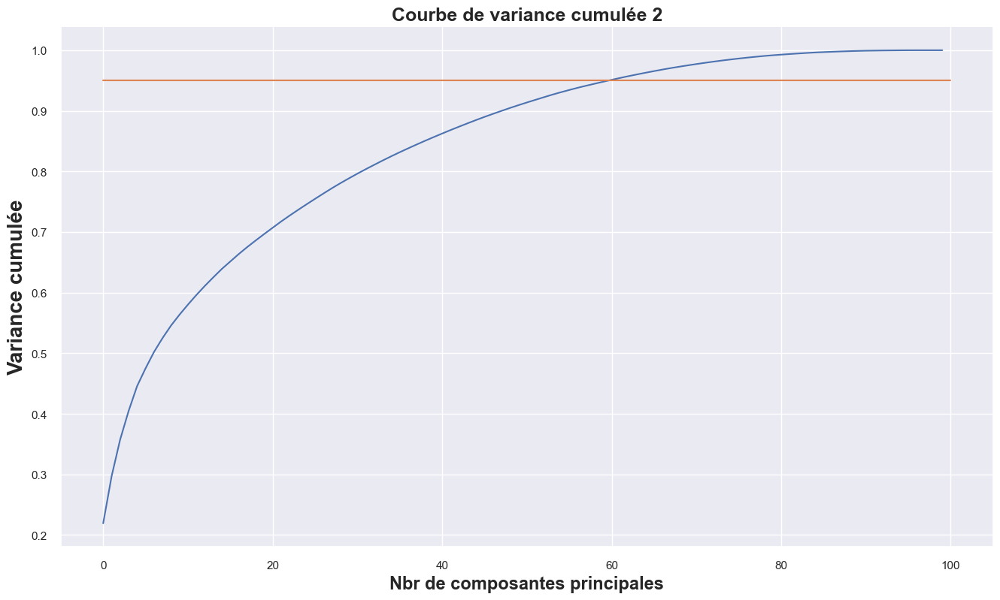

In [ ]:
plt.figure(figsize=(16,9))
plt.ylabel("Variance cumulée", weight='bold', size=20)
plt.xlabel('Nbr de composantes principales', weight='bold', size=17)
plt.plot(pca.explained_variance_ratio_.cumsum())
plt.title('Courbe de variance cumulée 2', size=18, weight='bold')
plt.plot([0,df_description_matrix_standard.shape[1]],[0.95,0.95])

In [ ]:
# Combien doit-on garder de composantes principales pour expliquer 95% de la variance du dataset ?
c=0
for i in pca02.explained_variance_ratio_.cumsum():
    c+=1
    if(i>0.95):
        print('Il faut {} composantes pour expliquer 95% de la variance du dataset'.format(c))
        break


Il faut 44 composantes pour expliquer 95% de la variance du dataset


In [ ]:
df_pca03.head()

,Principal component 0,Principal component 1,Principal component 2,Principal component 3,Principal component 4,Principal component 5,Principal component 6,Principal component 7,Principal component 8,Principal component 9,...,Principal component 56,Principal component 57,Principal component 58,Principal component 59,Principal component 60,Principal component 61,Principal component 62,Principal component 63,Principal component 64,Principal component 65
0,6.009311,-2.166407,1.701840,-0.566287,-1.898196,0.655221,-0.808116,-0.658264,0.757437,0.201625,...,-0.672804,0.436559,-0.225377,-0.045780,0.121571,-0.020981,-0.013814,0.001319,-7.859351e-15,2.946833e-16
1,6.329762,-1.952100,1.975694,1.374431,-0.100673,0.924865,-1.227005,-1.778969,-1.544307,1.611740,...,-0.279050,0.144804,-0.117416,0.016360,0.006970,-0.167919,-0.183765,-0.006873,-2.339585e-16,5.578786e-16
2,4.547772,-1.157317,0.654879,-0.026286,-1.201188,1.143484,-1.535111,-1.278847,-0.328570,0.418714,...,-0.583748,0.429001,-0.402918,-0.110599,0.097513,-0.168433,-0.129652,-0.006783,-2.351244e-15,-1.459814e-16
3,5.337690,-1.642370,0.776500,-0.103558,-2.810033,1.171690,-1.734179,-3.040257,-3.137677,1.235204,...,-0.261167,-0.087915,-0.112332,-0.060715,0.041170,-0.136644,-0.146208,-0.001709,2.016420e-14,-1.730570e-15
4,4.758210,-1.365910,0.321580,-0.385708,-2.857528,1.377479,-1.395383,-3.103949,-2.833414,-0.105922,...,-0.312572,-0.177537,-0.096911,-0.039021,0.061126,-0.144634,-0.104747,-0.005230,2.062916e-14,-1.262650e-15


In [ ]:
df_pca04 = df_pca03.iloc[:,:44]

In [ ]:
#KMeans
km3 = KMeans(n_clusters=7, 
            init='k-means++',
            random_state=2)
km3.fit(df_pca04)

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



KMeans(n_clusters=7, random_state=2)

In [ ]:
df_pca04['Labels_KM'] = km3.labels_
df_pca04['Categ'] = df6.categories_1
df_pca04.groupby('Labels_KM').size()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\1206446228.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\1206446228.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Labels_KM
0     88
1    116
2    237
3    174
4    211
5    142
6     82
dtype: int64

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\seaborn\regression.py:582: UserWarning:

legend_out is deprecated from the `lmplot` function signature. Please update your code to pass it using `facet_kws`.



Text(0.5, 1.0, 'Viz ACP with KMeans 2')

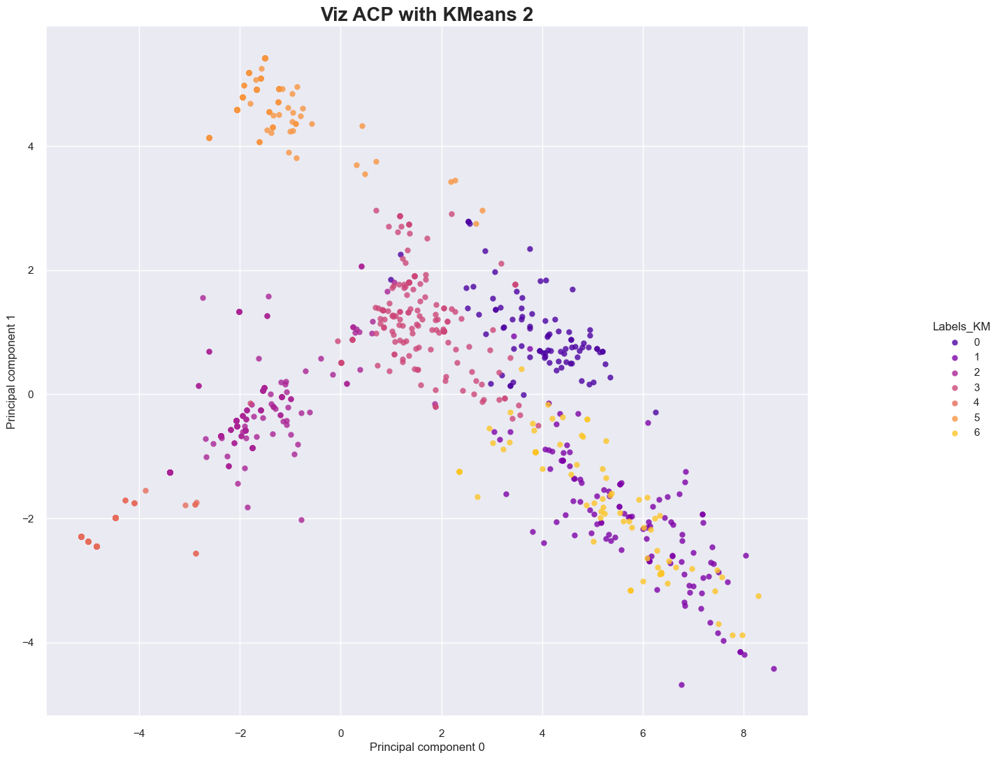

In [ ]:
#VIZ
sns.lmplot(x='Principal component 0', 
            y='Principal component 1', 
            hue='Labels_KM', 
            data=df_pca04,
            palette = 'plasma',
            fit_reg=False,
            legend=True, 
            legend_out=True)

plt.gcf().set_size_inches(16, 12)
plt.title('Viz ACP with KMeans 2',size=20, weight='bold')

In [ ]:
# Calcul des composantes TSNE - partie 2.
tsne2 = TSNE(n_components=2)
tsne_results2= tsne.fit_transform(df_pca04.iloc[:,:44])

df_pca04['TSNE_2D_one'] = tsne_results2[:,0]
df_pca04['TSNE_2D_two'] = tsne_results2[:,1]

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3919994424.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3919994424.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.o

In [ ]:
df_pca04

,Principal component 0,Principal component 1,Principal component 2,Principal component 3,Principal component 4,Principal component 5,Principal component 6,Principal component 7,Principal component 8,Principal component 9,...,Principal component 38,Principal component 39,Principal component 40,Principal component 41,Principal component 42,Principal component 43,Labels_KM,Categ,TSNE_2D_one,TSNE_2D_two
0,6.009311,-2.166407,1.701840,-0.566287,-1.898196,0.655221,-0.808116,-0.658264,0.757437,0.201625,...,-0.459124,-0.024224,-0.855432,-0.152956,-0.088457,-1.380059,1,Home Furnishing,4.785740,-15.536531
1,6.329762,-1.952100,1.975694,1.374431,-0.100673,0.924865,-1.227005,-1.778969,-1.544307,1.611740,...,-0.430047,-0.483324,0.368762,-0.173089,-0.332697,-0.617892,6,Baby Care,7.765525,-13.983950
2,4.547772,-1.157317,0.654879,-0.026286,-1.201188,1.143484,-1.535111,-1.278847,-0.328570,0.418714,...,-0.188902,0.315712,-0.441104,-0.630601,-0.345168,-0.106373,1,Baby Care,8.742237,-13.869390
3,5.337690,-1.642370,0.776500,-0.103558,-2.810033,1.171690,-1.734179,-3.040257,-3.137677,1.235204,...,-0.382307,-0.465219,0.412271,-0.170523,0.025800,0.743337,1,Home Furnishing,9.322227,-13.897404
4,4.758210,-1.365910,0.321580,-0.385708,-2.857528,1.377479,-1.395383,-3.103949,-2.833414,-0.105922,...,-0.632957,-0.125992,0.183441,0.038249,0.253209,0.847457,1,Home Furnishing,9.435711,-13.892901
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,1.070864,0.846367,-0.830712,-1.820457,-0.351056,1.829462,0.372974,1.100174,1.738747,-1.283942,...,-0.407889,-1.156650,0.286084,1.727188,-0.997880,-0.715828,3,Baby Care,-1.907557,0.525749
1046,1.583160,0.144496,-0.496537,-3.474800,-3.067063,1.140591,-0.304714,-1.345537,-1.225583,-1.752324,...,0.377482,0.729643,0.443839,-0.284690,-1.652814,0.916048,3,Baby Care,-2.448224,4.423213
1047,-4.847052,-2.448804,-0.058700,0.237799,0.369720,-0.373565,2.084361,-0.909192,-0.227571,-0.206051,...,0.099481,-0.160007,-0.294440,-0.075910,-0.505569,0.304250,4,Baby Care,-17.935518,28.976233
1048,-4.847052,-2.448804,-0.058700,0.237799,0.369720,-0.373565,2.084361,-0.909192,-0.227571,-0.206051,...,0.099481,-0.160007,-0.294440,-0.075910,-0.505569,0.304250,4,Baby Care,-17.406439,28.552891


c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\seaborn\regression.py:582: UserWarning:

legend_out is deprecated from the `lmplot` function signature. Please update your code to pass it using `facet_kws`.



Text(0.5, 1.0, 'Viz ACP/T-Sne with KMeans-2')

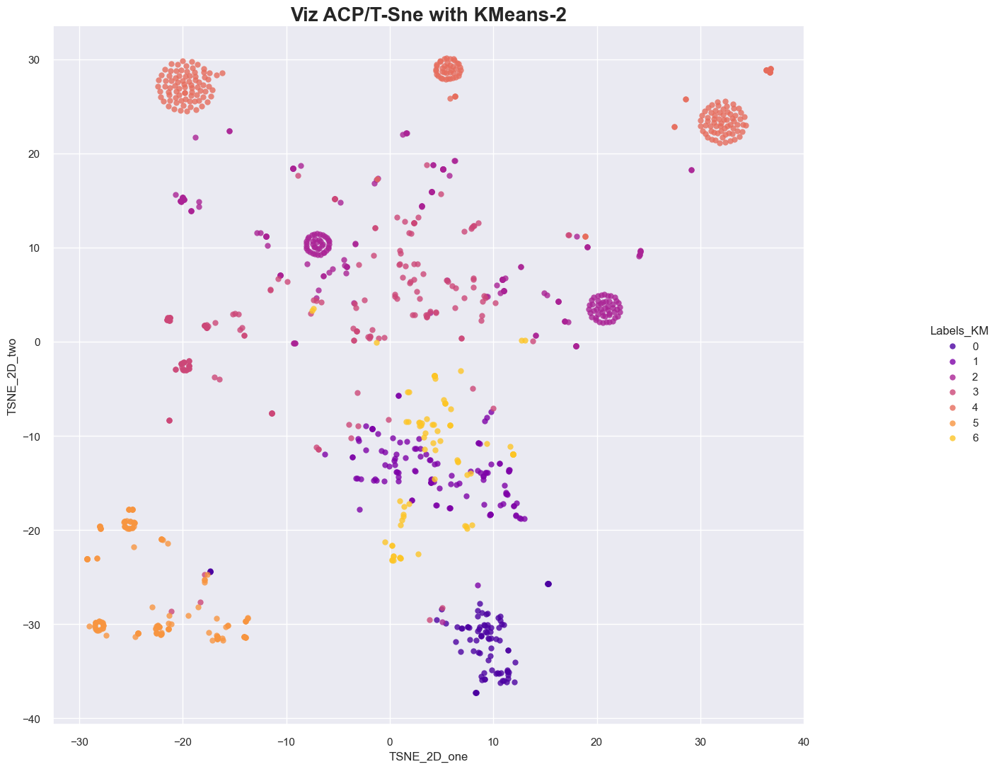

In [ ]:
sns.lmplot(x='TSNE_2D_one', 
           y='TSNE_2D_two', 
           hue='Labels_KM', 
           data=df_pca04,
           palette = 'plasma',
           fit_reg=False,
           legend=True, 
           legend_out=True)

plt.gcf().set_size_inches(16, 12)
plt.title('Viz ACP/T-Sne with KMeans-2',size=20, weight='bold')

Pour n_clusters = 7 The average silhouette_score is : 0.20568331898977762


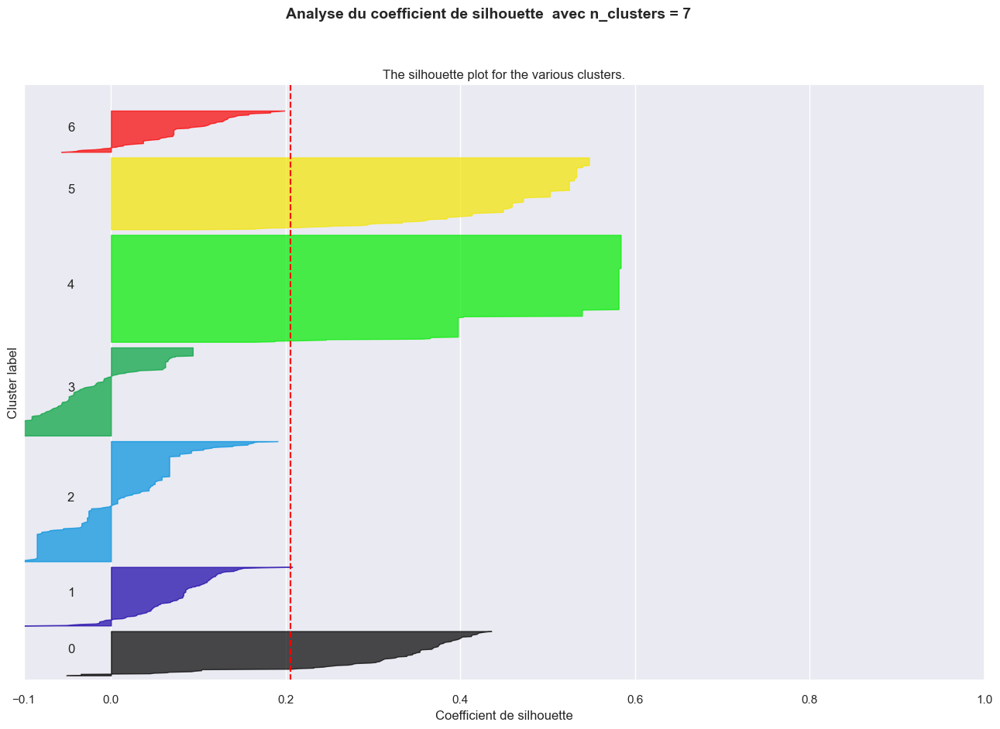

In [ ]:
# Création de plusieurs subplot.
fig, (ax1) = plt.subplots(1, 1)
fig.set_size_inches(16, 10)

ax1.set_xlim([-0.1, 1])

ax1.set_ylim([0, len(df_pca04.iloc[:,:44]) + 8 * 15])

# Nombre de cluster.
n_clusters = 7 

# Labels.
cluster_labels = df_pca04.Labels_KM

# Calcul du coefficient de silhouette pour le nomre de cluster testé.
silhouette_avg = silhouette_score(df_pca04.iloc[:,:44], cluster_labels)
print("Pour n_clusters =", 7,
      "The average silhouette_score is :", silhouette_avg)

# Calcule du coefficient de silhouette pour les samples. Utiliser la fonction silhouette_samples pour calculer les valeurs de coefficient de silhouette pour chaque échantillon en utilisant les données.
sample_silhouette_values = silhouette_samples(df_pca04.iloc[:,:44], cluster_labels)

# Définir une variable y_lower pour la position verticale des échantillons sur la visualisation. La valeur initiale est fixée à 10.
y_lower = 10

# Pour chaque cluster...    
for i in range(n_clusters):
    # Calculer les valeurs de coefficient de silhouette pour les échantillons appartenant au cluster i en triant les valeurs. 
    # Les résultats sont stockés dans la variable ith_cluster_silhouette_values
    ith_cluster_silhouette_values = \
        sample_silhouette_values[cluster_labels == i]

    ith_cluster_silhouette_values.sort()
    # Calculer la taille du cluster i en utilisant la taille de ith_cluster_silhouette_values.
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    # Augmenter la variable y_upper en ajoutant la taille du cluster à sa valeur actuelle. Cela déterminera la position verticale des échantillons pour le cluster suivant.
    y_upper = y_lower + size_cluster_i
    # Définir la couleur pour le cluster en utilisant la fonction nipy_spectral de matplotlib.cm. La couleur sera un dégradé allant de bleu clair pour le premier cluster à bleu foncé pour le dernier cluster.
    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

    # Étiquetez les parcelles de silhouette avec leurs numéros de cluster au milieu
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    ## Augmenter y_lower en ajoutant la taille du cluster à sa valeur actuelle pour déterminer la position verticale des échantillons pour le cluster suivant.
    y_lower = y_upper + 10  # 10 for the 0 samples | 10 pour l'espace entre les clusters

ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("Coefficient de silhouette")
ax1.set_ylabel("Cluster label")

# ligne verticale pour montrer le coefficient de silhouette moyen.
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

ax1.set_yticks([])  # Effacer les étiquettes / tiques de l'axe y/ ticks
ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

plt.suptitle(("Analyse du coefficient de silhouette  "
              "avec n_clusters = %d" % n_clusters),
             fontsize=14, fontweight='bold')

plt.show()

In [ ]:
fig = px.scatter(df_pca04,
                 x='TSNE_2D_one',
                 y='TSNE_2D_two', 
                 color='Categ')

fig.update_layout(
    autosize=False,
    width=950,
    height=650)

fig.show()

In [ ]:
#Mesure de la qualité du KMeans-2 : Indice de Rand ajusté.
adjusted_rand_score(df_pca04.Labels_KM, df_pca04.Categ)

0.26392442418184564

In [ ]:
# Coefficient de silhouette moyen - KMean-2
silhouette_score(df_pca04.iloc[:,:44], df_pca04.Labels_KM)

0.20568331898977762

In [ ]:
# Calcul du coefficient de silhouette de chaque cluster(KMeans-2)
silhouette_per_point = silhouette_samples(df_pca04.iloc[:,:44], df_pca04.Labels_KM)
df_pca04['Silhouette_KM'] = silhouette_per_point

for i in range(7):
    print('Cluster {} :'.format(i),df_pca04[df_pca04['Labels_KM']==i]['Silhouette_KM'].mean()) 


Cluster 0 : 0.303336104117929
Cluster 1 : 0.07157161655483033
Cluster 2 : 0.005449464910173486
Cluster 3 : -0.025981460154593548
Cluster 4 : 0.5291050900519174
Cluster 5 : 0.4660399523615423
Cluster 6 : 0.07782931589540294


C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3202768066.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Remarque: 
  - KMeans [corpus:"description"]  = 0.25 [ARI]
  - KMeansGMM [corpus:"description"] = 0.30 [ARI]
  - KMeans-2 [corpus = "Description + Product name"] = 0.27 [ARI]

  ----------------------
-----------------------

Les différentes approches en plus + Viz and Score (ARI) :
  - Bag of Words - tf_Idf 
  - Word2Vec
  - Bert
  - Universal Sentence Encoder 

In [ ]:
df6.head(3)

,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos,Descrip_Lemm_With_Pos,Descrip_Lemmatize,Clean_DescpProduct
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...",key featur eleg polyest multicolor abstract ey...,"['key', 'featur', 'eleg', 'polyest', 'multicol..."
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...",specif cotton bath towel bath towel red yellow...,"['specif', 'cotton', 'bath', 'towel', 'bath', ..."
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz...","[(key, n), (featur, n), (cotton, n), (terri, n...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...",key featur cotton terri face towel set size sm...,"['key', 'featur', 'cotton', 'terri', 'face', '..."


In [ ]:
#Comptage du nombre de catégories dans "Product_catégory":

l_cat = list(set(df6['categories_1']))
print("catégories : ", l_cat)
y_cat_num = [(1-l_cat.index(df6.iloc[i]['categories_1'])) for i in range(len(df6))]

catégories :  ['Home Furnishing', 'Baby Care', 'Computers', 'Beauty and Personal Care', 'Watches', 'Kitchen & Dining', 'Home Decor & Festive Needs']


In [ ]:
#Fonction Commune
import time

# Calcul Tsne, détermination des clusters et calcul ARI entre vrais catégorie et n° de clusters
def ARI_fct(features) :
    time1 = time.time()
    num_labels=len(l_cat)
    tsne = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000, 
                                 init='random', learning_rate=200, random_state=42)
    #tsne = list(map(float,tsne)) #Test fix error 
    X_tsne = tsne.fit_transform(features)
    
    
    # Détermination des clusters à partir des données après Tsne 
    cls = cluster.KMeans(n_clusters=num_labels, n_init=100, random_state=42)
    cls.fit(X_tsne)
    ARI = np.round(metrics.adjusted_rand_score(y_cat_num, cls.labels_),4)
    time2 = np.round(time.time() - time1,0)
    print("ARI : ", ARI, "time : ", time2)
    
    return ARI, X_tsne, cls.labels_


# visualisation du Tsne selon les vraies catégories et selon les clusters
#def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
#    fig = plt.figure(figsize=(15,6))
#    
#    ax = fig.add_subplot(121)
#    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=y_cat_num, cmap='Set1')
#    ax.legend(handles=scatter.legend_elements()[0], labels=l_cat, loc="best", title="Categorie")
#    plt.title('Représentation des différents catégories ')


def TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI) :
    fig = plt.figure(figsize=(15,6))
    
    ax = fig.add_subplot(121)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=y_cat_num, cmap='Set1')
    legend = ax.legend(handles=scatter.legend_elements()[0], labels=l_cat, title="Categorie")
    plt.title('Représentation des différents catégories ')
    
    # Place la légende en haut à droite
    ax.add_artist(legend)
    legend.set_bbox_to_anchor((0.50, 1.5))

    #legend = ax.legend(handles=scatter.legend_elements()[0], labels=l_cat, title="Categorie")
    #ax.add_artist(legend)
    #legend.set_bbox_to_anchor((0.70, 1.1))

    ax = fig.add_subplot(122)
    scatter = ax.scatter(X_tsne[:,0],X_tsne[:,1], c=labels, cmap='Set1')
    #ax.legend(handles=scatter.legend_elements()[0], labels=set(labels), loc="best", title="Clusters")
    plt.title('Représentation des catégories par clusters')

    #ax.add_artist(legend)
    #legend.set_bbox_to_anchor((0.50, 1.5))

    # Place la légende en haut à droite
    #legend = ax.legend(handles=scatter.legend_elements()[0], labels=l_cat, title="Categorie")
    #ax.add_artist(legend)
    #legend.set_bbox_to_anchor((0.70, 1.1))
    #legend.set_title("Nom de la légende")

    
    plt.show()
    print("ARI : ", ARI)

##### Bag of Word -Tf_idf
    - Préparation sentence
    - Exécution des modèles
    - graphiques

Ce code utilise les classes CountVectorizer et TfidfVectorizer de la bibliothèque scikit-learn pour vectoriser des données textuelles.

Les données textuelles sont stockées dans un DataFrame pandas nommé df6, dans une colonne appelée 'description'.

La classe CountVectorizer est utilisée pour générer une matrice de type "comptage de mots" à partir des données textuelles, tandis que la classe TfidfVectorizer est utilisée pour générer une matrice de type "pondération Tf-idf" à partir des mêmes données.

Les deux classes prennent en compte des paramètres communs pour leur initialisation :

stop_words : une liste de mots à ignorer lors de la vectorisation des données.
max_df : un seuil en pourcentage (ou en nombre absolu) au-delà duquel les mots les plus fréquents dans les données seront ignorés.
min_df : un seuil en pourcentage (ou en nombre absolu) en dessous duquel les mots les moins fréquents dans les données seront ignorés.
Le code utilise ensuite les méthodes fit() des classes CountVectorizer et TfidfVectorizer pour apprendre les règles de vectorisation à partir des données textuelles (df6['description']).



Ce code prépare un bag-of-words en utilisant des fonctionnalités de sklearn. 
Le code utilise d'abord les classes CountVectorizer et TfidfVectorizer pour créer des objets de vectorisation de compte et de poids tf-idf.

Ces objets sont ensuite utilisés pour vectoriser les données contenues dans la colonne description du DataFrame df6, en utilisant le paramètre fit pour ajuster le vectoriseur aux données et transform pour transformer les données en vecteurs numériques utilisables pour l'apprentissage automatique.

Le paramètre stop_words indique que les mots vides (tels que "the", "a", "an") doivent être exclus de la vectorisation, tandis que les paramètres max_df et min_df contrôlent la fréquence minimale et maximale des mots dans les données pour être inclus dans le vocabulaire final.

In [ ]:
# Importation des classes CountVectorizer et TfidfVectorizer
# pour la création de sacs de mots (bag-of-words)
# Préparation:
# création du bag of words (CountVectorizer et Tf-idf):

## from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# Création d'objets de vectorisation de compte et de poids tf-idf
# en utilisant des mots vides anglais et des contraintes sur
# la fréquence minimale et maximale des mots dans les données
cvect = CountVectorizer(stop_words='english', max_df=0.95, min_df=1)
ctf = TfidfVectorizer(stop_words='english', max_df=0.95, min_df=1)

# La colonne des données à vectoriser
feat = 'description'

# Ajustement des objets de vectorisation aux données
# dans la colonne 'description' de df6
cv_fit = cvect.fit(df6[feat])
ctf_fit = ctf.fit(df6[feat])

# Vectorisation des données dans la colonne 'description'
# en utilisant les objets de vectorisation ajustés
cv_transform = cvect.transform(df6[feat])  
ctf_transform = ctf.transform(df6[feat])  


In [ ]:
#Exécution des modèles: 

print("CountVectorizer : ")
print("-----------------")
ARI, X_tsne, labels = ARI_fct(cv_transform)
print()
print("Tf-idf : ")
print("--------")
ARI, X_tsne, labels = ARI_fct(ctf_transform)

CountVectorizer : 
-----------------


c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



ARI :  0.399 time :  24.0

Tf-idf : 
--------


c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



ARI :  0.5567 time :  23.0


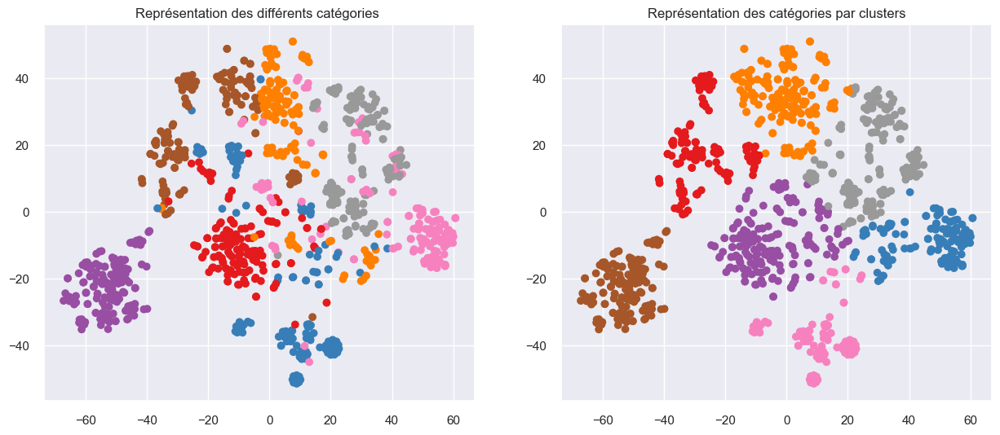

ARI :  0.5567


In [ ]:
 #Viz
 TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

In [ ]:
len(cv_fit.get_feature_names_out())

5843

##### Word2Vec :
    - Création du modèle Word2vec
    - Création de la matrice d'embedding
    - Exécution du modèle
    - Graphique

In [ ]:
# import tensorflow as tf
# import tensorflow.keras
# from tensorflow.keras import backend as K
# 
# from tensorflow.keras.preprocessing.text import Tokenizer
# from tensorflow.keras.preprocessing.sequence import pad_sequences
# from tensorflow.keras import metrics as kmetrics
# from tensorflow.keras.layers import *
# from tensorflow.keras.models import Model
# import gensim

Le modèle Word2Vec prend en compte un certain nombre de paramètres pour son entraînement :

- min_count : ce paramètre détermine le nombre minimum d'occurrences d'un mot dans les données d'entraînement pour qu'il soit inclus dans le vocabulaire construit par le modèle.

- window : ce paramètre spécifie la taille de la fenêtre contextuelle utilisée pour prédire un mot à partir de ses voisins dans les données d'entraînement.
vector_size : c'est la taille des vecteurs de mots générés par le modèle une fois entraîné.

- seed : c'est une valeur fixe utilisée pour initialiser les poids du modèle avant l'entraînement.

- workers : c'est le nombre de threads utilisés pour entraîner le modèle.

Le code construit ensuite le vocabulaire du modèle à partir des données d'entraînement (sentences), puis entraîne le modèle sur ces données en utilisant le nombre d'époques spécifié par w2v_epochs.

Enfin, le code imprime la taille du vocabulaire construit par le modèle et affiche un message indiquant que l'entraînement est terminé.

In [ ]:
w2v_size=300
w2v_window=5
w2v_min_count=1
w2v_epochs=100
maxlen = 24 # adapt to length of sentences
sentences = df6['description'].to_list()
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [ ]:
# Création et entraînement du modèle Word2Vec

print("Build & train Word2Vec model ...")
# Spécification des paramètres du modèle Word2Vec
w2v_model = gensim.models.Word2Vec(min_count= w2v_min_count,window=w2v_window,
                                   vector_size = w2v_size,
                                   seed=42,
                                   workers=1)
# Construction du vocabulaire à partir des données d'entraînement (sentences)                                              
w2v_model.build_vocab(sentences)
w2v_model.train(sentences, total_examples=w2v_model.corpus_count, epochs=w2v_epochs)
# Stockage des vecteurs de mots générés par le modèle
model_vectors = w2v_model.wv
# Récupération des mots du vocabulaire du modèle
w2v_words = model_vectors.index_to_key
#Affichage de la taille du vocabulaire
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 5192
Word2Vec trained


In [ ]:
# Préparation des sentences (tokenization)

print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                                                     maxlen=maxlen,
                                                     padding='post') 
                                                   
num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 5193


In [ ]:
# Affiche un message :"Création de la matrice d'embedding..."
print("Create Embedding matrix ...")

# Définit la taille de la matrice d'incorporation // fenêtre
w2v_size = 300

# Récupère l'index des mots du modèle
word_index = tokenizer.word_index

# Calcule la taille du vocabulaire
vocab_size = len(word_index) + 1

# Initialise une matrice d'incorporation remplie de zéros
embedding_matrix = np.zeros((vocab_size, w2v_size))

# Initialise des compteurs pour calculer le taux de couverture des mots
i = 0
j = 0

# Parcourt chaque mot et son index dans l'index des mots
for word, idx in word_index.items():
    i += 1  # Incrémente le compteur de mots

    # Vérifie si le mot est connu du modèle
    if word in w2v_words:
        j += 1  # Incrémente le compteur de mots trouvés

        # Récupère le vecteur d'incorporation associé au mot
        embedding_vector = model_vectors[word]

        # Vérifie que le vecteur d'incorporation existe
        if embedding_vector is not None:
            # Ajoute le vecteur d'incorporation à la matrice d'incorporation
            embedding_matrix[idx] = model_vectors[word]

# Calcule le taux de couverture des mots par les vecteurs d'incorporation
word_rate = np.round(j / i, 4)

# Affiche le taux d'embarquement des mots ainsi que la taille de la matrix d'embedding_matrix
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))


Create Embedding matrix ...
Word embedding rate :  1.0
Embedding matrix: (5193, 300)


Ce code crée une matrice d'incorporation pour un modèle de traitement du langage naturel. Il commence par imprimer "Créer une matrice d'incorporation..." pour indiquer à l'utilisateur ce qui se passe.

Ensuite, il définit la taille de la matrice d'incorporation (w2v_size) et récupère l'index des mots du modèle (word_index) ainsi que la taille du vocabulaire (vocab_size). Il initialise ensuite une matrice d'incorporation remplie de zéros de la taille appropriée.

Le code parcourt ensuite chaque mot et son index dans l'index des mots, vérifie si le mot existe dans les mots connus du modèle (w2v_words), et si c'est le cas, il récupère le vecteur d'incorporation associé à ce mot (embedding_vector) et l'ajoute à la matrice d'incorporation.

 Enfin, il calcule le taux de couverture des mots par les vecteurs d'incorporation en divisant le nombre de mots trouvés par le nombre total de mots, et affiche le résultat ainsi que la taille de la matrice d'incorporation

In [ ]:
# Création du modèle d'embedding :
input = Input(shape=(len(x_sentences),maxlen), dtype='float64')
# Définit une couche d'entrée pour une séquence de phrases avec une longueur maximale de maxlen, de type de données float64

word_input = Input(shape=(maxlen,), dtype='float64')
# Définit une couche d'entrée pour une phrase unique avec une longueur maximale de maxlen, de type de données float64

word_embedding = Embedding(input_dim=vocab_size,
                           output_dim=w2v_size,
                           weights=[embedding_matrix],
                           input_length=maxlen)(word_input)
# Définit une couche d'incorporation qui prend en entrée la phrase unique, et la mappe à une incorporation de mot en utilisant
# la matrice d'incorporation spécifiée, la taille du vocabulaire et la taille de word2vec. La longueur d'entrée est fixée à maxlen.

word_vec = GlobalAveragePooling1D()(word_embedding)
# Applique une moyenne globale pour l'incorporation de mots pour produire un vecteur de taille fixe représentant la phrase

embed_model = Model([word_input], word_vec)
# Définit un modèle qui prend en entrée la phrase unique et produit le vecteur de taille fixe en sortie

embed_model.summary()
# Affiche un résumé du modèle



Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 24)]              0         
                                                                 
 embedding (Embedding)       (None, 24, 300)           1557900   
                                                                 
 global_average_pooling1d (G  (None, 300)              0         
 lobalAveragePooling1D)                                          
                                                                 
Total params: 1,557,900
Trainable params: 1,557,900
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Exection du modèle :
embeddings = embed_model.predict(x_sentences)
embeddings.shape

33/33 [==============================] - 0s 2ms/step


(1050, 300)

In [ ]:
ARI, X_tsne, labels = ARI_fct(embeddings)

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



ARI :  0.2393 time :  21.0


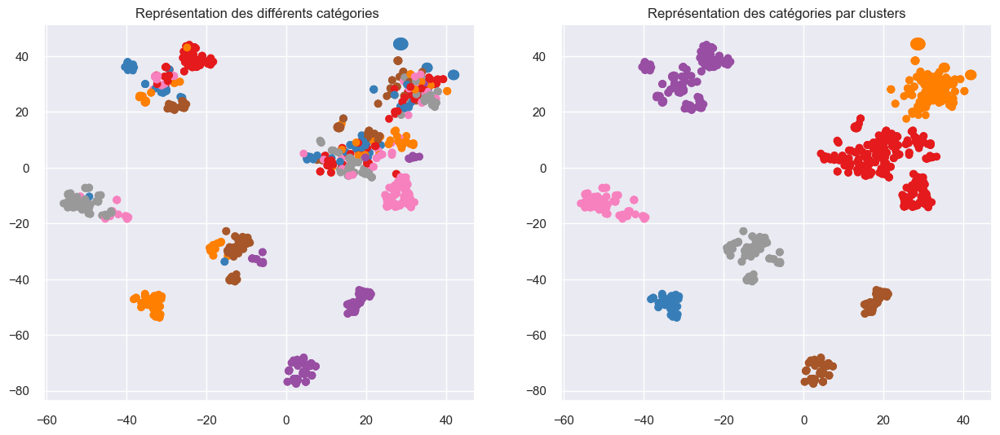

ARI :  0.2393


In [ ]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

----------------
Word2Vect : Modèle pré-formé par Google  

Word2Vec est un modèle plus récent qui intègre des mots dans un espace vectoriel de dimension inférieure à l'aide d'un réseau neuronal peu profond. Le résultat est un ensemble de vecteurs de mots où les vecteurs proches les uns des autres dans l'espace vectoriel ont des significations similaires en fonction du contexte, et les vecteurs de mots éloignés les uns des autres ont des significations différentes. Par exemple, stronget powerfulseraient proches l'un de l'autre et stronget Parisseraient relativement éloignés.

-----------------
##### Bert :
  - Fonction communes
  - Bert HuggingFace
  - Bert hub tensorFlow

In [ ]:
print(tf.__version__)
print(tensorflow.__version__)
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
print(tf.test.is_built_with_cuda())

2.11.0
2.11.0
Num GPUs Available:  0
False


In [ ]:
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize

# Fonction de tokenization :
def tokenizer_fct(sentence) :
    # print(sentence)
    sentence_clean = sentence.replace('-', ' ').replace('+', ' ').replace('/', ' ').replace('#', ' ')
    word_tokens = word_tokenize(sentence_clean)
    return word_tokens


# lower case et alpha
def lower_start_fct(list_words) :
    lw = [w.lower() for w in list_words if (not w.startswith("@")) 
    #                                   and (not w.startswith("#"))
                                       and (not w.startswith("http"))]
    return lw


# Fonction de préparation du texte pour le Deep learning (USE et BERT) :
def transform_dl_fct(desc_text) :
    word_tokens = tokenizer_fct(desc_text)
    # sw = stop_word_filter_fct(word_tokens)
    lw = lower_start_fct(word_tokens)
    # lem_w = lemma_fct(lw)    
    transf_desc_text = ' '.join(lw)
    return transf_desc_text

In [ ]:
df.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [ ]:
df6['sentence_dl_bert'] = df['description'].apply(lambda x : transform_dl_fct(x))
df6.shape

(1050, 15)

In [ ]:
df6.head(3)

,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos,Descrip_Lemm_With_Pos,Descrip_Lemmatize,Clean_DescpProduct,sentence_dl_bert
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...",key featur eleg polyest multicolor abstract ey...,"['key', 'featur', 'eleg', 'polyest', 'multicol...",key features of elegance polyester multicolor ...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...",specif cotton bath towel bath towel red yellow...,"['specif', 'cotton', 'bath', 'towel', 'bath', ...",specifications of sathiyas cotton bath towel (...
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz...","[(key, n), (featur, n), (cotton, n), (terri, n...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...",key featur cotton terri face towel set size sm...,"['key', 'featur', 'cotton', 'terri', 'face', '...",key features of eurospa cotton terry face towe...


Remarque :

Ce code contient deux fonctions, bert_inp_fct et feature_BERT_fct, qui utilisent un modèle BERT pour traiter des phrases d'entrée et générer des features correspondantes.

La fonction bert_inp_fct prend en entrée une liste de phrases, un tokenizer BERT, et une longueur maximale d'entrée. Elle utilise le tokenizer pour encoder les phrases en entrée, ajoute des jetons spéciaux, gère le padding et le troncage, puis retourne les identifiants d'entrée, les identifiants de type de jeton et les masques d'attention.

La fonction feature_BERT_fct utilise ensuite le modèle BERT pour prédire les features pour chaque phrase en utilisant la fonction bert_inp_fct pour prétraiter les phrases d'entrée. La fonction retourne les features BERT moyennes pour chaque phrase ainsi que les états cachés finaux pour chacune d'elle.

In [ ]:
# Fonction de préparation des phrases: Pour "Bert"
# Cette fonction prend en entrée une liste de phrases, un tokenizer BERT et une longueur maximale d'entrée
# et utilise le tokenizer pour encoder les phrases en entrée, ajouter des jetons spéciaux, gérer le padding et le troncage
# et retourner les identifiants d'entrée, les identifiants de type de jeton et les masques d'attention

def bert_inp_fct(sentences, bert_tokenizer, max_length) :
    input_ids = [] # Liste pour stocker les identifiants d'entrée
    token_type_ids = [] # Liste pour stocker les identifiants de type de jeton
    attention_mask = [] # Liste pour stocker les masques d'attention
    bert_inp_tot = [] # Liste pour stocker les résultats pour chaque phrase

    # Pour chaque phrase dans les phrases en entrée
    for sent in sentences:
        # Utiliser le tokenizer pour encoder la phrase, ajouter des jetons spéciaux, gérer le padding et le troncage,
        # et retourner les identifiants d'entrée, les identifiants de type de jeton et les masques d'attention
        bert_inp = bert_tokenizer.encode_plus(sent,
                                              add_special_tokens = True,
                                              max_length = max_length,
                                              padding='max_length',
                                              return_attention_mask = True, 
                                              return_token_type_ids=True,
                                              truncation=True,
                                              return_tensors="tf")
    
        # Ajouter les résultats pour la phrase à la liste
        input_ids.append(bert_inp['input_ids'][0])
        token_type_ids.append(bert_inp['token_type_ids'][0])
        attention_mask.append(bert_inp['attention_mask'][0])
        bert_inp_tot.append((bert_inp['input_ids'][0], 
                             bert_inp['token_type_ids'][0], 
                             bert_inp['attention_mask'][0]))

    # Convertir les listes en tableaux numpy
    input_ids = np.asarray(input_ids)
    token_type_ids = np.asarray(token_type_ids)
    attention_mask = np.array(attention_mask)
    
    # Retourner les tableaux numpy
    return input_ids, token_type_ids, attention_mask, bert_inp_tot
    

# Fonction de création des features

# Pour chaque lot de phrases
# Fonction de création des features
def feature_BERT_fct(model, model_type, sentences, max_length, b_size, mode='HF') :
    batch_size = b_size
    batch_size_pred = b_size
    bert_tokenizer = AutoTokenizer.from_pretrained(model_type)
    time1 = time.time()
    
    for step in range(len(sentences)//batch_size) :
        idx = step*batch_size # Index de départ pour le lot
        # Prétraiter les phrases en utilisant la fonction bert_inp_fct
        input_ids, token_type_ids, attention_mask, bert_inp_tot = bert_inp_fct(sentences[idx:idx+batch_size], 
                                                                      bert_tokenizer, max_length)

        # Si le mode est 'HF' (par défaut), utiliser le modèle HuggingFace pour prédire les features pour chaque phrase
        if mode=='HF' :    
            outputs = model.predict([input_ids, attention_mask, token_type_ids], batch_size=batch_size_pred)
            last_hidden_states = outputs.last_hidden_state

        # Si le mode est 'TFhub', utiliser le modèle Tensorflow Hub pour prédire les features pour chaque phrase
        if mode=='TFhub' : 
            text_preprocessed = {"input_word_ids" : input_ids, 
                                 "input_mask" : attention_mask, 
                                 "input_type_ids" : token_type_ids}
            outputs = model(text_preprocessed)
            last_hidden_states = outputs['sequence_output']

        # Si c'est le premier lot de phrases, stocker les résultats dans les variables last_hidden_states_tot et last_hidden_states_tot_0
        if step ==0 :
            last_hidden_states_tot = last_hidden_states
            last_hidden_states_tot_0 = last_hidden_states
        # Pour les lots suivants, concaténer les résultats avec les résultats précédents
        else :
            last_hidden_states_tot = np.concatenate((last_hidden_states_tot,last_hidden_states))

    # Calculer les features BERT moyennes pour chaque phrase
    features_bert = np.array(last_hidden_states_tot).mean

    # Calculer le temps de traitement
    time2 = np.round(time.time() - time1,0)
    print("temps traitement : ", time2)

    # Retourner les features BERT moyennes et les états cachés finaux pour chaque phrase
    return features_bert, last_hidden_states_tot


In [ ]:
pip install transformers

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import os
import transformers
from transformers import *

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\tqdm\auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\transformers\generation_tf_utils.py:24: FutureWarning:

Importing `TFGenerationMixin` from `src/transformers/generation_tf_utils.py` is deprecated and will be removed in Transformers v5. Import as `from transformers import TFGenerationMixin` instead.



In [ ]:
#Bert HunggingFace:

max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type)
sentences = df6['description'].to_list()

loading configuration file config.json from cache at C:\Users\Shadow/.cache\huggingface\hub\models--bert-base-uncased\snapshots\0a6aa9128b6194f4f3c4db429b6cb4891cdb421b\config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file tf_model.h5 from cache at C:\Users\Shadow/.cache\huggingface\hub\models--bert-base-uncased\snapshots\0a6aa9128b6194f4f3c4db429b6cb4891cdb

In [ ]:
features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='HF')

loading configuration file config.json from cache at C:\Users\Shadow/.cache\huggingface\hub\models--bert-base-uncased\snapshots\0a6aa9128b6194f4f3c4db429b6cb4891cdb421b\config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file vocab.txt from cache at C:\Users\Shadow/.cache\huggingface\hub\models--bert-base-uncased\snapshots\0a6aa9128b6194f4f3c4db429b6cb4891cdb421b\vocab

1/1 [==============================] - 1s 754ms/step
temps traitement :  105.0


In [ ]:
X_tsne

array([[ 16.580755  ,   2.4739742 ],
       [ 15.112074  ,   0.66401905],
       [ 15.024129  ,   0.38770342],
       ...,
       [-32.433693  ,  31.55308   ],
       [-32.90801   ,  32.802246  ],
       [-32.907284  ,  32.454975  ]], dtype=float32)

In [ ]:
# ARI, X_tsne, labels = ARI_fct(features_bert) -> Voir comment regler le prooblème 

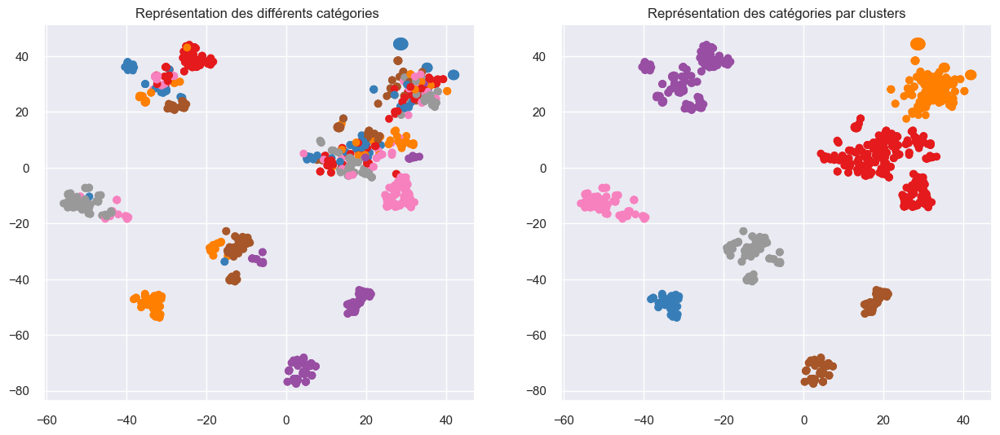

ARI :  0.2393


In [ ]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

-------------------------------

##### Bert hub Tensorflow :

In [ ]:
#!pip install tensorflow-text==2.2.0

In [ ]:
# !pip install tensorflow_text

In [ ]:
#  !pip install "tensorflow-text==2.8.*"

In [ ]:
# import tensorflow_text as tf_text

In [ ]:
from transformers import AutoTokenizer

In [ ]:
# import tensorflow_hub as hub
# import tensorflow_text 
# 
# # Guide sur le Tensorflow hub : https://www.tensorflow.org/text/tutorials/classify_text_with_bert
# model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
# bert_layer = hub.KerasLayer(model_url, trainable=True)

In [ ]:
#pip install <tensorflow-text> --user

In [ ]:
pip install tensorflow-hub

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import tensorflow_hub as hub

In [ ]:
#import tensorflow_hub as hub
#import tensorflow_text 

In [ ]:
# Guide sur le Tensorflow hub : https://www.tensorflow.org/text/tutorials/classify_text_with_bert
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
bert_layer = hub.KerasLayer(model_url, trainable=True)

In [ ]:
sentences = df6['sentence_dl_bert'].to_list()

In [ ]:
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = bert_layer

features_bert, last_hidden_states_tot = feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='TFhub')

loading configuration file config.json from cache at C:\Users\Shadow/.cache\huggingface\hub\models--bert-base-uncased\snapshots\0a6aa9128b6194f4f3c4db429b6cb4891cdb421b\config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading file vocab.txt from cache at C:\Users\Shadow/.cache\huggingface\hub\models--bert-base-uncased\snapshots\0a6aa9128b6194f4f3c4db429b6cb4891cdb421b\vocab

temps traitement :  96.0


In [ ]:
# ARI, X_tsne, labels = ARI_fct(features_bert) -> Voir comment regler le problème 

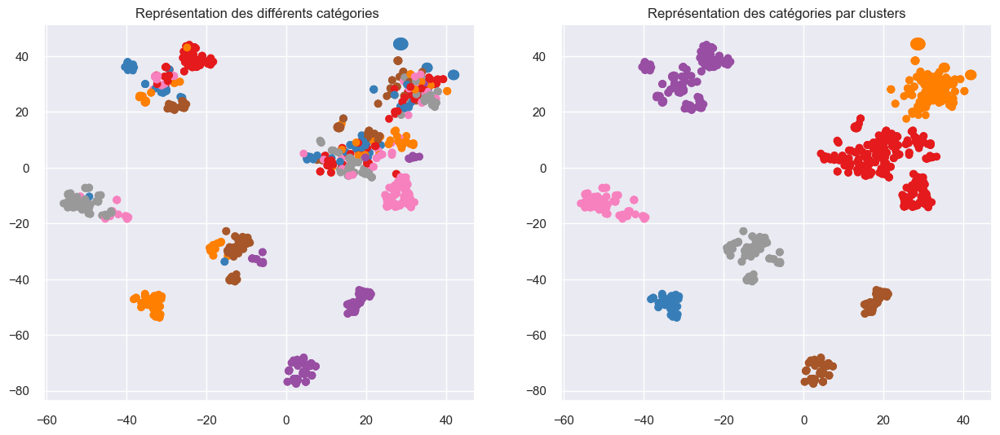

ARI :  0.2393


In [ ]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

------------------------------------------

##### Use - Universal Sentence Encode :

In [ ]:
import tensorflow_hub as hub

embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

Ce code définit une fonction nommée "feature_USE_fct" qui prend en entrée une liste de phrases (sentences) et une taille de batch (b_size) et retourne un tableau de caractéristiques (features). La fonction effectue l'opération suivante :

- Initialise la variable "batch_size" avec la valeur de "b_size".
- Enregistre le temps actuel dans la variable "time1".
- Démarre une boucle qui itère sur chaque étape dans la plage allant de 0 à la longueur de la liste de phrases divisée par la taille de batch.
- Pour chaque étape, calcule l'index en multipliant l'étape par la taille de batch et enregistre le résultat dans la variable "idx".
- Applique la fonction "embed" sur les phrases de la liste situées entre "idx" et "idx + batch_size" et enregistre le résultat dans la variable "feat".
- Si l'étape actuelle est égale à 0, initialise la variable "features" avec la valeur de "feat". Sinon, concatène "feat" avec "features" et enregistre le résultat dans "features".
- Une fois la boucle terminée, enregistre la différence entre le temps actuel et "time1" arrondie à l'entier le plus proche dans la variable "time2".
- Retourne le tableau de caractéristiques "features".

In [ ]:
def feature_USE_fct(sentences, b_size):
    # Initialise la variable batch_size avec la valeur de b_size
    batch_size = b_size
    # Enregistre le temps actuel dans la variable time1
    time1 = time.time()

    # Démarre une boucle qui itère sur chaque étape dans la plage allant de 0 
    # à la longueur de la liste de phrases divisée par la taille de batch
    for step in range(len(sentences)//batch_size):
        # Calcule l'index en multipliant l'étape par la taille de batch et 
        # enregistre le résultat dans la variable idx
        idx = step*batch_size
        # Applique la fonction embed sur les phrases de la liste situées entre idx et idx + batch_size 
        # et enregistre le résultat dans la variable feat
        feat = embed(sentences[idx:idx+batch_size])

        # Si l'étape actuelle est égale à 0, initialise la variable features avec la valeur de feat
        if step == 0:
            features = feat
        # Sinon, concatène feat avec features et enregistre le résultat dans features
        else:
            features = np.concatenate((features,feat))

    # Enregistre la différence entre le temps actuel et time1 arrondie à l'entier le plus proche dans la variable time2
    time2 = np.round(time.time() - time1, 0)
    # Retourne le tableau de caractéristiques features
    return features


In [ ]:
batch_size = 10
sentences = df6['sentence_dl_bert'].to_list()

In [ ]:
features_USE = feature_USE_fct(sentences, batch_size)

In [ ]:
ARI, X_tsne, labels = ARI_fct(features_USE)

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



ARI :  0.4318 time :  23.0


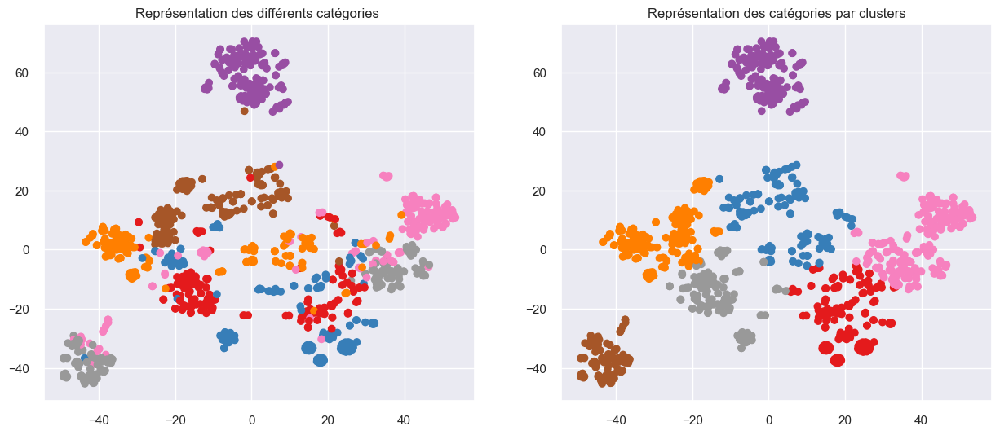

ARI :  0.4318


In [ ]:
TSNE_visu_fct(X_tsne, y_cat_num, labels, ARI)

Remarque: 

Les différents score des clusters (en ARI) 

- WordofBag - tf_idf:<strong> 0.5567 </strong>
- Word2Vec : <strong> 0.2393 </strong>
- Bert : <strong>0.23</strong>
- Universal Sentence Encode : <strong>0.4412</strong>

-----------------------------
------------------------------
Partie 2 :  Analyse des images ...| Computer Vision

Mise en place :

- un algorithme de type SIFT / ORB / SURF ;
- un algorithme de type CNN Transfer Learning.
à suivre ...
--------------------

L'objectif est smiliaire à la partie précédente, nous utiliserons cette fois les images produits pour classer les produits dans la bonne catégorie.

Dans un premier temps, après une étape de préprocessing sur les images, on réalisera un Bag Of Visual Word avec l'algorithme ORB. Le but étant de faire un clustering avec ce BoVW et de mesurer sa qualité.
On fera ensuite un Transfer Learning pour comparer les performances.


In [ ]:
df6.head(5)

,product_name,description,categories_1,clean_description,clean_product_name,Tokenized,Descrip_PS,Descrip_SnowStem,Descrip_Lancast,Descrip_Postag,Descrip_Lemm_WithO_Pos,Descrip_Lemm_With_Pos,Descrip_Lemmatize,Clean_DescpProduct,sentence_dl_bert
0,Elegance Polyester Multicolor Abstract Eyelet ...,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,key featur eleg polyest multicolor abstract ey...,eleg polyest multicolor abstract eyelet door c...,"[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...","[key, feat, eleg, polyest, multicol, abstract,...","[(key, n), (featur, n), (eleg, n), (polyest, n...","[key, featur, eleg, polyest, multicolor, abstr...","[key, featur, eleg, polyest, multicolor, abstr...",key featur eleg polyest multicolor abstract ey...,"['key', 'featur', 'eleg', 'polyest', 'multicol...",key features of elegance polyester multicolor ...
1,Sathiyas Cotton Bath Towel,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,specif cotton bath towel bath towel red yellow...,cotton bath towel,"[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...","[spec, cotton, bath, towel, bath, towel, red, ...","[(specif, n), (cotton, n), (bath, n), (towel, ...","[specif, cotton, bath, towel, bath, towel, red...","[specif, cotton, bath, towel, bath, towel, red...",specif cotton bath towel bath towel red yellow...,"['specif', 'cotton', 'bath', 'towel', 'bath', ...",specifications of sathiyas cotton bath towel (...
2,Eurospa Cotton Terry Face Towel Set,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,key featur cotton terri face towel set size sm...,cotton terri face towel set,"[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...","[key, feat, cotton, terr, fac, towel, set, siz...","[(key, n), (featur, n), (cotton, n), (terri, n...","[key, featur, cotton, terri, face, towel, set,...","[key, featur, cotton, terri, face, towel, set,...",key featur cotton terri face towel set size sm...,"['key', 'featur', 'cotton', 'terri', 'face', '...",key features of eurospa cotton terry face towe...
3,SANTOSH ROYAL FASHION Cotton Printed King size...,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,key featur royal fashion cotton print king siz...,royal fashion cotton print king size doubl,"[key, featur, royal, fashion, cotton, print, k...","[key, featur, royal, fashion, cotton, print, k...","[key, featur, royal, fashion, cotton, print, k...","[key, feat, roy, fash, cotton, print, king, si...","[(key, n), (featur, n), (royal, a), (fashion, ...","[key, featur, royal, fashion, cotton, print, k...","[key, featur, royal, fashion, cotton, print, k...",key featur royal fashion cotton print king siz...,"['key', 'featur', 'royal', 'fashion', 'cotton'...",key features of santosh royal fashion cotton p...
4,Jaipur Print Cotton Floral King sized Double B...,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,key featur print cotton floral king size doubl...,print cotton floral king size doubl,"[key, featur, print, cotton, floral, king, siz...","[key, featur, print, cotton, floral, king, siz...","[key, featur, print, cotton, floral, king, siz...","[key, feat, print, cotton, flor, king, siz, do...","[(key, n), (featur, n), (print, n), (cotton, n...","[key, featur, print, cotton, floral, king, siz...","[key, featur, print, cotton, floral, king, siz...",key featur print cotton floral king size doubl...,"['key', 'featur', 'print', 'cotton', 'floral',...",key features of jaipur print cotton floral kin...


In [ ]:
from os import listdir

In [ ]:
list_photos01 = [file for file in listdir(PATH002)]
print(len(list_photos01))

1050


In [ ]:
from collections import Counter

In [ ]:
def counter_productCategory(category):
    """    
    Args :
    - category : string avec le début du nom de la catégorie.
    Returns :
    - nb de produits dans la catégorie."""
    st = '[\"' + category
    coun = Counter([st in Par_category[i] for i in Par_category.index])
    print(f"Nombre de produits par catégorie \"{category}\":",coun[1])

In [ ]:
df4.head(2)

,product_name,product_category_tree,image,description,categories_1,categories_2
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin


In [ ]:
#Extraction des labels de classification:
Par_category = df4['product_category_tree']
Par_category

0       ["Home Furnishing >> Curtains & Accessories >>...
1       ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
2       ["Baby Care >> Baby Bath & Skin >> Baby Bath T...
3       ["Home Furnishing >> Bed Linen >> Bedsheets >>...
4       ["Home Furnishing >> Bed Linen >> Bedsheets >>...
                              ...                        
1045    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1046    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1047    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1048    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
1049    ["Baby Care >> Baby & Kids Gifts >> Stickers >...
Name: product_category_tree, Length: 1050, dtype: object

In [ ]:
print("Liste des catégories de produit :")
print("-"*50)
counter_productCategory('Baby Care')
counter_productCategory('Baby Care >> Infant Wear')
print("---")
counter_productCategory('Kitchen & Dining >> Coffee Mugs')
counter_productCategory('Kitchen & Dining >> Kitchen Tools')
counter_productCategory('Kitchen & Dining')
print("---")
counter_productCategory('Home Decor')
counter_productCategory('Home Decor & Festive Needs >> Showpieces')
print("---")
counter_productCategory('Home Furnishing')
counter_productCategory('Home Furnishing >> Bed Linen')
counter_productCategory('Home Furnishing >> Living')
print("---")
counter_productCategory('Watches')
counter_productCategory('Watches >> Wrist Watches')
print("---")
counter_productCategory('Computers')
counter_productCategory('Computers >> Laptop Accessories')
counter_productCategory('Computers >> Network Components')
print("---")
counter_productCategory('Beauty and Personal Care')
counter_productCategory('Beauty and Personal Care >> Fragrances')

Liste des catégories de produit :
--------------------------------------------------
Nombre de produits par catégorie "Baby Care": 150
Nombre de produits par catégorie "Baby Care >> Infant Wear": 84
---
Nombre de produits par catégorie "Kitchen & Dining >> Coffee Mugs": 74
Nombre de produits par catégorie "Kitchen & Dining >> Kitchen Tools": 14
Nombre de produits par catégorie "Kitchen & Dining": 150
---
Nombre de produits par catégorie "Home Decor": 150
Nombre de produits par catégorie "Home Decor & Festive Needs >> Showpieces": 71
---
Nombre de produits par catégorie "Home Furnishing": 150
Nombre de produits par catégorie "Home Furnishing >> Bed Linen": 65
Nombre de produits par catégorie "Home Furnishing >> Living": 9
---
Nombre de produits par catégorie "Watches": 150
Nombre de produits par catégorie "Watches >> Wrist Watches": 149
---
Nombre de produits par catégorie "Computers": 150
Nombre de produits par catégorie "Computers >> Laptop Accessories": 87
Nombre de produits par caté

In [ ]:
#Ajoute des "labels" et "numéro de label":
labels = ["Beauty and Personal Care", "Computers", "Baby Care",
          "Home Decor", "Home Furnishing", "Kitchen & Dining", "Watches"]

In [ ]:
def labelling(st):
    """Crée un label (string) si le label est retrouvé dans le string en input.
    Args : 
    - st (string).
    Returns :
    - string pour le label.
    """
    for lab in labels:
        if '[\"' + lab in st:
            return lab
    return 'labelling error'


# test unitaire
st = df4['product_category_tree'][3]
labelling(st)

'Home Furnishing'

In [ ]:
def int_labelling(st):
    """Crée un label (int) si le label est retrouvé dans le string en input.
    Args : 
    - st (string).
    Returns :
    - int pour le label.
    """
    for key, lab in enumerate(labels):
        if '[\"' + lab in st:
            return key
    return -1


# test 
st = df4['product_category_tree'][3]
int_labelling(st)

4

In [ ]:
df4['label'] = df4['product_category_tree'].copy().map(labelling)
df4['int_label'] = df4['product_category_tree'].copy().map(int_labelling)
df4

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3474746084.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Shadow\AppData\Local\Temp\ipykernel_1112\3474746084.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,product_name,product_category_tree,image,description,categories_1,categories_2,label,int_label
0,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Home Furnishing,4
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Care,2
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,Baby Care,2
3,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,Bed Linen,Home Furnishing,4
4,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,Bed Linen,Home Furnishing,4
...,...,...,...,...,...,...,...,...
1045,Oren Empower Extra Large Self Adhesive Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",958f54f4c46b53c8a0a9b8167d9140bc.jpg,Oren Empower Extra Large Self Adhesive Sticker...,Baby Care,Baby & Kids Gifts,Baby Care,2
1046,Wallmantra Large Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",fd6cbcc22efb6b761bd564c28928483c.jpg,Wallmantra Large Vinyl Sticker Sticker (Pack o...,Baby Care,Baby & Kids Gifts,Baby Care,2
1047,Uberlyfe Extra Large Pigmented Polyvinyl Films...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",5912e037d12774bb73a2048f35a00009.jpg,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,Baby Care,Baby & Kids Gifts,Baby Care,2
1048,Wallmantra Medium Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,Baby Care,Baby & Kids Gifts,Baby Care,2


In [ ]:
df4['int_label'].unique()

array([4, 2, 6, 3, 5, 0, 1], dtype=int64)

In [ ]:
dfSift = df4[["image","description","label","int_label"]]

In [ ]:
dfSift.head(2)

,image,description,label,int_label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,2


In [ ]:
dfSift.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   image        1050 non-null   object
 1   description  1050 non-null   object
 2   label        1050 non-null   object
 3   int_label    1050 non-null   int64 
dtypes: int64(1), object(3)
memory usage: 32.9+ KB


In [ ]:
dfSift.groupby("label").count()

,image,description,int_label
label,,,
Baby Care,150,150,150
Beauty and Personal Care,150,150,150
Computers,150,150,150
Home Decor,150,150,150
Home Furnishing,150,150,150
Kitchen & Dining,150,150,150
Watches,150,150,150


In [ ]:
dfSift['label'].unique()

array(['Home Furnishing', 'Baby Care', 'Watches', 'Home Decor',
       'Kitchen & Dining', 'Beauty and Personal Care', 'Computers'],
      dtype=object)

Méthode Sift :

In [ ]:
from matplotlib.image import imread

In [ ]:
#Affiche d'exemple d'image label :

list_label = ['Home Furnishing', 'Baby Care', 'Watches', 'Home Decor',
       'Kitchen & Dining', 'Beauty and Personal Care', 'Computers']
label_name = dfSift['label']

path = PATH002
list_photos = [file for file in listdir(path)]
print(len(list_photos))


1050


partir de la colonne image du df ! = listdir(path)

In [ ]:
dfSift.head(10)

,image,description,label,int_label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,2
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,2
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,Home Furnishing,4
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,Home Furnishing,4
5,893aa5ed55f7cff2eccea7758d7a86bd.jpg,Maserati Time R8851116001 Analog Watch - For ...,Watches,6
6,f355cc1ccb08bd0d283ed979b7ee7515.jpg,"Camerii WM64 Elegance Analog Watch - For Men,...",Watches,6
7,dd0e3470a7e6ed76fd69c2da27721041.jpg,T STAR UFT-TSW-005-BK-BR Analog Watch - For B...,Watches,6
8,41384da51732c0b4df3de8f395714fbb.jpg,"Alfajr WY16B Youth Digital Watch - For Men, B...",Watches,6
9,710ed5f2393a4b9e8823aa0029f71f93.jpg,TAG Heuer CAU1116.BA0858 Formula 1 Analog Watc...,Watches,6


In [ ]:
dfSift['image'][10]

'920154acbe49d3202ed7d2ed2df1ea13.jpg'

Home Furnishing


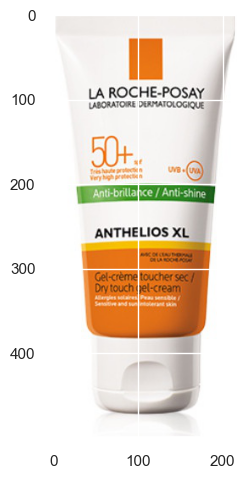

Baby Care


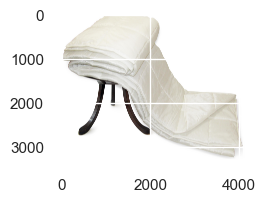

Watches


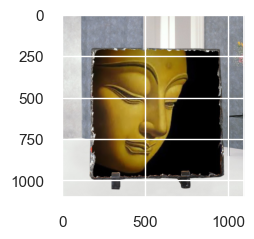

Home Decor


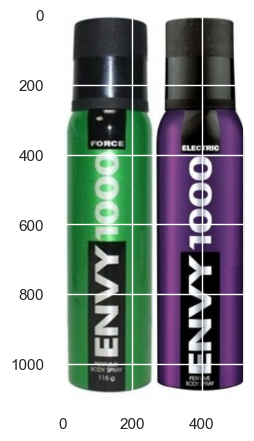

Kitchen & Dining


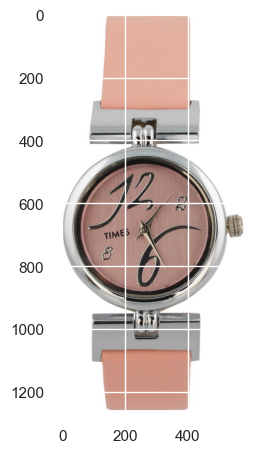

Beauty and Personal Care


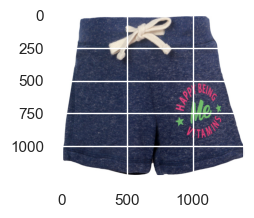

Computers


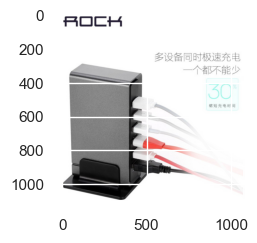

In [ ]:
def list_fct(name) :
    list_image_name = [list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]==name]
    return list_image_name

list_HomeFurnishing=[list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]=="Home Furnishing"]
list_BabyCare=[list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]=="Baby Care"]
list_Watches=[list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]=="Watches"]
list_HomeDecor=[list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]=="Home Decor"]
list_KitchenDinning=[list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]=="Kitchen & Dining"]
list_BeautyCare=[list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]=="Beauty and Personal Care"]
list_Computers=[list_photos[i] for i in range(len(dfSift)) if dfSift["label"][i]=="Computers"]


for name in list_label :
    print(name)
    # print("-------")
    for i in range(1):
        plt.subplot(130 + 1 + i)
        filename = PATH002 + '/' + list_fct(name)[i+10]
        image = imread(filename)
        plt.imshow(image)
    plt.show()

## Détermination et affichage des descripteurs SIFT:

    - l'image contient 503 descripteurs
    - chaque descripteur est un vecteur de longueur 32

In [ ]:
import cv2

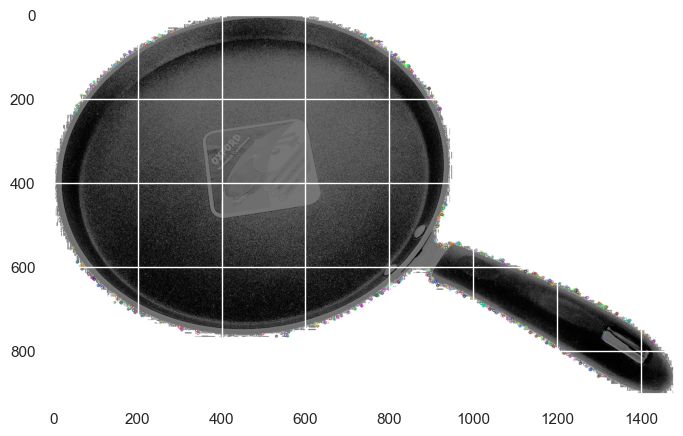

Descripteurs : (500, 32)

[[ 20 184 156 ... 120 131 155]
 [166 237 192 ... 123 240 136]
 [164 237 132 ... 127 210 136]
 ...
 [ 70 237 214 ... 123 209 128]
 [ 98 168 212 ...   8  97 136]
 [182 173 198 ... 123 113 128]]


In [ ]:
sift = cv2.SIFT_create()
image = cv2.imread(path+'/'+list_photos[1],0) #convert in gray
image = cv2.equalizeHist(image) # equalize image histogram
orb = cv2.ORB_create()
kp,des = orb.detectAndCompute(image.astype(np.uint8),None)
img=cv2.drawKeypoints(image,kp,image)
plt.imshow(img)
plt.show()
print("Descripteurs :",des.shape)
print()
print(des)

## Pré-traitement des images via SIFT

### Création des descripteurs de chaque image:
    - Pour chaque image passage en gris et equalisation
    - création d'une liste de descripteurs par image ("sift_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par image.
    - création d'une liste de descripteurs pour l'ensemble des images("sift_keypoints_all") qui sera utilisé pour créer les clusters de descripteurs. 

Le module cv2 est une bibliothèque de traitement d'images en OpenCV (Open Source Computer Vision) qui permet de manipuler des images et de détecter des caractéristiques dans des images.

La classe SIFT est utilisée pour détecter et décrire des points clés dans une image en utilisant des descripteurs qui sont robustes aux rotations, aux translations et aux changements de luminosité. Ces points clés et descripteurs peuvent être utilisés pour comparer et associer des images entre elles.

Les étape de l'identification : 

 - 1) On importe les modules time et cv2
 - 2) On déclare une liste vide sift_keypoints
 - 3) On crée un objet sift de type SIFT (Scale Invariant Feature Transform) en utilisant la méthode cv2.SIFT_create()
 - 4) On boucle sur chaque image dans la liste list_photos
 - 5) On lit l'image depuis le chemin d'accès spécifié et la convertit en niveaux de gris en utilisant cv2.imread()
 - 6) On utilise la fonction cv2.equalizeHist() pour égaliser l'histogramme de l'image
 - 7) On utilise la méthode detectAndCompute() de l'objet sift pour détecter les points clés (keypoints) et calculer les descripteurs associés dans l'image
 - 8) On ajoute les descripteurs à la liste sift_keypoints
 - 9) On convertit la liste en un tableau NumPy sift_keypoints_by_img et concatène tous les descripteurs en un seul tableau NumPy sift_keypoints_all en utilisant np.concatenate()
 - 10) On affiche le nombre de descripteurs dans sift_keypoints_all et le temps total pris pour traiter toutes les images

In [1]:
 # Import des modules time et cv2
 import time,cv2
 
 # Déclaration de la liste vide sift_keypoints
 sift_keypoints = []
 
 # Enregistrement du temps de départ
 temps1 = time.time()
 
 # Création de l'objet sift de type SIFT (Scale Invariant Feature Transform)
 sift = cv2.SIFT_create(500)
 
 # Boucle sur chaque image dans la liste list_photos
 for image_num in range(len(list_photos)):
     # Affichage du numéro de l'image tous les 100 images
     if image_num%100 == 0 : print(image_num)
     
     # Lecture de l'image depuis le chemin d'accès spécifié et conversion en niveaux de gris
     image = cv2.imread(path+'/'+list_photos[image_num],0)
     
     # Égalisation de l'histogramme de l'image
     res = cv2.equalizeHist(image)
     
     # Détection et calcul des points clés (keypoints) et des descripteurs associés dans l'image
     kp,des =sift.detectAndCompute(res,None)
     
     # Ajout des descripteurs à la liste sift_keypoints
     sift_keypoints.append(des)
 
 # Conversion de la liste en un tableau NumPy sift_keypoints_by_img
 sift_keypoints_by_img = np.asarray(sift_keypoints)
 
 # Concaténation de tous les descripteurs en un seul tableau NumPy sift_keypoints_all
 sift_keypoints_all = np.concatenate(sift_keypoints_by_img,axis=0)
 
 # Affichage du nombre de descripteurs dans sift_keypoints_all
 print("Nombre de descripteurs :" , sift_keypoints_all.shape)
 
 # Calcul et affichage du temps total pris pour traiter toutes les images
 duration1 = time.time()-temps1
 print("temps de traitement SIFT descriptor : ","%15.2f"% duration1,"secondes")
 

## Création des clusters de descripteurs

- Utilisation de "MiniBatchKmeans" pour obtenir des temps de traitement raisonnables

In [ ]:
from sklearn import cluster,metrics

# Détermination number of clusters:
temps1 = time.time()

k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimé : ",k)
print("Création de",k,"clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k,init_size=3*k,random_state=0)
kmeans.fit(sift_keypoints_all)

duration1 = time.time()-temps1
print("temps de traitement kmeans :","%15.2f"% duration1,"secondes")

Nombre de clusters estimé :  719
Création de 719 clusters de descripteurs ...


c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4



temps de traitement kmeans :           16.54 secondes


## Création des features des images :

 - Pour chaque image : 
    * prédiction des numéros de cluster de chaque descripteur
    * création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image. 

Features d'une image -> histogramme d'une image -> Comptage pour une image du nombre de descripteurs par cluster. 


In [ ]:
#Creation of histograms(features)
temps1 = time.time()

def build_histogram(kmean,des,image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des = len(des)
    if nb_des == 0: print("problème histogramme image: ",image_num)
    for i in res :
        hist[i] += 1.0/nb_des
    return hist

#Création of a matrix of histograms
hist_vectors = []

for i,image_desc in enumerate(sift_keypoints_by_img) :
    if i%100 == 0 : print(i)
    hist = build_histogram(kmeans,image_desc,i)#Calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector 

im_features = np.array(hist_vectors)

duration1 = time.time() - temps1
print("temps de création histogrammes: ","%15.2f"% duration1,"secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes:           131.23 secondes


## Réductions de dimension 

### Réduction de dimension PCA:

 * La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension,tout en gardant un niv de variance expliquée élevé(99%).
    
 * L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE.

In [ ]:
from sklearn import manifold,decomposition

print("Dimensions dataset avant réduction PCA:",im_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca = pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA:", feat_pca.shape)

Dimensions dataset avant réduction PCA: (1050, 719)
Dimensions dataset après réduction PCA: (1050, 498)


## Réduction de dimension T-SNE:
 * Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images

In [ ]:
from sklearn import manifold,decomposition

tsne = manifold.TSNE(n_components=2,perplexity=30,
                     n_iter=2000,init='random',random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

df_tsne = pd.DataFrame(X_tsne[:,0:2],columns = ['tsne1','tsne2'])
df_tsne["class"] = dfSift["label"]
print(df_tsne.shape)

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



(1050, 3)


In [ ]:
dfSift.head(2)

,image,description,label,int_label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,2


## Analyse visuelle: affichage T-SNE selon catégories d'images

sns.lmplot(x='Principal component 0', 
            y='Principal component 1', 
            hue='Labels_KM', 
            data=df_pca04,
            palette = 'plasma',
            fit_reg=False,
            legend=True, 
            legend_out=True)

plt.gcf().set_size_inches(16, 12)
plt.title('Viz ACP with KMeans 2',size=20, weight='bold')

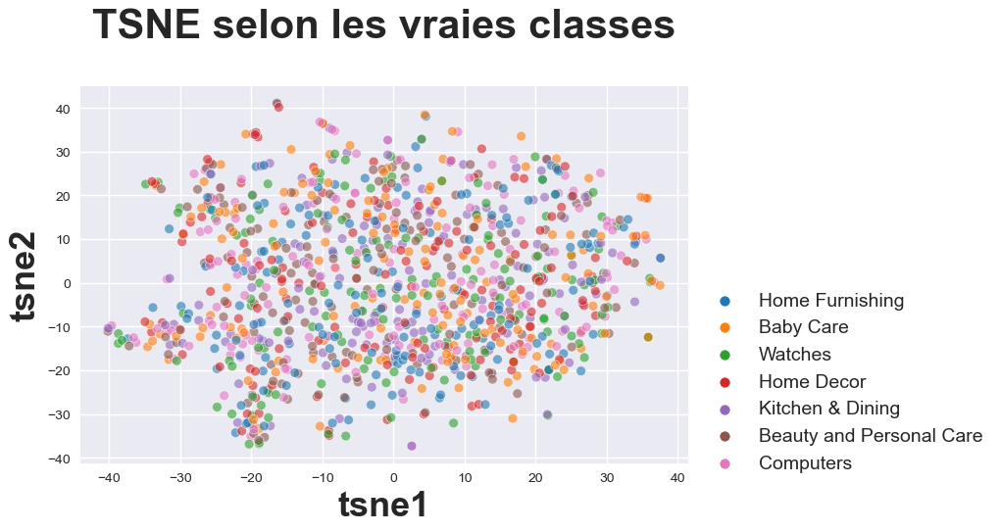

In [ ]:
plt.figure(figsize=(8,5))
ax = sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne,
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6,legend=True)

# sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
#plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.2)
# Put the legend out of the figure
ax.legend(loc='right', bbox_to_anchor=(1, 0.5))


plt.title('TSNE selon les vraies classes', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 26, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 26, fontweight = 'bold')
plt.legend(prop={'size': 14},bbox_to_anchor=(1, 0.5)) 

plt.show()

## Analyse mesures: similarité entre catégories et clusters

Création de clusters à partir du T-SNE:


In [ ]:
from sklearn import cluster,metrics

cls = cluster.KMeans(n_clusters=7,random_state=6)
cls.fit(X_tsne)

df_tsne['cluster'] = cls.labels_ 
print(df_tsne.shape)

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



(1050, 4)


## Affichae des images selons les clusters et calcul ARI de simiralité catégories images / clusters


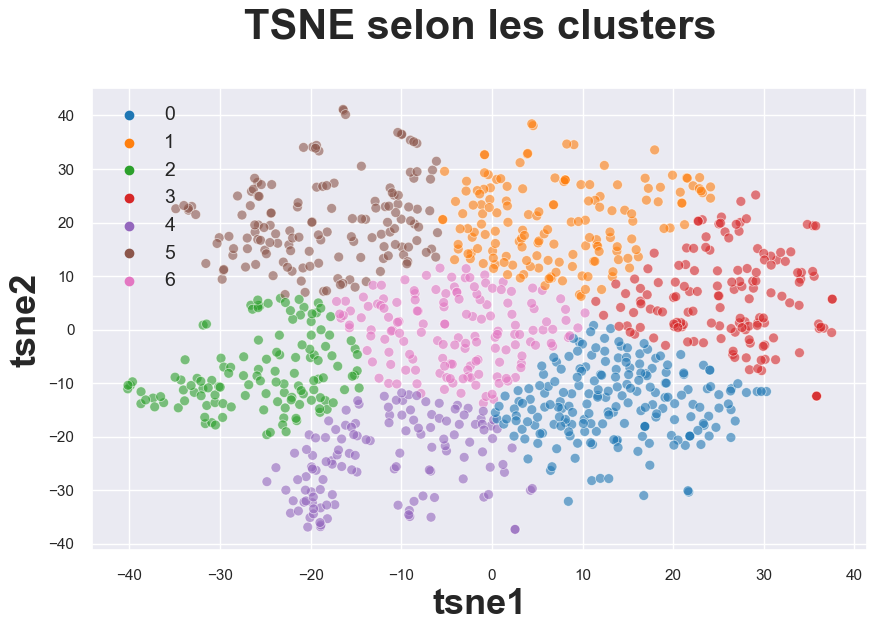

ARI :  0.0012


In [ ]:
plt.figure(figsize=(10,6))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="cluster",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6,
    data=df_tsne,
    legend="brief")

plt.title('TSNE selon les clusters', fontsize = 30, pad = 35, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 26, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 26, fontweight = 'bold')
plt.legend(prop={'size': 14}) 

plt.show()

labels01 = dfSift["int_label"]
print("ARI : ", round(metrics.adjusted_rand_score(labels01, cls.labels_),5))

In [ ]:
dfSift.head(2)

,image,description,label,int_label
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,2


### Analyse par classes : 
 * La matrice de confusion doit être transformée pour avoir en colonne le même ordre des catégories supposées qu'en ligne.
 

In [ ]:
df_tsne.groupby("cluster").count()['class']

cluster
0    199
1    158
2    128
3    144
4    127
5    145
6    149
Name: class, dtype: int64

In [ ]:
labels01

0       4
1       2
2       2
3       4
4       4
       ..
1045    2
1046    2
1047    2
1048    2
1049    2
Name: int_label, Length: 1050, dtype: int64

In [ ]:
cls.labels_

array([4, 0, 2, ..., 0, 6, 0])

In [ ]:
conf_mat = metrics.confusion_matrix(labels01,cls.labels_)
print(conf_mat)

[[22 25 18 18 23 22 22]
 [27 21 30 23 12 20 17]
 [36 23 16 19 12 26 18]
 [30 24 15 21 20 22 18]
 [34 22 19 15 24 19 17]
 [20 26 17 23 16 15 33]
 [30 17 13 25 20 21 24]]


In [ ]:
def conf_mat_transform(y_true,y_pred) :
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    # corresp = np.argmax(conf_mat, axis=0)
    corresp = [6,5,4,3,1, 2, 0]
    print ("Correspondance des clusters : ", corresp)
    # y_pred_transform = np.apply_along_axis(correspond_fct, 1, y_pred)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

cls_labels_transform = conf_mat_transform(labels01, cls.labels_)
conf_mat = metrics.confusion_matrix(labels01, cls_labels_transform)
print(conf_mat)
print()
print(metrics.classification_report(labels01, cls_labels_transform))

Correspondance des clusters :  [6, 5, 4, 3, 1, 2, 0]
[[22 23 22 18 18 25 22]
 [17 12 20 23 30 21 27]
 [18 12 26 19 16 23 36]
 [18 20 22 21 15 24 30]
 [17 24 19 15 19 22 34]
 [33 16 15 23 17 26 20]
 [24 20 21 25 13 17 30]]

              precision    recall  f1-score   support

           0       0.15      0.15      0.15       150
           1       0.09      0.08      0.09       150
           2       0.18      0.17      0.18       150
           3       0.15      0.14      0.14       150
           4       0.15      0.13      0.14       150
           5       0.16      0.17      0.17       150
           6       0.15      0.20      0.17       150

    accuracy                           0.15      1050
   macro avg       0.15      0.15      0.15      1050
weighted avg       0.15      0.15      0.15      1050



<AxesSubplot: >

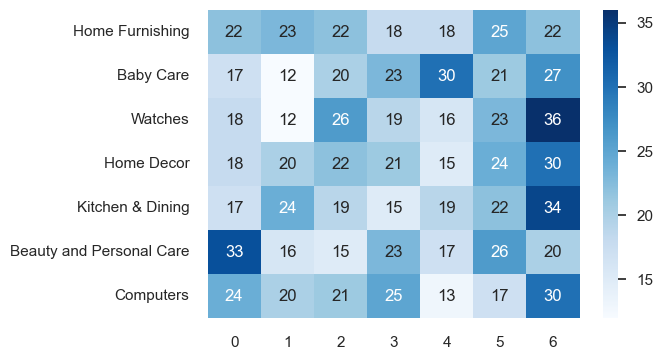

In [ ]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_label], 
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")

-----
## ORB



In [ ]:
def display_scree_plot(pca, dpi=100):
    """ Affiche le graphique des éboulis des valeurs propres :
 
    Args :
    - pca : sklearn.decomposition.PCA
    - dpi : résolution du tracé matplotlib.
    Returns : 
    - graphique matplotlib
    """
    scree = pca.explained_variance_ratio_ * 100
    plt.style.use('seaborn')
    plt.figure(edgecolor='black', linewidth=4, dpi=dpi)
    plt.bar(np.arange(len(scree)) + 1, scree)
    plt.plot(np.arange(len(scree)) + 1, scree.cumsum(), c="red", marker='o')
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.axhline(100 / pca.n_features_,
                0,
                len(pca.components_) + 1,
                c='green',
                linewidth=0.6)  # critère de Kaiser
    plt.show(block=False)


def display_circles(pca,
                    axis_ranks,
                    labels=None,
                    label_rotation=0,
                    lims=None,
                    size_nom_variable=18):
    """ Affiche les cercles des corrélation pour les plan factoriels.
    
    Args :
    - pca : sklearn.decomposition.PCA
    - axis_ranks : liste des plans factoriel à tracer. 
    Exemple :  [(0,1), (2,3)] pour tracer les deux premiers plans.
    - labels : liste de nom des variables.
    - label_rotation : rotation (degrés) de l'affichage des labels.
    - lims : 'auto' ou 'None' ou tuple (xmin, xmax, ymin, ymax)
    des limites du tracé.
    - size_nom_variable : taille de l'affichage  des variables projetées.
    Returns : 
    - affiche une figure matplotlib.
    """
    n_comp = pca.n_components_
    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            # initialisation de la figure
            plt.style.use('seaborn')
            plt.figure(edgecolor='black', linewidth=4, figsize=(10, 10))

            # détermination des limites du graphique
            pcs = pca.components_
            if lims == 'auto':
                xmin, xmax, ymin, ymax = min(pcs[d1, :]), max(pcs[d1, :]), min(
                    pcs[d2, :]), max(pcs[d2, :])
            elif lims is not None:  # lims est un tuple
                xmin, xmax, ymin, ymax = lims
            else:
                xmin, xmax, ymin, ymax = -1, 1, -1, 1

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle
            if pcs.shape[1] < 30:
                plt.quiver(np.zeros(pcs.shape[1]),
                           np.zeros(pcs.shape[1]),
                           pcs[d1, :],
                           pcs[d2, :],
                           angles='xy',
                           scale_units='xy',
                           scale=1,
                           color="grey",
                           width=0.001)

            # affichage des noms des variables
            if labels is not None:
                for i, (x, y) in enumerate(pcs[[d1, d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax:
                        plt.text(x,
                                 y,
                                 labels[i],
                                 fontsize=str(size_nom_variable),
                                 ha='center',
                                 va='center',
                                 rotation=label_rotation,
                                 color="blue",
                                 alpha=0.5)

            # affichage du cercle
            circle = plt.Circle((0, 0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(
                d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)))
            plt.ylabel('F{} ({}%)'.format(
                d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)))

            plt.title("Cercle des corrélations (F{} et F{})".format(
                d1 + 1, d2 + 1))
            plt.axis('square')

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
            plt.show()


def display_factorial_planes(X_projected,
                             pca,
                             axis_ranks,
                             labels=None,
                             size=5,
                             alpha=1,
                             illustrative_var=None):
    """ Affiche les objets (i.e. les lignes du dataset) 
    sur les plan factoriels.
   
    Args :
    - X_projected : array numpy contenant les données (X) après scaling et 
    projection : X_projected = pca.transform(X_scaled)
    - pca : sklearn.decomposition.PCA
    - axis_ranks : liste des plans factoriel à tracer. 
    Exemple :  [(0,1), (2,3)] pour tracer les deux premiers plans.
    - labels : liste de nom des objets.
    - alpha : alpha ("transparence").
    - illustrative_var : variable catégorielle (série pandas avec 
    même nombre d'objets que X_projected) ; ajout d'une couleur sur le 
    tracé pour chaque valeur de la variable.
    Returns : 
    - affiche une figure matplotlib.
    """
    n_comp = pca.n_components_

    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            # initialisation de la figure
            plt.figure(edgecolor='black', linewidth=4, figsize=(7, 6))

            # affichage des points
            if illustrative_var is None:
                plt.style.use('seaborn')
                plt.scatter(X_projected[:, d1],
                            X_projected[:, d2],
                            alpha=alpha, s=size)
            else:
                plt.style.use('default')
                from matplotlib import rcParams
                from cycler import cycler
                rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(X_projected[selected, d1],
                                X_projected[selected, d2],
                                alpha=alpha, s=size,
                                label=value)
                plt.legend(markerscale=3, frameon=False)

            # affichage des labels des points
            if labels is not None:
                for i, (x, y) in enumerate(X_projected[:, [d1, d2]]):
                    plt.text(x + 0.1,
                             y + 0.1,
                             labels[i],
                             fontsize='12',
                             ha='center',
                             va='center')

            # détermination des limites du graphique
            xmin = np.min(X_projected[:, d1])
            xmax = np.max(X_projected[:, d1])
            xdelta = xmax - xmin
            ymin = np.min(X_projected[:, d2])
            ymax = np.max(X_projected[:, d2])
            ydelta = ymax - ymin
            plt.xlim(xmin - 0.02 * xdelta, xmax + 0.02 * xdelta)
            plt.ylim(ymin - 0.02 * ydelta, ymax + 0.02 * ydelta)

            # affichage des lignes horizontales et verticales
            plt.plot([-100, 100], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-100, 100], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(
                d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)))
            plt.ylabel('F{} ({}%)'.format(
                d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)))

            plt.title("Projection (sur F{} et F{})".format(
                d1 + 1, d2 + 1))
            plt.show(block=False)


def draw_tsne(X, perplexites, illustrative_var, color='bgrcmyk', dpi=100):
    """ Visualisation t-SNE en 2 dimensions, avec ajout de labels de couleurs sur les données.
    Args :
    - X : ndarray of shape (n_samples, n_features), la data à réduire par le t-SNE.
    - perplexites : liste de perplexités à tracer.
    - illustrative_var : série de longueur n_samples avec les labels de la data
    - color : couleurs utilisées pour la légende.
    - dpi : résolution du tracé matplotlib.
    Returns :
    - void (tracé matplotlib).
    """
    from cycler import cycler
    from matplotlib import rcParams
    from sklearn import manifold

    rcParams['axes.prop_cycle'] = cycler(color=color)

    for perplexity in perplexites:
        plt.figure(edgecolor='black', linewidth=4, figsize=(6, 6), dpi=dpi)
        tsne = manifold.TSNE(
            n_components=2, random_state=0, perplexity=perplexity)
        data_reduced_tsne = tsne.fit_transform(X)
        illustr_var = np.array(illustrative_var)
        for value in np.unique(illustr_var):
            selected = np.where(illustr_var == value)
            plt.scatter(
                data_reduced_tsne[selected, 0], data_reduced_tsne[selected, 1], s=4, label=value)
        plt.title('PLONGEMENT t-SNE - perplexité = ' +
                  str(perplexity), fontsize=10)
        plt.legend(markerscale=3, frameon=True, fontsize=7)
        plt.show()


def draw_umap(X, illustrative_var, n_neighbors=15, min_dist=0.1, color='bgrcmyk', dpi=100):
    """ Visualisation UMAP en 2 dimensions, avec ajout de labels de couleurs sur les données.
    Args :
    - X : array of shape (n_samples, n_features), la data à réduire par UMAP.
    - illustrative_var : série de longueur n_samples avec les labels de la data
    - n_neighbors : paramètre n_neighbors de UMAP.
    - min_dist : paramètre min_dist de UMAP.
    - color : couleurs utilisées pour la légende.
    - dpi : résolution du tracé matplotlib.
    Returns :
    - void (tracé matplotlib).
    """

    from cycler import cycler
    from matplotlib import rcParams
    import umap  # pip install umap-learn

    umap_embedding = umap.UMAP(
        n_neighbors=n_neighbors, min_dist=min_dist, random_state=0).fit_transform(X)
    plt.figure(edgecolor='black', linewidth=4, figsize=(6, 6), dpi=dpi)
    rcParams['axes.prop_cycle'] = cycler(color=color)
    illustr_var = np.array(illustrative_var)
    for value in np.unique(illustr_var):
        selected = np.where(illustr_var == value)
        plt.scatter(umap_embedding[selected, 0],
                    umap_embedding[selected, 1], s=4, label=value)
        plt.title(
            f'PLONGEMENT UMAP - n_neighbors = {str(n_neighbors)}, min_dist = {str(min_dist)}', fontsize=10)
        plt.legend(markerscale=3, frameon=False, fontsize=7)
    plt.show()


def accuracy_svm(X, y, cv=5):
    """ Calcule l'accuracy sur plusieurs runs de classification par validation croisée
    Args :
    - X : array of shape (n_samples, n_features).
    - y : class labels .
    - cv : paramètre cv de sklearn.model_selection.cross_val_score
    Returns :
    - accuracy du SVM.

    """
    from sklearn.svm import SVC
    from sklearn.model_selection import cross_val_score

    clf = SVC()
    # le scoring par défaut du SVC est 'accuracy'
    accuracies = cross_val_score(clf, X, y, cv=cv)

    print("Accuracy = %.3f" % accuracies.mean())

In [ ]:
# DESCRIPTEUR D'IMAGE 
def descripteurs_orb(index, plot=True, dimension=True):
    """Retourne les descripteurs ORB d'une photo.
    Args : 
    - index : index de la ligne de df_source.
    - plot : booléen pour tracer ou non la photo avec ses descripteurs.
    - dimension : booléen pour imprimer la dimension des descripteurs.
    Returns :
    - array numpy (descripteur ORB) de 32 colonnes et "descripteurs" lignes.
    """
    image = cv2.imread(PATH002 +'/'+ dfSift['image'][index], 0)  # convert in grey
    image = cv2.equalizeHist(image)  # equalize image histogram
    orb = cv2.ORB_create(nfeatures=10000)
    kp, des = orb.detectAndCompute(image, None)
    if plot:
        plt.style.use('default')
        plt.figure(figsize=(8, 8), edgecolor='black', linewidth=4)
        img = cv2.drawKeypoints(image, kp, image)
        plt.imshow(img)
        plt.show()
    if dimension:
        print("Dimension descripteurs : ", des.shape)
    return des

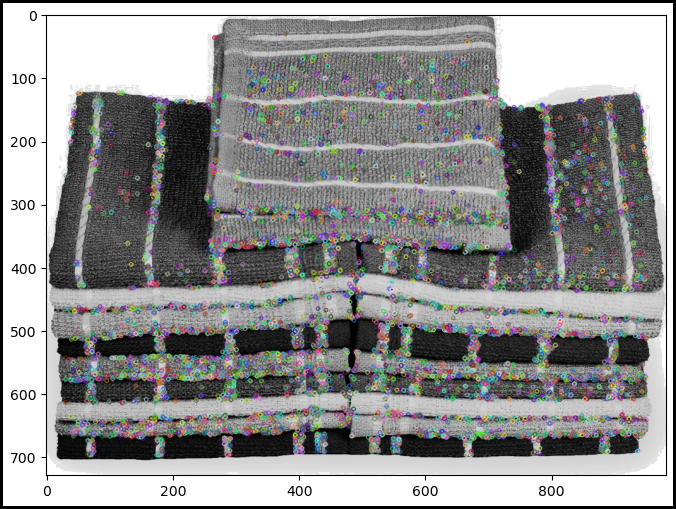

Dimension descripteurs :  (9587, 32)


array([[ 18, 145,  63, ...,   0, 165, 251],
       [ 79, 242, 211, ..., 133, 250, 117],
       [217, 225, 232, ..., 182, 219, 140],
       ...,
       [  0,  73,  30, ..., 155, 169, 168],
       [  1, 162, 209, ...,   8,  75, 128],
       [ 66, 169,  26, ...,  14,  15, 206]], dtype=uint8)

In [ ]:
# test unitaire
descripteurs_orb(2)

### Créations des descripteurs de chaque image (1030000 descripteurs, ~1000 par image)
* Pour chaque image passage en gris et equalisation
* création d'une liste de descripteurs par image ("orb_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par image
* création d'une liste de descripteurs pour l'ensemble des images ("orb_keypoints_all") qui sera utilisé pour créer les clusters de descripteurs
* Le calcul des descripteurs sur notre dataset est 6 fois plus rapide avec ORB que SIFT

In [ ]:
def nom_fichier_photo(idx, df=None):
    """Retourne le chemin + nom du fichier jpg d'une ligne de dataframe.
    Args : 
    - idx : index de la ligne de df.
    Returns :
    - string.
    """
    if df is None:
        df = dfSift
    return PATH002 +'/'+ dfSift['image'][idx]

In [ ]:
# identification of key points and associated descriptors
orb_keypoints = []
# défaut=500   # on se limite à 1000, sur ce dataset, il est fréquent de récupérer des descripteurs à 100000 lignes
orb = cv2.ORB_create(nfeatures=1000)

for index in range(len(dfSift)):
    if index % 10 == 0:
        print(index, "", end='')
    # ouverture fichier image et conversion en niveaux de gris
    image = cv2.imread(nom_fichier_photo(index), 0)
    res = cv2.equalizeHist(image)   # equalize image histogram
    kp, des = orb.detectAndCompute(res, None)
    orb_keypoints.append(des)

0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 880 890 900 910 920 930 940 950 960 970 980 990 1000 1010 1020 1030 1040 

In [ ]:
# Sauvegarde des descripteurs calculés (pickle)

# pickle.dump(orb_keypoints, open('orb_keypoints.pkl', 'wb'))

In [ ]:
# Chargement des descripteurs calculés (pickle)

# orb_keypoints = pickle.load(open('orb_keypoints.pkl', 'rb'))

# len(orb_keypoints)

In [ ]:
orb_keypoints_by_img = np.asarray(orb_keypoints, dtype=object)
orb_keypoints_all = np.concatenate(orb_keypoints_by_img, axis=0)
print("Dimension des descripteurs : ", orb_keypoints_all.shape)

Dimension des descripteurs :  (1032942, 32)


### Utilisation de 1016 clusters de descripteurs
* Utilisation de MiniBatchKMeans pour obtenir des temps de traitement raisonnables

In [ ]:
k = int(round(np.sqrt(len(orb_keypoints_all)), 0))
print("Nombre de clusters : ", k)

# Clustering
kmeans = MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(orb_keypoints_all)

Nombre de clusters :  1016


c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4



MiniBatchKMeans(init_size=3048, n_clusters=1016, random_state=0)

In [ ]:
# pickle.dump(kmeans, open('kmeans_1016clusters_1000features_ORB.pkl', 'wb'))

### Création des features des images
* Pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image

In [ ]:
# Creation of a matrix of histograms
hist_vectors_orb = []

for i, image_desc in enumerate(orb_keypoints_by_img):
    if i % 10 == 0:
        print(i, "", end='')
    hist = build_histogram(kmeans, image_desc, i)  # calculates the histogram
    hist_vectors_orb.append(hist)  # hist is the feature vector

im_features = np.asarray(hist_vectors_orb)

0 10 20 30 40 50 60 70 80 90 100 110 120 130 140 150 160 170 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350 360 370 380 390 400 410 420 430 440 450 460 470 480 490 500 510 520 530 540 550 560 570 580 590 600 610 620 630 640 650 660 670 680 690 700 710 720 730 740 750 760 770 780 790 800 810 820 830 840 850 860 870 880 890 900 910 920 930 940 950 960 970 980 990 1000 1010 1020 1030 1040 

C:\Users\Shadow\AppData\Local\Temp\ipykernel_13084\2714578786.py:3: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



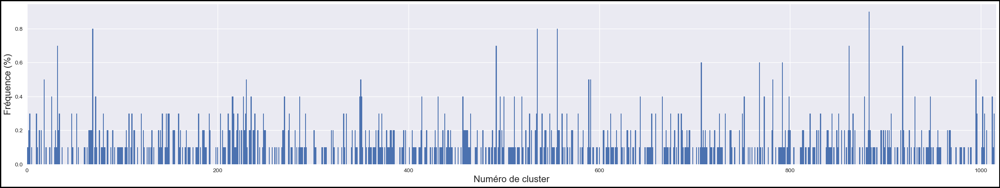

In [ ]:
# Affichage de l'histogramme
index_objet = 1
plt.style.use('seaborn')
plt.figure(edgecolor='black', linewidth=4, figsize=(30, 5))
plt.bar(range(hist.shape[0]), 100*hist_vectors_orb[index_objet], width=1)
plt.xlabel('Numéro de cluster', size=16)
plt.ylabel('Fréquence (%)', size=16)
plt.xlim(0, len(hist_vectors_orb[0]))
plt.show()

## Réduction de dimension 
#### Réduction de dimension PCA
* La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (99%)
* L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE

Dimensions dataset avant réduction PCA :  (1050, 1016)
Dimensions dataset après réduction PCA :  (1050, 735)


C:\Users\Shadow\AppData\Local\Temp\ipykernel_13084\1321883192.py:11: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



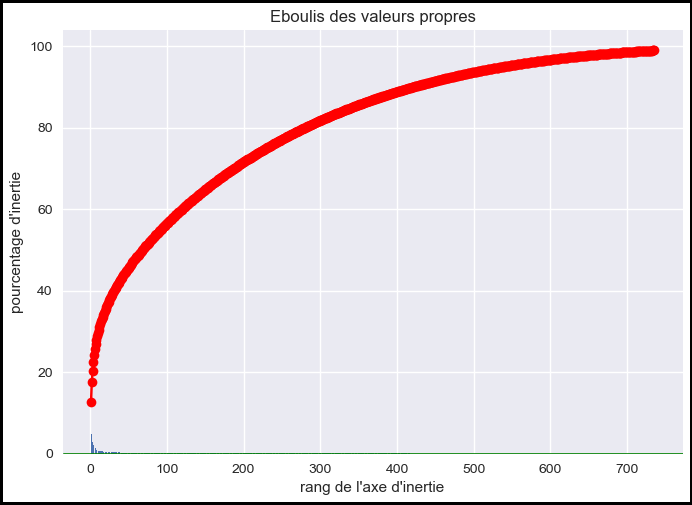

In [ ]:
print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.99)
im_features_scaled = preprocessing.StandardScaler().fit_transform(
    im_features)   # données centrées réduites
feat_pca = pca.fit_transform(im_features_scaled)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)
display_scree_plot(pca)

Une projection sur le premier plan factoriel ne semble pas pertinente, car ses 2 axes ne représentent qu'une faible part de l'inertie.

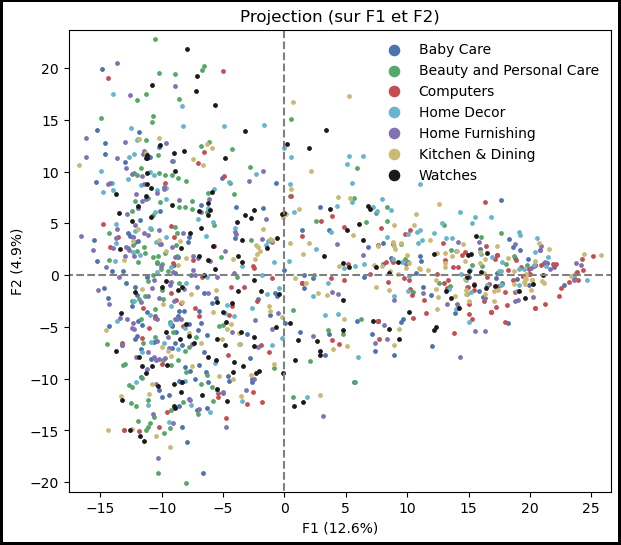

In [ ]:
data_projected = pca.transform(im_features_scaled)
rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')
display_factorial_planes(data_projected, pca, [(0, 1)], size=6, illustrative_var=dfSift['label'])

Pas de cluster apparente après PCA

## Réduction de dimension T-SNE


C:\Users\Shadow\AppData\Local\Temp\ipykernel_13084\2274036506.py:1: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



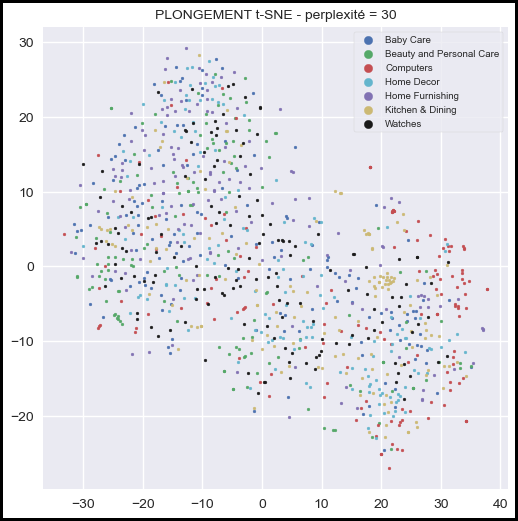

In [ ]:
plt.style.use('seaborn')
perplexities = [30]
draw_tsne(feat_pca, perplexities, dfSift['label'])

### Clustering des images par k-means
#### Méthode du coude sur l'inertie pour déterminer le k optimum

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory le

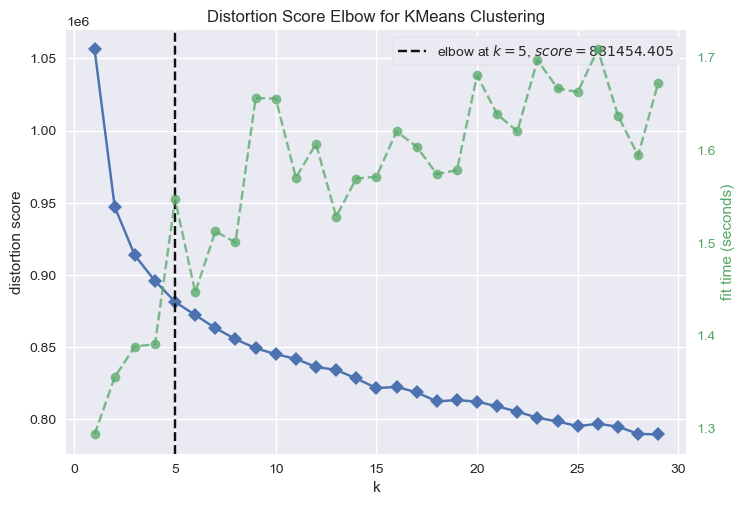

<AxesSubplot: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1, 30))
visualizer.fit(feat_pca)
visualizer.show()

#### Score de silhouette pour déterminer le k optimum

In [ ]:
kmeans_per_k = [KMeans(n_clusters=k, random_state=0).fit(feat_pca)
                for k in range(1, 15)]

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory le

C:\Users\Shadow\AppData\Local\Temp\ipykernel_13084\3500106652.py:4: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



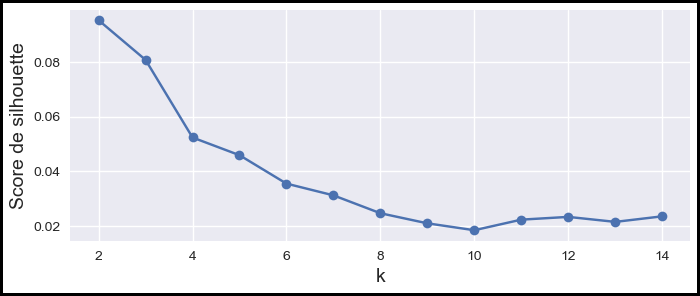

In [ ]:
silhouette_scores = [silhouette_score(feat_pca, model.labels_)
                     for model in kmeans_per_k[1:]]  # k doit être > 1

plt.style.use('seaborn')
plt.figure(figsize=(8, 3), edgecolor='black', linewidth=4)
plt.plot(range(2, len(silhouette_scores) + 2), silhouette_scores, "bo-")
plt.xlabel("k", fontsize=14)
plt.ylabel("Score de silhouette", fontsize=14)
plt.show()

In [ ]:
def diagramme_silhouette(data_scaled, kmeans_per_k):
    """ Affichage du diagramme de silhouette
    Args : 
    - kmeans_per_k : liste des modélisations pour k=1 (oui, k=1) à k=k_max.
    - data_scaled : dataframe pandas converti, centré et normalisé.
    Returns :
    - tracés matplotlib (pour k=2 à k=k_max).
    """
    plt.style.use('seaborn')
    plt.figure(figsize=(11, 13), edgecolor='black', linewidth=4)

    silhouette_scores = [silhouette_score(data_scaled, model.labels_)
                         for model in kmeans_per_k[1:]]  # k doit être > 1

    for k in range(2, 11):
        plt.subplot(3, 3, k - 1)

        y_pred = kmeans_per_k[k - 1].labels_
        silhouette_coefficients = silhouette_samples(data_scaled,
                                                     y_pred)

        padding = len(data_scaled) // 30
        pos = padding
        ticks = []

        # on trie les clusters du plus petit au plus grand
        taille_clusters = {}
        for i in range(k):
            taille_clusters[i] = len(silhouette_coefficients[y_pred == i])
        taille_clusters = {
            k: v
            for k, v in sorted(taille_clusters.items(),
                               key=lambda item: item[1])
        }
        i_color = 0
        for i in reversed(taille_clusters.keys()):
            coeffs = silhouette_coefficients[y_pred == i]
            coeffs.sort()
            color = mpl.cm.Spectral(i_color / (k - 1))
            i_color += 1
            plt.fill_betweenx(np.arange(pos, pos + len(coeffs)),
                              0,
                              coeffs,
                              facecolor=color,
                              edgecolor=color,
                              alpha=1)
            ticks.append(pos + len(coeffs) // 2)
            pos += len(coeffs) + padding

        plt.gca().yaxis.set_major_locator(FixedLocator(ticks))
        plt.gca().yaxis.set_major_formatter(
            FixedFormatter(list(reversed(taille_clusters.keys()))))
        if k in (2, 5, 8):
            plt.ylabel("Cluster")
        plt.gca().set_xticks([0, 0.2, 0.4, 0.6, 0.8, 1])
        if k in (8, 9, 10):
            plt.xlabel("Coefficient de silhouette")
        plt.axvline(x=silhouette_scores[k - 2], color="red", linestyle="--")
        plt.title("$k={}$".format(k), fontsize=14)

    plt.show()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_13084\1299080818.py:9: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



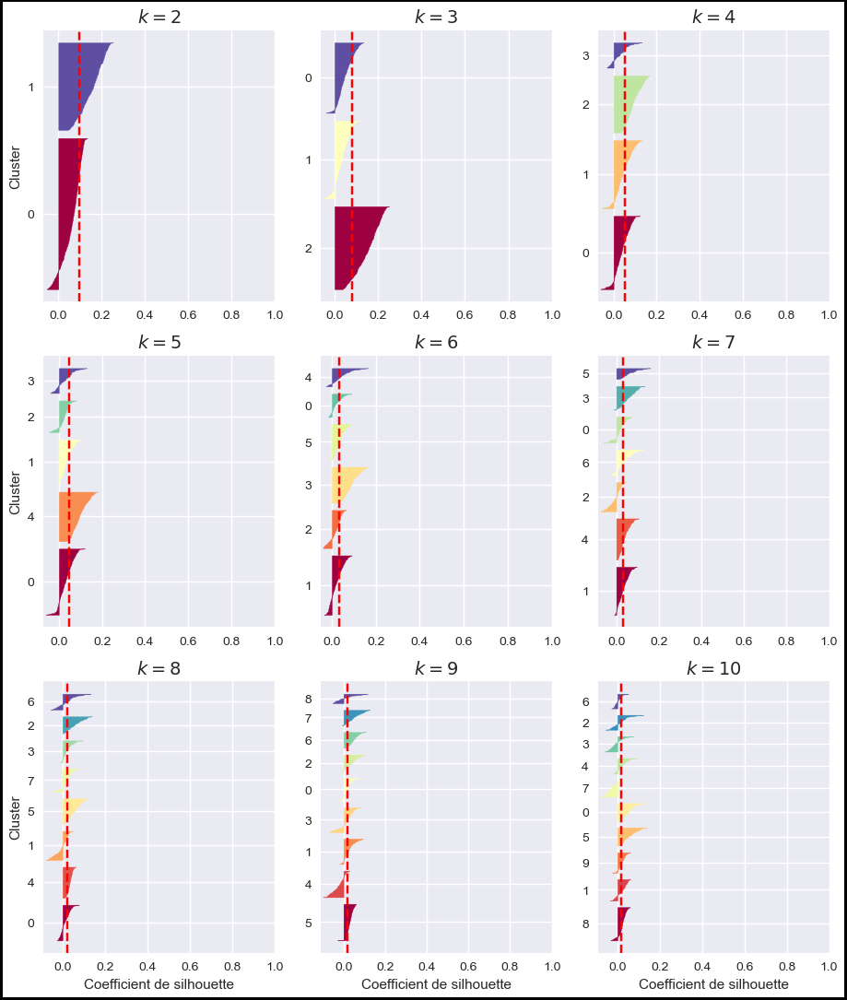

In [ ]:
diagramme_silhouette(feat_pca, kmeans_per_k)

Les scores de silhouette sont faibles, mais ce n'est pas nécessairement mauvais dans la mesure où à dimension élevée, les scores sont plus faibles.

#### Adjusted Rand Score pour les 7 catégories labellisées

In [ ]:
model = KMeans(n_clusters=7, random_state=0, n_init=200).fit(feat_pca)
print("ARI :", adjusted_rand_score(dfSift['label'], model.labels_))
print(" avec : orb = cv2.ORB_create(nfeatures=1000)")

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



ARI : 0.032167399989593844
 avec : orb = cv2.ORB_create(nfeatures=1000)


In [ ]:
# Résultat obtenu en augmentant nfeatures à 10000 lors de la création de l'objet   orb = cv2.ORB_create(nfeatures=10000)
model = KMeans(n_clusters=7, random_state=0, n_init=200).fit(feat_pca)
print("ARI :", adjusted_rand_score(dfSift['label'], model.labels_))
print(" avec : orb = cv2.ORB_create(nfeatures=10000)")

c:\Users\Shadow\anaconda3\envs\Projet6\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.



ARI : 0.032167399989593844
 avec : orb = cv2.ORB_create(nfeatures=10000)


In [ ]:
accuracy_svm(feat_pca, dfSift['int_label'], 100)

Accuracy = 0.434


--------
Deuxième méthode :

- Chargement & Préparation des données:
    * Redimensionnement des images en 224*224 pour l'entrée des CNN. 
- Sift n°2:
- ORB n°2:
- CNN:

In [11]:
from PIL import Image, ImageOps

In [12]:
# Nombre aléatoire pour la reproductibilité des résultats
seed = 21

In [13]:
# Chargement du jeu de données
data_all = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')

In [14]:
# Taille : nombre de lignes/colonnes
nRow, nVar = data_all.shape
print(f'Le jeu de données contient {nRow} lignes et {nVar} variables.')

Le jeu de données contient 1050 lignes et 15 variables.


In [15]:
data_all.head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."


#### Création d'un chemin 

- La variable '**image**' est constituée de la concaténation du e l'identifiant unique (ex : 02127f52e96fb72c66bf081d25104ef8) suivi de '.jpg' : **02127f52e96fb72c66bf081d25104ef8.jpg**.

- Ajout d'une nouvelle variable **image_loc** contenant le chemin du répertoire de stockage des images ainsi que du nom du fichier image pour des appels moins verbeux dans le code.

In [16]:
# Ajout variable image_loc
# ex : data/Images/02127f52e96fb72c66bf081d25104ef8.jpg
path = 'Images' 
data_all['image_loc'] = [path +'/'+ row for row in data_all['image']]

In [17]:
PATH01 ='Images_redim'

In [18]:
data_all['image_redim'] = [PATH01 +'/'+ row for row in data_all['image']]

In [19]:
data_all.head(1)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,image_loc,image_redim
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/55b85ea15a1536d46b7190ad6fff8ce7.jpg


In [20]:
# Découpe les sous-catégories dans des nouvelles variables du dataframe
work = data_all['product_category_tree'].str.split(' >> ', expand=True)
data_all['Categorie_1'] = work[0]
# Nettoye les [" et "]
data_all.replace('\\["', '', regex=True, inplace=True)
data_all.replace('"\\]', '', regex=True, inplace=True)

In [21]:
# --------------------------------------------------------------------
# -- Redimensionner une image en 224*224 sans
# --------------------------------------------------------------------


def cnn_redimensionner_image(image):
    '''
    Image à redimensionner en 224*224 en conservant les proportions.
    Parameters
    ----------
    image : image à sauvegarder, obligatoire.
    Returns
    -------
    Répertoire de localisation de l'image redimensionnée.
    '''
    size = 224, 224
    # On charge l'image d'origine
    im = Image.open(image)
    file_dir = os.path.split(image)
    # L'un des côté de l'image fait 224, on garde le ratio original
    # (pas de déformation)
    im.thumbnail(size, Image.ANTIALIAS)
    # On enregistre dans un nouveau dossier l'image redimensionnée.
    im.save('Images_redim' + file_dir[1])

    # Centrage
    im = Image.open('Images_redim' + file_dir[1])
    width, height = im.size

    if height > width:
        img = Image.new('RGB', (224, 224), (255, 255, 255))  # white
        position_larg = int((height - width) / 2)
        img.paste(im, box=(position_larg, 0))
        img.save('Images_redim' + file_dir[1])

    elif width > height:
        img = Image.new('RGB', (224, 224), (255, 255, 255))  # white
        position_haut = int((width - height) / 2)
        img.paste(im, box=(0, position_haut))
        img.save("Images_redim" + file_dir[1])

    return 'Images_redim' + file_dir[1]

In [21]:
## # Redimensionnement des images en 224*224 pour les entrées des CNN
#data_all['image_redim'] = data_all['image_loc'] \
#    .apply(cnn_redimensionner_image)

- Pour effectuer la classification des catégories en fonction des images, nous garderons :
    -  **image** : le nom de l'image,
    -  **image_loc** : le nom de l'image avec sa localisation dans le répertoire de stockage des images,
    -  **Categorie_1** : la première sous-catégorie.

In [22]:
data = data_all.copy()
data = data[['image', 'image_loc', 'image_redim', 'Categorie_1', ]]
data.head(3)

,image,image_loc,image_redim,Categorie_1
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Images_redim/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Images_redim/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care


In [23]:
df_image_par_cat = data.groupby('Categorie_1').agg({'image' : 'count'})
df_image_par_cat

,image
Categorie_1,
Baby Care,150
Beauty and Personal Care,150
Computers,150
Home Decor & Festive Needs,150
Home Furnishing,150
Kitchen & Dining,150
Watches,150


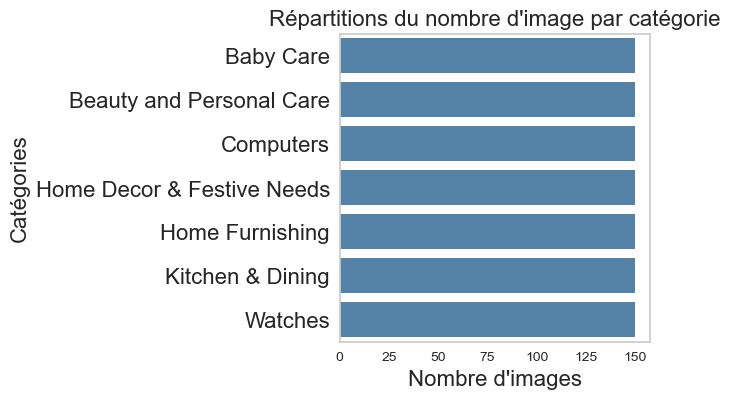

In [26]:
plt.figure(figsize=(4, 4))
sns.barplot(y=df_image_par_cat.index, x=df_image_par_cat.image,
            data=df_image_par_cat, color='SteelBlue')
plt.title('Répartitions du nombre d\'image par catégorie', fontsize=16)
plt.xlabel('Nombre d\'images', fontsize=16)
plt.ylabel('Catégories', fontsize=16)
plt.yticks(fontsize=16)
plt.grid(False)
plt.show()

In [24]:
def trace_pieplot(dataframe, variable, titre, legende, liste_colors):
    """
    Suivi des dipsersions : bosplot et qqplot
    ----------
    @param IN : dataframe : DataFrame, obligatoire
                variable : colonne dont on veut voir les outliers (str)
                titre :titre pour les graphiques (str)
                legende : titre de la légende
                liste_colors : liste des couleurs
    @param OUT :None
    """

    plt.figure(figsize=(30, 7))
    plt.title(titre, size=16)
    nb_par_var = dataframe[variable].sort_values().value_counts()
    # nb_par_var = nb_par_var.loc[sorted(nb_par_var.index)]
    explode = [0.1]
    for i in range(len(nb_par_var) - 1):
        explode.append(0)
    wedges, texts, autotexts = plt.pie(
        nb_par_var, labels=nb_par_var.index, autopct='%1.1f%%', colors=liste_colors, textprops={
            'fontsize': 16, 'color': 'black', 'backgroundcolor': 'w'}, explode=explode)
    axes = plt.gca()
    axes.legend(
        wedges,
        nb_par_var.index,
        title=legende,
        borderaxespad=0.,
        loc=2,
        fontsize=14,
        bbox_to_anchor=(1.5, 1))
    plt.show()

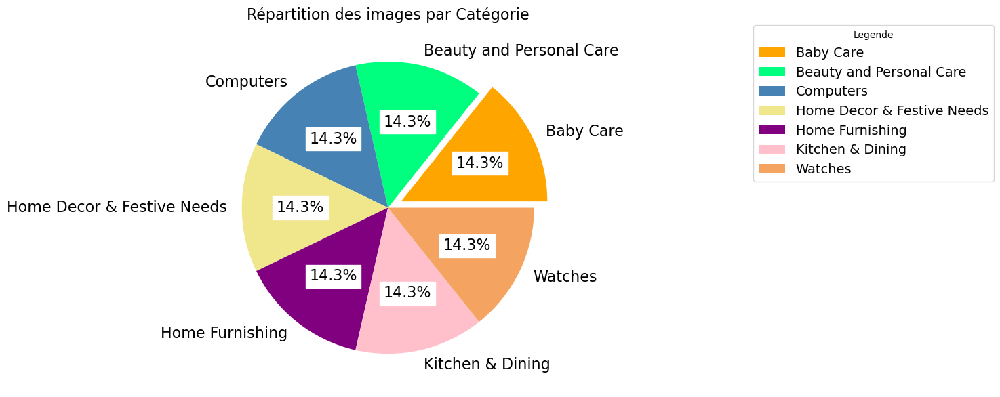

In [16]:
df_visu = df_image_par_cat.reset_index()
trace_pieplot(df_visu, 'Categorie_1',
                          'Répartition des images par Catégorie',
                          'Legende',
                          ['orange', 'SpringGreen', 'SteelBlue', 'Khaki',
                           'Purple', 'pink', 'SandyBrown'])

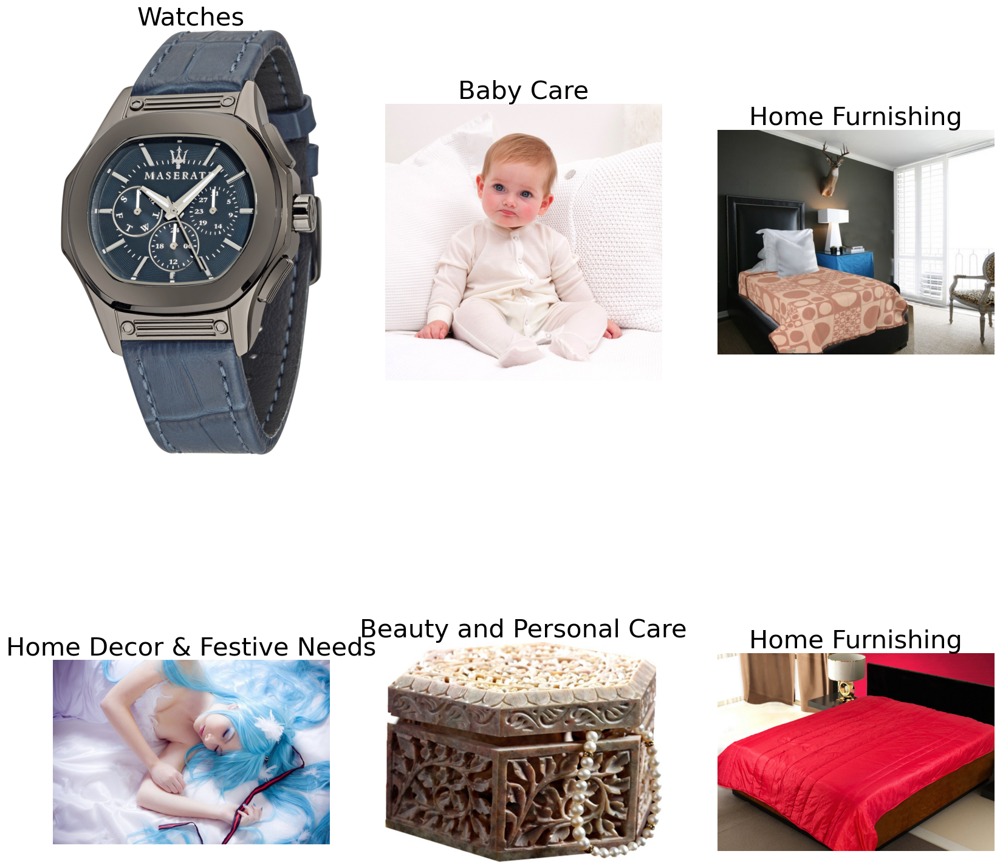

In [20]:
#Viz des échantillon d'un images 
# Sélection de 6 images au hasard
df_visu_img = data.sample(6).reset_index()
plt.figure(figsize=(20, 20))
for i in range(6):
    plt.subplot(2, 3, i + 1)
    # Charge l'image comme matrice de pixels
    img = np.array(Image.open(df_visu_img['image_loc'][i]))
    plt.imshow(img)
    plt.title(df_visu_img['Categorie_1'][i], fontsize=30)
    plt.axis('off')

In [22]:
def stat_descriptives(dataframe, liste_variables):
    """
    Statistiques descriptives moyenne, mediane, variance, écart-type,
    skewness et kurtosis du dataframe transmis en paramètre
    ----------
    @param IN : dataframe : DataFrame, obligatoire
                liste_variables : colonne dont on veut voir les stat descr
    @param OUT : dataframe des statistiques descriptives
    """
    liste_mean = ['mean']
    liste_median = ['median']
    liste_var = ['var']
    liste_std = ['std']
    liste_skew = ['skew']
    liste_kurtosis = ['kurtosis']
    liste_mode = ['mode']
    liste_cols = ['Desc']
    liste_max = ['Max']
    liste_min = ['Min']

    for col in liste_variables:
        liste_mean.append(dataframe[col].mean())
        liste_median.append(dataframe[col].median())
        liste_var.append(dataframe[col].var(ddof=0))
        liste_std.append(dataframe[col].std(ddof=0))
        liste_skew.append(dataframe[col].skew())
        liste_kurtosis.append(dataframe[col].kurtosis())
        liste_cols.append(col)
        liste_mode.append(dataframe[col].mode().to_string())
        liste_min.append(dataframe[col].min())
        liste_max.append(dataframe[col].max())

    data_stats = [liste_mean, liste_median, liste_var, liste_std, liste_skew,
                  liste_kurtosis, liste_mode, liste_min, liste_max]
    df_stat = pd.DataFrame(data_stats, columns=liste_cols)

    return df_stat.style.hide_index()

## Pré-traitement des images [source](https://opencv.org/): 
Le traitement sera effectué en 4 étapes :

    - redimensionnement en 224 * 224,
    - conversion de RGB (couleurs vraies) en niveaux de gris (pour Sift),
    - suppression du bruit,
    - égalisation de l'histogramme 

In [23]:
dim = (224, 224)

In [24]:
def afficher_image_histopixel(image, titre):
    '''
    Afficher côte à côte l'image et l'histogramme de répartiton des pixels.
    Parameters
    ----------
    image : image à afficher, obligatoire.
    Returns
    -------
    None.
    '''
    plt.figure(figsize=(40, 10))
    plt.subplot(131)
    plt.title(titre, fontsize=30)
    plt.imshow(image, cmap='gray')
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

    plt.subplot(132)
    plt.title('Histogramme de répartition des pixels', fontsize=30)
    hist, bins = np.histogram(np.array(image).flatten(), bins=256)
    plt.bar(range(len(hist[0:255])), hist[0:255])
    plt.xlabel('Niveau de gris', fontsize=30)
    plt.ylabel('Nombre de pixels', fontsize=30)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

    plt.subplot(133)
    plt.title('Histogramme cumulé des pixels', fontsize=30)
    plt.hist(np.array(image).flatten(), bins=range(256), cumulative=True)
    plt.xlabel('Niveau de gris', fontsize=24)
    plt.ylabel('Fréquence cumulée de pixels', fontsize=30)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

    plt.show()

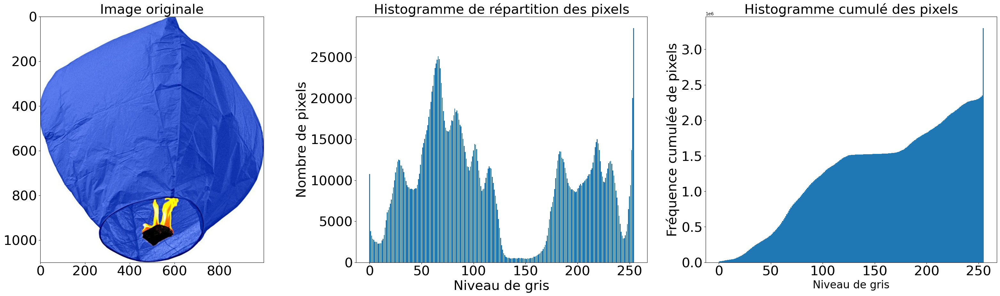

In [25]:
# Chargement de l'image originale comme matrice de pixels
img_orig = Image.open('Images/0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg')
afficher_image_histopixel(img_orig, 'Image originale')

Remarque : 
Correction de l'exposition (étirement d'histogramme)

    - Corriger de la luminosité (ou exposition) de l'image.
    - Image sous-exposée ==> histogramme concentré à droite vers les niveaux de gris faible (255 = blanc).
    - Image sur-exposée ==> histogramme concentré à gauche vers les niveaux de gris fort (0 = noir)

In [44]:
from PIL import Image, ImageOps  # , ImageFilter

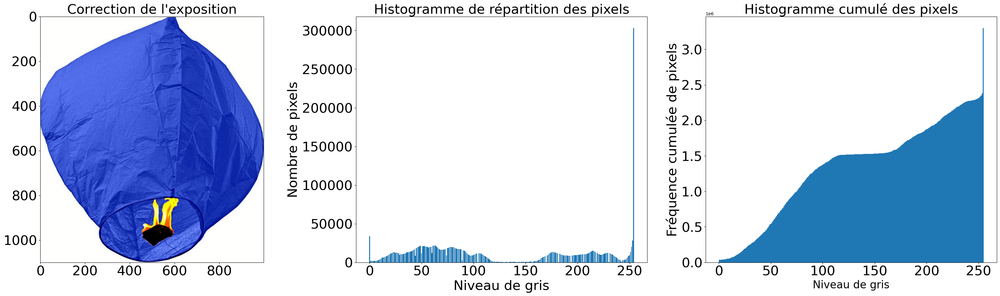

In [26]:
# Correction de l'exposition PILS
img_expo = ImageOps.autocontrast(img_orig, 1)
afficher_image_histopixel(img_expo,'Correction de l\'exposition')

Correction du contraste (égalisation d'histogramme)

- Le contraste caractérise la répartition de lumière dans une image : plus une image est contrastée, plus la différence de luminosité entre ses zones claires et sombres est importante.* 

- En général, une image peu contrastée est terne, tandis qu'une image trop contrastée est visuellement "agressive". 

- Dans les deux cas, l'image manque de clarté car certains de ses détails seront peu, voire pas du tout, visibles.

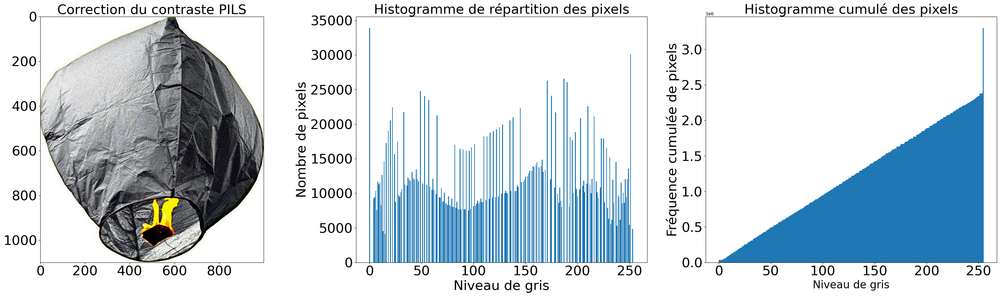

In [27]:
# Correction du contraste PILS
img_contr_pils = ImageOps.equalize(img_expo)
afficher_image_histopixel(img_contr_pils,
                         'Correction du contraste PILS')

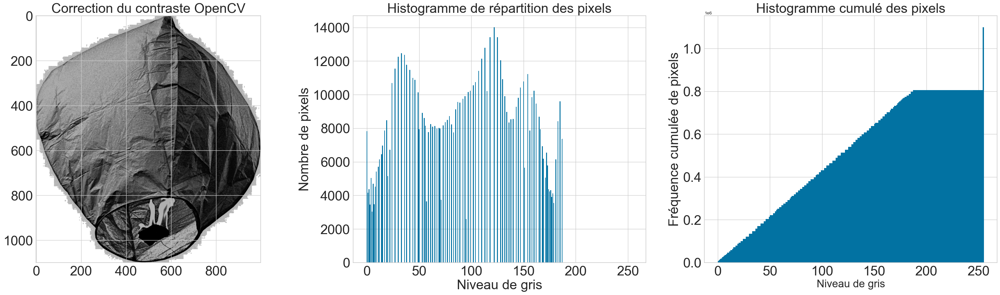

In [41]:
# Correction du contraste OpenCV méthode 1 : equalizeHist
img_expo_gris = cv2.cvtColor(np.array(img_expo), cv2.COLOR_BGR2GRAY)
img_contr_opencv = cv2.equalizeHist(img_expo_gris)
afficher_image_histopixel(img_contr_opencv,
                          'Correction du contraste OpenCV')

**Note :** 

**CLAHE (Contrast Limited Adaptive Histogram Equalization)** : Dans ce cas, l'image est divisée en petits blocs appelés "tuiles" (tileSize est 8x8 par défaut dans OpenCV). 

Ensuite, chacun de ces blocs est égalisé en histogramme comme d'habitude. Ainsi, dans une petite zone, l'histogramme se limitera à une petite région (sauf s'il y a du bruit). 

Si le bruit est présent, il sera amplifié. Pour éviter cela, une limitation du contraste est appliquée. Si une case de l'histogramme est au-dessus de la limite de contraste spécifiée (par défaut 40 dans OpenCV), ces pixels sont coupés et distribués uniformément aux autres cases avant d'appliquer l'égalisation de l'histogramme.

Après l'égalisation, l'interpolation bilinéaire est appliquée pour supprimer les artefacts sur les bords des tuiles.

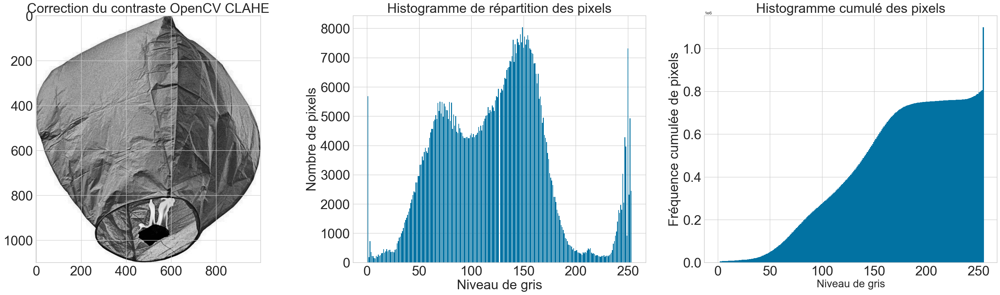

In [42]:
# Correction du contraste OpenCV méthode 2 : CLAHE
# img_expo_gris = cv2.cvtColor(np.array(img_expo), cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(3, 3))
img_contr_clahe = clahe.apply(img_expo_gris)
afficher_image_histopixel(img_contr_clahe,
                                 'Correction du contraste OpenCV CLAHE')

Finalment :

    La correction du contraste OpenCV avec méthode CLAHE donne un histogramme cumulé plus régulier, il sera utilisé dans le cadre du pré-traitement sur toutes les images.

Redimensionnement en 224 * 224

    en entrées des réseaux de neurones, les images doivent avoir la taille 224 * 224.
    Les différentes interpolations : 
[Source](https://medium.com/@wenrudong/what-is-opencvs-inter-area-actually-doing-282a626a09b3)

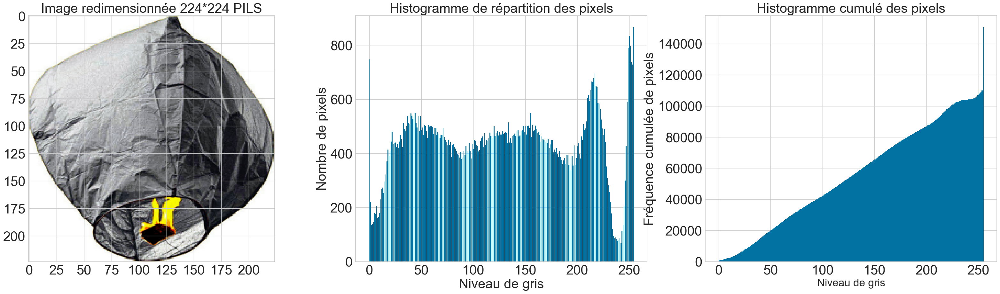

In [43]:
# Redimensionnement image contraste PILS
img_redim_pils = cv2.resize(np.array(img_contr_pils), dim,
                            interpolation=cv2.INTER_AREA)
afficher_image_histopixel(img_redim_pils,
                                'Image redimensionnée 224*224 PILS')

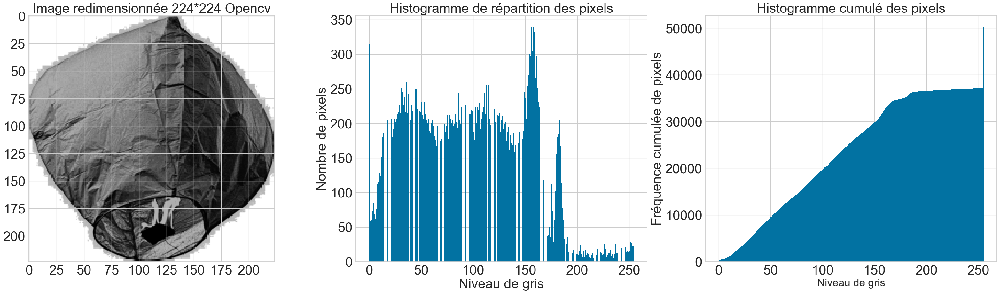

In [44]:
# Redimensionnement image contraste OpenCV
img_redim_opencv = cv2.resize(np.array(img_contr_opencv), dim,
                              interpolation=cv2.INTER_AREA)
afficher_image_histopixel(img_redim_opencv,
                            'Image redimensionnée 224*224 Opencv')

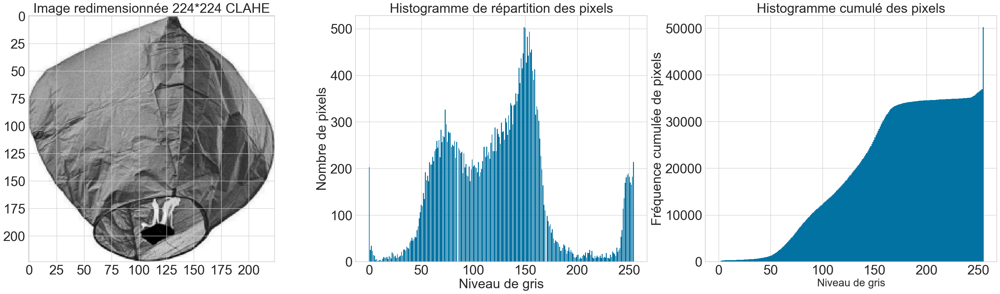

In [45]:
# Redimensionnement image contraste OpenCV CLAHE
img_redim_clahe = cv2.resize(np.array(img_contr_clahe), dim,
                             interpolation=cv2.INTER_AREA)
afficher_image_histopixel(img_redim_clahe,
                                'Image redimensionnée 224*224 CLAHE')

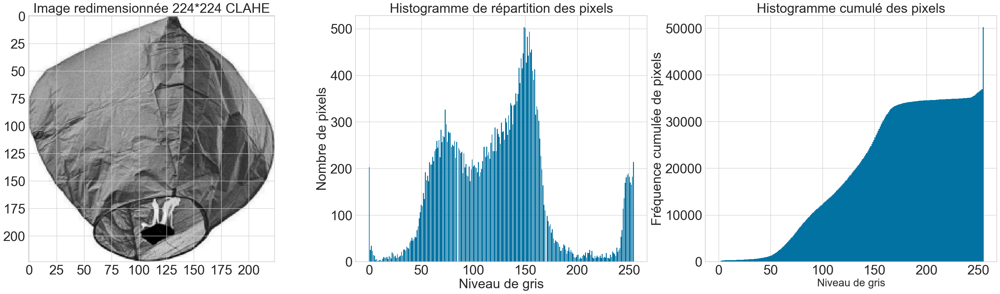

In [46]:
# Redimensionnement image contraste OpenCV CLAHE
img_redim_clahe2 = cv2.resize(np.array(img_contr_clahe), dim,
                             interpolation=cv2.INTER_AREA)
afficher_image_histopixel(img_redim_clahe2,
                                'Image redimensionnée 224*224 CLAHE')

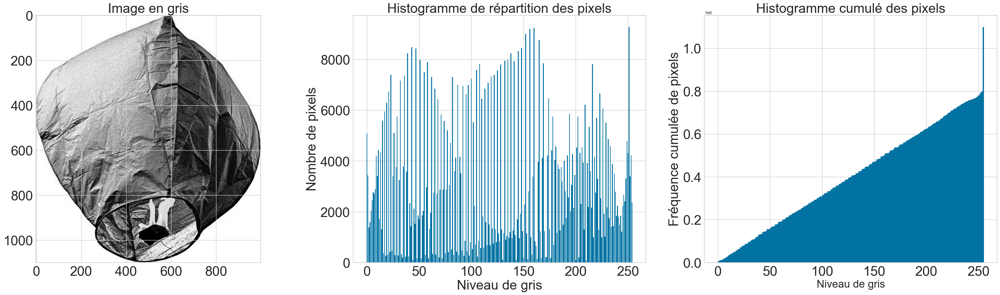

In [47]:
# Conversion de l'image en niveau de gris pour SIFT
img_gris = cv2.cvtColor(np.array(img_contr_pils), cv2.COLOR_RGB2GRAY)
afficher_image_histopixel(img_gris,
                                'Image en gris')

Réduction du bruit

On observe l'apparition d'un bruit qui se rapproche du gaussien : apparition de carré gris.
    Pour améliorer la qualité des images, 3 filtres différents seront testés :
    
        * un filtre gaussienfiltre linéaire dont les éléments du noyau de convolution sont déterminés selon la densité d'une loi gaussienne centrée à 2 dimensions).

        * un filtre par lissage par moyennage la valeur de chaque pixel est remplacée par la moyenne de son voisinage).

        * un filtre par lissage médian (la valeur de chaque pixel est remplacée par la médiane de son voisinage) ou avec un algorithme Non-local Means Denoising Source.

*Réduction du bruit par un filtre gaussien*

*PILS

In [48]:
from PIL import Image, ImageOps, ImageFilter

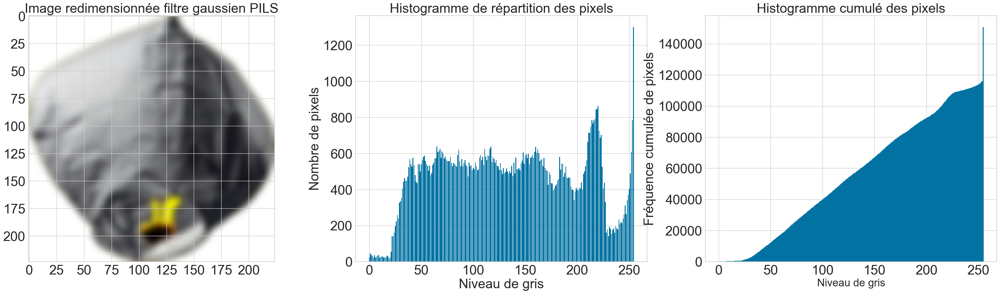

In [49]:
# Réduction du bruit filtre gaussien sur image correction contraste PILS
img_redim_pils_rgb = Image.fromarray(img_redim_pils, 'RGB')
img_gaus_pils = img_redim_pils_rgb.filter(ImageFilter.GaussianBlur(radius=3))

afficher_image_histopixel(img_gaus_pils,
                              'Image redimensionnée filtre gaussien PILS')

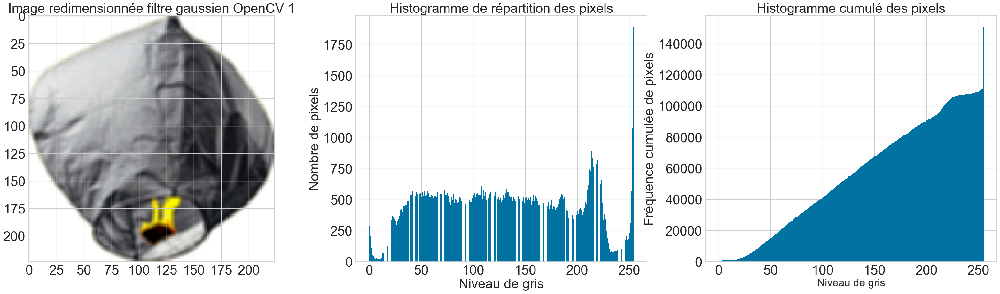

In [50]:
# Réduction du bruit filtre gaussien sur image correction contraste PILS
img_gaus_pils = cv2.GaussianBlur(img_redim_pils, (5, 5), cv2.BORDER_DEFAULT)
afficher_image_histopixel(img_gaus_pils,
                              'Image redimensionnée filtre gaussien OpenCV 1')

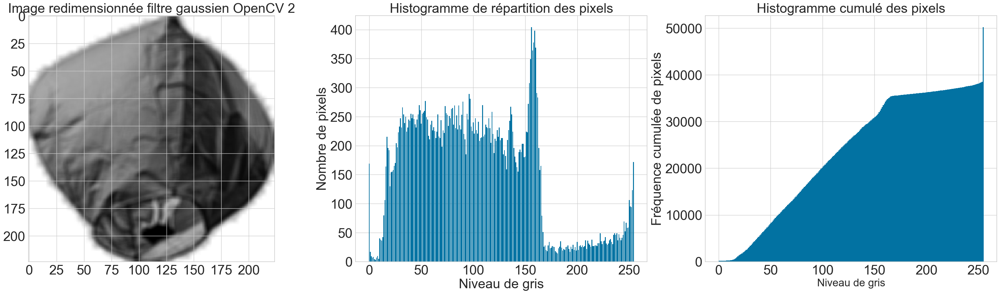

In [51]:
# Réduction du bruit filtre gaussien sur image correction contraste OpenCV
img_gaus_opencv = cv2.GaussianBlur(img_redim_opencv, (5, 5),
                                   cv2.BORDER_DEFAULT)

afficher_image_histopixel(img_gaus_opencv,
                            'Image redimensionnée filtre gaussien OpenCV 2')

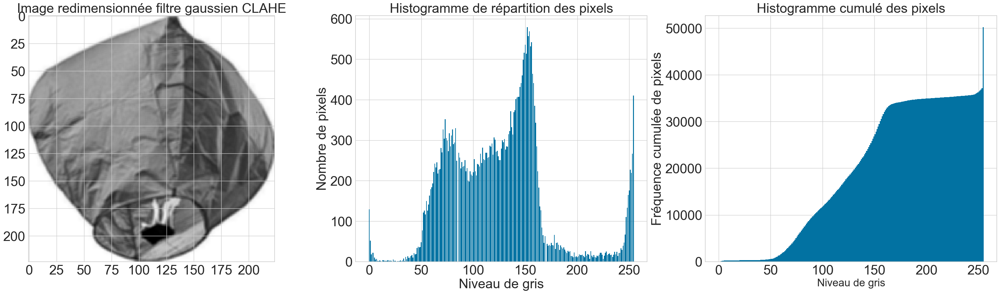

In [52]:
# Réduction du bruit filtre gaussien sur image correction contraste OpenCV
img_gaus_clahe = cv2.GaussianBlur(img_redim_clahe, (3, 3), cv2.BORDER_DEFAULT)

afficher_image_histopixel(img_gaus_clahe,
                              'Image redimensionnée filtre gaussien CLAHE')

In [53]:
from scipy.ndimage import gaussian_filter

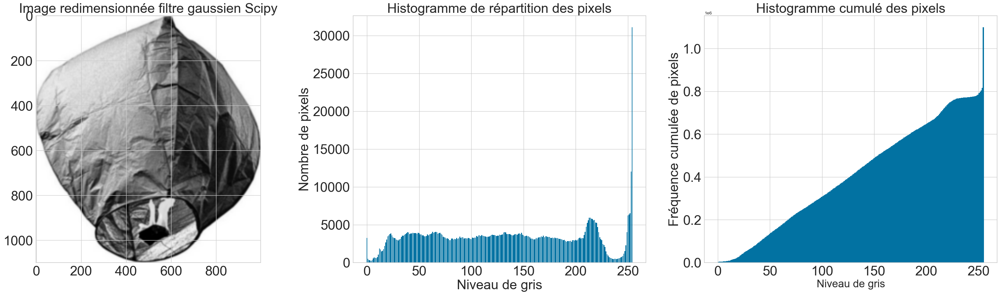

In [54]:
img_gaus_scipy = gaussian_filter(img_gris, sigma=3)

afficher_image_histopixel(img_gaus_scipy,
                              'Image redimensionnée filtre gaussien Scipy')

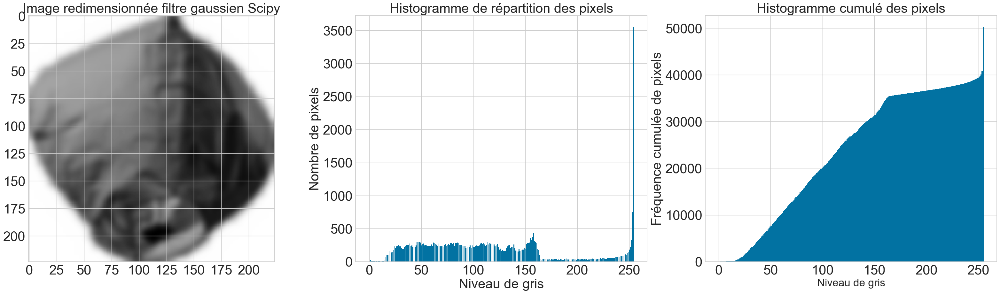

In [55]:
img_gaus_scipy2 = gaussian_filter(img_redim_opencv, sigma=3)

afficher_image_histopixel(img_gaus_scipy2,
                              'Image redimensionnée filtre gaussien Scipy')

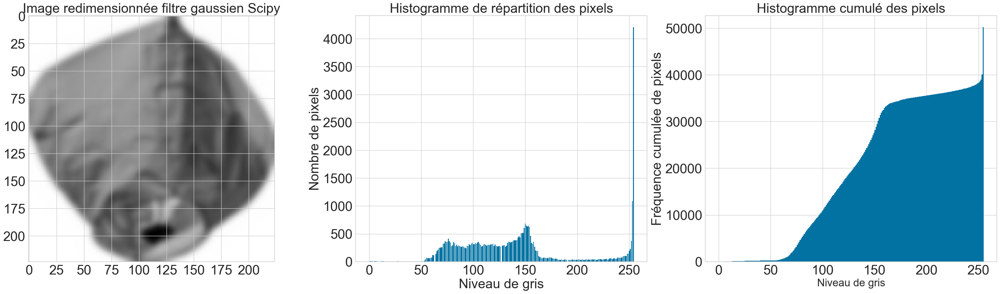

In [56]:
img_gaus_scipy2 = gaussian_filter(img_redim_clahe, sigma=3)

afficher_image_histopixel(img_gaus_scipy2,'Image redimensionnée filtre gaussien Scipy')

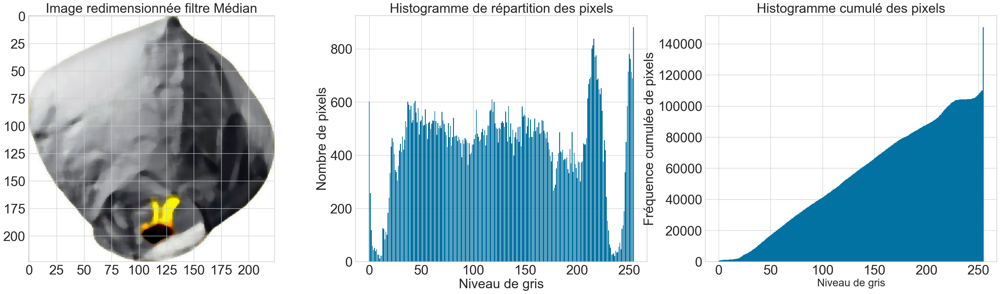

In [57]:
# Réduction du bruit filtre médian sur image correction contraste OpenCV
img_redim_pils_rgb = Image.fromarray(img_redim_pils, 'RGB')
img_median = img_redim_pils_rgb.filter(ImageFilter.MedianFilter(size=7))

afficher_image_histopixel(img_median,'Image redimensionnée filtre Médian')

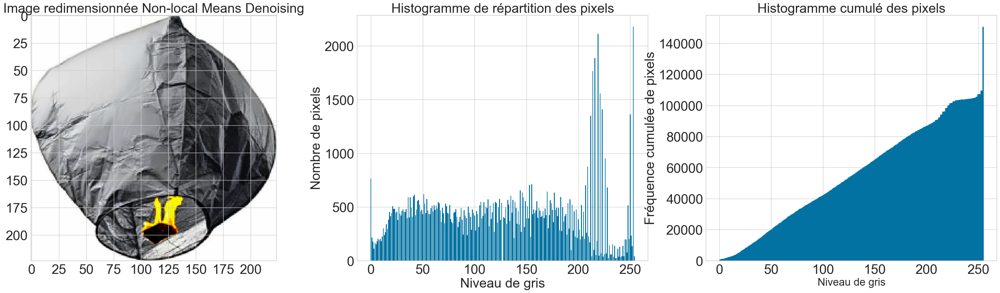

In [58]:
# Réduction du bruit avec l'algorithme  Non-local Means Denoising d'OpenCV
img_fast_pils = cv2.fastNlMeansDenoisingColored(img_redim_pils, None, 5, 5, 7,
                                                21)

afficher_image_histopixel(img_fast_pils,
                              'Image redimensionnée Non-local Means Denoising')

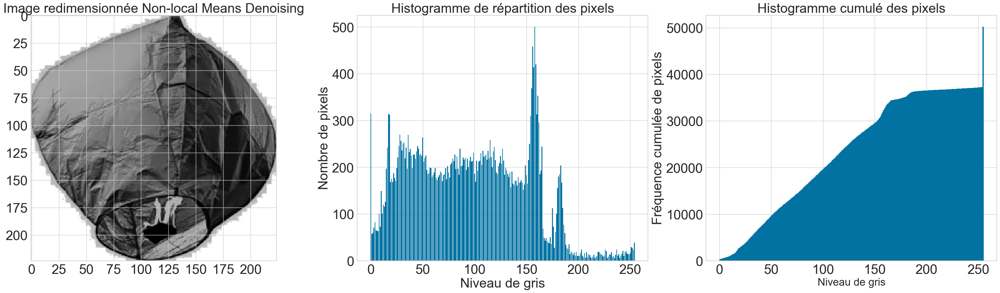

In [59]:
# Réduction du bruit avec l'algorithme Non-local Means Denoising d'OpenCV
img_fast_opencv = cv2.fastNlMeansDenoising(img_redim_opencv, None, 5, 7, 21)
afficher_image_histopixel(img_fast_opencv,
                              'Image redimensionnée Non-local Means Denoising')

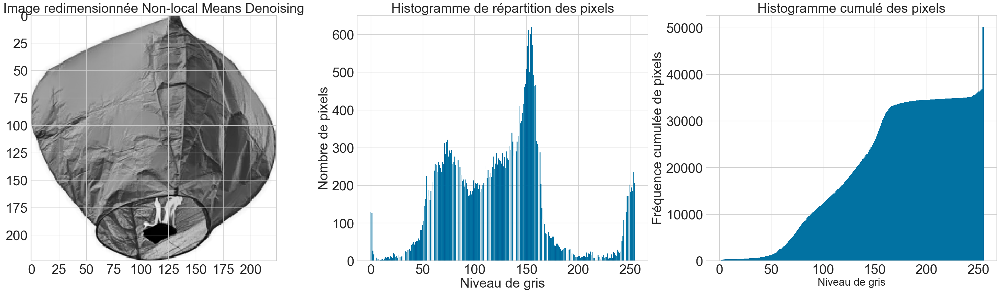

In [60]:
# Réduction du bruit filtre gaussien avec l'algorithme
# Non-local Means Denoising d'OpenCV
img_fast_clahe = cv2.fastNlMeansDenoising(img_redim_clahe, None, 5, 7, 21)

afficher_image_histopixel(img_fast_clahe,
                              'Image redimensionnée Non-local Means Denoising')

Remarque :

Bilan :

- La réduction du bruit avec l'agorithme Non-local Means Denoising d'OpenCV donne un histogramme cumulé plus régulier, on pourra l'utilisé dans le cadre du pré-traitement sur toutes les images.

Bilan des différents tests : 

Suivant les différents tests réalisés avec les librairies PILS, OpenCv et Scipy, le pré-traitement suivant sera appliqué sur l'ensemble des images :

- Correction de l'exposition (étirement d'histogramme) avec PILS (autocontrast).
- Correction du contraste (égalisation d'histogramme) avec OpenCV (CLAHE (Contrast Limited Adaptive Histogram Equalization).
- Réduction du bruit avec l'algorithme Non-local Means Denoising d'OpenCV.
- Conversion en niveau de gris de l'image (ORB, SIFT...).
- Réduction de dimension avec OpenCV (resize et interpolation INTER_AREA).


In [136]:
from scipy.spatial import distance

In [61]:
from PIL import Image as Image_PIL

In [62]:
image = 'Images'
def preprocess_image(image):
    '''
    Suite aux différents tests réalisés avec les librairies PILS, OpenCv et
    Scipy, le pré-traitement suivant sera appliqué sur toutes les images :
    - Correction de l'exposition (étirement d'histogramme) avec PILS
      (autocontrast).
    - Correction du contraste (égalisation d'histogramme) avec OpenCV (CLAHE
      (Contrast Limited Adaptive Histogram Equalization).
    - Réduction du bruit avec l'algorithme Non-local Means Denoising d'OpenCV.
    - Conversion en niveau de gris de l'image (ORB, SIFT...).
    - Réduction de dimension avec OpenCV (resize et interpolation INTER_AREA).
    Parameters
    ----------
    image : image localisée dans un répertoire, obligatoire.
    Returns
    -------
    None
    '''
    # Variables locales
    dim = (224, 224)

    # Nom de l'image
    file_dir = os.path.split(image)

    # Chargement de l'image originale
    img = Image.open(image)

    # Correction de l'exposition PILS (étirement de l'histogramme)
    img = ImageOps.autocontrast(img, 1)

    # Conversion en niveau de gris de l'image
    img = cv2.cvtColor(np.array(img), cv2.COLOR_BGR2GRAY)

    # Correction du contraste OpenCV CLAHE (égalisation de l'histogramme)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(3, 3))
    img = clahe.apply(img)

    # Réduction du bruit avec l'algorithme Non-local Means Denoising d'OpenCV
    img = cv2.fastNlMeansDenoising(img, None, 5, 7, 21)

    # Redimensionnement en 224 * 224
    img = cv2.resize(np.array(img), dim, interpolation=cv2.INTER_AREA)

    # Sauvegarde de l'image dans le répertoire data/Images_process
    cv2.imwrite('Image_process/' + file_dir[1], img)

    return 'Image_process/' + file_dir[1]

In [63]:
image = 'Images'
def process_image_opencv(image):
    '''
    Correction des images uniquement avec la librairie OpenCV.
    Parameters
    ----------
    image : image localisée dans un répertoire, obligatoire.
    Returns
    -------
    None
    '''
    file_dir = os.path.split(image)
    img = np.array(Image_PIL.open(image))

    # Conversion en niveau de gris de l'image
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Suppression du bruit avec un kernel
    img = cv2.GaussianBlur(img, (5, 5), cv2.BORDER_DEFAULT)

    # Egalisation de l'histogramme
    img = cv2.equalizeHist(img)

    # redimension
    dim = (224, 224)
    img = cv2.resize(img, dim, interpolation=cv2.INTER_AREA)

    # save image
    cv2.imwrite('Image_process2/' + file_dir[1], img)

    return 'Images_process2/' + file_dir[1]

In [64]:
#Pré-traitement de toutes les images
data['image_proces'] = data['image_loc'].apply(preprocess_image)

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\PIL\Image.py:3074: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


In [65]:
data.head(2)

,image,image_loc,image_redim,Categorie_1,image_proces
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Image_process/55b85ea15a1536d46b7190ad6fff8ce7...
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Images_redim/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Image_process/7b72c92c2f6c40268628ec5f14c6d590...


Un autre test sera effectuée avec toutes les corrections avec la librairie OpenCV pour comparaison :

    * Conversion en niveau de gris de l'image (ORB, SIFT..., cvtColor).
    * Réduction du bruit avec le filtre GaussianBlur.
    * Correction du contraste (égalisation d'histogramme avec equalizeHist).
    * Réduction de dimension avec OpenCV (resize et interpolation INTER_AREA).

In [ ]:
# Pré-traitement de toutes les images PILS/OPENCV
# data['image_proces2'] = data['image_loc'].apply(process_image_opencv)

Processus pour classer les images :

Il est temps de classifier ces images en utilisant différents algorithmes SIFT, ORB et SURF. Les différentes étapes à suivre ? 

    La technique de BOVW sacs de mots visuels permet, pour chaque image, de noter les éléments les plus importants qui se détachent de l'image. Ces éléments sont les features ou zones d'intérêt ou points clés.
    A chaque feature est associé un vecteur qui décrit le voisinage de la feature à laquelle il est associé, ce sont les descripteurs.
    Un algorithme non supervisé permet de regrouper les éléments similaires des descripteurs dans des clusters. Chaque cluster contient des bouts d'images similaires présentent dans différentes images. Elles sont donc assimilables à des mots dans un texte d'où le nom de 'mot visuel'.
    Les images contiennent des proportions différentes de ces mots visuels, ce qui permet de trouver une similitude entre les images ayant des proportions de ces mots visuels proches.

4. Features extraction
4.1. Algorithme SIFT

    SIFT (Scale Invariant Feature Transform), cette méthode, développée en 1999 et très populaire dans le domaine de la vision par ordinateur, permet d'extraire des features (ou points d'intérêt) de l'image et de calculer leurs descripteurs.
    L'algorithme SIFT se divise en plusieurs étapes :
        Détection : création de l'espace des échelles, calcul des "DoG" (Différence of Gaussian), localisation des points d'intérêt.
        Description : assignation d'orientation, création des descripteurs.

Les méthodes utilisées pour l'algorithme SIFT sont extraites d'OpenCV

[Source](https://docs.opencv.org/3.4.9/d5/d3c/classcv_1_1xfeatures2d_1_1SIFT.html)

In [66]:
PATH02 = 'Image_process2'
PaTH03 = 'Image_process'

In [67]:
data['image_proces2'] = [PATH02 +'/'+ row for row in data['image']]

In [68]:
data['image_process'] = [PaTH03 +'/'+ row for row in data['image']]

In [69]:
data.head(1)

,image,image_loc,image_redim,Categorie_1,image_proces,image_proces2,image_process
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Image_process/55b85ea15a1536d46b7190ad6fff8ce7...,Image_process2/55b85ea15a1536d46b7190ad6fff8ce...,Image_process/55b85ea15a1536d46b7190ad6fff8ce7...


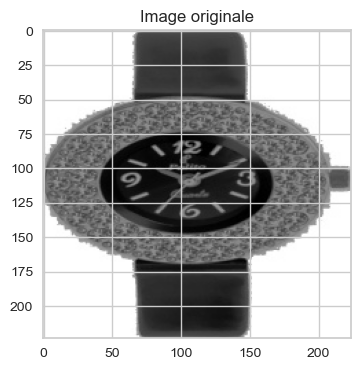

In [70]:
# Chargement de l'image précédemment traitée
montre = cv2.imread('Image_process2/009099b1f6e1e8f893ec29a7023153c4.jpg')
# Visualisation de l'image
plt.figure(figsize=(4, 4))
plt.title('Image originale')
plt.imshow(montre)
plt.show()

In [71]:
# Transformation del'image en matrice de pixels pour OpenCV
montre = np.array(montre)
# Instanciation de SIFT
sift = cv2.xfeatures2d.SIFT_create()
# Extraction des points d'intérêt et des descripteurs
sift_keypoints, sift_descripteurs = sift.detectAndCompute(montre, None)
nb_feat = sift_descripteurs.shape[0]
nb_desc = sift_descripteurs.shape[1]
print(f'SIFT Montre - Nombre de features = {nb_feat} pour {nb_desc} descripteurs')

SIFT Montre - Nombre de features = 482 pour 128 descripteurs


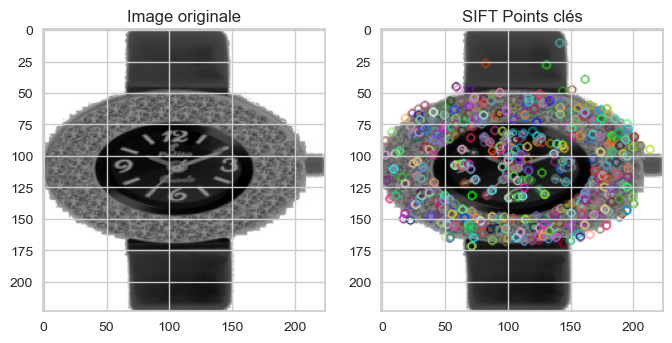

In [72]:
# Visualisation des points d'intérêt
sift_montre_keypoints = cv2.drawKeypoints(montre, sift_keypoints, None)

plt.figure(figsize=(8, 4))

# Image originale
plt.subplot(1, 2, 1)
plt.title('Image originale')
plt.imshow(montre)

# Image avec les points clés
plt.subplot(1, 2, 2)
plt.imshow(sift_montre_keypoints)
plt.title('SIFT Points clés')
plt.show()

In [73]:
#VisualWORDS
def afficher_visual_words(image, keypoints):
    '''
    Afficher les 16 premiers Visual Words d'une image.
    Parameters
    ----------
    image : image, obligatoire.
    keypoints : les visual words de l'image, obligatoire.
    Returns
    -------
    None.
    '''
    plt.figure(figsize=(10, 10))
    plt.title('SIFT Visual Words des 16 premiers descripteurs')
    for i, kp in enumerate(keypoints[0:16]):
        # Get the coordinates of the center and size
        plt.subplot(4, 4, i + 1)
        x_center = kp.pt[0]
        y_center = kp.pt[1]
        size = kp.size

        # Set the border limits
        left = np.ceil(x_center - size / 2)
        upper = np.ceil(y_center + size / 2)
        right = np.ceil(x_center + size / 2)
        lower = np.ceil(y_center - size / 2)

        # Crop the image and show the parts
        cropped_np = np.array(image)[
            int(lower):int(upper), int(left):int(right)]
        plt.imshow(cropped_np)
    plt.show()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\1384755872.py:17: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4, 4, i + 1)


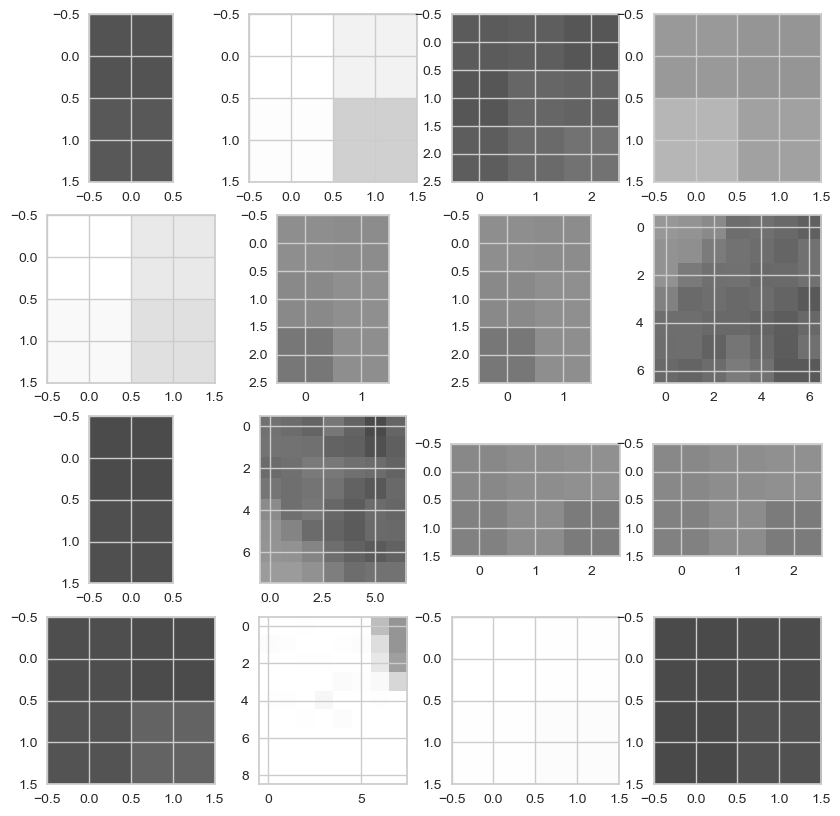

In [74]:
# Visualisation des 'Visual words'
afficher_visual_words(montre, sift_keypoints)

#### SIFT pour les 1050 images du jeu de données

[Source](https://medium.com/@aybukeyalcinerr/bag-of-visual-words-bovw-db9500331b2f)

ÉTAPE 0 - Chargement des images pré-traitées

In [75]:
def charger_image_repertoire(repertoire):
    # Chargement des images pré-traitées
    images = {}
    for filename in os.listdir(repertoire):
        path = repertoire + "/" + filename
        img = cv2.imread(path, 0)
        images[filename] = img
    return images

In [76]:
# Chargement des images pré-traitées dans le dictionnaire images
dico_images = charger_image_repertoire('Image_process2')
print(f'{len(dico_images)} images chargées')

1050 images chargées


#### Extraction des features -Visal Words

In [77]:
# PEP 8 Compliance :
# -- ALGORITHME SIFT
# --------------------------------------------------------------------

 # Creates descriptors using sift
# Takes one parameter that is images dictionary
# Return an array whose first index holds the decriptor_list without an order
# And the second index holds the sift_vectors dictionary which holds the
# descriptors but this is seperated class by class


def sift_extraire_features(images):
    '''
    Extraire les descripteurs et keypoints avec SIFT.
    Parameters
    ----------
    images : les images dont on veut extraire les descripteurs et centres
             d'intérêt, obligatoire.
    Returns
    -------
    list des descripteurs et des vecteurs SIFT.
    '''
    sift_vectors = {}
    descriptor_list = []
    sift = cv2.xfeatures2d.SIFT_create()
    for key, value in images.items():
        features = []
        kp, des = sift.detectAndCompute(value, None)
        descriptor_list.extend(des)
        # in case no descriptor
        des = [np.zeros((128,))] if des is None else des
        features.append(des)
        sift_vectors[key] = features
    return [descriptor_list, sift_vectors]

In [78]:
sifts = sift_extraire_features(dico_images)

In [79]:
# Liste des descripteurs = tous les 'visual words' de toutes les images
sift_list_descripteurs = sifts[0]
len(sift_list_descripteurs)

376306

In [80]:
# Liste des vecteurs par images (dictionnaires clé=nom_image, vecteur)
sift_all_bovw_features = sifts[1]
len(sift_all_bovw_features)

1050

In [ ]:
# # Sauvegarde des descripteurs SIFT
# with open('sauvegarde/sift_list_descripteurs.pickle', 'wb') as f:
#     pickle.dump(sift_list_descripteurs, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
# # Sauvegarde des vecteurs par images SIFT
# with open('sauvegarde/sift_all_bovw_features.pickle', 'wb') as f:
#     pickle.dump(sift_all_bovw_features, f, pickle.HIGHEST_PROTOCOL)

 Création du dictionnaire de visual words - BOVW - Bags of Visual Words

    * Pour créer le "dictionnaire" de visual words, il suffit d'appliquer un algorithme de clustering aux descripteurs de features construits à l'étape 1, comme le k-means.
    
    * Les visual words correspondent alors aux centres des clusters trouvés.

In [53]:
from sklearn.metrics import davies_bouldin_score, silhouette_score, \
    calinski_harabasz_score

In [97]:
# Initialisation du dataframe de sauvegarde des métriques kmeans
df_kmeans_metrics = pd.DataFrame({})

In [47]:
# PEP 8 Compliance
# -- CALCUL DES METRIQUES K-Means
# --------------------------------------------------------------------

def calcul_metrics_kmeans(data, dataframe_metrique, type_donnees,
                          random_seed, n_clusters, n_init, init):
    '''
    Calcul des métriques de KMeans en fonction de différents paramètres.
    Parameters
    ----------
    data : données, obligatoire.
    dataframe_metrique : dataframe de sauvegarde des résultats, obligatoire.
    type_donnees : string intitulé des données, obligatoire.
    random_seed : nombre aléatoire pour la reproductibilité, obligatoire.
    n_clusters : liste du nombre de clusters, obligatoire,
    n_init : nombre de clusters à initialiser, obligatoire.
    init : type d'initialisation : 'k-means++' ou 'random'.
    Returns
    -------
    dataframe_metrique : résultat des métriques
    '''
    # Cette fonction permet de calculer le nombre de clusters le plus
    # optimal pour notre analyse : le coefficient de silhouette,
    # dispersion, indice de davies_bouldin
    silhouette = []
    dispersion = []
    davies_bouldin = []
    donnees = []
    temps = []

    result_clusters = []
    result_ninit = []
    result_type_init = []

    # Hyperparametre tuning
    n_clusters = n_clusters
    nbr_init = n_init
    type_init = init

    # Tester le modèle entre 2 et 12 clusters
    for num_clusters in n_clusters:

        for init in nbr_init:

            for i in type_init:
                # Top début d'exécution
                time_start = time.time()

                # Initialisation de l'algorithme
                cls = KMeans(n_clusters=num_clusters,
                             n_init=init,
                             init=i,
                             random_state=random_seed)

                # Entraînement de l'algorithme
                cls.fit(data)

                # Prédictions
                preds = cls.predict(data)

                # Top fin d'exécution
                time_end = time.time()

                # Calcul du score de coefficient de silhouette
                silh = silhouette_score(data, preds)
                # Calcul la dispersion
                disp = cls.inertia_
                # Calcul de l'indice davies-bouldin
                db = davies_bouldin_score(data, preds)
                # Durée d'exécution
                time_execution = time_end - time_start

                silhouette.append(silh)
                dispersion.append(disp)
                davies_bouldin.append(db)
                donnees.append(type_donnees)
                temps.append(time_execution)

                result_clusters.append(num_clusters)
                result_ninit.append(init)
                result_type_init.append(i)

    dataframe_metrique = dataframe_metrique.append(pd.DataFrame({
        'Type_données': donnees,
        'nbr_clusters': result_clusters,
        'n_init': result_ninit,
        'type_init': result_type_init,
        'coef_silh': silhouette,
        'dispersion': dispersion,
        'davies_bouldin': davies_bouldin,
        'Durée (s)': temps
    }), ignore_index=True)

    return dataframe_metrique

In [45]:

# Pep 8 Compliance
# -- CALCUL DES METRIQUES K-Means - Recherche paramètre k
# --------------------------------------------------------------------

def calcul_metrics_kmeans(liste_visual_words, dataframe_metrique, type_algo,
                          random_seed, nb_cluster):
    '''
    Calcul des métriques de KMeans en fonction de différents paramètres.
    Parameters
    ----------
    liste_visual_words : données, obligatoire.
    dataframe_metrique : dataframe de sauvegarde des résultats, obligatoire.
    type_algo : string type d'algorithme SIFT, ORB..., obligatoire.
    random_seed : nombre aléatoire pour la reproductibilité, obligatoire.
    nb_cluster : liste du nombre de clusters à
    Returns
    -------
    dataframe_metrique : résultat des métriques
    '''
    # Cette fonction permet de calculer le nombre de clusters le plus
    # optimal pour notre analyse : la dispersion
    # silhouette = []
    dispersion = []
    # davies_bouldin = []
    donnees = []
    temps = []

    result_k = []

    # Hyperparametre tuning

    # Recherche des hyperparamètres
    for var_k in nb_cluster:

        # Top début d'exécution
        time_start = time.time()

        # Initialisation de l'algorithme
        cls = KMeans(n_clusters=var_k,
                     init='k-means++',
                     random_state=random_seed)

        # Entraînement de l'algorithme
        cls.fit(liste_visual_words)

        # Prédictions
        # preds = cls.predict(liste_visual_words)

        # Top fin d'exécution
        time_end = time.time()

        # Calcul du score de coefficient de silhouette
        # silh = silhouette_score(liste_visual_words, preds)
        # Calcul la dispersion
        disp = cls.inertia_
        # Calcul de l'indice davies-bouldin
        # db = davies_bouldin_score(liste_visual_words, preds)
        # Durée d'exécution
        time_execution = time_end - time_start
        display('Paramètre ' + str(var_k) + ' terminé')

        # silhouette.append(silh)
        dispersion.append(disp)
        # davies_bouldin.append(db)
        donnees.append(type_algo)
        temps.append(time_execution)

        result_k.append(var_k)

    dataframe_metrique = dataframe_metrique.append(pd.DataFrame({
        'Type_données': donnees,
        'Param_k': result_k,
        # 'coef_silh': silhouette,
        'dispersion': dispersion,
        # 'davies_bouldin': davies_bouldin,
        'Durée (s)': temps
    }), ignore_index=True)

    return dataframe_metrique

In [90]:
nb_clusters = [100, 300, 500, 1050]
df_kmeans_metrics = calcul_metrics_kmeans(sift_list_descripteurs,
                                        df_kmeans_metrics,
                                        'SIFT', seed, nb_clusters)

'Paramètre 100 terminé'

'Paramètre 300 terminé'

'Paramètre 500 terminé'

'Paramètre 1050 terminé'

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\4236060690.py:70: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe_metrique = dataframe_metrique.append(pd.DataFrame({


In [91]:
def to_csv(df, path):
    '''
    Export du dataframe transmis dans un fichier csv en conservant les types.
    Parameters
    ----------
    df : Dataframe à exporter en csv, obligatoire.
    path : nom du fichier avec ou sans répertoire, obligatoire.
    Returns
    -------
    None.
    '''
    # Prepend dtypes to the top of df
    df2 = df.copy()
    df2.loc[-1] = df2.dtypes
    df2.index = df2.index + 1
    df2.sort_index(inplace=True)
    # Then save it to a csv
    df2.to_csv(path, index=False)

In [92]:
# Sauvegarde des dataframes de trace
to_csv(df_kmeans_metrics, 'IMAGES_data_kmeans_metrics01.csv')

In [101]:
df_kmeans_metrics = pd.read_csv("IMAGES_data_kmeans_metrics.csv")

In [104]:
df_kmeans_metrics.head()

,Type_données,Param_k,dispersion,Durée (s)
0,object,int64,float64,float64
1,SIFT,100,30311497558.442577,363.0455002784729
2,SIFT,300,26744252936.146545,852.7774996757507
3,SIFT,500,25258697881.41357,1404.3329994678497
4,SIFT,1050,23269084764.82278,2427.1509997844696


In [107]:
df_kmeans_metrics01 = df_kmeans_metrics.iloc[1:].copy()
df_kmeans_metrics01.head()

,Type_données,Param_k,dispersion,Durée (s)
1,SIFT,100,30311497558.442577,363.0455002784729
2,SIFT,300,26744252936.146545,852.7774996757507
3,SIFT,500,25258697881.41357,1404.3329994678497
4,SIFT,1050,23269084764.82278,2427.1509997844696


In [115]:
df_kmeans_metrics01 = df_kmeans_metrics01.sort_values(['dispersion'], ascending=True)
df_kmeans_metrics01.head(10)

,Type_données,Param_k,dispersion,Durée (s)
4,SIFT,1050,23269084764.82278,2427.1509997844696
3,SIFT,500,25258697881.41357,1404.3329994678497
2,SIFT,300,26744252936.146545,852.7774996757507
1,SIFT,100,30311497558.442577,363.0455002784729


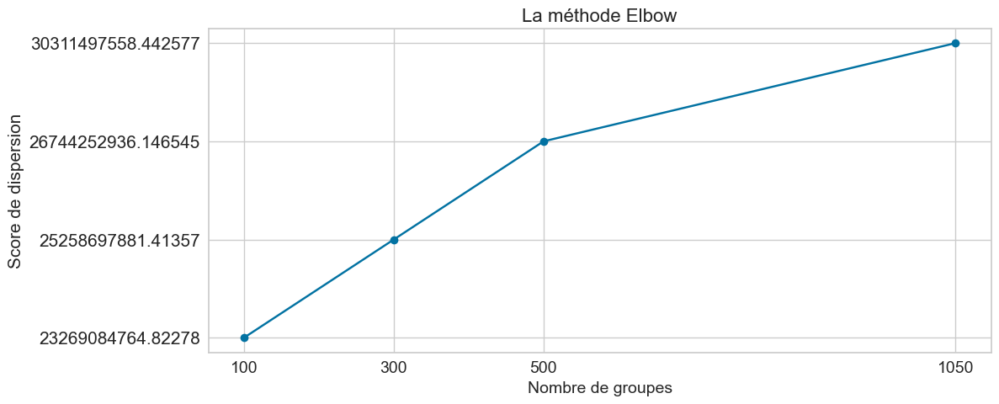

In [116]:
#Méthode Elbow: 
# Trace le graphique des dispersions, pour visualiser le coude
plt.figure(figsize=(12, 5))

plt.title('La méthode Elbow', fontsize=16)
plt.plot([i for i in nb_clusters],
         df_kmeans_metrics01['dispersion'].to_list(),
         marker='o')
plt.grid(True)
plt.xlabel('Nombre de groupes', fontsize=14)
plt.ylabel('Score de dispersion', fontsize=15)
plt.xticks([i for i in nb_clusters], fontsize=14)
plt.yticks(fontsize=15)

plt.show()

Bilan :
    Le nombre de clusters (paramètre k de l'agorithme KMeans) utilisé sera : 500.

In [132]:
# Constitution du dictionnaire de bag of words
sift_kmeans = KMeans(n_clusters=500, n_init=10)
sift_kmeans.fit(sift_list_descripteurs)
sift_visual_words = sift_kmeans.cluster_centers_

In [133]:
# Sauvegarde du modèle KMeans Sift
with open('sauvegarde/sift_kmeans.pickle', 'wb') as f:
    pickle.dump(sift_kmeans, f, pickle.HIGHEST_PROTOCOL)

In [134]:
# Sauvegarde des VW SIFT
with open('sauvegarde/sift_visual_words.pickle', 'wb') as f:
    pickle.dump(sift_visual_words, f, pickle.HIGHEST_PROTOCOL)

In [119]:
# PEP 8 Compliance
# -- CREATION DE L'HISTOGRAMME POUR CHAQUE IMAGE7
# --------------------------------------------------------------------

# Takes 2 parameters. The first one is a dictionary that holds the descriptors that are separated class by class
# And the second parameter is an array that holds the central points (visual words) of the k means clustering
# Returns a dictionary that holds the histograms for each images that are
# separated class by class.


def image_class(all_bovw, centers):
    dict_feature = {}
    for key, value in all_bovw.items():
        # display(key)
        category = []
        for img in value:
            # display(img)
            histogram = np.zeros(len(centers))
            for each_feature in img:
                ind = find_index(each_feature, centers)
                histogram[ind] += 1
            category.append(histogram)
        dict_feature[key] = category
    return dict_feature


# Find the index of the closest central point to the each sift descriptor.
# Takes 2 parameters the first one is a sift descriptor and the second one is the array of central points in k means
# Returns the index of the closest central point.
def find_index(image, center):
    count = 0
    ind = 0
    for i in range(len(center)):
        if(i == 0):
            count = distance.euclidean(image, center[i])
            #count = L1_dist(image, center[i])
        else:
            dist = distance.euclidean(image, center[i])
            #dist = L1_dist(image, center[i])
            if(dist < count):
                ind = i
                count = dist
    return ind

In [137]:
#import pickle
#with open('sauvegarde\df_sift_vectors.pickle','rb') as handle :
#    df_sift_bovw3 = pickle.load(handle)
#print(df_sift_bovw3)


In [138]:
sift_bovw = image_class(sift_all_bovw_features,
                                    sift_visual_words)

In [118]:
# PEP 8 Compliance
# -- Constituer le vecteur des features
# --------------------------------------------------------------------

def constituer_dataframe_vectors(dataframe, variable):
    '''
    Transformer les np.array des histogrammes en autant de colonnes pour
    être utilisable par TSNE et le clustering.
    Parameters
    ----------
    dataframe : dataframe des histogrammes des images.
    variable : nom de la variable contenant les histogrammes à extraire.
    Returns
    -------
    dataframe_vecteurs : le dataframe avec chacune des BOVW de chaque umage
    dans une colonne.
    '''
    vectors = np.column_stack(dataframe[variable].values.tolist())
    dataframe_vecteurs = pd.DataFrame(vectors).T

    return dataframe_vecteurs

In [139]:
# Sauvegarde des BOVW SIFT
with open('sauvegarde/sift_bovw.pickle', 'wb') as f:
    pickle.dump(sift_bovw, f, pickle.HIGHEST_PROTOCOL)

In [140]:
# Dataframe de sauvegarde des BOVW SIFT
df_sift_bovw = pd.DataFrame({'image': sift_bovw.keys(),
                             'sift_bovw': sift_bovw.values()})
# Ajout des BOVW en np.array d'une liste
df_sift_bovw['Histo'] = [row[0] for row in df_sift_bovw['sift_bovw']]
# Ajout de la catégorie
df_sift_bovw = df_sift_bovw.merge(data[['image', 'image_loc',
                                        'Categorie_1']], how='left',
                                  on='image')
# Constituer le dataframe de vecteurs de BOVW
df_sift_vectors = constituer_dataframe_vectors(df_sift_bovw, 'Histo')

In [141]:
# Sauvegarde du dataframe des vectors BOVW SIFT
with open('sauvegarde/df_sift_vectors.pickle', 'wb') as f:
    pickle.dump(df_sift_vectors, f, pickle.HIGHEST_PROTOCOL)

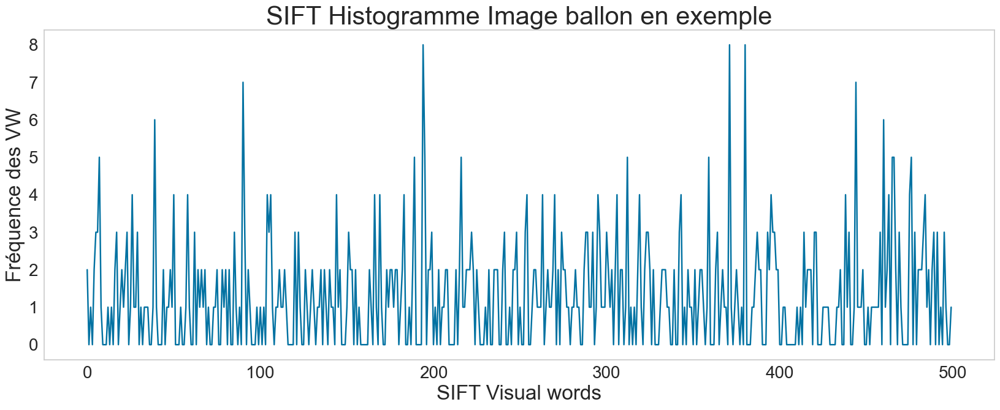

In [143]:
# Visualisation de l'histogramme pour notre image exemple
# Récupération de l'historgramme
df_visu = df_sift_bovw[df_sift_bovw['image'] ==
                       '3c4ca34c50a5437a1bcc42b72fc1351f.jpg']['sift_bovw']
histo_mug = df_visu.to_list()[0][0]
plt.figure(figsize=(20, 7))
plt.title('SIFT Histogramme Image ballon en exemple', fontsize=30)
plt.xlabel("SIFT Visual words", fontsize=24)
plt.ylabel("Fréquence des VW", fontsize=24)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(False)
plt.plot(histo_mug)
plt.show()

In [144]:
type_donnee = 'TSNE_SIFT'

In [145]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [20, 30, 40, 70,80,100]
results_sift = list()
tsne_results_sift = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_sift = \
        tsne.fit_transform(df_sift_vectors)
    results_sift.append(tsne_results_sift)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.004s...
[t-SNE] Computed neighbors for 1050 samples in 0.384s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 5.625446
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.564072
[t-SNE] KL divergence after 500 iterations: 2.142163
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.005s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.231s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 6.055415
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.827873
[t-SNE] KL divergence after 500 iterations: 1.979582
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.004s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.226s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 6.381442
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.569984
[t-SNE] KL divergence after 500 iterations: 1.793912
[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.003s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.217s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 7.111259
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.922897
[t-SNE] KL divergence after 500 iterations: 1.463453
[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.004s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.224s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 7.313447
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.106827
[t-SNE] KL divergence after 500 iterations: 1.354708
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.003s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.231s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 7.686148
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.187080
[t-SNE] KL divergence after 500 iterations: 1.260631
t-SNE terminée! en : 36.92399716377258 seconds


In [37]:
# -- SCATTERPLOT DE VISUALISATION DE TRANSFORMATION T-SNE en 2D
# --------------------------------------------------------------------
def affiche_tsne(results_list, liste_param, alpha=0.1):
    '''
    Affiche les résultats de la transformation Lt-SNE
    Parameters
    ----------
    results_list : iste des résultats de la transformation t-SNE, obligatoire.
    liste_param : liste des valeurs de l'hyper paramètre perplexity testées,
                  obligatoire.
    Returns
    -------
    None.
    '''
    i = 0

    # Visualisation en 2D des différents résultats selon la perplexité
    plt.subplots(3, 2, figsize=[15, 20])

    for resultat_tsne in results_list:

        # Perplexité=5
        plt.subplot(3, 2, i + 1)
        tsne_results_i = results_list[i]
        sns.scatterplot(x=tsne_results_i[:, 0], y=tsne_results_i[:, 1],
                        alpha=alpha)
        plt.title('t-SNE avec perplexité=' + str(liste_param[i]))
        plt.grid(False)
        plt.plot()

        i += 1

    plt.show()

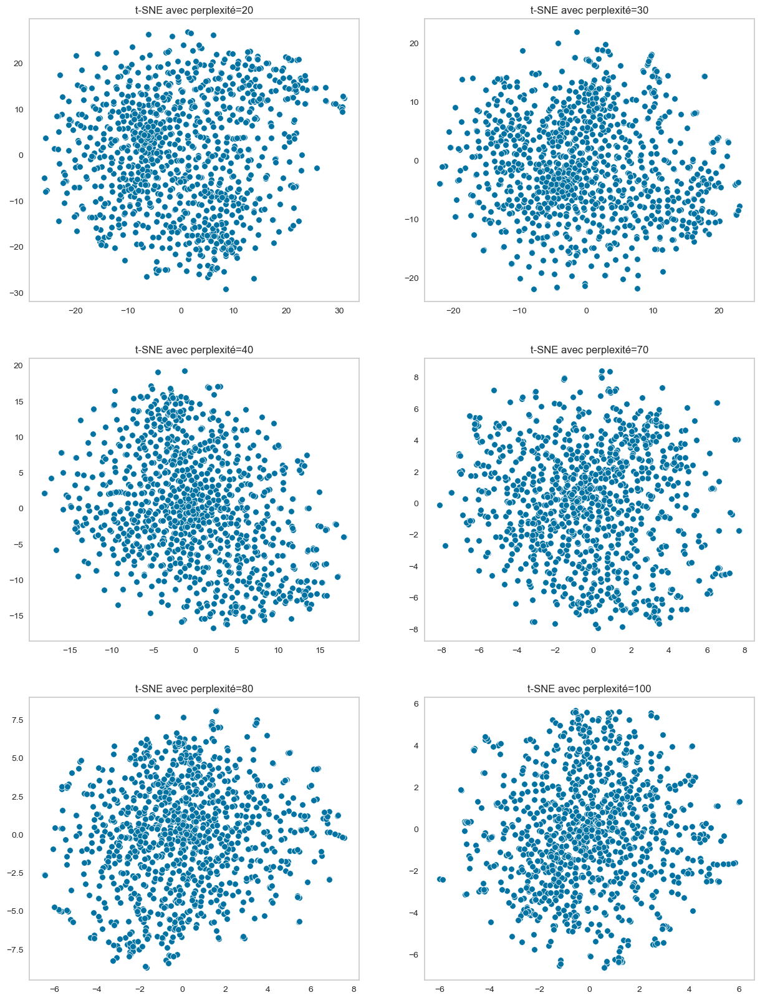

In [147]:
# Visualisation en 2D des différents résultats selon la perplexité
affiche_tsne(results_sift, liste_param, 1)


- groupes plus homogènes pour perplexité=70
- on laissera les paramètres learning_rate et n_iter par défaut (1000) et le nombre de composants par défaut (2).

In [148]:
# Réduction de dimension tsne
tsne_sift = TSNE(verbose=1, perplexity=70, n_iter=1000)
X_proj_tsne_sift = \
    tsne_sift.fit_transform(df_sift_vectors)
# Dataframe pour clustering
df_tsne_sift = pd.DataFrame({'VAR1' : X_proj_tsne_sift[:, 0],
                             'VAR2' : X_proj_tsne_sift[:, 1],
                             'CATEGORIE' : df_sift_bovw['Categorie_1'],
                             'IMAGE': df_sift_bovw['image'],
                             'IMAGE_LOC': df_sift_bovw['image_loc']})

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.002s...
[t-SNE] Computed neighbors for 1050 samples in 0.235s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 7.111259
[t-SNE] KL divergence after 250 iterations with early exaggeration: 79.652313
[t-SNE] KL divergence after 1000 iterations: 1.431622


In [149]:
#Clustering:
cols = ['VAR1', 'VAR2']

In [150]:
# Initialisation du dataframe de sauvegarde des scores
df_scores = pd.DataFrame({})

In [151]:
# Initialisation du dataframe de sauvegarde des précisions
df_precision = pd.DataFrame({})

In [152]:
# Initialisation du dataframe de sauvegarde des métriques de clustering
df_metrics_clust = pd.DataFrame({})

In [51]:
def calcul_metrics_kmeans(data, dataframe_metrique, type_donnees,
                          random_seed, ninit, maxiter):
    '''
    Calcul des métriques de KMeans en fonction de différents paramètres.
    Parameters
    ----------
    data : données, obligatoire.
    dataframe_metrique : dataframe de sauvegarde des résultats, obligatoire.
    type_donnees : string intitulé des données, obligatoire.
    random_seed : nombre aléatoire pour la reproductibilité, obligatoire.
    ninit : nombre de clusters à initialiser, obligatoire.
    maxiter : type d'initialisation : 'k-means++' ou 'random'.
    Returns
    -------
    dataframe_metrique : résultat des métriques
    '''
    # Cette fonction permet de calculer le nombre de clusters le plus
    # optimal pour notre analyse : le coefficient de silhouette,
    # dispersion, indice de davies_bouldin
    silhouette = []
    dispersion = []
    davies_bouldin = []
    donnees = []
    temps = []

    result_ninit = []
    result_maxiter = []

    # Hyperparametre tuning

    ninit = ninit
    maxiter = maxiter

    # Recherche des hyperparamètres
    for var_ninit in ninit:

        for var_maxiter in maxiter:

            # Top début d'exécution
            time_start = time.time()

            # Initialisation de l'algorithme
            cls = KMeans(n_clusters=7,
                         n_init=var_ninit,
                         init='k-means++',
                         max_iter=var_maxiter,
                         random_state=random_seed)

            # Entraînement de l'algorithme
            cls.fit(data)

            # Prédictions
            preds = cls.predict(data)

            # Top fin d'exécution
            time_end = time.time()

            # Calcul du score de coefficient de silhouette
            silh = silhouette_score(data, preds)
            # Calcul la dispersion
            disp = cls.inertia_
            # Calcul de l'indice davies-bouldin
            db = davies_bouldin_score(data, preds)
            # Durée d'exécution
            time_execution = time_end - time_start

            silhouette.append(silh)
            dispersion.append(disp)
            davies_bouldin.append(db)
            donnees.append(type_donnees)
            temps.append(time_execution)

            result_ninit.append(var_ninit)
            result_maxiter.append(var_maxiter)

    dataframe_metrique = dataframe_metrique.append(pd.DataFrame({
        'Type_données': donnees,
        'n_init': result_ninit,
        'max_iter': result_maxiter,
        'coef_silh': silhouette,
        'dispersion': dispersion,
        'davies_bouldin': davies_bouldin,
        'Durée (s)': temps
    }), ignore_index=True)

    return dataframe_metrique

In [154]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 70,80]
max_iter = [100, 200, 300,400]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_clust = calcul_metrics_kmeans(df_tsne_sift[cols],
                                     df_metrics_clust,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_clust[df_metrics_clust['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:13

Type_données,n_init,max_iter,coef_silh,dispersion,davies_bouldin,Durée (s)
TSNE_SIFT,70,100,0.357846,4814.847168,0.897042,11.015000
TSNE_SIFT,70,200,0.357846,4814.847656,0.897042,11.205001
TSNE_SIFT,70,300,0.357846,4814.847656,0.897042,11.411004
TSNE_SIFT,70,400,0.357846,4814.847168,0.897042,11.476999
TSNE_SIFT,80,300,0.357846,4814.847656,0.897042,12.738498
TSNE_SIFT,80,100,0.357846,4814.847656,0.897042,12.794003
TSNE_SIFT,80,400,0.357846,4814.847656,0.897042,12.818503
TSNE_SIFT,80,200,0.357846,4814.847656,0.897042,12.967995
TSNE_SIFT,10,200,0.357622,4815.853027,0.895554,1.929496
TSNE_SIFT,10,100,0.357622,4815.853027,0.895554,1.978002


In [155]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_sift = KMeans(n_clusters=7, init='k-means++',
                          n_init=70, max_iter=100,
                          random_state=seed) \
    .fit(df_tsne_sift[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_sift['Clusters'] = kmeans_tsne_sift.labels_
kmeans_tsne_sift_labels = kmeans_tsne_sift.labels_

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


In [59]:
from sklearn.metrics import davies_bouldin_score, silhouette_score, adjusted_rand_score, homogeneity_score, completeness_score, v_measure_score

In [58]:
def calcul_metriques_clusters(dataframe, dataframe_sauv_res, type_donnee):
    '''
    Calcul de la métrique ARI, .
    Parameters
    ----------
    dataframe : dataframe, obligatoire.
    dataframe_sauv_res : dataframe de sauvegarde du résultat, obligatoire.
    type_donnee : titre pour dataframe de sauvegarde, obligatoire.
    Returns
    -------
    dataframe_sauv_res.
    '''
    valeur_reel = dataframe['CATEGORIE']
    valeur_pred = dataframe['Clusters']
    score_ari = adjusted_rand_score(valeur_reel, valeur_pred)
    score_homogeneite = homogeneity_score(valeur_reel, valeur_pred)
    score_completude = completeness_score(valeur_reel, valeur_pred)
    score_vmeasure = v_measure_score(valeur_reel, valeur_pred)

    dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
        'Type_données': [type_donnee],
        'ARI': [score_ari],
        'Homogénéité': [score_homogeneite],
        'Complétude': [score_completude],
        'V-measure': [score_vmeasure]}), ignore_index=True)

    return dataframe_sauv_res

In [158]:
# Scores:
df_scores = calcul_metriques_clusters(df_tsne_sift,
                                                 df_scores,
                                                 type_donnee)
df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\2664902827.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\56412357.py:5: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()


Type_données,ARI,Homogénéité,Complétude,V-measure
TSNE_SIFT,0.035773,0.069395,0.070754,0.070068


In [159]:
# Sauvegarde des dataframes de trace
to_csv(df_scores, 'IMAGES_data_df_scores.csv')

In [62]:
# PEP 8 Compliance
# -- Affiche la répartition du nombre de clients par clusters
# --------------------------------------------------------------------


def affiche_repartition_par_clusters(clusters_labels):
    '''
    Affiche la répartition par cluster
    Parameters
    ----------
    clusters_labels : la séries des labels des clusters, obligatoire.
    Returns
    -------
    None.
    '''
    ax1 = plt.gca()

    # DataFrame de travail
    series_client_cluster = pd.Series(clusters_labels).value_counts()
    nb_client = series_client_cluster.sum()
    df_visu_client_cluster = pd.DataFrame(
        {'Clusters': series_client_cluster.index,
         'Nombre': series_client_cluster.values})
    df_visu_client_cluster['%'] = round(
        (df_visu_client_cluster['Nombre']) * 100 / nb_client, 2)
    df_visu_client_cluster = df_visu_client_cluster.sort_values(by='Clusters')
    display(df_visu_client_cluster.style.hide_index())

    # Barplot de la distribution
    sns.set_style('white')
    sns.barplot(x='Clusters', y='Nombre',
                data=df_visu_client_cluster, color='SteelBlue', ax=ax1)
    ax1.set_ylabel('Nombre)', fontsize=12)
    ax1.set_xlabel('Clusters', fontsize=12)
    ax1.set_title('Répartition par clusters', fontsize=14)
    plt.gcf().set_size_inches(6, 4)
    plt.grid(False)
    plt.show()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\3630838621.py:27: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  display(df_visu_client_cluster.style.hide_index())


Clusters,Nombre,%
0,250,23.810000
1,161,15.330000
2,109,10.380000
3,126,12.000000
4,144,13.710000
5,130,12.380000
6,130,12.380000


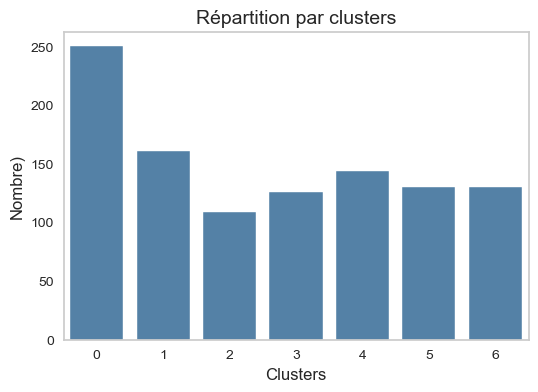

In [161]:
affiche_repartition_par_clusters(kmeans_tsne_sift_labels)

In [162]:
# Les catégories par clusters
df_tsne_sift.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Beauty and Personal Care           55
         Watches                            51
         Kitchen & Dining                   42
         Computers                          34
         Home Decor & Festive Needs         33
         Baby Care                          22
         Home Furnishing                    13
1        Computers                          37
         Baby Care                          33
         Home Furnishing                    24
         Kitchen & Dining                   24
         Home Decor & Festive Needs         19
         Watches                            16
         Beauty and Personal Care            8
2        Home Decor & Festive Needs         32
         Home Furnishing                    21
         Baby Care                          20
         Beauty and Personal Care           14
         Kitchen & Dining                   10
         Watches                             9
         Computers                           3
3        Beauty and Personal Care           31
         Home Furnishing                    31
         Baby Care                          26
         Computers                          12
         Watches                            11
         Home Decor & Festive Needs          9
         Kitchen & Dining                    6
4        Computers                          37
         Watches                            32
         Kitchen & Dining                   30
         Home Decor & Festive Needs         22
         Baby Care                          11
         Beauty and Personal Care           10
         Home Furnishing                     2
5        Home Furnishing                    45
         Baby Care                          27
         Home Decor & Festive Needs         23
         Beauty and Personal Care           13
         Kitchen & Dining                   10
         Watches                             9
         Computers                           3
6        Kitchen & Dining                   28
         Computers                          24
         Watches                            22
         Beauty and Personal Care           19
         Home Furnishing                    14
         Home Decor & Festive Needs         12
         Baby Care                          11

In [165]:
# PEP 8 Compliance
# -- SCATTERPLOT DE VISUALISATION DE TRANSFORMATION Isomap en 2D
# --------------------------------------------------------------------
def affiche_isomap(X_projected_isomap, titre='Isomap', alpha=1):
    '''
    Affiche le résultat en 2D de la transformation Isomap
    Parameters
    ----------
    X_projected_isomap : résultats de la transformation isomap, obligatoire.
    titre : titre de la figure, optionnel (défaut = Isomap).
    alpha : alpha, optionnel (défaut = 1).
    Returns
    -------
    None.
    '''

    # Visualisation en 2D de la transformation Isomap
    plt.figure(figsize=[6, 6])

    sns.scatterplot(x=X_projected_isomap[:, 0], y=X_projected_isomap[:, 1],
                    alpha=alpha)
    plt.title(titre)
    plt.grid(False)
    plt.show()

# --------------------------------------------------------------------
# -- SCATTERPLOT DE VISUALISATION DE TRANSFORMATION UMAP en 2D
# --------------------------------------------------------------------


def affiche_umap(X_projected_umap, titre='UMAP', alpha=1):
    '''
    Affiche le résultat en 2D de la transformation UMAP
    Parameters
    ----------
    X_projected_umap : résultats de la transformation umap, obligatoire.
    titre : titre de la figure, optionnel (défaut = Isomap).
    alpha : alpha, optionnel (défaut = 1).
    Returns
    -------
    None.
    '''

    # Visualisation en 2D de la transformation Isomap
    plt.figure(figsize=[6, 6])

    sns.scatterplot(x=X_projected_umap[:, 0], y=X_projected_umap[:, 1],
                    alpha=alpha)
    plt.title(titre)
    plt.grid(False)
    plt.show()

# --------------------------------------------------------------------
# -- SCATTERPLOT DE VISUALISATION DE TRANSFORMATION UMAP en 2D
# --------------------------------------------------------------------


def affiche_umap_cat(X_projected_umap, titre='UMAP', alpha=1):
    '''
    Affiche le résultat en 2D de la transformation UMAP en associant les
    variables quantitatives et les variables qualitatives
    Parameters
    ----------
    X_projected_umap : résultats de la transformation umap, obligatoire.
    titre : titre de la figure, optionnel (défaut = Isomap).
    alpha : alpha, optionnel (défaut = 1).
    Returns
    -------
    None.
    '''
    # Visualisation en 2D de la transformation Isomap
    plt.figure(figsize=[20, 15])

    sns.scatterplot(x=X_projected_umap[:, 0], y=X_projected_umap[:, 1],
                    s=20, alpha=alpha)
    plt.title(titre, fontsize=16)
    plt.grid(False)
    plt.show()

In [66]:
# PEP 8 Compliance
# -- Affiche une visualisation 2D des clients par clusters par t-SNE
# --------------------------------------------------------------------


def affiche_projection_par_clusters(X_projected, clusters_labels, titre):
    '''
    Affiche la projection scatterplot par clusters.
    Parameters
    ----------
    proj_tsne : projection, obligatoire.
    clusters_labels : la variable représentant les clusters.
    Returns
    -------
    None.
    '''
    plt.figure(figsize=[25, 15])

    sns.scatterplot(data=X_projected,x=X_projected[:,0],y=X_projected[:, 1], 
                    hue=clusters_labels, s=100, alpha=1, palette='Set1')

    plt.title(titre, fontsize=40)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=34)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    plt.grid(False)
    plt.show()

In [191]:
X_proj_tsne_sift.shape

(1050, 2)

In [193]:
X_proj_tsne_sift[:, 0]

array([-6.062311  ,  0.86227065, -4.0655866 , ...,  0.71381825,
       -7.3940406 ,  4.6782503 ], dtype=float32)

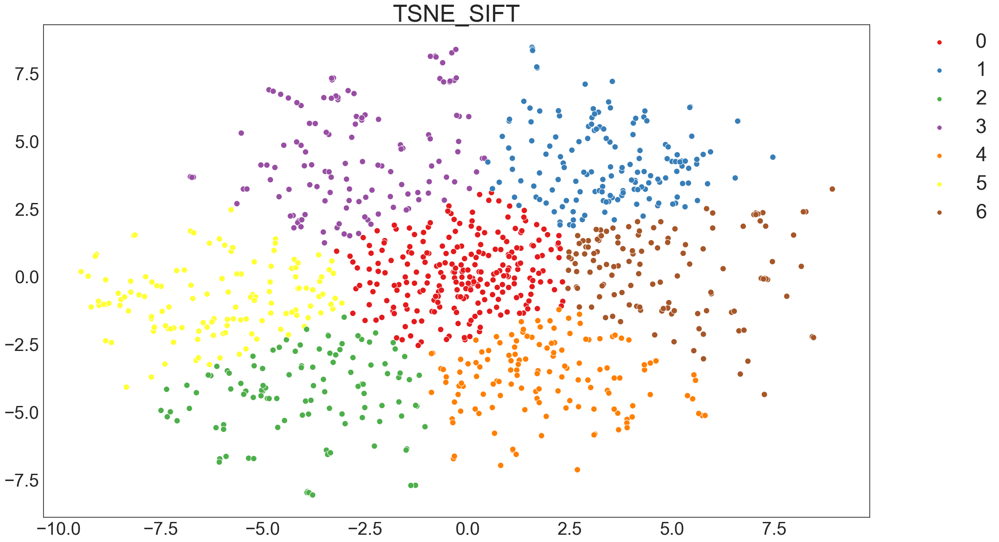

In [195]:
# Visualisation des clusters
affiche_projection_par_clusters(X_proj_tsne_sift,
                                kmeans_tsne_sift_labels,
                                type_donnee)

Bilan :

- Le score ARI est faible (0.035).
- Cette combinaison TSNE SIFT sur les images ne parvient pas à retrouver les 7 catégories selon les souhaite notre client


In [73]:
from sklearn.metrics import confusion_matrix, classification_report,accuracy_score
from IPython.display import display, Markdown

In [71]:
# PEP 8 Compliance
# -- TRADUCTION DES NOMS DES GROUPES/SOUS-GROUPE EN FRANCAIS
# --------------------------------------------------------------------


def traduire_valeurs_variable(dataframe, colonne_a_traduire, dictionnaire):
    """
    Traduire les valeurs de la colonne du dataframe transmis par la valeur du dictionnaire
    ----------
    @param IN : dataframe : DataFrame, obligatoire
                colonne_a_traduire : colonne dont on veut traduire les valeurs obligatoire
                dictionnaire :dictionnaire clé=à remplacer,
                              valeur = le texte de remplacement oblgatoire
    @param OUT :None
    """
    for cle, valeur in dictionnaire.items():
        dataframe[colonne_a_traduire] = dataframe[colonne_a_traduire].replace(
            cle, valeur)


def traduire_valeurs_variables(
        dataframe,
        liste_colonnes_a_traduire,
        dictionnaire):
    """
    Traduire les valeurs de la colonne du dataframe transmis par la valeur du dictionnaire
    ----------
    @param IN : dataframe : DataFrame, obligatoire
                colonne_a_traduire : colonne dont on veut traduire les valeurs obligatoire
                dictionnaire :dictionnaire clé=à remplacer,
                              valeur = le texte de remplacement oblgatoire
    @param OUT :None
    """
    for col in liste_colonnes_a_traduire:
        for cle, valeur in dictionnaire.items():
            dataframe[col] = dataframe[col].replace(
                cle, valeur)

In [69]:
# PEP 8 Compliance
# -- KMeans - Affiche HEATMAP DE LA MATRICE DE CONFUSION
# --------------------------------------------------------------------

def affiche_qualite_categorisation(dataframe, dico_traduction, titre):
    '''
    Afiche heatmap de la qualité de la catégorisation et donne l'accuracy.
    Parameters
    ----------
    dataframe : dataframe, obligatoire.
    dico_traduction : traduction des catégories de nombre à texte, obligatoire.
    titre : type de données traitées.
    Returns
    -------
    None.
    '''
    dataframe['Cluster_labels'] = dataframe['Clusters'].copy().astype('str')
    traduire_valeurs_variable(dataframe, 'Cluster_labels',
                                          dico_traduction)

    cat_pred = dataframe['CATEGORIE']
    cat_reel = dataframe['Cluster_labels']

    plt.figure(figsize=(6, 4))
    sns.heatmap(confusion_matrix(cat_reel, cat_pred),
                annot=True,
                fmt='d',
                cbar=False,
                cmap='Blues',
                yticklabels=sorted(cat_pred.unique()))
    plt.title(titre)
    plt.show()

    display(
        'Précision: {}%'.format(
            round(
                accuracy_score(
                    cat_pred,
                    cat_reel) *
                100,
                2)))
    display(Markdown(classification_report(cat_reel, cat_pred)))

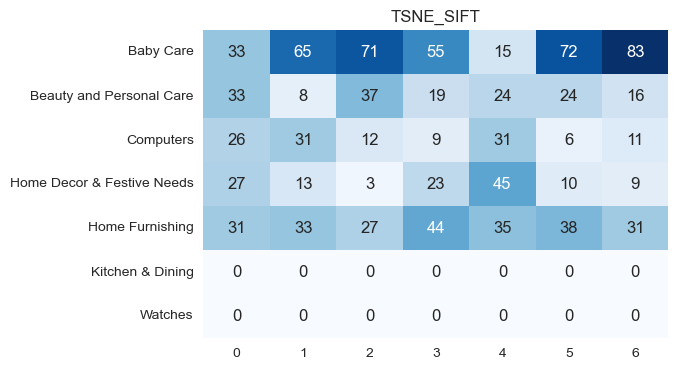

'Précision: 10.57%'

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                            precision    recall  f1-score   support

                 Baby Care       0.22      0.08      0.12       394
  Beauty and Personal Care       0.05      0.05      0.05       161
                 Computers       0.08      0.10      0.09       126
Home Decor & Festive Needs       0.15      0.18      0.16       130
           Home Furnishing       0.23      0.15      0.18       239
          Kitchen & Dining       0.00      0.00      0.00         0
                   Watches       0.00      0.00      0.00         0

                  accuracy                           0.11      1050
                 macro avg       0.11      0.08      0.09      1050
              weighted avg       0.17      0.11      0.13      1050


In [171]:
dico_categories = {'0': 'Baby Care',
                   '1': 'Beauty and Personal Care',
                   '2': 'Home Furnishing',
                   '3': 'Computers',
                   '4': 'Baby Care',
                   '5': 'Home Decor & Festive Needs',
                   '6': 'Home Furnishing'}
affiche_qualite_categorisation(df_tsne_sift,
                                dico_categories, type_donnee)

In [172]:
# PEP 8 Compliance
# -- Sauvegarde de la précision de la catégorisation dans un fichier excel
# --------------------------------------------------------------------


def sauvegarde_precision(dataframe, precision, titre):
    '''
    Sauvegarde de la précision de la catégorisation dans un fichier excel.
    Parameters
    ----------
    dataframe : dataframe, obligatoire.
    precision : précision de la catégorisation.
    titre : type de données traitées
    Returns
    -------
    dataframe : dataframe de sauvegarde.
    '''
    dataframe = dataframe.append(pd.DataFrame({
        'Type_données': [titre],
        'Précision': [precision]
    }), ignore_index=True)

    return dataframe

In [173]:
# Sauvegarde des précisions de la catégorisation
df_precision = sauvegarde_precision(df_precision, '24.57',
                                               type_donnee)
# Sauvegarde des dataframes de trace
to_csv(df_precision, 'IMAGES_data_df_precision.csv')

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\1831571401.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe = dataframe.append(pd.DataFrame({


In [174]:
# Sauvegarde du dataframe des TSNE SIFT
with open('sauvegarde/df_tsne_sift.pickle', 'wb') as f:
    pickle.dump(df_tsne_sift, f, pickle.HIGHEST_PROTOCOL)

In [175]:
# Nombre d'erreur
mask = df_tsne_sift['CATEGORIE'] == df_tsne_sift['Cluster_labels']
df_erreur_sift = df_tsne_sift[~mask]
display(f'Nombre d\'erreurs : {df_erreur_sift.shape[0]}')

"Nombre d'erreurs : 939"

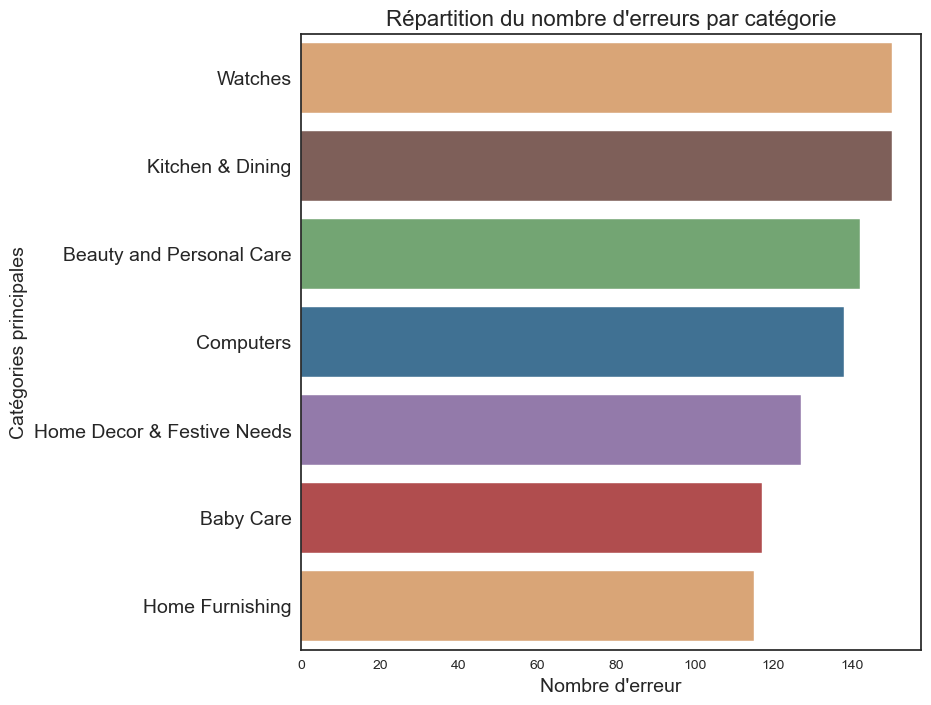

In [176]:
# Répartition des erreurs par catégorie
plt.figure(figsize=(8, 8))
sns.countplot(y='CATEGORIE', data=df_erreur_sift, orient='h',
              order=df_erreur_sift['CATEGORIE'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

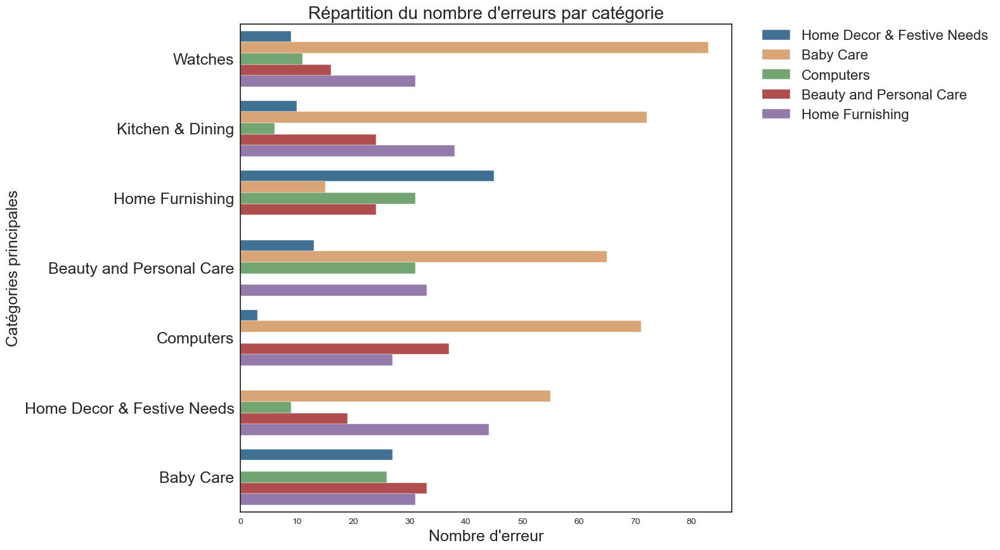

In [177]:
# Répartition des erreurs par catégorie
plt.figure(figsize=(10, 10))
sns.countplot(y='CATEGORIE', hue='Cluster_labels',
              data=df_erreur_sift, orient='h',
              palette=['#3274a1', '#e9a467', '#6bad6b', '#c03d3e',
                       '#9372b2', '#845b53', '#d684bd'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=20)
plt.xlabel('Nombre d\'erreur', fontsize=18)
plt.ylabel('Catégories principales', fontsize=18)
plt.yticks(fontsize=18)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=16)
plt.show()

In [231]:
def path_to_image_photo_html(path):
    return '<img src="' + path + ' " width="100">'

In [232]:
df_visu_erreur = df_erreur_sift[['CATEGORIE', 'IMAGE_LOC',
                                 'Cluster_labels']].head(10)
display(HTML(df_visu_erreur.
             to_html(escape=False,
                     formatters=dict(IMAGE_LOC=path_to_image_photo_html))))

,CATEGORIE,IMAGE_LOC,Cluster_labels
0,Watches,,Home Decor & Festive Needs
1,Kitchen & Dining,,Baby Care
2,Home Furnishing,,Computers
3,Beauty and Personal Care,,Baby Care
4,Computers,,Beauty and Personal Care
5,Computers,,Home Furnishing
6,Computers,,Baby Care
7,Kitchen & Dining,,Beauty and Personal Care
8,Beauty and Personal Care,,Home Decor & Festive Needs
9,Kitchen & Dining,,Baby Care


Modèle ORB :

ORB (Oriented FAST and Rotated BRIEF) a été développé dans les laboratoires d'OpenCV par Ethan Rublee, Vincent Rabaud, Kurt Konolige et Gary R. Bradski en 2011, comme une alternative efficace et viable à SIFT et SURF.

ORB a été conçu principalement parce que SIFT et SURF sont des algorithmes brevetés. ORB, cependant, est libre d'utilisation.

ORB est aussi performant que SIFT pour la détection des caractéristiques (et est meilleur que SURF) tout en étant presque deux ordres de grandeur plus rapide.

ORB s'appuie sur le célèbre détecteur de points clés FAST et le descripteur BRIEF. Ces deux techniques sont intéressantes en raison de leurs bonnes performances et de leur faible coût.
    L
Les principales contributions d'ORB sont les suivantes :
    
    L'ajout d'une composante d'orientation rapide et précise à FAST.
    Le calcul efficace des caractéristiques BRIEF orientées
    L'analyse de la variance et de la corrélation des caractéristiques BRIEF orientées
    Une méthode d'apprentissage pour la décorrélation des caractéristiques BRIEF sous invariance rotationnelle, conduisant à de meilleures performances dans les applications de type "nearest-neighbor".

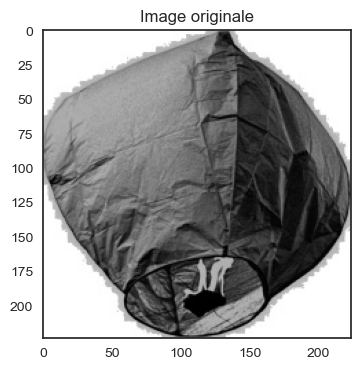

In [179]:
# Chargement de l'image précédemment traitée
ballon = cv2.imread('Image_process2/0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg')
# Visualisation de l'image
plt.figure(figsize=(4, 4))
plt.title('Image originale')
plt.imshow(mug)
plt.show()

In [180]:
# Transformation del'image en matrice de pixels pour OpenCV
mug = np.array(ballon)
# Instanciation de ORB
orb = cv2.ORB_create()
# Extraction des points d'intérêt et des descripteurs
orb_keypoints, orb_descripteurs = orb.detectAndCompute(ballon, None)
nb_feat = orb_descripteurs.shape[0]
nb_desc = orb_descripteurs.shape[1]
print(f'ORB Mug - Nombre de features={nb_feat} pour {nb_desc} descripteurs')

ORB Mug - Nombre de features=350 pour 32 descripteurs


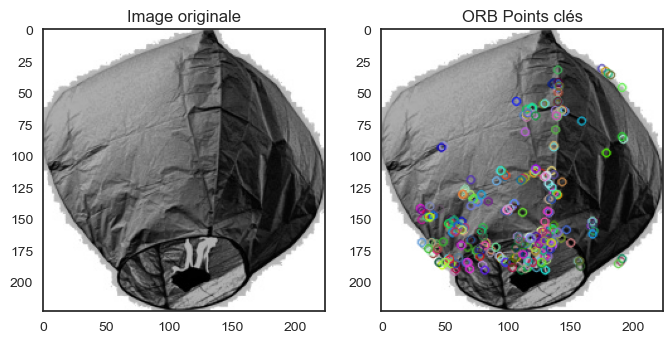

In [181]:
# Visualisation des points d'intérêt
orb_mug_keypoints = cv2.drawKeypoints(mug, orb_keypoints, None)

plt.figure(figsize=(8, 4))

# Image originale
plt.subplot(1, 2, 1)
plt.title('Image originale')
plt.imshow(mug)

# Image avec les points clés
plt.subplot(1, 2, 2)
plt.imshow(orb_mug_keypoints)
plt.title('ORB Points clés')
plt.show()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\1384755872.py:17: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(4, 4, i + 1)


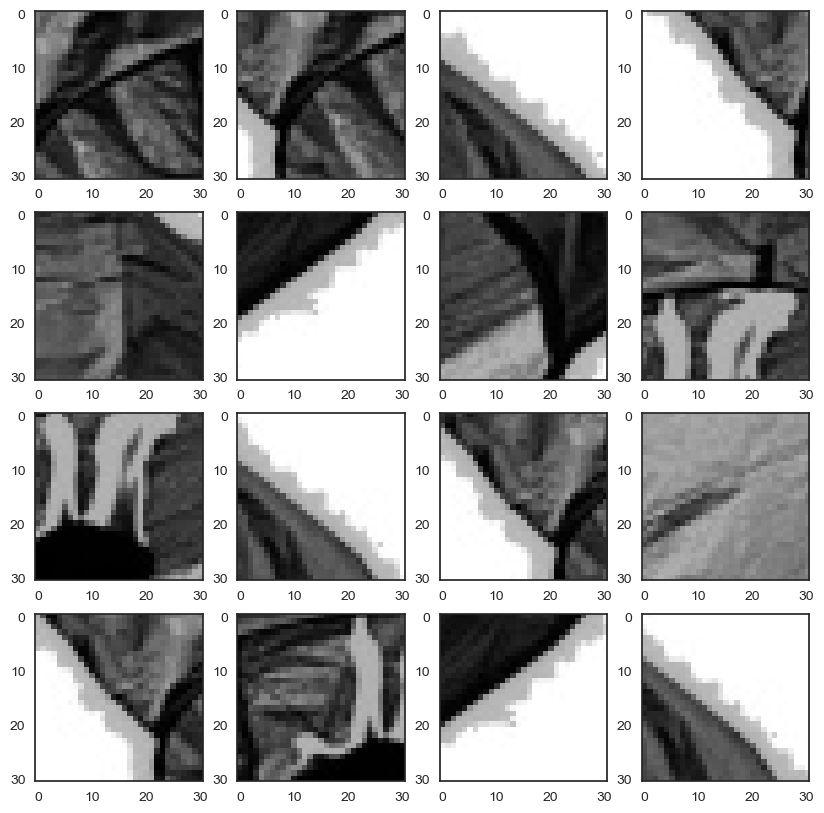

In [182]:
# Visualisation des 'Visual words'
afficher_visual_words(mug, orb_keypoints)

ORB pour les 1050 images du jeu de données

ÉTAPE 0 - Chargement des images pré-traitées & 1 - Extraction des features - Visual Words

In [183]:
# PEP 8 Compliance
# -- ORB - Chargement des images et extraction des features
# --------------------------------------------------------------------


def orb_charger_img_extraire_vw(rep_images):
    '''
    ORB Charger les images et extraire les features visual words.
    Parameters
    ----------
    rep_images : répertoire de localisation des images dont on veut extraire
                 les features (obligatoire)
    Returns
    -------
    descriptors : liste des descripteurs.
    lien_img_des : lien entre image et descripteur.
    '''
    # Liste des descripteurs
    descriptor_list = []

    # Detecteur de feature ORB
    orb = cv2.ORB_create(nfeatures=1500)

    # Répertoire des images
    images = rep_images

    # Conserver le lien entre l'image et le descripteur
    lien_img_des = []

    # Pour toutes les images
    for i in range(len(images)):
        im = images[i]
        img = cv2.imread(im, cv2.IMREAD_GRAYSCALE)
        kp, des = orb.detectAndCompute(img, None)

        descriptor_list.append(des)

        # Lien image - descripteur
        for j in range(len(des)):
            lien_img_des.append(i)

        descriptors = np.array(descriptor_list[0])
        for descriptor in descriptor_list[1:]:
            descriptors = np.vstack((descriptors, descriptor))

    descriptors = np.float32(descriptors)

    return descriptors, lien_img_des

In [184]:
# Chargement des images et extraction des features
orb_list_descripteurs, orb_lien_img_des = orb_charger_img_extraire_vw(data['image_proces2'])

In [185]:
orb_list_descripteurs.shape

(735579, 32)

In [186]:
len(orb_lien_img_des)

735579

In [187]:
# Sauvegarde des descripteurs ORB
with open('sauvegarde/orb_list_descripteurs.pickle', 'wb') as f:
    pickle.dump(orb_list_descripteurs, f, pickle.HIGHEST_PROTOCOL)

In [188]:
# Sauvegarde des descripteurs ORB
with open('sauvegarde/orb_lien_img_des.pickle', 'wb') as f:
    pickle.dump(orb_lien_img_des, f, pickle.HIGHEST_PROTOCOL)

ÉTAPE 2 - Création du dictionnaire de visual words - BOVW - Bags of Visual Words

    Pour créer le "dictionnaire" de visual words, il suffit d'appliquer un algorithme de clustering aux descripteurs de features construits à l'étape 1, comme le k-means.
    Les visual words correspondent alors aux centres des clusters trouvés.
    
    On utilisera la fonction Kmeans() intégrée à OpenCV :
    Paramètres d'entrée
        samples : Il doit être de type de données np.float32, et chaque caractéristique doit être mise dans une seule colonne.
        nclusters(K) : Nombre de clusters requis à la fin du processus.
        criteria : C'est le critère de fin d'itération. Lorsque ce critère est satisfait, l'itération de l'algorithme s'arrête. En fait, il devrait être un tuple de 3 paramètres. Ils sont ( type, max_iter, epsilon ) :
    Le type du critère de terminaison. Il a 3 drapeaux comme ci-dessous : cv.TERM_CRITERIA_EPS - arrête l'itération de l'algorithme si la précision spécifiée, epsilon, est atteinte. cv.TERM_CRITERIA_MAX_ITER - arrête l'algorithme après le nombre d'itérations spécifié, max_iter. cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER - arrête l'itération lorsque l'une des conditions ci-dessus est remplie.
        max_iter - Un nombre entier spécifiant le nombre maximum d'itérations.
        epsilon - Précision requise
        attempts : Flag permettant de spécifier le nombre de fois où l'algorithme est exécuté en utilisant différentes étiquetages initiaux. L'algorithme renvoie les étiquettes qui donnent la meilleure compacité. Cette compacité est renvoyée en sortie.
        flags : Ce drapeau est utilisé pour spécifier comment les centres initiaux sont pris. Normalement, deux drapeaux sont utilisés pour cela : cv.KMEANS_PP_CENTERS et cv.KMEANS_RANDOM_CENTERS.

[Source](https://docs.opencv.org/master/d1/d5c/tutorial_py_kmeans_opencv.html)

In [196]:
# Test du KMeans mis à disposition
# -------------------------------------------------------------------
# Define criteria = ( type, max_iter = 10 , epsilon = 1.0 )
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)

# Set flags (Just to avoid line break in the code)
flags = cv2.KMEANS_PP_CENTERS  # kmeans++

# Apply KMeans
compactness, orb_labels, centers = cv2.kmeans(orb_list_descripteurs, 1000,
                                              None, criteria, 1, flags)

ÉTAPE 3 - Construction de l'histogramme pour chaque image

- Pour chaque image, on crée un histogramme qui indique la fréquence d'apparition de chaque visual word dans l'image.

- Le bag-of-features d'une image est le vecteur dans lequel on a stocké les valeurs de l'histogramme et qu'on a normalisé (en divisant par la norme euclidienne).

In [197]:
# PEP 8 Compliance
# -- ORB - Extraction des BOVW
# --------------------------------------------------------------------


def orb_constituter_bovw(dataframe, rep_images, dest_var_bovw, orb_labels,
                         orb_lien_img_des):
    '''
    ORB Charger les images et extraire les features visual words.
    Parameters
    ----------
    dataframe : dataframe de travail, obligatoire.
    rep_images : répertoire de localisation des images dont on veut extraire
                 les features (obligatoire)
    dest_var_bovw : variable des sotckages des BOVW,obligatoire.
    orb_labels : labels.
    orb_lien_img_des : Lien de destination des images.
    Returns
    -------
    None.
    '''
    # Constitution des histogrammes à partir des labels KMeans
    size = orb_labels.shape[0] * orb_labels.shape[1]
    data_images = []
    images = dataframe[rep_images]
    for i in range(len(images)):
        # create a numpy to hold the histogram for each image
        data_images.insert(i, np.zeros((1000, 1)))

    # Sauvegarde des BOVW de chaque image
    dataframe[dest_var_bovw] = ""
    for i in range(size):
        label = orb_labels[i]
        # Get this descriptors image id
        image_id = orb_lien_img_des[i]
        # data_images is a list of the same size as the number of images
        images_data = data_images[image_id]
        # data is a numpy array of size (dictionary_size, 1) filled with zeros
        images_data[label] += 1
        dataframe[dest_var_bovw][image_id] = images_data.flatten()

In [198]:
# Extraction des BOVW ORB
orb_constituter_bovw(data, 'image_proces2', 'orb_bovw',
                                   orb_labels, orb_lien_img_des)

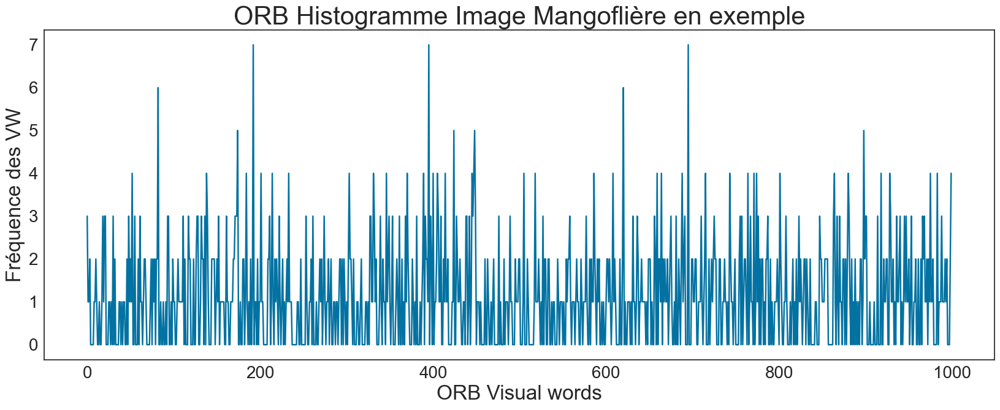

In [199]:
# Visualisation de l'histogramme pour notre image exemple
# Récupération de l'historgramme
df_visu_orb = data[data['image'] ==
                   '3c4ca34c50a5437a1bcc42b72fc1351f.jpg']['orb_bovw']
histo_mug = df_visu_orb.to_list()[0]
plt.figure(figsize=(20, 7))
plt.title('ORB Histogramme Image Mangoflière en exemple', fontsize=30)
plt.xlabel('ORB Visual words', fontsize=24)
plt.ylabel('Fréquence des VW', fontsize=24)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(False)
plt.plot(histo_mug)
plt.show()

In [200]:
# Dataframe de sauvegarde des BOVW ORB
df_orb_bovw = data[['image', 'image_loc', 'Categorie_1', 'orb_bovw']]
# Constituer le dataframe de vecteurs de BOVW
df_orb_vectors = constituer_dataframe_vectors(df_orb_bovw, 'orb_bovw')

In [201]:
# Sauvegarde des BOVW ORB
with open('sauvegarde/df_orb_bovw.pickle', 'wb') as f:
    pickle.dump(df_orb_bovw, f, pickle.HIGHEST_PROTOCOL)

In [202]:
# Sauvegarde du dataframe des vectors BOVW ORB
with open('sauvegarde/df_orb_vectors.pickle', 'wb') as f:
    pickle.dump(df_orb_vectors, f, pickle.HIGHEST_PROTOCOL)

In [203]:
#Réduction de dimension:
type_donnee = 'TSNE_ORB'

In [204]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [20, 30, 40, 50, 70, 80]
results_orb = list()
tsne_results_orb = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_orb = \
        tsne.fit_transform(df_orb_vectors)
    results_orb.append(tsne_results_orb)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.009s...
[t-SNE] Computed neighbors for 1050 samples in 0.227s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 6.952282
[t-SNE] KL divergence after 250 iterations with early exaggeration: 110.098686
[t-SNE] KL divergence after 500 iterations: 2.352138
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.011s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.213s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 7.540230
[t-SNE] KL divergence after 250 iterations with early exaggeration: 109.024529
[t-SNE] KL divergence after 500 iterations: 2.196186
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.019s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.226s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 8.001381
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.967575
[t-SNE] KL divergence after 500 iterations: 1.932177
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.010s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.439s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 8.394914
[t-SNE] KL divergence after 250 iterations with early exaggeration: 99.350784
[t-SNE] KL divergence after 500 iterations: 1.768259
[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.009s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.257s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 9.071141
[t-SNE] KL divergence after 250 iterations with early exaggeration: 94.196983
[t-SNE] KL divergence after 500 iterations: 1.497627
[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.008s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.245s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 9.374775
[t-SNE] KL divergence after 250 iterations with early exaggeration: 89.163994
[t-SNE] KL divergence after 500 iterations: 1.400003
t-SNE terminée! en : 33.431994676589966 seconds


In [1]:
 # Visualisation en 2D des différents résultats selon la perplexité
 affiche_tsne(results_orb, liste_param, 1)

In [206]:
# Réduction de dimension tsne
tsne_orb = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_orb = \
    tsne_orb.fit_transform(df_orb_vectors)
# Dataframe pour clustering
df_tsne_orb = pd.DataFrame({'VAR1' : X_proj_tsne_orb[:, 0],
                            'VAR2' : X_proj_tsne_orb[:, 1],
                            'CATEGORIE' : df_orb_bovw['Categorie_1'],
                            'IMAGE': df_orb_bovw['image'],
                            'IMAGE_LOC': df_orb_bovw['image_loc']})

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.007s...
[t-SNE] Computed neighbors for 1050 samples in 0.233s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 8.394914
[t-SNE] KL divergence after 250 iterations with early exaggeration: 99.158463
[t-SNE] KL divergence after 2550 iterations: 1.726871


In [207]:
cols = ['VAR1', 'VAR2']

In [208]:
# Chargement des dataframes de sauvegarde des scores
df_scores = pd.read_csv('IMAGES_data_df_scores.csv')
# Suppression de l'entête des objets
df_scores.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\323381422.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_scores.drop(0, 0, inplace=True)


In [209]:
# Chargement des dataframes de sauvegarde des précisions
df_precision = pd.read_csv('IMAGES_data_df_precision.csv')
# Suppression de l'entête des objets
df_precision.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\3977956081.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_precision.drop(0, 0, inplace=True)


In [210]:
# Chargement des dataframes de sauvegarde des métriques de clustering
df_metrics_clust = pd.read_csv('IMAGES_data_kmeans_metrics.csv')
# Suppression de l'entête des objets
df_metrics_clust.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\2528542146.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_metrics_clust.drop(0, 0, inplace=True)


In [211]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_clust = calcul_metrics_kmeans(df_tsne_orb[cols],
                                     df_metrics_clust,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_clust[df_metrics_clust['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:13

Type_données,Param_k,dispersion,Durée (s),n_init,max_iter,coef_silh,davies_bouldin
TSNE_ORB,nan,3597.228760,3.458505,20.000000,300.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,3.521497,20.000000,400.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,3.571000,20.000000,200.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,3.579996,20.000000,500.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,3.619000,20.000000,100.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,5.031500,30.000000,400.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,5.047502,30.000000,100.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,5.093502,30.000000,300.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,5.125000,30.000000,200.000000,0.373715,0.831880
TSNE_ORB,nan,3597.228760,5.199499,30.000000,500.000000,0.373715,0.831880


In [212]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_orb = KMeans(n_clusters=7, init='k-means++',
                         n_init=20, max_iter=300,
                         random_state=seed) \
    .fit(df_tsne_orb[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_orb['Clusters'] = kmeans_tsne_orb.labels_
kmeans_tsne_orb_labels = kmeans_tsne_orb.labels_

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


In [213]:
# Scores :
df_scores = calcul_metriques_clusters(df_tsne_orb,
                                                 df_scores,
                                                 type_donnee)
df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\2664902827.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\3057098868.py:5: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()


Type_données,ARI,Homogénéité,Complétude,V-measure
TSNE_ORB,0.036913,0.059951,0.061255,0.060596


In [214]:
# Sauvegarde des dataframes de trace
to_csv(df_scores, 'IMAGES_data_df_scores.csv')

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\3630838621.py:27: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  display(df_visu_client_cluster.style.hide_index())


Clusters,Nombre,%
0,134,12.760000
1,154,14.670000
2,177,16.860000
3,238,22.670000
4,94,8.950000
5,109,10.380000
6,144,13.710000


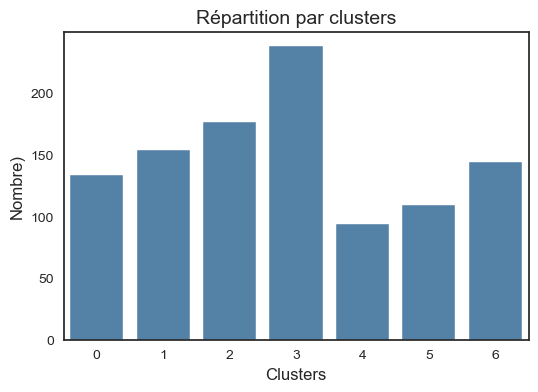

In [215]:
affiche_repartition_par_clusters(kmeans_tsne_orb_labels)

In [216]:
# Les catégories par clusters
df_tsne_orb.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Home Furnishing                    32
         Home Decor & Festive Needs         23
         Watches                            21
         Beauty and Personal Care           18
         Kitchen & Dining                   16
         Baby Care                          12
         Computers                          12
1        Computers                          58
         Home Decor & Festive Needs         29
         Baby Care                          18
         Beauty and Personal Care           18
         Kitchen & Dining                   15
         Watches                            12
         Home Furnishing                     4
2        Baby Care                          39
         Home Decor & Festive Needs         33
         Home Furnishing                    31
         Watches                            22
         Kitchen & Dining                   21
         Beauty and Personal Care           19
         Computers                          12
3        Kitchen & Dining                   60
         Watches                            52
         Beauty and Personal Care           34
         Baby Care                          31
         Computers                          30
         Home Furnishing                    19
         Home Decor & Festive Needs         12
4        Beauty and Personal Care           22
         Home Decor & Festive Needs         19
         Watches                            15
         Computers                          11
         Home Furnishing                    10
         Baby Care                           9
         Kitchen & Dining                    8
5        Computers                          24
         Beauty and Personal Care           21
         Kitchen & Dining                   19
         Watches                            14
         Home Decor & Festive Needs         12
         Home Furnishing                    11
         Baby Care                           8
6        Home Furnishing                    43
         Baby Care                          33
         Home Decor & Festive Needs         22
         Beauty and Personal Care           18
         Watches                            14
         Kitchen & Dining                   11
         Computers                           3

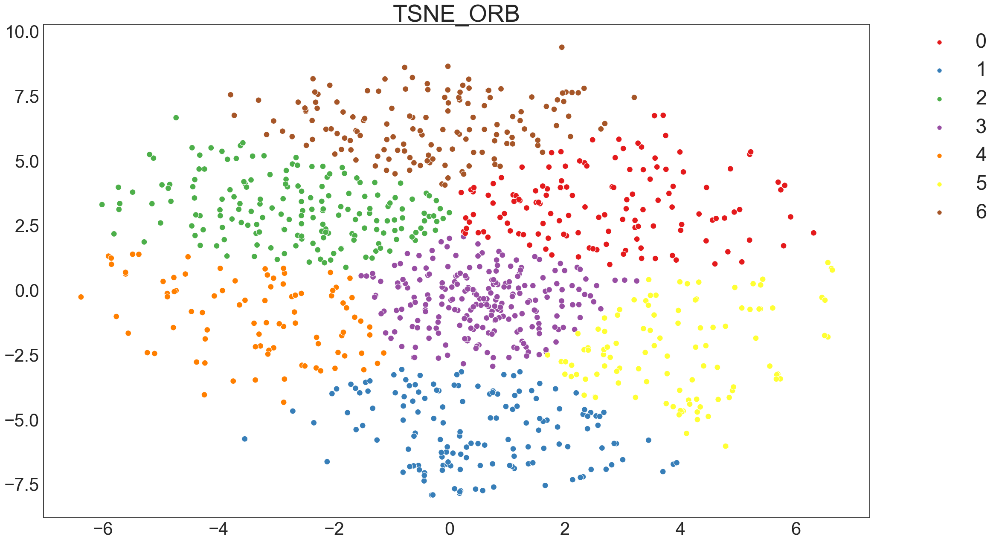

In [217]:
# Visualisation des clusters
affiche_projection_par_clusters(X_proj_tsne_orb,
                                           kmeans_tsne_orb_labels,
                                           type_donnee)

Bilan :

    Le score ARI est faible (0.029).
    Cette combinaison TSNE ORB sur les images ne parvient pas à retrouver les 7 catégories comme le souhaite notre client
    Il manque la catégorie 'Home Decor & Festive Needs'.

Qualité de la catégorisation ?

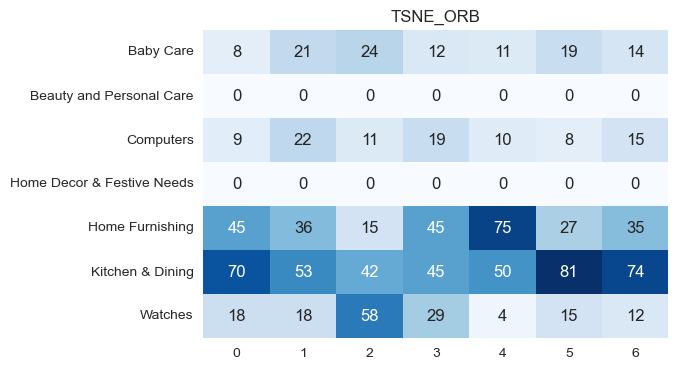

'Précision: 17.81%'

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                            precision    recall  f1-score   support

                 Baby Care       0.05      0.07      0.06       109
  Beauty and Personal Care       0.00      0.00      0.00         0
                 Computers       0.07      0.12      0.09        94
Home Decor & Festive Needs       0.00      0.00      0.00         0
           Home Furnishing       0.50      0.27      0.35       278
          Kitchen & Dining       0.54      0.20      0.29       415
                   Watches       0.08      0.08      0.08       154

                  accuracy                           0.18      1050
                 macro avg       0.18      0.10      0.12      1050
              weighted avg       0.37      0.18      0.23      1050


In [218]:
dico_categories = {'0': 'Home Furnishing',
                   '1': 'Watches',
                   '2': 'Kitchen & Dining',
                   '3': 'Kitchen & Dining',
                   '4': 'Computers',
                   '5': 'Baby Care',
                   '6': 'Home Furnishing'}
affiche_qualite_categorisation(df_tsne_orb,
                                          dico_categories, type_donnee)

In [219]:
# Sauvegarde des précisions de la catégorisation
df_precision = sauvegarde_precision(df_precision, '25',
                                               type_donnee)
# Sauvegarde des dataframes de trace
to_csv(df_precision, 'IMAGES_data_df_precision.csv')

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\1831571401.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe = dataframe.append(pd.DataFrame({


In [220]:
# Nombre d'erreur
mask = df_tsne_orb['CATEGORIE'] == df_tsne_orb['Cluster_labels']
df_erreur_orb = df_tsne_orb[~mask]
display(f'Nombre d\'erreurs : {df_erreur_orb.shape[0]}')

"Nombre d'erreurs : 863"

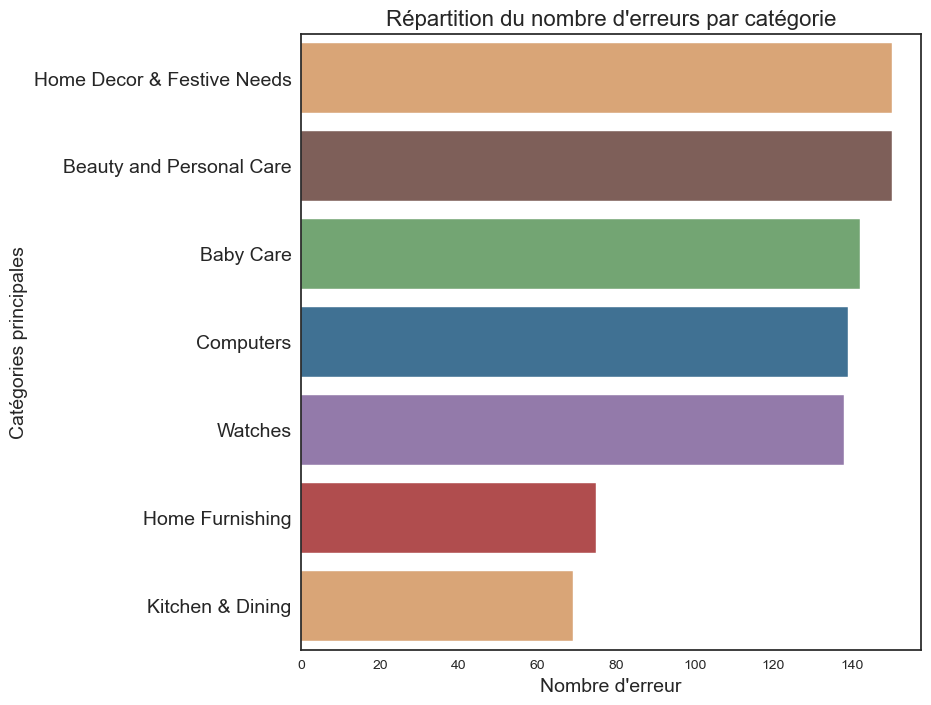

In [221]:
# Répartition des erreurs par catégorie
plt.figure(figsize=(8, 8))
sns.countplot(y='CATEGORIE', data=df_erreur_orb, orient='h',
              order=df_erreur_orb['CATEGORIE'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

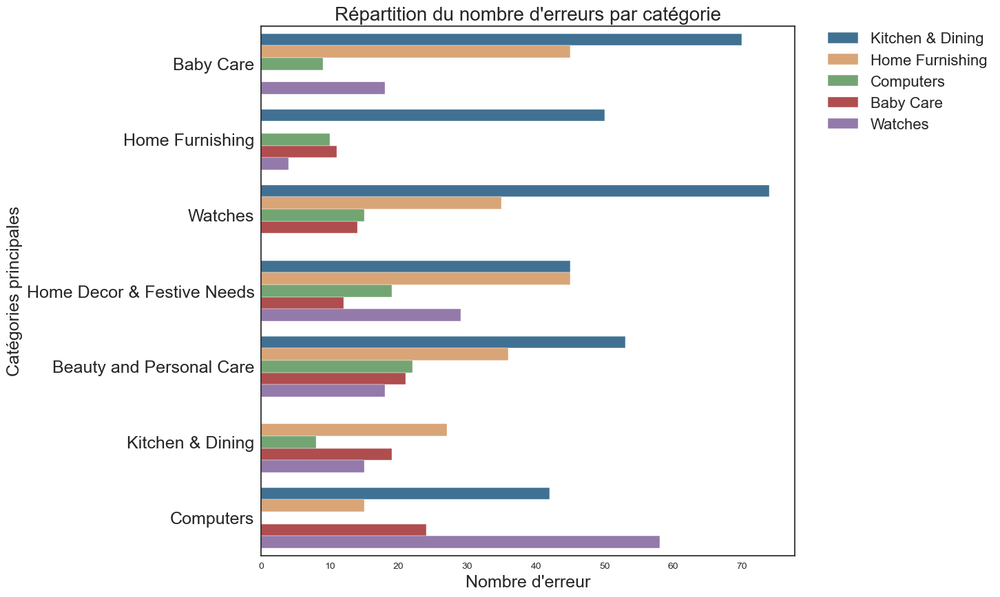

In [222]:
# Répartition des erreurs des catégories par catégorie
plt.figure(figsize=(10, 10))
sns.countplot(y='CATEGORIE', hue='Cluster_labels',
              data=df_erreur_orb, orient='h',
              palette=['#3274a1', '#e9a467', '#6bad6b', '#c03d3e',
                       '#9372b2', '#845b53', '#d684bd'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=20)
plt.xlabel('Nombre d\'erreur', fontsize=18)
plt.ylabel('Catégories principales', fontsize=18)
plt.yticks(fontsize=18)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=16)
plt.show()

In [229]:
def path_to_image_photo_html(path):
    return '<img src="' + path + ' " width="100">'

In [227]:
from IPython.core.display import display, HTML

C:\Users\Shadow\AppData\Local\Temp\ipykernel_17440\2058709175.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [230]:
df_visu_erreur_orb = df_erreur_orb[['CATEGORIE', 'IMAGE_LOC',
                                    'Cluster_labels']].sample(10)
display(HTML(
    df_visu_erreur_orb.
    to_html(escape=False,
            formatters=dict(IMAGE_LOC=path_to_image_photo_html))))

,CATEGORIE,IMAGE_LOC,Cluster_labels
685,Beauty and Personal Care,,Home Furnishing
293,Baby Care,,Kitchen & Dining
96,Home Decor & Festive Needs,,Kitchen & Dining
178,Kitchen & Dining,,Home Furnishing
687,Beauty and Personal Care,,Computers
555,Watches,,Kitchen & Dining
457,Home Furnishing,,Kitchen & Dining
496,Watches,,Home Furnishing
18,Watches,,Home Furnishing
384,Beauty and Personal Care,,Home Furnishing


### CNN - Convolution Neural Network

- Les réseaux de neurones convolutifs ont une méthodologie similaire à celle des méthodes traditionnelles d'apprentissage supervisé : ils reçoivent des images en entrée, détectent les features de chacune d'entre elles, puis entraînent un classifieur dessus.
- Les CNN réalisent eux-mêmes tout le boulot fastidieux d'extraction et description de features : lors de la phase d'entraînement, l'erreur de classification est minimisée afin d'optimiser les paramètres du classifieur ET les features.
[Source openclassrooms]


- Pour les application Keras : [Source](https://keras.io/api/applications/)

- VGG-16 est une version du réseau de neurones convolutif VGG-Net.
- VGG-16 est constitué de plusieurs couches, dont 13 couches de convolution et 3 fully-connected. Il doit donc apprendre les poids de 16 couches.
- Il prend en entrée une image en couleurs de taille 224  × 224 px et la classifie dans une des 1000 classes. Il renvoie donc un vecteur de taille 1000, qui contient les probabilités d'appartenance à chacune des classes. 



**Utilisation de VGG16 pré-entraîné sur ImageNet**

- Utilisation du modèle VGG16 pré-entraîné sur ImageNet (ImageNet est un projet de recherche visant à développer une grande base de données d'images avec des annotations, c'est-à-dire des images et leurs descriptions).

[Source](https://machinelearningmastery.com/use-pre-trained-vgg-model-classify-objects-photographs/)


**ÉTAPE 1 - Chargement des images, extraction des features**

In [27]:
data.head()

,image,image_loc,image_redim,Categorie_1
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Images_redim/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Images_redim/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Images_redim/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Images_redim/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


In [28]:
# Utilisation de VGG16 pré-entraîné sur ImageNet avec les images d'origine
# VGG16 imports
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
import keras.utils as image

# Liste
vgg16_all_features = []

# Instanciation du modèle
model_vgg16 = VGG16(weights='imagenet', include_top=False)
# Résumé de l'architecture du modèle
model_vgg16.summary()

for rep_image in data['image_loc']:

    # Charger l'image et la redimensionner à la taille
    # requise de 224×224 pixels.
    img = image.load_img(rep_image, target_size=(224, 224))
    # Convertir les pixels en un tableau NumPy afin de pouvoir travailler
    # avec dans Keras
    img = image.img_to_array(img)
    # Redimensionnement
    img = np.expand_dims(img, axis=0)
    # Préparer de nouvelles entrées pour le réseau.
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance
    # de l'image à chacun des 1000 types d'objets connus.
    vgg16_feature = model_vgg16.predict(img)
    # Ajouter la feature prédite en nparray à la liste
    vgg16_all_features.append(np.array(vgg16_feature).flatten())

vgg16_all_features = np.array(vgg16_all_features)

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\PIL\Image.py:3074: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 [==============================] - 0s 190ms/step


In [29]:
import pandas as pd

file_name = "sauvegarde\df_vgg16_vectors.pickle"
df_vgg16_vectors = pd.read_pickle(file_name)

In [30]:
# Dataframe de sauvegarde des BOVW VGG16
# Association des features à chaque image
data['vgg16_bovw'] = [vgg16_all_features[i] for i in range(data.shape[0])]
# Dataframe de travail
df_vgg16_bovw = data[['image', 'image_loc', 'Categorie_1', 'vgg16_bovw']]
# Constituer le dataframe de vecteurs de BOVW VGG16
df_vgg16_vectors = pd.DataFrame.from_records(vgg16_all_features)

In [ ]:
# Sauvegarde du dataframe des vectors BOVW VGG16
with open('sauvegarde/df_vgg16_vectors.pickle', 'wb') as f:
    pickle.dump(df_vgg16_vectors, f, pickle.HIGHEST_PROTOCOL)

**ÉTAPE 2 - Réduction de dimension**

In [31]:
type_donnee = 'TSNE_VGG16'

In [32]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [20, 30, 40, 50, 70, 80]
results_vgg16 = list()
tsne_results_vgg16 = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_vgg16 = \
        tsne.fit_transform(df_vgg16_vectors)
    results_vgg16.append(tsne_results_vgg16)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.596s...
[t-SNE] Computed neighbors for 1050 samples in 1.370s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 451.088598
[t-SNE] KL divergence after 250 iterations with early exaggeration: 121.158859
[t-SNE] KL divergence after 500 iterations: 2.120459


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.730s...
[t-SNE] Computed neighbors for 1050 samples in 1.269s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 481.505964
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.992531
[t-SNE] KL divergence after 500 iterations: 1.843863


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.682s...
[t-SNE] Computed neighbors for 1050 samples in 1.325s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 504.606735
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.630295
[t-SNE] KL divergence after 500 iterations: 1.721101


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.651s...
[t-SNE] Computed neighbors for 1050 samples in 1.214s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 523.635057
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.189827
[t-SNE] KL divergence after 500 iterations: 1.686481


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.598s...
[t-SNE] Computed neighbors for 1050 samples in 1.218s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 554.813667
[t-SNE] KL divergence after 250 iterations with early exaggeration: 106.285568
[t-SNE] KL divergence after 500 iterations: 1.494428


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.605s...
[t-SNE] Computed neighbors for 1050 samples in 1.200s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 568.342305
[t-SNE] KL divergence after 250 iterations with early exaggeration: 102.326424
[t-SNE] KL divergence after 500 iterations: 1.362635
t-SNE terminée! en : 43.53349709510803 seconds


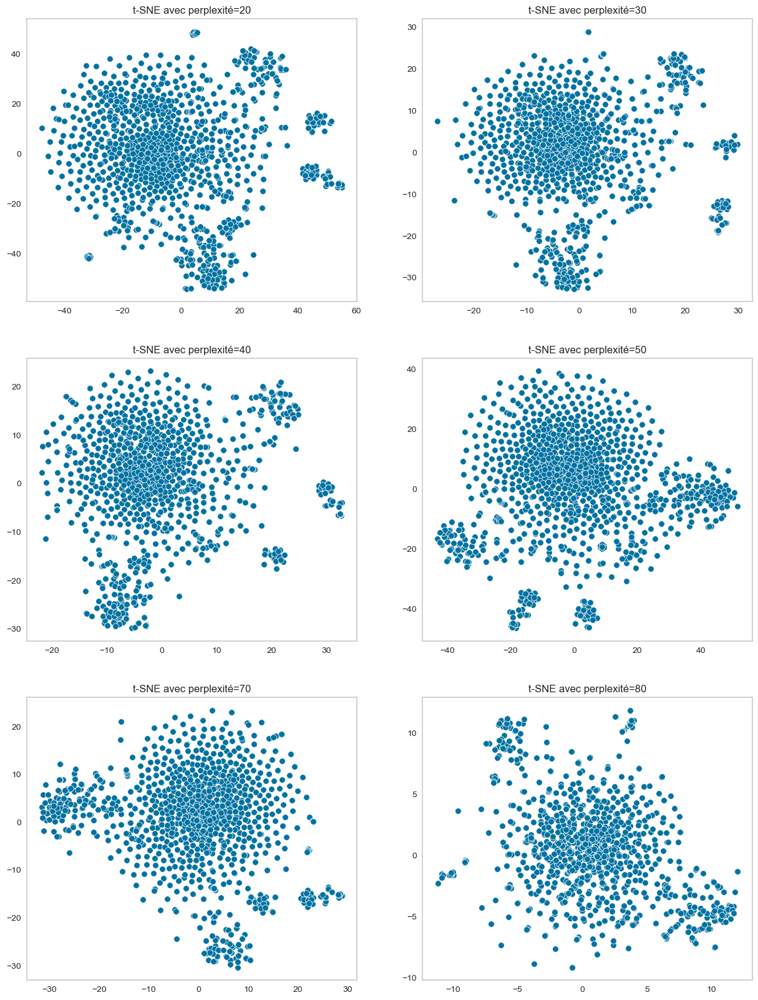

In [36]:
# Visualisation en 2D des différents résultats selon la perplexité
affiche_tsne(results_vgg16, liste_param, 1)

- groupes plus homogènes pour perplexité=80
- on laissera les paramètres learning_rate et n_iter à 5000 et le nombre de composants par défaut (2).

In [37]:
# Réduction de dimension tsne
tsne_vgg16 = TSNE(verbose=1, perplexity=40, n_iter=5000)
X_proj_tsne_vgg16 = \
    tsne_vgg16.fit_transform(df_vgg16_vectors)
# Dataframe pour clustering
df_tsne_vgg16 = pd.DataFrame({'VAR1' : X_proj_tsne_vgg16[:, 0],
                              'VAR2' : X_proj_tsne_vgg16[:, 1],
                              'CATEGORIE' : df_vgg16_bovw['Categorie_1'],
                              'IMAGE': df_vgg16_bovw['image'],
                              'IMAGE_LOC': df_vgg16_bovw['image_loc']})

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.596s...
[t-SNE] Computed neighbors for 1050 samples in 1.541s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 504.606735
[t-SNE] KL divergence after 250 iterations with early exaggeration: 112.768776
[t-SNE] KL divergence after 3400 iterations: 1.694965


**Clustering**

In [38]:
cols = ['VAR1', 'VAR2']

In [39]:
# Chargement des dataframes de sauvegarde des scores
df_scores = pd.read_csv('IMAGES_data_df_scores.csv')
# Suppression de l'entête des objets
df_scores.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\323381422.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_scores.drop(0, 0, inplace=True)


In [40]:
# Chargement des dataframes de sauvegarde des précisions
df_precision = pd.read_csv('IMAGES_data_df_precision.csv')
# Suppression de l'entête des objets
df_precision.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\3977956081.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_precision.drop(0, 0, inplace=True)


In [41]:
# Chargement des dataframes de sauvegarde des métriques de clustering
df_metrics_clust = pd.read_csv('IMAGES_data_kmeans_metrics.csv')
# Suppression de l'entête des objets
df_metrics_clust.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\2528542146.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_metrics_clust.drop(0, 0, inplace=True)


In [44]:
# PEP 8 Compliance
# -- CALCUL DES METRIQUES K-Means
# --------------------------------------------------------------------

def calcul_metrics_kmeans(data, dataframe_metrique, type_donnees,
                          random_seed, ninit, maxiter):
    '''
    Calcul des métriques de KMeans en fonction de différents paramètres.
    Parameters
    ----------
    data : données, obligatoire.
    dataframe_metrique : dataframe de sauvegarde des résultats, obligatoire.
    type_donnees : string intitulé des données, obligatoire.
    random_seed : nombre aléatoire pour la reproductibilité, obligatoire.
    ninit : nombre de clusters à initialiser, obligatoire.
    maxiter : type d'initialisation : 'k-means++' ou 'random'.
    Returns
    -------
    dataframe_metrique : résultat des métriques
    '''
    # Cette fonction permet de calculer le nombre de clusters le plus
    # optimal pour notre analyse : le coefficient de silhouette,
    # dispersion, indice de davies_bouldin
    silhouette = []
    dispersion = []
    davies_bouldin = []
    donnees = []
    temps = []

    result_ninit = []
    result_maxiter = []

    # Hyperparametre tuning

    ninit = ninit
    maxiter = maxiter

    # Recherche des hyperparamètres
    for var_ninit in ninit:

        for var_maxiter in maxiter:

            # Top début d'exécution
            time_start = time.time()

            # Initialisation de l'algorithme
            cls = KMeans(n_clusters=7,
                         n_init=var_ninit,
                         init='k-means++',
                         max_iter=var_maxiter,
                         random_state=random_seed)

            # Entraînement de l'algorithme
            cls.fit(data)

            # Prédictions
            preds = cls.predict(data)

            # Top fin d'exécution
            time_end = time.time()

            # Calcul du score de coefficient de silhouette
            silh = silhouette_score(data, preds)
            # Calcul la dispersion
            disp = cls.inertia_
            # Calcul de l'indice davies-bouldin
            db = davies_bouldin_score(data, preds)
            # Durée d'exécution
            time_execution = time_end - time_start

            silhouette.append(silh)
            dispersion.append(disp)
            davies_bouldin.append(db)
            donnees.append(type_donnees)
            temps.append(time_execution)

            result_ninit.append(var_ninit)
            result_maxiter.append(var_maxiter)

    dataframe_metrique = dataframe_metrique.append(pd.DataFrame({
        'Type_données': donnees,
        'n_init': result_ninit,
        'max_iter': result_maxiter,
        'coef_silh': silhouette,
        'dispersion': dispersion,
        'davies_bouldin': davies_bouldin,
        'Durée (s)': temps
    }), ignore_index=True)

    return dataframe_metrique


In [47]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_clust = \
            calcul_metrics_kmeans(df_tsne_vgg16[cols],
                                     df_metrics_clust,
                                     type_donnee,
                                     seed, n_init, max_iter)
#Tri par indice de dispersion : proche de 0
df_metrics_clust[df_metrics_clust['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:13

Type_données,Param_k,dispersion,Durée (s),n_init,max_iter,coef_silh,davies_bouldin
TSNE_VGG16,nan,23364.984375,1.679506,10.000000,200.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.982422,1.729997,10.000000,100.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.982422,1.808997,10.000000,300.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.984375,1.821496,10.000000,500.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.984375,1.890005,10.000000,400.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.984375,3.321501,20.000000,300.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.982422,3.395005,20.000000,200.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.982422,3.435498,20.000000,500.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.984375,3.454003,20.000000,100.000000,0.390864,0.790486
TSNE_VGG16,nan,23364.982422,3.470500,20.000000,400.000000,0.390864,0.790486


In [48]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_vgg16 = KMeans(n_clusters=7, init='k-means++',
                           n_init=10, max_iter=200,
                           random_state=seed) \
    .fit(df_tsne_vgg16[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_vgg16['Clusters'] = kmeans_tsne_vgg16.labels_
kmeans_tsne_vgg16_labels = kmeans_tsne_vgg16.labels_

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


In [43]:
def calcul_metriques_clusters(dataframe, dataframe_sauv_res, type_donnee):
    '''
    Calcul de la métrique ARI, .
    Parameters
    ----------
    dataframe : dataframe, obligatoire.
    dataframe_sauv_res : dataframe de sauvegarde du résultat, obligatoire.
    type_donnee : titre pour dataframe de sauvegarde, obligatoire.
    Returns
    -------
    dataframe_sauv_res.
    '''
    valeur_reel = dataframe['CATEGORIE']
    valeur_pred = dataframe['Clusters']
    score_ari = adjusted_rand_score(valeur_reel, valeur_pred)
    score_homogeneite = homogeneity_score(valeur_reel, valeur_pred)
    score_completude = completeness_score(valeur_reel, valeur_pred)
    score_vmeasure = v_measure_score(valeur_reel, valeur_pred)

    dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
        'Type_données': [type_donnee],
        'ARI': [score_ari],
        'Homogénéité': [score_homogeneite],
        'Complétude': [score_completude],
        'V-measure': [score_vmeasure]}), ignore_index=True)

    return dataframe_sauv_res

In [52]:
# Scores :
df_scores = calcul_metriques_clusters(df_tsne_vgg16,
                                                 df_scores,
                                                 type_donnee)
df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\2664902827.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\3003399433.py:5: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()


Type_données,ARI,Homogénéité,Complétude,V-measure
TSNE_VGG16,0.274966,0.383294,0.406269,0.394447


In [ ]:
# Sauvegarde des dataframes de trace
to_csv(df_scores, 'IMAGES_data_df_scores.csv')

C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\3630838621.py:27: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  display(df_visu_client_cluster.style.hide_index())


Clusters,Nombre,%
0,220,20.950000
1,269,25.620000
2,64,6.100000
3,109,10.380000
4,75,7.140000
5,138,13.140000
6,175,16.670000


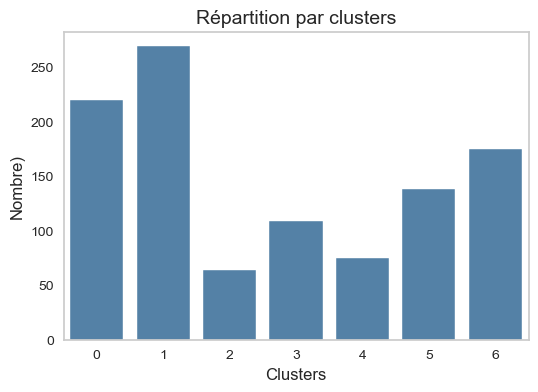

In [55]:
affiche_repartition_par_clusters(kmeans_tsne_vgg16_labels)

In [56]:
# Les catégories par clusters
df_tsne_vgg16.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Computers                          95
         Kitchen & Dining                   45
         Home Decor & Festive Needs         35
         Beauty and Personal Care           20
         Watches                            13
         Baby Care                           8
         Home Furnishing                     4
1        Baby Care                          86
         Home Furnishing                    61
         Home Decor & Festive Needs         56
         Computers                          29
         Beauty and Personal Care           20
         Kitchen & Dining                   16
         Watches                             1
2        Kitchen & Dining                   48
         Beauty and Personal Care           12
         Home Decor & Festive Needs          2
         Home Furnishing                     2
3        Beauty and Personal Care           95
         Kitchen & Dining                    7
         Computers                           5
         Baby Care                           2
4        Kitchen & Dining                   32
         Home Furnishing                    21
         Home Decor & Festive Needs         10
         Baby Care                           6
         Computers                           6
5        Watches                           135
         Home Decor & Festive Needs          2
         Computers                           1
6        Home Furnishing                    62
         Baby Care                          48
         Home Decor & Festive Needs         45
         Computers                          14
         Beauty and Personal Care            3
         Kitchen & Dining                    2
         Watches                             1

**Visualisation des clusters**

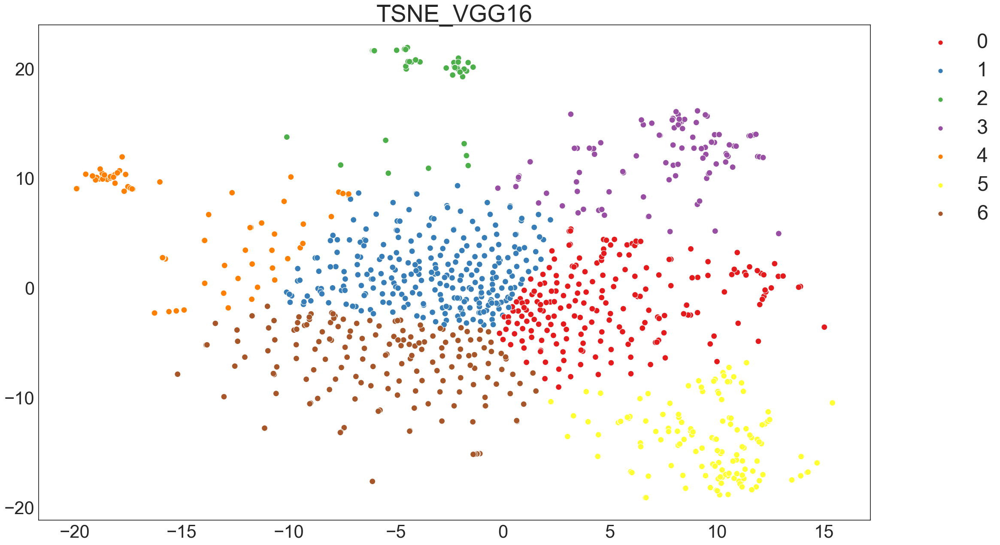

In [59]:
# Visualisation des clusters
affiche_projection_par_clusters(X_proj_tsne_vgg16,
                                           kmeans_tsne_vgg16_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est  (0,27).
- Cette combinaison TSNE VGG16 sur les images ne parvient pas à retrouver les 7 catégories comme le souhaite notre client  

**Qualité de la catégorisation**


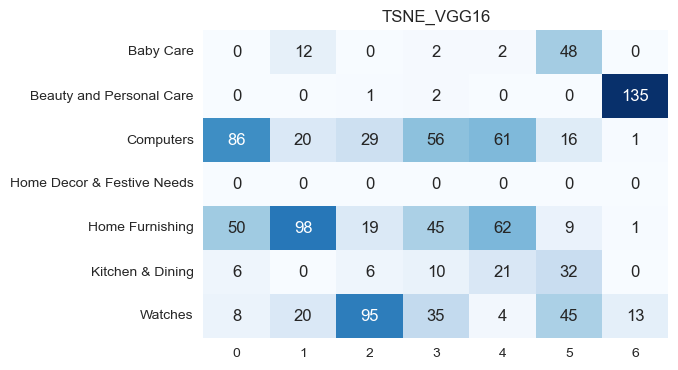

'Précision: 12.95%'

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                            precision    recall  f1-score   support

                 Baby Care       0.00      0.00      0.00        64
  Beauty and Personal Care       0.00      0.00      0.00       138
                 Computers       0.19      0.11      0.14       269
Home Decor & Festive Needs       0.00      0.00      0.00         0
           Home Furnishing       0.41      0.22      0.29       284
          Kitchen & Dining       0.21      0.43      0.28        75
                   Watches       0.09      0.06      0.07       220

                  accuracy                           0.13      1050
                 macro avg       0.13      0.12      0.11      1050
              weighted avg       0.19      0.13      0.15      1050


In [66]:
dico_categories = {'0': 'Watches',
                   '1': 'Computers',
                   '2': 'Baby Care',
                   '3': 'Home Furnishing',
                   '4': 'Kitchen & Dining',
                   '5': 'Beauty and Personal Care',
                   '6': 'Home Furnishing'}
affiche_qualite_categorisation(df_tsne_vgg16,
                                          dico_categories, type_donnee)

In [ ]:
# Sauvegarde des précisions de la catégorisation
df_precision = sauvegarde_precision(df_precision, '58',
                                               type_donnee)
# Sauvegarde des dataframes de trace
to_csv(df_precision, 'IMAGES_data_df_precision.csv')

In [67]:
# Nombre d'erreur
mask = df_tsne_vgg16['CATEGORIE'] == df_tsne_vgg16['Cluster_labels']
df_erreur_vgg16 = df_tsne_vgg16[~mask]
display(f'Nombre d\'erreurs : {df_erreur_vgg16.shape[0]}')

"Nombre d'erreurs : 914"

In [70]:
def path_to_image_photo_html(path):
    return '<img src="' + path + ' " width="100">'

In [71]:
df_visu_erreur_vgg16 = df_erreur_vgg16[['CATEGORIE', 'IMAGE_LOC',
                                        'Cluster_labels']].sample(10)
display(HTML(
    df_visu_erreur_vgg16.
    to_html(escape=False,
            formatters=dict(IMAGE_LOC=path_to_image_photo_html))))

,CATEGORIE,IMAGE_LOC,Cluster_labels
620,Baby Care,,Computers
772,Baby Care,,Computers
23,Watches,,Beauty and Personal Care
140,Kitchen & Dining,,Baby Care
822,Home Decor & Festive Needs,,Home Furnishing
1021,Computers,,Home Furnishing
992,Kitchen & Dining,,Watches
263,Home Decor & Festive Needs,,Home Furnishing
227,Home Decor & Festive Needs,,Home Furnishing
333,Computers,,Watches


**Répartiton des erreurs par catégorie**

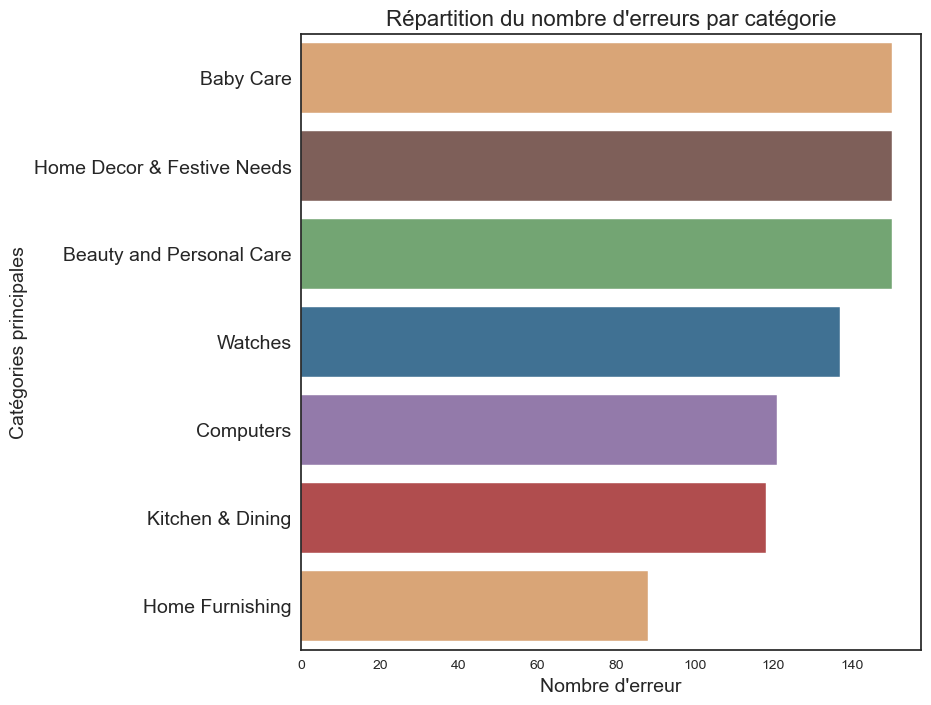

In [68]:
# Répartition des erreurs par catégorie
plt.figure(figsize=(8, 8))
sns.countplot(y='CATEGORIE', data=df_erreur_vgg16, orient='h',
              order=df_erreur_vgg16['CATEGORIE'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

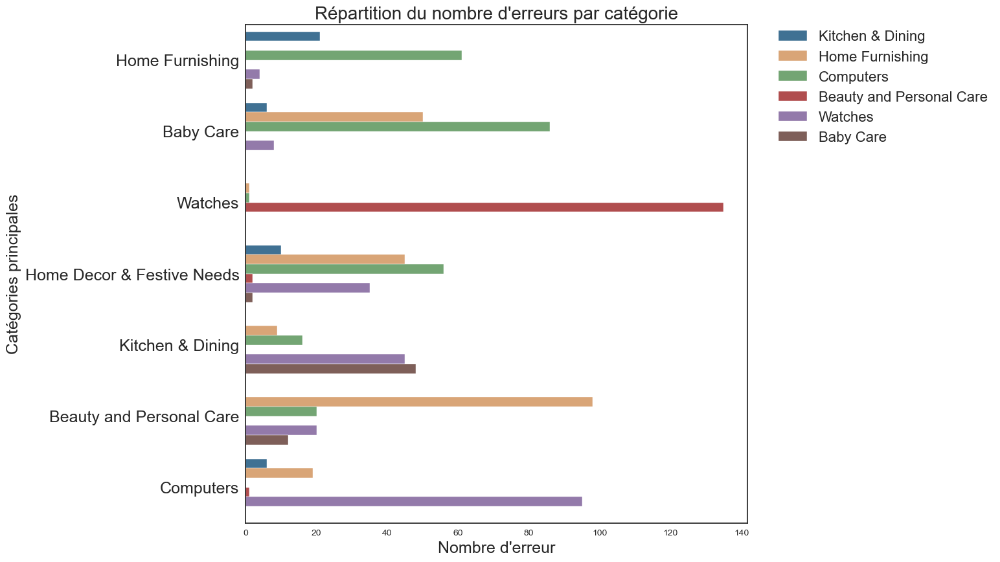

In [69]:
# Répartition des erreurs des catégories par catégorie
plt.figure(figsize=(10, 10))
sns.countplot(y='CATEGORIE', hue='Cluster_labels',
              data=df_erreur_vgg16, orient='h',
              palette=['#3274a1', '#e9a467', '#6bad6b', '#c03d3e',
                       '#9372b2', '#845b53', '#d684bd'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=20)
plt.xlabel('Nombre d\'erreur', fontsize=18)
plt.ylabel('Catégories principales', fontsize=18)
plt.yticks(fontsize=18)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=16)
plt.show()

**Utilisation de VGG19 pré-entraîné sur ImageNet**

In [72]:
# Utilisation de VGG19 pré-entraîné sur ImageNet avec les images d'origine
# VGG19 imports
from keras.applications.vgg19 import preprocess_input
from tensorflow.keras.applications import VGG19

# Liste
vgg19_all_features = []

# Instanciation du modèle
model_vgg19 = VGG19(weights='imagenet', include_top=False)
# Résumé de l'architecture du modèle
model_vgg19.summary()

for rep_image in data['image_loc']:

    # Charger l'image et la redimensionner à la taille
    # requise de 224×224 pixels.
    img = image.load_img(rep_image, target_size=(224, 224))
    # Convertir les pixels en un tableau NumPy afin de pouvoir travailler
    # avec dans Keras
    img = image.img_to_array(img)
    # Redimensionnement
    img = np.expand_dims(img, axis=0)
    # Préparer de nouvelles entrées pour le réseau.
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance
    # de l'image à chacun des 1000 types d'objets connus.
    vgg19_feature = model_vgg19.predict(img)
    # Ajouter la feature prédite en nparray à la liste
    vgg19_all_features.append(np.array(vgg19_feature).flatten())

vgg19_all_features = np.array(vgg19_all_features)

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\PIL\Image.py:3074: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 [==============================] - 0s 290ms/step


In [73]:
# Dataframe de sauvegarde des BOVW VGG19
# Association des features à chaque image
data['vgg19_bovw'] = [vgg19_all_features[i] for i in range(data.shape[0])]
# Dataframe de travail
df_vgg19_bovw = data[['image', 'image_loc', 'Categorie_1', 'vgg19_bovw']]
# Constituer le dataframe de vecteurs de BOVW VGG19
df_vgg19_vectors = pd.DataFrame.from_records(vgg19_all_features)

In [ ]:
# Sauvegarde du dataframe des vectors BOVW VGG19
with open('sauvegarde/df_vgg19_vectors.pickle', 'wb') as f:
    pickle.dump(df_vgg19_vectors, f, pickle.HIGHEST_PROTOCOL)

In [74]:
type_donnee = 'TSNE_VGG19'

In [75]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [20, 30, 40, 50, 70, 80]
results_vgg19 = list()
tsne_results_vgg19 = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_vgg19 = \
        tsne.fit_transform(df_vgg19_vectors)
    results_vgg19.append(tsne_results_vgg19)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.579s...
[t-SNE] Computed neighbors for 1050 samples in 1.279s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 412.190343
[t-SNE] KL divergence after 250 iterations with early exaggeration: 124.276260
[t-SNE] KL divergence after 500 iterations: 2.037516


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.583s...
[t-SNE] Computed neighbors for 1050 samples in 1.198s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 443.261910
[t-SNE] KL divergence after 250 iterations with early exaggeration: 118.541977
[t-SNE] KL divergence after 500 iterations: 1.862338


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.636s...
[t-SNE] Computed neighbors for 1050 samples in 1.246s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 466.303329
[t-SNE] KL divergence after 250 iterations with early exaggeration: 113.719284
[t-SNE] KL divergence after 500 iterations: 1.739510


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.599s...
[t-SNE] Computed neighbors for 1050 samples in 1.249s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 485.151194
[t-SNE] KL divergence after 250 iterations with early exaggeration: 106.981667
[t-SNE] KL divergence after 500 iterations: 1.633888


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.593s...
[t-SNE] Computed neighbors for 1050 samples in 1.261s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 516.311444
[t-SNE] KL divergence after 250 iterations with early exaggeration: 102.562294
[t-SNE] KL divergence after 500 iterations: 1.420685


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.581s...
[t-SNE] Computed neighbors for 1050 samples in 1.236s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 529.769413
[t-SNE] KL divergence after 250 iterations with early exaggeration: 100.027794
[t-SNE] KL divergence after 500 iterations: 1.384546
t-SNE terminée! en : 43.88549470901489 seconds


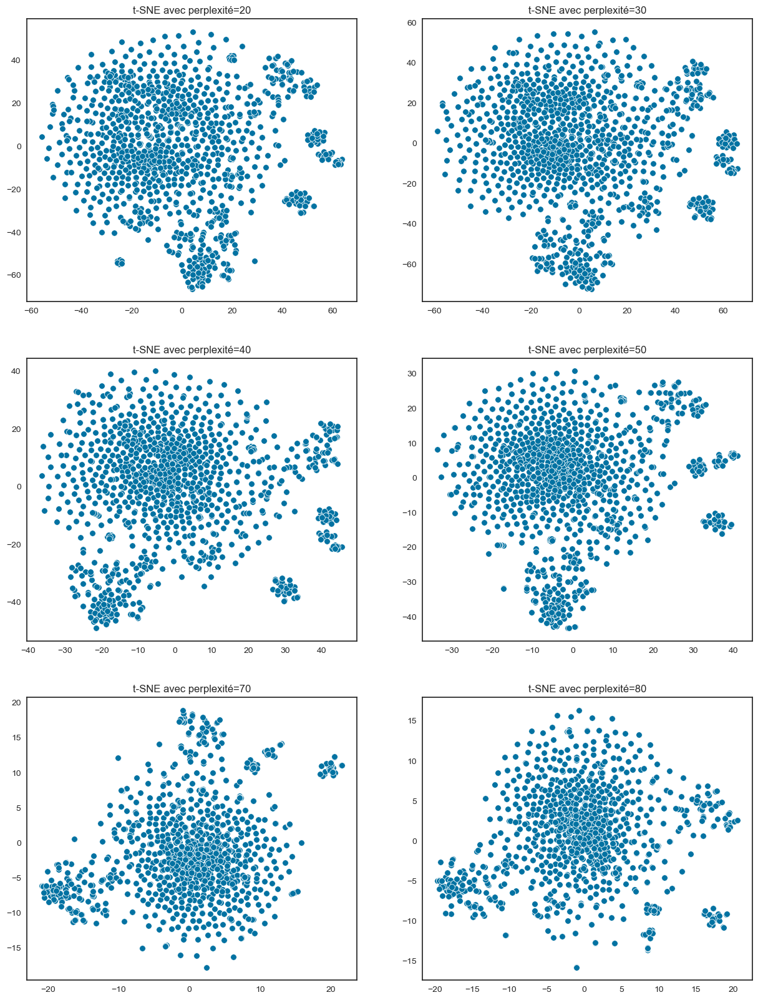

In [76]:
# Visualisation en 2D des différents résultats selon la perplexité
affiche_tsne(results_vgg19, liste_param, 1)

- groupes plus homogènes pour perplexité=80
- on laissera les paramètres learning_rate et n_iter à 5000 et le nombre de composants par défaut (2).

In [77]:
# Réduction de dimension tsne
tsne_vgg19 = TSNE(verbose=1, perplexity=80, n_iter=1050)
X_proj_tsne_vgg19 = \
    tsne_vgg19.fit_transform(df_vgg19_vectors)
# Dataframe pour clustering
df_tsne_vgg19 = pd.DataFrame({'VAR1' : X_proj_tsne_vgg19[:, 0],
                              'VAR2' : X_proj_tsne_vgg19[:, 1],
                              'CATEGORIE' : df_vgg19_bovw['Categorie_1'],
                              'IMAGE': df_vgg19_bovw['image'],
                              'IMAGE_LOC': df_vgg19_bovw['image_loc']})

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.588s...
[t-SNE] Computed neighbors for 1050 samples in 1.280s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 529.769413
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.756477
[t-SNE] KL divergence after 1050 iterations: 1.314554


In [78]:
cols = ['VAR1', 'VAR2']

In [79]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_clust = calcul_metrics_kmeans(df_tsne_vgg19[cols],
                                     df_metrics_clust,
                                     type_donnee,
                                     seed, n_init, max_iter)
# Tri par indice de dispersion : proche de 0
df_metrics_clust[df_metrics_clust['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:13

Type_données,Param_k,dispersion,Durée (s),n_init,max_iter,coef_silh,davies_bouldin
TSNE_VGG19,nan,5545.248047,1.763500,10.000000,100.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,1.815502,10.000000,300.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,1.827499,10.000000,400.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,1.846998,10.000000,200.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,1.904000,10.000000,500.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,3.279505,20.000000,400.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,3.299999,20.000000,500.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,3.310998,20.000000,300.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,3.352004,20.000000,200.000000,0.395569,0.789702
TSNE_VGG19,nan,5545.248047,3.384002,20.000000,100.000000,0.395569,0.789702


In [80]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_vgg19 = KMeans(n_clusters=7, init='k-means++',
                           n_init=10, max_iter=100,
                           random_state=seed) \
    .fit(df_tsne_vgg19[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_vgg19['Clusters'] = kmeans_tsne_vgg19.labels_
kmeans_tsne_vgg19_labels = kmeans_tsne_vgg19.labels_

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


In [81]:
# Scores ?
df_scores = calcul_metriques_clusters(df_tsne_vgg19,
                                                 df_scores,
                                                 type_donnee)
df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\2664902827.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\2311765701.py:5: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()


Type_données,ARI,Homogénéité,Complétude,V-measure
TSNE_VGG19,0.290762,0.396870,0.411282,0.403947


In [ ]:
# Sauvegarde des dataframes de trace
to_csv(df_scores, 'IMAGES_data_df_scores.csv')

C:\Users\Shadow\AppData\Local\Temp\ipykernel_12508\3630838621.py:27: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  display(df_visu_client_cluster.style.hide_index())


Clusters,Nombre,%
0,115,10.950000
1,157,14.950000
2,112,10.670000
3,132,12.570000
4,288,27.430000
5,97,9.240000
6,149,14.190000


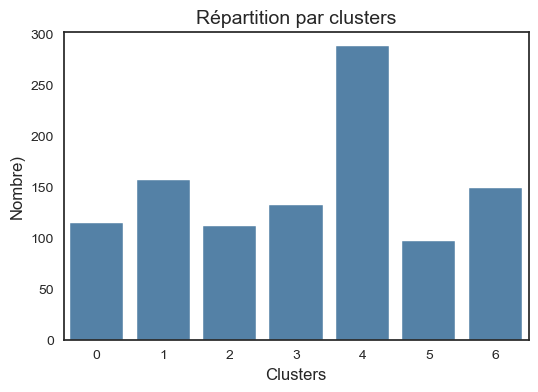

In [82]:
affiche_repartition_par_clusters(kmeans_tsne_vgg19_labels)

In [83]:
# Les catégories par clusters
df_tsne_vgg19.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Kitchen & Dining                   40
         Computers                          21
         Home Decor & Festive Needs         19
         Watches                            14
         Baby Care                           9
         Beauty and Personal Care            7
         Home Furnishing                     5
1        Baby Care                          79
         Home Furnishing                    62
         Home Decor & Festive Needs         10
         Beauty and Personal Care            6
2        Beauty and Personal Care           98
         Home Decor & Festive Needs          4
         Home Furnishing                     4
         Kitchen & Dining                    3
         Baby Care                           2
         Computers                           1
3        Watches                           130
         Home Decor & Festive Needs          2
4        Computers                         100
         Home Decor & Festive Needs         60
         Baby Care                          42
         Home Furnishing                    37
         Beauty and Personal Care           29
         Kitchen & Dining                   19
         Watches                             1
5        Kitchen & Dining                   74
         Computers                          17
         Home Furnishing                     4
         Baby Care                           1
         Beauty and Personal Care            1
6        Home Decor & Festive Needs         55
         Home Furnishing                    38
         Baby Care                          17
         Kitchen & Dining                   14
         Computers                          11
         Beauty and Personal Care            9
         Watches                             5

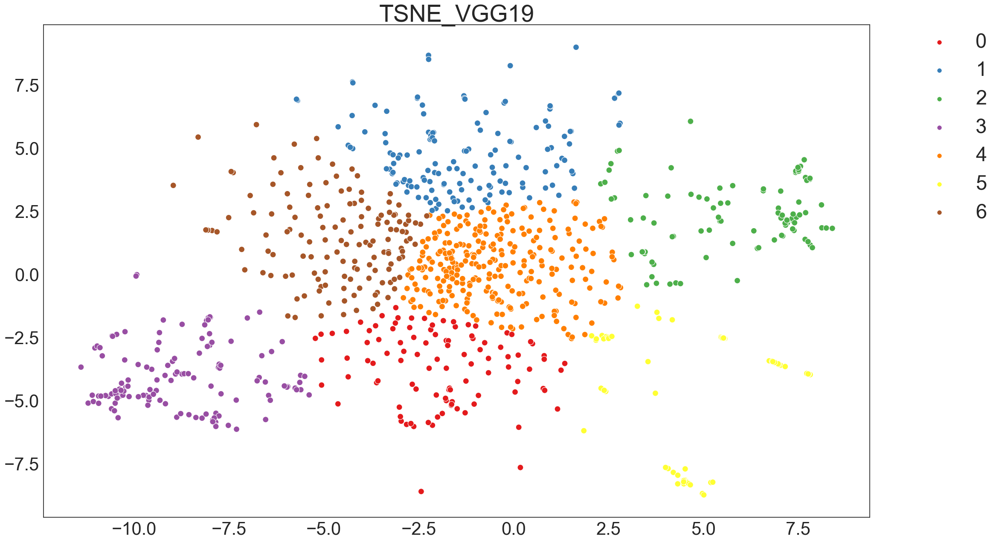

In [84]:
# Visualisation des clusters
affiche_projection_par_clusters(X_proj_tsne_vgg19,
                                           kmeans_tsne_vgg19_labels,
                                           type_donnee)

**Bilan** :
***
- Le score ARI est moyen (0.305).
- Cette combinaison TSNE VGG19 sur les images ne parvient pas à retrouver les catégories comme le souhaite notre client 
 

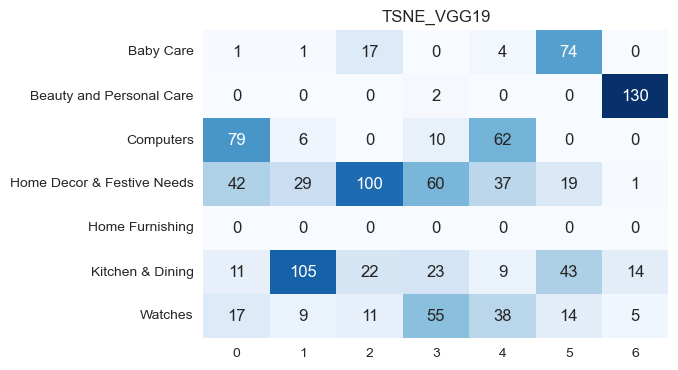

'Précision: 10.38%'

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                            precision    recall  f1-score   support

                 Baby Care       0.01      0.01      0.01        97
  Beauty and Personal Care       0.00      0.00      0.00       132
                 Computers       0.00      0.00      0.00       157
Home Decor & Festive Needs       0.40      0.21      0.27       288
           Home Furnishing       0.00      0.00      0.00         0
          Kitchen & Dining       0.29      0.19      0.23       227
                   Watches       0.03      0.03      0.03       149

                  accuracy                           0.10      1050
                 macro avg       0.10      0.06      0.08      1050
              weighted avg       0.18      0.10      0.13      1050


In [85]:
dico_categories = {'0': 'Kitchen & Dining',
                   '1': 'Computers',
                   '2': 'Kitchen & Dining',
                   '3': 'Beauty and Personal Care',
                   '4': 'Home Decor & Festive Needs',
                   '5': 'Baby Care',
                   '6': 'Watches'}
affiche_qualite_categorisation(df_tsne_vgg19,
                                          dico_categories, type_donnee)

In [ ]:
# Sauvegarde des précisions de la catégorisation
df_precision = sauvegarde_precision(df_precision, '58',
                                               type_donnee)
# Sauvegarde des dataframes de trace
to_csv(df_precision, 'IMAGES_data_df_precision.csv')

In [86]:
# Nombre d'erreur
mask = df_tsne_vgg19['CATEGORIE'] == df_tsne_vgg19['Cluster_labels']
df_erreur_vgg19 = df_tsne_vgg19[~mask]
display(f'Nombre d\'erreurs : {df_erreur_vgg19.shape[0]}')

"Nombre d'erreurs : 941"

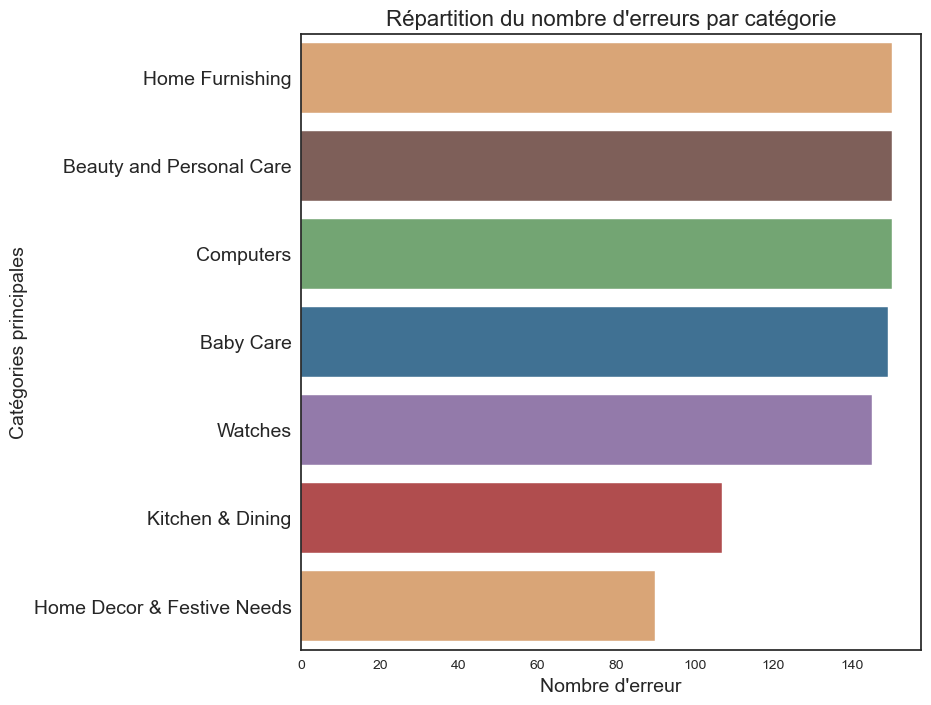

In [87]:
# Répartition des erreurs par catégorie
plt.figure(figsize=(8, 8))
sns.countplot(y='CATEGORIE', data=df_erreur_vgg19, orient='h',
              order=df_erreur_vgg19['CATEGORIE'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

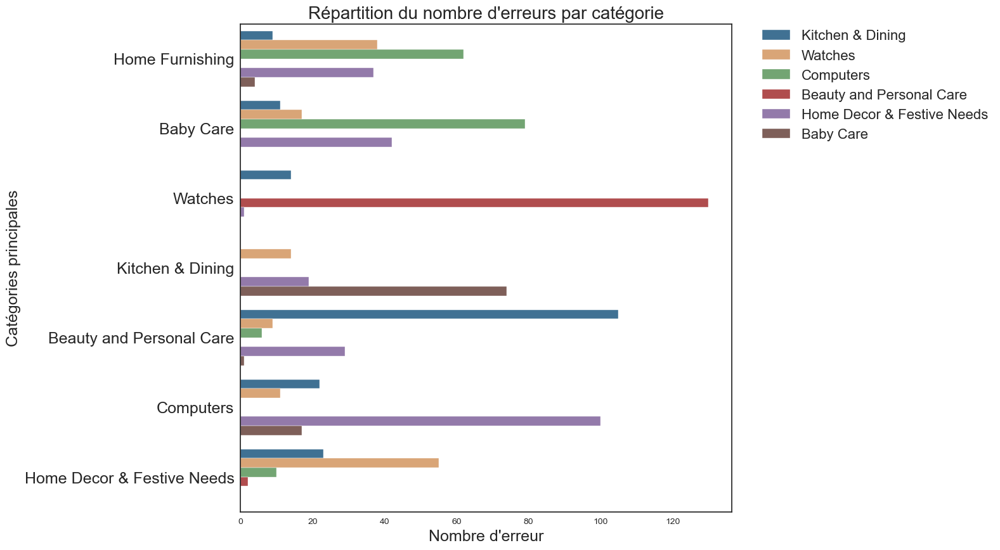

In [88]:
# Répartition des erreurs des catégories par catégorie
plt.figure(figsize=(10, 10))
sns.countplot(y='CATEGORIE', hue='Cluster_labels',
              data=df_erreur_vgg19, orient='h',
              palette=['#3274a1', '#e9a467', '#6bad6b', '#c03d3e',
                       '#9372b2', '#845b53', '#d684bd'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=20)
plt.xlabel('Nombre d\'erreur', fontsize=18)
plt.ylabel('Catégories principales', fontsize=18)
plt.yticks(fontsize=18)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=16)
plt.show()

In [89]:
def path_to_image_photo_html(path):
    return '<img src="' + path + ' " width="100">'

In [90]:
df_visu_erreur_vgg19 = df_erreur_vgg19[['CATEGORIE', 'IMAGE_LOC',
                                        'Cluster_labels']].sample(10)
display(HTML(
    df_visu_erreur_vgg19.
    to_html(escape=False,
            formatters=dict(IMAGE_LOC=path_to_image_photo_html))))

,CATEGORIE,IMAGE_LOC,Cluster_labels
586,Watches,,Beauty and Personal Care
577,Watches,,Beauty and Personal Care
559,Watches,,Beauty and Personal Care
871,Home Furnishing,,Computers
80,Home Decor & Festive Needs,,Kitchen & Dining
881,Home Furnishing,,Home Decor & Festive Needs
22,Watches,,Beauty and Personal Care
977,Baby Care,,Computers
799,Home Furnishing,,Watches
748,Beauty and Personal Care,,Kitchen & Dining


----
#### CNN - Transfert Learning : VGG16 +

    - Avec Remplacement du dernière layers cette fois-ci (au lieu des 3 dernières couches)

In [25]:
def orb_charger_img_extraire_vw(rep_images):
    '''
    ORB Charger les images et extraire les features visual words.
    Parameters
    ----------
    rep_images : répertoire de localisation des images dont on veut extraire
                 les features (obligatoire)
    Returns
    -------
    descriptors : liste des descripteurs.
    lien_img_des : lien entre image et descripteur.
    '''
    # Liste des descripteurs
    descriptor_list = []

    # Detecteur de feature ORB
    orb = cv2.ORB_create(nfeatures=1500)

    # Répertoire des images
    images = rep_images

    # Conserver le lien entre l'image et le descripteur
    lien_img_des = []

    # Pour toutes les images
    for i in range(len(images)):
        im = images[i]
        img = cv2.imread(im, cv2.IMREAD_GRAYSCALE)
        kp, des = orb.detectAndCompute(img, None)

        descriptor_list.append(des)

        # Lien image - descripteur
        for j in range(len(des)):
            lien_img_des.append(i)

        descriptors = np.array(descriptor_list[0])
        for descriptor in descriptor_list[1:]:
            descriptors = np.vstack((descriptors, descriptor))

    descriptors = np.float32(descriptors)

    return descriptors, lien_img_des

In [26]:
data.head()

,image,image_loc,image_redim,Categorie_1
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Images_redim/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Images_redim/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Images_redim/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Images_redim/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


In [27]:
from tensorflow.keras.utils import img_to_array

In [28]:
data.head(2)

,image,image_loc,image_redim,Categorie_1
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Images_redim/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care


In [29]:
path = 'Images_redim' 
data['image_redim'] = [path +'/'+path+ row for row in data['image']]
data.head(2)

,image,image_loc,image_redim,Categorie_1
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Images_redim/Images_redim55b85ea15a1536d46b719...,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Images_redim/Images_redim7b72c92c2f6c40268628e...,Baby Care


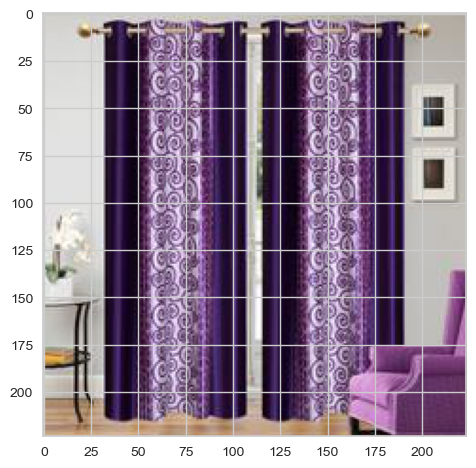

In [30]:
#lire une image
img = plt.imread(data['image_redim'][0])
plt.imshow(img)

In [31]:
img.shape

(224, 224, 3)

In [32]:
# Utilisation de VGG16 pré-entraîné sur ImageNet avec les images d'origine
# VGG16 imports
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
import keras.utils as image

# Liste
vgg16_all_features = []

# Instanciation du modèle
#model_vgg16 = VGG16(weights='imagenet', include_top=False)
model = VGG16()
model_vgg16 = Model(inputs=model.inputs, outputs=model.layers[-2].output)
# Résumé de l'architecture du modèle
model_vgg16.summary()

for rep_image in data['image_loc']:

    # Charger l'image et la redimensionner à la taille
    # requise de 224×224 pixels.
    img = image.load_img(rep_image, target_size=(224, 224))
    # Convertir les pixels en un tableau NumPy afin de pouvoir travailler
    # avec dans Keras
    img = image.img_to_array(img)
    # Redimensionnement
    img = np.expand_dims(img, axis=0)
    # Préparer de nouvelles entrées pour le réseau.
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance
    # de l'image à chacun des 1000 types d'objets connus.
    vgg16_feature = model_vgg16.predict(img)
    # Ajouter la feature prédite en nparray à la liste
    vgg16_all_features.append(np.array(vgg16_feature).flatten())

vgg16_all_features = np.array(vgg16_all_features)

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\PIL\Image.py:3074: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 [==============================] - 0s 215ms/step


In [33]:
# Dataframe de sauvegarde des BOVW VGG16
# Association des features à chaque image
data['vgg16_bovw'] = [vgg16_all_features[i] for i in range(data.shape[0])]
# Dataframe de travail
df_vgg16_bovw = data[['image', 'image_loc', 'Categorie_1', 'vgg16_bovw']]
# Constituer le dataframe de vecteurs de BOVW VGG16
df_vgg16_vectors = pd.DataFrame.from_records(vgg16_all_features)

#### Réduction de dimension

In [34]:
type_donne = "TSNE_VGG16+"

In [35]:
# t-SNE tuning du paramètre perplexity sans initialisation PCA
top_depart = time.time()
liste_param = [20, 30, 40, 50, 70, 80]
results_vgg16 = list()
tsne_results_vgg16 = []
for i in liste_param:
    tsne = TSNE(n_components=2, verbose=1, perplexity=i, n_iter=500,
                random_state=seed)
    tsne_results_vgg16 = \
        tsne.fit_transform(df_vgg16_vectors)
    results_vgg16.append(tsne_results_vgg16)
print('t-SNE terminée! en : {} seconds'.format(time.time()-top_depart))

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.101s...
[t-SNE] Computed neighbors for 1050 samples in 0.289s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 26.617116
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.415298
[t-SNE] KL divergence after 500 iterations: 1.083156
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.096s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.340s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 28.459594
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.246780
[t-SNE] KL divergence after 500 iterations: 1.010172
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.103s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.337s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 29.726460
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.652283
[t-SNE] KL divergence after 500 iterations: 0.963234
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.108s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.445s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 30.687257
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.234947
[t-SNE] KL divergence after 500 iterations: 0.919368
[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.101s...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computed neighbors for 1050 samples in 0.525s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 32.093408
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.302109
[t-SNE] KL divergence after 500 iterations: 0.848170
[t-SNE] Computing 241 nearest neighbors...


c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Indexed 1050 samples in 0.172s...
[t-SNE] Computed neighbors for 1050 samples in 0.250s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 32.641954
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.606201
[t-SNE] KL divergence after 500 iterations: 0.834791
t-SNE terminée! en : 29.78049349784851 seconds


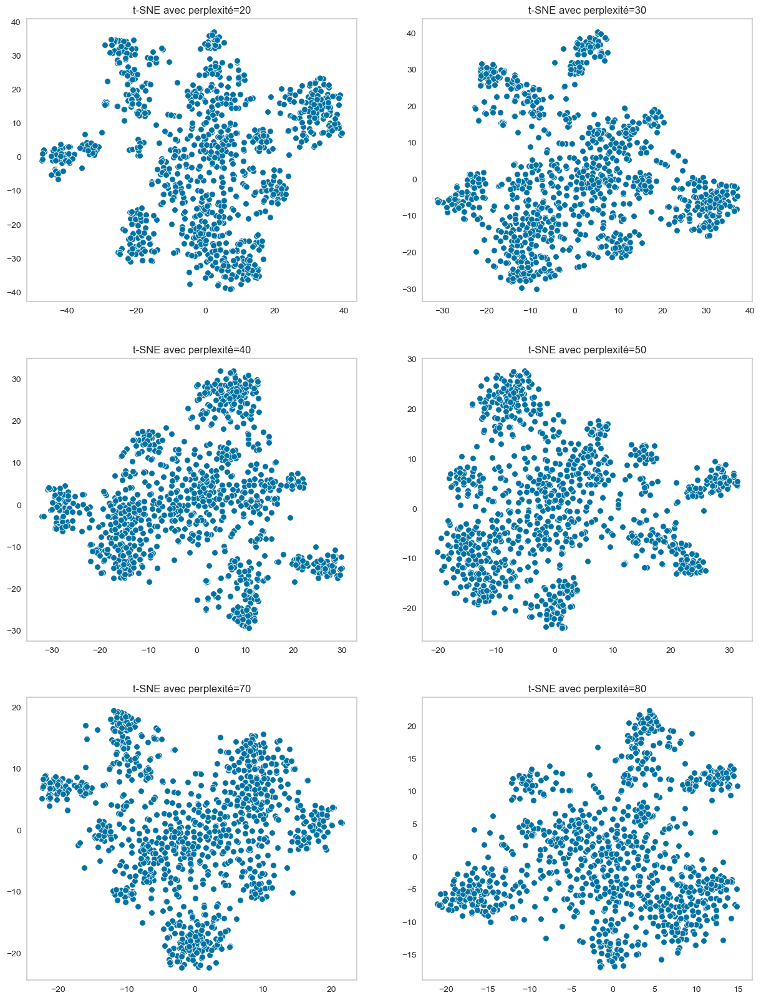

In [38]:
# Visualisation en 2D des différents résultats selon la perplexité
affiche_tsne(results_vgg16, liste_param, 1)

In [39]:
# Réduction de dimension tsne
tsne_vgg16 = TSNE(verbose=1, perplexity=40, n_iter=5000)
X_proj_tsne_vgg16 = \
    tsne_vgg16.fit_transform(df_vgg16_vectors)
# Dataframe pour clustering
df_tsne_vgg16 = pd.DataFrame({'VAR1' : X_proj_tsne_vgg16[:, 0],
                              'VAR2' : X_proj_tsne_vgg16[:, 1],
                              'CATEGORIE' : df_vgg16_bovw['Categorie_1'],
                              'IMAGE': df_vgg16_bovw['image'],
                              'IMAGE_LOC': df_vgg16_bovw['image_loc']})

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\manifold\_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.098s...
[t-SNE] Computed neighbors for 1050 samples in 0.246s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 29.726460
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.608124
[t-SNE] KL divergence after 3400 iterations: 0.954724


#### Clustering

In [40]:
cols = ['VAR1', 'VAR2']

In [41]:
# Chargement des dataframes de sauvegarde des scores
df_scores = pd.read_csv('IMAGES_data_df_scores.csv')
# Suppression de l'entête des objets
df_scores.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\323381422.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_scores.drop(0, 0, inplace=True)


In [42]:
# Chargement des dataframes de sauvegarde des précisions
df_precision = pd.read_csv('IMAGES_data_df_precision.csv')
# Suppression de l'entête des objets
df_precision.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\3977956081.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_precision.drop(0, 0, inplace=True)


In [43]:
# Chargement des dataframes de sauvegarde des métriques de clustering
df_metrics_clust = pd.read_csv('IMAGES_data_kmeans_metrics.csv')
# Suppression de l'entête des objets
df_metrics_clust.drop(0, 0, inplace=True)

C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\2528542146.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  df_metrics_clust.drop(0, 0, inplace=True)


In [49]:
type_donnee = 'TSNE_VGG16'

In [54]:
# Tuning hyperparametres n_init, max_iter
# Paramètres à tester
n_init = [10, 20, 30, 50, 70, 80, 100]
max_iter = [100, 200, 300, 400, 500]
# Métriques avec les différentes combinaisons des paramètres
df_metrics_clust = \
            calcul_metrics_kmeans(df_tsne_vgg16[cols],
                                     df_metrics_clust,
                                     type_donnee,
                                     seed, n_init, max_iter)
#Tri par indice de dispersion : proche de 0
df_metrics_clust[df_metrics_clust['Type_données'] == type_donnee] \
    .sort_values(by=['coef_silh', 'davies_bouldin', 'Durée (s)'],
                 ascending=[False, True, True]).style.hide_index()

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:13

Type_données,Param_k,dispersion,Durée (s),n_init,max_iter,coef_silh,davies_bouldin
TSNE_VGG16,nan,72031.828125,1.962003,10.000000,300.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.828125,1.974496,10.000000,500.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.828125,2.017000,10.000000,200.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.835938,2.059502,10.000000,400.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.835938,2.091001,10.000000,100.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.835938,3.405001,20.000000,200.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.835938,3.424999,20.000000,400.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.828125,3.459504,20.000000,300.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.835938,3.507504,20.000000,500.000000,0.471969,0.731549
TSNE_VGG16,nan,72031.828125,3.569501,20.000000,100.000000,0.471969,0.731549


In [55]:
# Instanciation du modèle KMeans avec les meilleurs paramètres
kmeans_tsne_vgg16 = KMeans(n_clusters=7, init='k-means++',
                           n_init=10, max_iter=300,
                           random_state=seed) \
    .fit(df_tsne_vgg16[cols])
# Ajout de l'assignation du cluster au dataframe
df_tsne_vgg16['Clusters'] = kmeans_tsne_vgg16.labels_
kmeans_tsne_vgg16_labels = kmeans_tsne_vgg16.labels_

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


In [56]:
def calcul_metriques_clusters(dataframe, dataframe_sauv_res, type_donnee):
    '''
    Calcul de la métrique ARI, .
    Parameters
    ----------
    dataframe : dataframe, obligatoire.
    dataframe_sauv_res : dataframe de sauvegarde du résultat, obligatoire.
    type_donnee : titre pour dataframe de sauvegarde, obligatoire.
    Returns
    -------
    dataframe_sauv_res.
    '''
    valeur_reel = dataframe['CATEGORIE']
    valeur_pred = dataframe['Clusters']
    score_ari = adjusted_rand_score(valeur_reel, valeur_pred)
    score_homogeneite = homogeneity_score(valeur_reel, valeur_pred)
    score_completude = completeness_score(valeur_reel, valeur_pred)
    score_vmeasure = v_measure_score(valeur_reel, valeur_pred)

    dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
        'Type_données': [type_donnee],
        'ARI': [score_ari],
        'Homogénéité': [score_homogeneite],
        'Complétude': [score_completude],
        'V-measure': [score_vmeasure]}), ignore_index=True)

    return dataframe_sauv_res

In [60]:
# Scores :
df_scores = calcul_metriques_clusters(df_tsne_vgg16,
                                                 df_scores,
                                                 type_donnee)
df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()

C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\2664902827.py:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataframe_sauv_res = dataframe_sauv_res.append(pd.DataFrame({
C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\605322848.py:5: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  df_scores[df_scores['Type_données'] == type_donnee].style.hide_index()


Type_données,ARI,Homogénéité,Complétude,V-measure
TSNE_VGG16,0.454168,0.557285,0.565708,0.561465


C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\4200265700.py:27: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  display(df_visu_client_cluster.style.hide_index())


Clusters,Nombre,%
0,176,16.760000
1,166,15.810000
2,129,12.290000
3,146,13.900000
4,155,14.760000
5,197,18.760000
6,81,7.710000


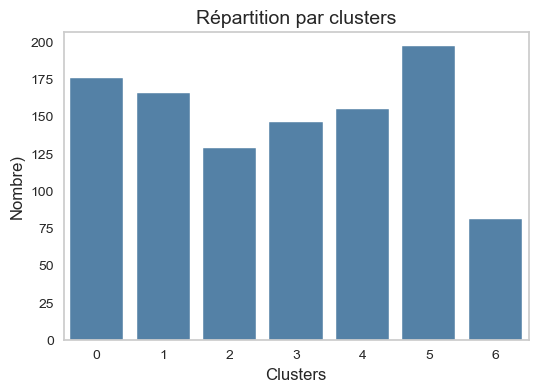

In [63]:
affiche_repartition_par_clusters(kmeans_tsne_vgg16_labels)

In [64]:
# Les catégories par clusters
df_tsne_vgg16.groupby('Clusters')['CATEGORIE'].value_counts(). \
    to_frame()

CATEGORIE
Clusters CATEGORIE                            
0        Baby Care                         109
         Home Furnishing                    62
         Beauty and Personal Care            3
         Computers                           1
         Home Decor & Festive Needs          1
1        Computers                         107
         Kitchen & Dining                   33
         Watches                            14
         Beauty and Personal Care            7
         Home Decor & Festive Needs          3
         Baby Care                           2
2        Beauty and Personal Care          117
         Kitchen & Dining                    7
         Baby Care                           3
         Computers                           1
         Home Decor & Festive Needs          1
3        Watches                           134
         Home Decor & Festive Needs          6
         Kitchen & Dining                    3
         Baby Care                           1
         Beauty and Personal Care            1
         Computers                           1
4        Home Furnishing                    83
         Home Decor & Festive Needs         55
         Baby Care                          11
         Beauty and Personal Care            5
         Kitchen & Dining                    1
5        Home Decor & Festive Needs         84
         Computers                          40
         Kitchen & Dining                   27
         Baby Care                          23
         Beauty and Personal Care           16
         Home Furnishing                     5
         Watches                             2
6        Kitchen & Dining                   79
         Baby Care                           1
         Beauty and Personal Care            1

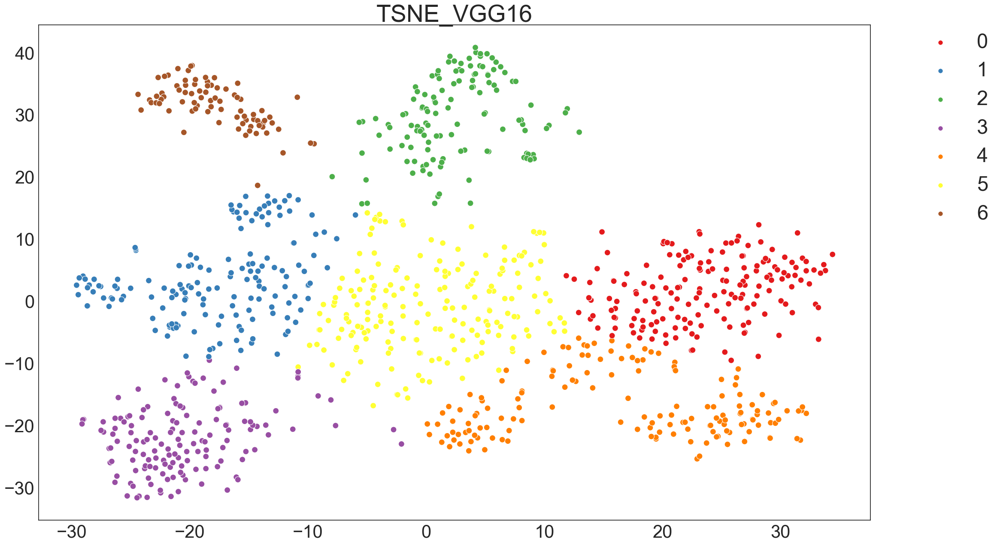

In [67]:
# Visualisation des clusters
affiche_projection_par_clusters(X_proj_tsne_vgg16,
                                           kmeans_tsne_vgg16_labels,
                                           type_donnee)

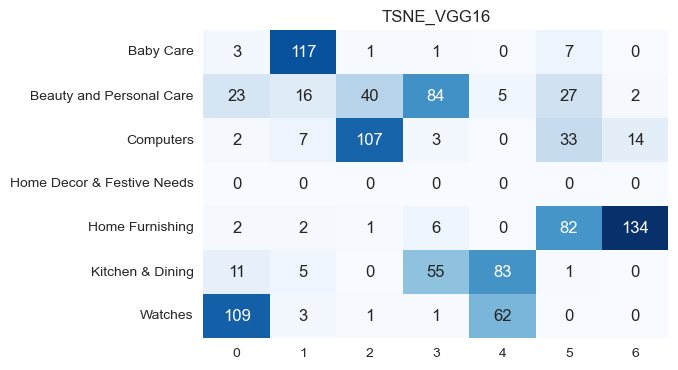

'Précision: 12.1%'

c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Shadow\anaconda3\envs\Projet6-2\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                            precision    recall  f1-score   support

                 Baby Care       0.02      0.02      0.02       129
  Beauty and Personal Care       0.11      0.08      0.09       197
                 Computers       0.71      0.64      0.68       166
Home Decor & Festive Needs       0.00      0.00      0.00         0
           Home Furnishing       0.00      0.00      0.00       227
          Kitchen & Dining       0.01      0.01      0.01       155
                   Watches       0.00      0.00      0.00       176

                  accuracy                           0.12      1050
                 macro avg       0.12      0.11      0.11      1050
              weighted avg       0.14      0.12      0.13      1050


In [74]:
dico_categories = {'0': 'Watches',
                   '1': 'Computers',
                   '2': 'Baby Care',
                   '3': 'Home Furnishing',
                   '4': 'Kitchen & Dining',
                   '5': 'Beauty and Personal Care',
                   '6': 'Home Furnishing'}
affiche_qualite_categorisation(df_tsne_vgg16,
                                          dico_categories, type_donnee)

In [75]:
# Nombre d'erreur
mask = df_tsne_vgg16['CATEGORIE'] == df_tsne_vgg16['Cluster_labels']
df_erreur_vgg16 = df_tsne_vgg16[~mask]
display(f'Nombre d\'erreurs : {df_erreur_vgg16.shape[0]}')

"Nombre d'erreurs : 923"

#### Répartition des erreurs par catégories

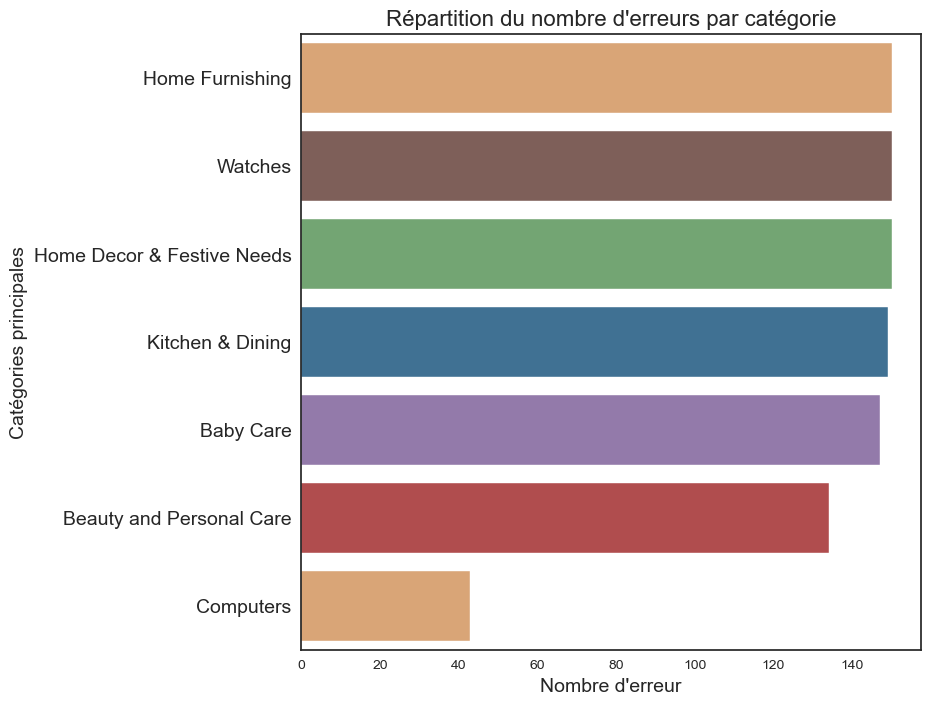

In [76]:
# Répartition des erreurs par catégorie
plt.figure(figsize=(8, 8))
sns.countplot(y='CATEGORIE', data=df_erreur_vgg16, orient='h',
              order=df_erreur_vgg16['CATEGORIE'].value_counts().index,
              palette=['#e9a467', '#845b53', '#6bad6b', '#3274a1',
                       '#9372b2', '#c03d3e'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=16)
plt.xlabel('Nombre d\'erreur', fontsize=14)
plt.ylabel('Catégories principales', fontsize=14)
plt.yticks(fontsize=14)
plt.show()

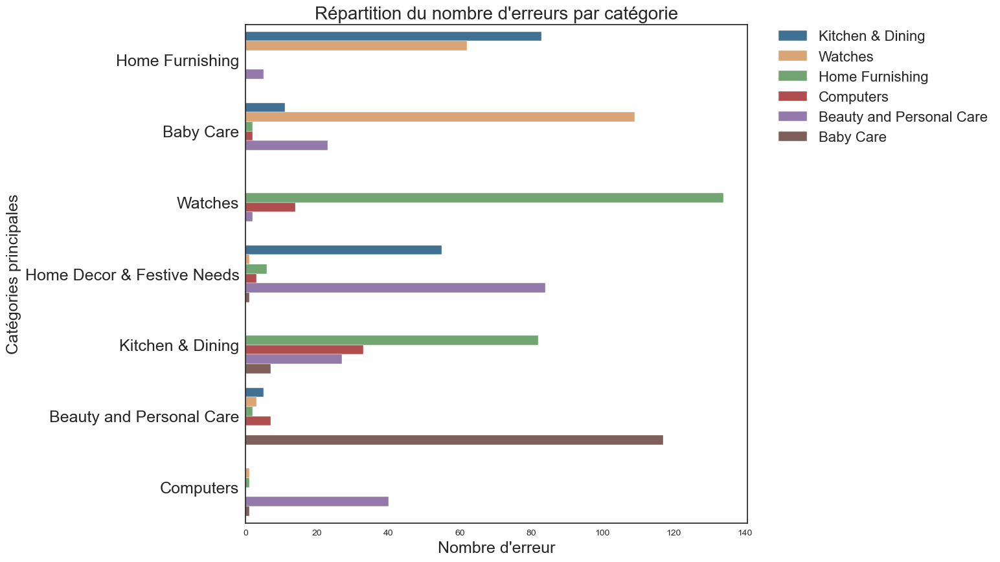

In [77]:
# Répartition des erreurs des catégories par catégorie
plt.figure(figsize=(10, 10))
sns.countplot(y='CATEGORIE', hue='Cluster_labels',
              data=df_erreur_vgg16, orient='h',
              palette=['#3274a1', '#e9a467', '#6bad6b', '#c03d3e',
                       '#9372b2', '#845b53', '#d684bd'])
plt.title('Répartition du nombre d\'erreurs par catégorie', fontsize=20)
plt.xlabel('Nombre d\'erreur', fontsize=18)
plt.ylabel('Catégories principales', fontsize=18)
plt.yticks(fontsize=18)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=16)
plt.show()

In [78]:
from IPython.core.display import display, HTML
path = "Images"

C:\Users\Shadow\AppData\Local\Temp\ipykernel_14144\3225265756.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [79]:
def path_to_image_photo_html(path):
    return '<img src="' + path + ' " width="100">'

In [3]:
#Décoché pour afficher les images (erreurs sur le modèle):

# df_visu_erreur_vgg16 = df_erreur_vgg16[['CATEGORIE', 'IMAGE_LOC',
#                                     'Cluster_labels']].sample(10)
# display(HTML(df_erreur_vgg16.to_html(escape=False,
#                                     formatters=dict(IMAGE_LOC=path_to_image_photo_html))))

In [7]:
ar = np.array([[0.3912,0.5567, 0.2393, 0.2300, 0.4412,0.0375,0.0391,0.2747,0.2927,0.4556]])
dfScoreFinal = pd.DataFrame(ar, index = ['Scores [en ARI]'], columns = ['BoW','Tf_idf', 'W2v', 'Bert', 'Use','Sift','ORB','VGG16','VGG19','VGG16+'])
dfScoreFinal.head()

,BoW,Tf_idf,W2v,Bert,Use,Sift,ORB,VGG16,VGG19,VGG16+
Scores [en ARI],0.3912,0.5567,0.2393,0.23,0.4412,0.0375,0.0391,0.2747,0.2927,0.4556


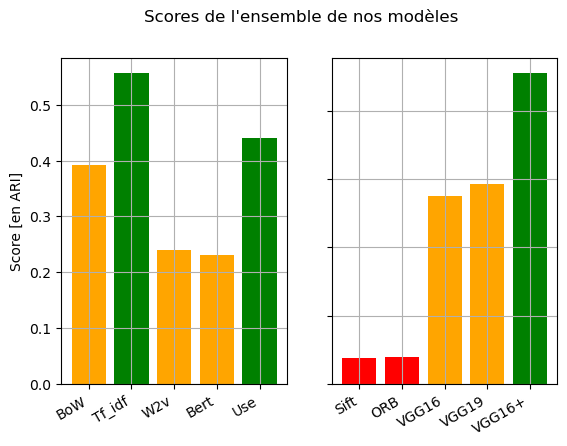

,BoW,Tf_idf,W2v,Bert,Use,Sift,ORB,VGG16,VGG19,VGG16+
Scores [en ARI],0.3912,0.5567,0.2393,0.23,0.4412,0.0375,0.0391,0.2747,0.2927,0.4556


In [4]:
import matplotlib.pyplot as plt
import numpy as np

model = ['BoW','Tf_idf', 'W2v', 'Bert', 'Use']
Model2 = ['Sift','ORB','VGG16','VGG19','VGG16+']
colors1 = ["orange","green","orange","orange","green"]
colors2 = ["red","red","orange","orange","green"]
counts = [0.3912,0.5567, 0.2393, 0.2300, 0.4412]
count2 =[0.0375,0.0391,0.2747,0.2927,0.4556]
#bar_labels = ['blue', 'orange', 'orange', 'green','','','','']
# create two subplots with the shared x and y axes
fig, (ax1, ax2) = plt.subplots(1, 2, sharex=False, sharey=False)

ax1.bar(model, counts, color=colors1)
#ax1.legend(model)
ax2.bar(Model2, count2, color=colors2)
#ax2.legend(Model2)

for ax in ax1, ax2:
    ax.grid(True)
    ax.label_outer()

ax1.set_ylabel('Score [en ARI]')
#ax.legend(title='Modèles')

fig.suptitle("Scores de l'ensemble de nos modèles")
fig.autofmt_xdate()
plt.show()
dfScoreFinal.head()

--------
# <u>Conclusion :</u>

Selon nos différents modèles mise en place que cela soit pour la partie <u>Natural Language Peprocessing</u> ou <u>Computer vision</u> : 

    - Les modèles le plus propande pour pour la classification de nos différents documents semblent êtres les modèles: "tf_idf' et "Universal Sentence Encoder".

    - Tandis que pour les modèles pour le classment des différentes images,ce sont cette fois-ci "Les Transfert Learning avec CNN-VGG16" qui montre le meilleurs scores bien loins des autres modèles mise en place.  

    En résumé, malgré les modèles déployer pour nos différents classification,les scores obtenues restent globalement peu satisfaisant pour un déploiment à grande échelle.

<strong>En conséquence de quoi,la faisabilité d'un moteur de classification des articles en différentes catégories, avec un niveau de précision suffisantes semble peu probable selons les conditions actuelles . </strong>
 
------
<strong><u>Score [Ari] :</u> </strong>

    - BoW : 0.3912 
    - tf_idf : 0.5567
    - Word2Vect: 0.2393 
    - Bert: 0.23 
    - Universel Sentence Encoder: 0.4412 
 
    - Sift: 0.03757
    - ORB:  0.03912
    - CNN(Transfert Learning - VGG16, VGG19 & VGG16+):
        * VGG16 : 0.2747
        * VGG19 : 0.2927
        * VGG16+: 0.4556